<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Imports-and-setup-functions" data-toc-modified-id="Imports-and-setup-functions-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Imports and setup functions</a></span></li><li><span><a href="#DataLoader-Module" data-toc-modified-id="DataLoader-Module-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>DataLoader Module</a></span><ul class="toc-item"><li><span><a href="#Train-val-test-split" data-toc-modified-id="Train-val-test-split-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Train-val-test split</a></span></li><li><span><a href="#Inputs-and-ends" data-toc-modified-id="Inputs-and-ends-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Inputs and ends</a></span></li><li><span><a href="#Tensors,-DataLoader" data-toc-modified-id="Tensors,-DataLoader-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Tensors, DataLoader</a></span></li></ul></li><li><span><a href="#Model-Module" data-toc-modified-id="Model-Module-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Model Module</a></span><ul class="toc-item"><li><span><a href="#de-Bézenac-et-al,-2019:-CNN-with-warp-mapping" data-toc-modified-id="de-Bézenac-et-al,-2019:-CNN-with-warp-mapping-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>de Bézenac et al, 2019: CNN with warp mapping</a></span><ul class="toc-item"><li><span><a href="#Loss-Function" data-toc-modified-id="Loss-Function-3.1.1"><span class="toc-item-num">3.1.1&nbsp;&nbsp;</span>Loss Function</a></span></li><li><span><a href="#Warp" data-toc-modified-id="Warp-3.1.2"><span class="toc-item-num">3.1.2&nbsp;&nbsp;</span>Warp</a></span></li><li><span><a href="#Model" data-toc-modified-id="Model-3.1.3"><span class="toc-item-num">3.1.3&nbsp;&nbsp;</span>Model</a></span></li></ul></li><li><span><a href="#Experiments" data-toc-modified-id="Experiments-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Experiments</a></span><ul class="toc-item"><li><span><a href="#Setup" data-toc-modified-id="Setup-3.2.1"><span class="toc-item-num">3.2.1&nbsp;&nbsp;</span>Setup</a></span></li><li><span><a href="#Dataloaders" data-toc-modified-id="Dataloaders-3.2.2"><span class="toc-item-num">3.2.2&nbsp;&nbsp;</span>Dataloaders</a></span></li><li><span><a href="#Training-with-Squared-Error-Loss" data-toc-modified-id="Training-with-Squared-Error-Loss-3.2.3"><span class="toc-item-num">3.2.3&nbsp;&nbsp;</span>Training with Squared Error Loss</a></span></li><li><span><a href="#Training-with-Regularized-Squared-Error-Loss" data-toc-modified-id="Training-with-Regularized-Squared-Error-Loss-3.2.4"><span class="toc-item-num">3.2.4&nbsp;&nbsp;</span>Training with Regularized Squared Error Loss</a></span></li></ul></li></ul></li></ul></div>

# Imports and setup functions

In [10]:
os.chdir("/projectnb/labci/Lucia/rainfall-pde-ml/")

In [18]:
import datetime
import math
import os
import torch

import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import torch.nn.functional as F

from torch.autograd import Function, Variable
from functools import reduce

from src.dataloader.SSTLoader import SSTLoader
from src.models.BezConv import BezConv

In [13]:
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.current_device())

torch.cuda.get_device_name(0)

True
1
0


'NVIDIA A100 80GB PCIe'

In [14]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
print()

#Additional Info when using cuda
if device.type == 'cuda':
    print(torch.cuda.get_device_name(0))
    print('Memory Usage:')
    print('Allocated:', round(torch.cuda.memory_allocated(0)/1024**3,1), 'GB')
    print('Cached:   ', round(torch.cuda.memory_reserved(0)/1024**3,1), 'GB')

Using device: cuda

NVIDIA A100 80GB PCIe
Memory Usage:
Allocated: 0.0 GB
Cached:    0.0 GB


In [15]:
def datadir(x):
    return "/projectnb/labci/Lucia/data/" + x

# Models

## de Bézenac et al, 2019: CNN with warp mapping

### Loss Function

The authors used a Charbonnier penality to measure the discrepancy between the predicted next image and the target: 

$\rho(x) = (x + \epsilon)^\frac{1}{\alpha}$

Note that with $\epsilon=0$ and $\alpha=\frac{1}{2}$, we recover the $\textit{l}_2$ norm. 

Additional penalty terms were added to the loss function, specifically to regulate the divergence of the displacement $\omega$ between the prediction and the target, its magnitude, and its smoothness:

$L_t = \underset{x \in \Omega}\Sigma \rho(\hat{I}_{t+1}(x) - I_{t+1}(x)) + \lambda_{div}(\nabla.\omega_t(x))^2 + \lambda_{magn}||\omega_t(x)||^2 + \lambda_{grad}||\nabla \omega_t(x)||^2$

### Warp

The future image is calculated based on a "warp" of the motion field estimate, $\hat{\omega}$, which can be thought of in this application as the wind vector field:

$\hat{I}_{t+1}(x) = \underset{y \in \Omega} \Sigma k(x - \hat{\omega}(x), y) I_t (y)$

where $k(u, v)$ is a radial basis function kernel, or equivalent a 2D Gaussian probability distribution:

$k(x - \hat{\omega}(x), y) = \frac{1}{4 \pi D\Delta t}e^{\frac{-1}{4D \Delta t} ||x - \hat{\omega}(x) - y||^2}$

for diffusion coefficient D and time step value $\Delta t$ between $t$ and $t+1$.

### Model

## Experiments

### Setup

In [51]:
class Experiment():
    
    def __init__(self, name, trainset, valset, testset, model, regloss, test_loss, optimizer, outdir):
        self.name = name
        self.train_loader = trainset 
        self.val_loader = valset
        self.test_loader = testset
        self.model = model
        self.loss_fn = model.loss
        self.regloss = regloss
        self.test_loss = test_loss
        self.optimizer = optimizer
        
        self.train_losses = []
        self.val_losses = []
        self.test_losses  = []
        
        # Set up a directory for the experiment
        self.dir_setup(outdir)
        
    def dir_setup(self, parent):
        self.outdir = parent + "/" + self.name
        os.mkdir(self.outdir)
        print("Created new directory to save model states and results: " + self.outdir)
        
        os.mkdir(self.outdir + "/" + "images")
        os.mkdir(self.outdir + "/" + "losses")
    
    def train_loop(self):
        size = len(self.train_loader.dataset)
        # Set the model to training mode - important for batch normalization and dropout layers
        # Unnecessary in this situation but added for best practices
        self.model.train()
    
        losses = []
    
        for batch, (X, y) in enumerate(self.train_loader):
            # Compute prediction and loss
            X = X.to(device) 
            y = y.to(device)
            
            outputs = self.model(X)
            
            wind = outputs[0]
            y_pred = outputs[1]
            
            if self.regloss:
                loss = self.loss_fn(y_pred, y, wind, self.regloss)
            else:
                loss = self.loss_fn(y_pred, y, self.regloss)
                
            losses.append(loss.item())
        
            print("Step:", batch, "Loss:", loss)
        
            # Backpropagation
            loss.backward()
            self.optimizer.step()
            self.optimizer.zero_grad()
        
        return losses
    
    def val_loop(self):
        # Set the model to evaluation mode - important for batch normalization and dropout layers
        # Unnecessary in this situation but added for best practices
        self.model.eval()
        losses = []
        num_loops = 0

        # Evaluating the model with torch.no_grad() ensures that no gradients are computed during test mode
        # also reduces unnecessary gradient computations and memory usage for tensors with requires_grad=True
        with torch.no_grad():
            for X, y in self.val_loader:
                X = X.to(device) 
                y = y.to(device)
                outputs = self.model(X)
                y_pred = outputs[1]
            
                step_loss = self.loss_fn(y_pred, y).item()
                losses.append(step_loss)
                num_loops += 1

        return np.mean(losses)
    
    def test(self):
        # Set the model to evaluation mode - important for batch normalization and dropout layers
        # Unnecessary in this situation but added for best practices
        self.model.eval()
        losses = []
        num_loops = 0

        # Evaluating the model with torch.no_grad() ensures that no gradients are computed during test mode
        # also reduces unnecessary gradient computations and memory usage for tensors with requires_grad=True
        with torch.no_grad():
            for X, y in self.test_loader:
                X = X.to(device) 
                y = y.to(device)
                outputs = self.model(X)
                y_pred = outputs[1]
            
                step_loss = self.test_loss(y_pred, y).item()
                print("Item:", num_loops, "Loss:", step_loss)
                losses.append(step_loss)
                num_loops += 1

        return losses
    
    def save_results(self, losses, fname):
        np.save(fname + ".npy", losses)
    
    def save_model_state(self, epoch):
        
        fname = self.outdir + "/" + "modelCheckpoints/" + self.name + "_epoch_" + str(epoch) + ".pt"
        
        try:
            os.mkdir(self.outdir + "/" + "modelCheckpoints")
        except FileExistsError as e:
            pass
        finally:
            torch.save(self.model, fname)
        
        print("Saved checkpoint at epoch", epoch)
    
    def run(self, epochs):
        print("Running experiment: " + self.name + "...")
        
        # -------------------- Training -------------------------
        
        print("Training over " + str(epochs) + " epochs...")
                
        for t in range(epochs):
            print(f"Epoch {t}\n-------------------------------")
            
            start = datetime.datetime.now()
            epoch_losses = self.train_loop()
            epoch_mean = np.round(np.mean(epoch_losses), 5)
            
            fname = self.outdir + "/losses/train_epoch_" + str(t)
            self.save_results(epoch_losses, fname)
            
            val_loss = np.round(self.val_loop(), 5)
            fname = self.outdir + "/losses/val_epoch_" + str(t)
            self.save_results(val_loss, fname)
            
            print("Mean Training Loss:", epoch_mean)
            print("Validation Loss: ", val_loss)        
            print("Epoch Runtime:", datetime.datetime.now() - start)
            
            self.train_losses.append(epoch_mean)
            self.val_losses.append(val_loss)
            
            if t % 10 == 0:
                self.save_model_state(t)
                
        self.save_results(self.train_losses, self.outdir + "/losses/mean_train_losses")
        self.save_results(self.val_losses, self.outdir + "/losses/mean_val_losses")
        
        # -------------------- Testing ---------------------------
    
    def visualize_examples(self, examples, fname):
        self.model.eval()

        # Evaluating the model with torch.no_grad() ensures that no gradients are computed during test mode
        with torch.no_grad():
            for idx, (X, y) in enumerate(examples):
                X = X.to(device) 
                y = y.to(device)
                
                if torch.cuda.is_available():
                    self.model.cuda()
                
                outputs = self.model(X)
                
                y_pred = outputs[1]
                
                step_loss = self.test_loss(y_pred, y).item()
                
                fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(8,8))
                ax[0].imshow(y[0].cpu())
                ax[0].set_title("Ground truth")
                ax[1].imshow(y_pred[0].cpu())
                ax[1].set_title("Prediction")
                
                fig.savefig(self.outdir + "/images/" + fname + "_" + str(idx) + ".png")
            
    def plot_loss(self, title, xlab, legend_items, fname):
        losses_to_plot = [self.train_losses, self.val_losses]
        plt.plot(losses_to_plot[0])
        plt.plot(losses_to_plot[1])
        plt.title(title)
        
        plt.ylabel("Loss")
        plt.xlabel(xlab)
        plt.legend(legend_items, loc="upper left")
    
        plt.savefig(self.outdir + "/images/" + fname + ".png")

### Dataloaders

In [19]:
torch.manual_seed(42)

Loader = SSTLoader(datadir("sst_npy/"), "NEMO_npy", [0.8, 0.1, 0.1], 32, hist=4)
training_loader = Loader.create_training()
val_loader = Loader.create_validation()

#split = train_val_test_split_files(datadir("sst_npy/"), [0.8, 0.1, 0.1]) 

#train_split = split[0]
#val_split   = split[1]
#test_split  = split[2]

# Total number of files in each split
#print(len(train_split))
#print(len(val_split))
#print(len(test_split))

# For faster training, try larger batchsize
#training_loader = create_dataloader(batchsize=32, files=train_split, ndays=4, shuff=True)
#val_loader = create_dataloader(batchsize=32, files=val_split, ndays=4, shuff=False)

# Total number of batches in the loader
print(len(training_loader))

train_first, train_next = next(iter(training_loader)) 
plt.imshow(train_first[0][0])

UFuncTypeError: ufunc 'add' did not contain a loop with signature matching types (dtype('<U37'), dtype('<U33')) -> None

In [19]:
def create_example_loader(X_files, y_files, batchsize=1, dtype=torch.FloatTensor):
    
    X = []
    y = []
    
    for region in X_files:
        region_X = []
        
        for X_file in region:
            x = np.load(X_file)
            region_X.append(x)
        
        X.append(region_X)
    
    for region in y_files:
        y.append(np.load(region))
    
    X = torch.from_numpy(np.array(X)).type(dtype)
    y = torch.from_numpy(np.array(y)).type(dtype)
    
    loader = torch.utils.data.DataLoader(torch.utils.data.TensorDataset(X, y), batch_size=batchsize)
    
    return loader

In [20]:
reg3_X = [datadir("sst_npy/sst_geo_20210605.nc_region_3.npy"),  
          datadir("sst_npy/sst_geo_20210606.nc_region_3.npy"),
          datadir("sst_npy/sst_geo_20210607.nc_region_3.npy"),
          datadir("sst_npy/sst_geo_20210608.nc_region_3.npy")]

reg22_X = [datadir("sst_npy/sst_geo_20210605.nc_region_22.npy"),  
           datadir("sst_npy/sst_geo_20210606.nc_region_22.npy"),
           datadir("sst_npy/sst_geo_20210607.nc_region_22.npy"),
           datadir("sst_npy/sst_geo_20210608.nc_region_22.npy")]

reg29_X = [datadir("sst_npy/sst_geo_20210605.nc_region_29.npy"),  
           datadir("sst_npy/sst_geo_20210606.nc_region_29.npy"),
           datadir("sst_npy/sst_geo_20210607.nc_region_29.npy"),
           datadir("sst_npy/sst_geo_20210608.nc_region_29.npy")]

reg44_X = [datadir("sst_npy/sst_geo_20210605.nc_region_44.npy"),  
           datadir("sst_npy/sst_geo_20210606.nc_region_44.npy"),
           datadir("sst_npy/sst_geo_20210607.nc_region_44.npy"),
           datadir("sst_npy/sst_geo_20210608.nc_region_44.npy")]

examples_X = [reg3_X, reg22_X, reg29_X, reg44_X]
examples_y = [datadir("sst_npy/sst_geo_20210609.nc_region_3.npy"),
              datadir("sst_npy/sst_geo_20210609.nc_region_22.npy"),
              datadir("sst_npy/sst_geo_20210609.nc_region_29.npy"),
              datadir("sst_npy/sst_geo_20210609.nc_region_44.npy")]


example_loader = create_example_loader(examples_X, examples_y)

In [21]:
try:
    os.mkdir("/projectnb/labci/Lucia/rainfall-pde-ml/experiments/" + str(datetime.date.today()))
except FileExistsError as e:
    print("Already ran experiments today.")
finally:
    path = "/projectnb/labci/Lucia/rainfall-pde-ml/experiments/" + str(datetime.date.today())

Already ran experiments today.


### Training with Squared Error Loss

Created new directory to save model states and results: /projectnb/labci/Lucia/rainfall-pde-ml/experiments/2023-09-26/BezenacSqErr_100
Running experiment: BezenacSqErr_100...
Training over 100 epochs...
Epoch 0
-------------------------------
Step: 0 Loss: tensor(4270.0537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(5880.7603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(7146.4961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(3786.7964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(2954.4263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(2481.1660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(1585.1069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(2094.0146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1570.6265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1278.3510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: te

Step: 111 Loss: tensor(2.8846, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(2.7149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(2.8625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(2.4933, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(2.3896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(2.3686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(3.1371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(3.1962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(2.8122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(3.1400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(2.2512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(3.0753, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(2.1386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(2.5124, device='cuda:0', gra

Step: 225 Loss: tensor(1.0364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.4810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.5490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(2.0643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.5950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.0420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(2.0196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(2.1213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(1.3524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(1.9899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(1.7323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(2.0244, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.7643, device='cuda:0', gra

Step: 339 Loss: tensor(2.2188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(2.2115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(1.9430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.9735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.6611, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(2.0528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(2.1168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(1.7067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(2.1923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.7501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(2.2544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(1.3577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.4578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.9177, device='cuda:0', gra

Step: 453 Loss: tensor(1.2553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(2.0613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(1.5012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.9892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(1.6702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.0406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(1.7805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(1.9144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.0894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.7606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.6536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(2.3600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(2.5327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(2.5405, device='cuda:0', gra

Step: 567 Loss: tensor(2.3769, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(1.7760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.4148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.9485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(2.9840, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(1.4374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(1.8435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(1.6579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.6340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(1.2872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.9574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.1022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.5026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.9377, device='cuda:0', gra

Step: 681 Loss: tensor(2.6667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.5356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.4461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(1.4212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.2111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.4485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(1.5717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.8572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.2699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.5024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(2.0706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.6766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(2.3980, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.4424, device='cuda:0', gra

Step: 795 Loss: tensor(1.4713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(1.3228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(1.0756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.4045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(1.8849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(0.9692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(3.2908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(1.5524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(0.9100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.8039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(1.2961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(2.0534, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(2.8685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.5416, device='cuda:0', gra

Step: 13 Loss: tensor(1.0330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.4444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(1.6467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(1.0697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.5122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.4378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(1.6146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(1.3138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(1.7164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.3632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(1.7096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(2.1259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(1.2100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.9239, device='cuda:0', grad_fn=<MeanBack

Step: 127 Loss: tensor(1.2885, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(1.4584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(2.1852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(2.2784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(0.8779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(2.5420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.7538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.1498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.5930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.3641, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(1.8827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(2.3292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(0.9898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.3690, device='cuda:0', gra

Step: 241 Loss: tensor(1.1855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(3.5369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(1.7075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(3.1695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(1.2996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(2.0079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(1.7002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.6083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(1.5746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(1.5076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(1.7159, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(1.6112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(2.0009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(1.9634, device='cuda:0', gra

Step: 355 Loss: tensor(1.5718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.6559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(1.3401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(2.7953, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(1.7178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.4299, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.5551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.6351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.6258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.6385, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(1.3870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.7949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.7541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.9216, device='cuda:0', gra

Step: 469 Loss: tensor(2.1507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(1.6428, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.2960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(1.7998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(1.4837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(1.3647, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(0.9969, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(1.3577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.2775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.9064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(2.0757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.1348, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(1.4359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(0.8756, device='cuda:0', gra

Step: 583 Loss: tensor(1.2677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.2459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.5953, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(2.1455, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(1.8706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.7008, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(2.2064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.1608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.0919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.5580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.2871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(1.1238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.6034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(2.1444, device='cuda:0', gra

Step: 697 Loss: tensor(1.0822, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.3841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.5176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.3480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.6899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.7697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.4318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.2714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(2.7219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.0709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(1.3361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(2.9606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.8045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.4522, device='cuda:0', gra

Step: 811 Loss: tensor(1.9352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.1656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.9566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(1.7848, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.5995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(2.3393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.4130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.5803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(0.9117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.3838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(1.7460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(1.1467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(2.4032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(1.4831, device='cuda:0', gra

Step: 31 Loss: tensor(1.2493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.5463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(1.3804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(1.6175, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(2.2699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(4.1653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(1.4325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.2694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(1.0319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(1.6588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.0709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(1.7285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.4319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.1395, device='cuda:0', grad_fn=<MeanBack

Step: 145 Loss: tensor(2.0956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(1.4121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(3.0637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(1.2893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.5191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(1.0419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(1.2553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(1.2069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(1.0472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.6725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(1.6069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(1.7850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(2.1524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.8855, device='cuda:0', gra

Step: 259 Loss: tensor(1.1219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.4196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(0.7291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(0.9957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(1.2704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.7046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(1.5922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(2.0607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(1.7734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(1.0018, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.5470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.6150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(1.1998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(2.5456, device='cuda:0', gra

Step: 373 Loss: tensor(1.8238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.2768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(2.0492, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(1.1731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(1.9329, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.4925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(1.7857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(2.0826, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(2.0045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(1.6129, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.5507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.0348, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.6151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(2.2916, device='cuda:0', gra

Step: 487 Loss: tensor(1.3822, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.2837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(1.2180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.8401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.1505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(2.8529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(1.4869, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(1.2956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(1.8856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(0.9263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.8369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(2.7364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(2.8814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(1.3796, device='cuda:0', gra

Step: 601 Loss: tensor(1.3082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(1.8374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(1.1987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(2.0219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(1.3396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(1.4541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(1.5290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(2.8707, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(1.2139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(1.7052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(2.1463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.5666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.5094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.4113, device='cuda:0', gra

Step: 715 Loss: tensor(2.2872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(2.0945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.3817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(2.2324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(2.1389, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(1.5880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(0.9300, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(1.8636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(1.6032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(0.8102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.4368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(1.6619, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.2595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.7371, device='cuda:0', gra

Step: 829 Loss: tensor(1.8017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(1.4149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(2.4362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(1.1513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(1.4241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.0382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.2028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.3274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(1.4200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.4488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(1.2110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.7011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(1.1277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.4395, device='cuda:0', gra

Step: 49 Loss: tensor(1.2156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.5747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(1.4870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.2172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(1.9034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(1.7313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(1.0890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(1.1060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(2.2337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(1.5076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.8606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(3.0831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.7552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.5306, device='cuda:0', grad_fn=<MeanBack

Step: 163 Loss: tensor(1.1398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(1.5471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(1.9918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(2.6318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(1.6478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(1.1235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(1.1174, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(1.1373, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(1.6616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(1.2172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(1.3220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(1.7131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(2.1811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.4747, device='cuda:0', gra

Step: 277 Loss: tensor(2.3766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(1.4647, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(1.6372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.0531, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.1972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.0145, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(0.9488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(1.2342, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.8491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(1.3950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(1.7989, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(1.4235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.5198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(1.3760, device='cuda:0', gra

Step: 391 Loss: tensor(1.6808, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(2.4191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(1.6737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(1.6632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(1.7919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(1.8522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(1.1777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.5562, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(3.8122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.4000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(1.3682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(3.6294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.1396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(1.4824, device='cuda:0', gra

Step: 505 Loss: tensor(1.6710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(2.1346, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(1.0653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.4504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.7199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(1.7333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(1.4494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.1558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(1.1903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(1.1981, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(2.6872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.3961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(1.3932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(2.3646, device='cuda:0', gra

Step: 619 Loss: tensor(1.5365, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(1.1097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.7947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(1.4731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(2.0671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(1.8218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(1.8547, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(2.1260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(1.1106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(1.5844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(1.1310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(0.8092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(2.0917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.3358, device='cuda:0', gra

Step: 733 Loss: tensor(1.9358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(1.9232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(1.9780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(2.2336, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(2.0386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.8112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(2.3052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(1.7279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(1.6226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(1.3261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(2.0486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(1.5037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.8150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.5342, device='cuda:0', gra

Step: 847 Loss: tensor(2.1054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(0.9656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(1.1508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.4866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(1.8505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.4538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(3.0360, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.9344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(1.2806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(2.6313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.4757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(1.3077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(1.7683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.9822, device='cuda:0', gra

Step: 67 Loss: tensor(2.5332, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(2.1759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(1.7191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(2.1946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(1.2747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.6499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(1.5267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(1.8168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(1.7775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.8704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(1.5779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.3243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(3.1632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.3268, device='cuda:0', grad_fn=<MeanBack

Step: 181 Loss: tensor(1.2612, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(1.7203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.1276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.4920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(2.1584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(1.5280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(0.8595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(1.0288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(1.5913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(1.2690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.0840, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.4020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(0.9100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.3539, device='cuda:0', gra

Step: 295 Loss: tensor(2.4328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.2684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(1.0957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.2058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(0.9718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(1.3480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(1.5791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.2968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(2.4622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.9300, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(1.6939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.3039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.1266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.0248, device='cuda:0', gra

Step: 409 Loss: tensor(1.5232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(1.6224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(1.4658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.2894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(1.2945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(3.1519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(1.5760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.1796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(1.2978, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(1.3500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(1.7001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.7714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(0.9264, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(2.3747, device='cuda:0', gra

Step: 523 Loss: tensor(1.7733, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(1.3915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(1.1175, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(3.1252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(1.7141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(1.0273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(1.8559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.4025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.5105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(1.8504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(2.0788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(1.5675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.2507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(2.2476, device='cuda:0', gra

Step: 637 Loss: tensor(1.9510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(1.7423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(1.1298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(2.2341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(2.4729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(1.1476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(1.4352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(1.1574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(1.4998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(2.2244, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(0.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(1.2136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.4032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.3397, device='cuda:0', gra

Step: 751 Loss: tensor(1.4849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.9888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(0.9564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(1.2563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(0.9391, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.5134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(1.7548, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.6283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(0.9343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(3.3698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.6447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.6839, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.9666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.1240, device='cuda:0', gra

Step: 865 Loss: tensor(1.1925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(1.0876, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.3781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(2.0177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.4867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(1.9889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(0.9859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(1.5000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(1.3836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.9118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(2.0330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.9670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(1.5093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.3998, device='cuda:0', gra

Step: 85 Loss: tensor(1.7537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.6965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(1.1786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(1.9577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(2.4383, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.4550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(1.5070, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.5690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.3912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(2.4624, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(0.7843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(1.2867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(1.0378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.4275, device='cuda:0', grad_fn=<MeanBack

Step: 199 Loss: tensor(1.9605, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.1657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(0.9579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.8245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(1.5998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(1.5508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(2.2014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(1.9309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(1.1291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(1.4952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(1.5522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.3106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(2.0138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(1.5487, device='cuda:0', gra

Step: 313 Loss: tensor(1.3869, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(1.5975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(1.0282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.4020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(1.9709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.1293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(0.9266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(2.3918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(1.1196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(1.8930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.1375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(3.2375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.3464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(1.4822, device='cuda:0', gra

Step: 427 Loss: tensor(1.0050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(1.1587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(1.1468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.6514, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(2.0505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(1.1156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(2.1017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(1.6861, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(1.2829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(2.0344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(0.9880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.2917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(2.3484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.8635, device='cuda:0', gra

Step: 541 Loss: tensor(2.1294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.9508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(1.7900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.0104, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(0.7772, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.3954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(2.8116, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(1.6968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(1.9577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(0.9121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(2.1009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.5916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.2786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.1659, device='cuda:0', gra

Step: 655 Loss: tensor(1.5845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(1.8862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(1.9862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.9668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.0637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.2722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(1.6971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.0505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(1.2856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(2.4055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(1.2712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.0440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(1.6131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(1.6722, device='cuda:0', gra

Step: 769 Loss: tensor(1.7626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(1.2595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.6561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.2006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(1.0325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.3827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(1.5295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(1.0977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(1.9113, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(1.5962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(1.6006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.8877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(1.9439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(1.9101, device='cuda:0', gra

Step: 883 Loss: tensor(1.8347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.4256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.2258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(2.7024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(1.4319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(1.0462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(1.8021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(2.5210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(1.1438, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(1.1755, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.50233
Validation Loss:  0.75589
Epoch Runtime: 0:02:30.100076
Epoch 6
-------------------------------
Step: 0 Loss: tensor(2.1976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(1.5363, device='cuda:0', grad_fn=<MeanBackward0>)
Step

Step: 103 Loss: tensor(1.3721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(1.7507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.3568, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(1.3585, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(0.8868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(1.7916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(0.9067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(0.9764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(0.8375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(0.9235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(1.1362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.4543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(1.1896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(2.1831, device='cuda:0', gra

Step: 217 Loss: tensor(1.6841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(1.7584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(1.4097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(1.7103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(2.2566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.2778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(0.8106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(1.0424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(1.3743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.6398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.0752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(1.2076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.4115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.3992, device='cuda:0', gra

Step: 331 Loss: tensor(2.7208, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(1.7070, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.9465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(2.0002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.5767, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.1559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(1.0625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(1.1124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(0.9307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(1.8112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(1.4701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(0.8968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(0.8319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.2912, device='cuda:0', gra

Step: 445 Loss: tensor(1.0759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.0627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(1.2912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(1.2411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(1.6271, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(0.9315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(1.8097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(0.9459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(3.0310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.1989, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(1.8122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(1.2517, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(1.1524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(2.5308, device='cuda:0', gra

Step: 559 Loss: tensor(1.7019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(1.3014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(1.6157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.4314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(1.1595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.7549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(1.2846, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(1.7228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(2.2873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(1.6361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.1285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.0256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(2.8855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(2.0896, device='cuda:0', gra

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Step: 535 Loss: tensor(3.0745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(2.2272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(1.5762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.6144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(1.2476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(1.5340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(1.4425, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(2.0873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(0.9350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.2457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(1.0632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.8892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(1.6997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(2.2401, device='cuda:0', gra

Step: 649 Loss: tensor(1.5123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(3.0583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.4308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(1.7034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(1.0701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(1.4593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(1.3976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(0.9522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(1.3170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.3184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.3916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.4908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(0.9285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.6834, device='cuda:0', gra

Step: 763 Loss: tensor(1.0491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.0254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(0.8305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(1.6474, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(1.5347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(1.4714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(0.9848, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(1.1594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.3538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(0.9945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(1.3355, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.0723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(3.3673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(1.2559, device='cuda:0', gra

Step: 877 Loss: tensor(0.8641, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(0.8786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(0.8058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(0.7716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(1.1696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(0.9121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.9064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(2.1328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.2523, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(1.1148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(0.8526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(1.9830, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(0.8791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(2.8050, device='cuda:0', gra

Step: 97 Loss: tensor(1.2780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.2841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(1.8962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(1.5766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(1.8393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(1.1142, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(1.9698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(1.6759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.1277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(1.0206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(1.9613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(1.7664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(0.9096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(1.5510, device='cuda:0', grad_f

Step: 211 Loss: tensor(2.2964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(0.8631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(1.2681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(0.8361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(1.2900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(1.3533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(1.2096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(1.3282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(0.8062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(2.0443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(1.5912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.5213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.4795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(1.7751, device='cuda:0', gra

Step: 325 Loss: tensor(1.6084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(1.6267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(0.9149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(1.0643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(1.0437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(2.2238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(0.7180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(0.8377, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.2587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(2.2604, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.4454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.6718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(1.6702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(0.8698, device='cuda:0', gra

Step: 439 Loss: tensor(0.6842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.9762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.5371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(0.6844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(1.8278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(2.7744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(0.9612, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.5168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(0.7259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(1.2169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(1.1728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(1.5053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(2.5083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(2.2483, device='cuda:0', gra

Step: 553 Loss: tensor(1.1757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.8809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(1.1088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(0.9493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(1.4057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(1.1715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(0.8745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(1.2341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(0.8508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(1.7948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.9881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(1.9876, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(1.5865, device='cuda:0', gra

Step: 667 Loss: tensor(1.2861, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(0.6946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(1.1787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(1.8458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(1.3127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(0.6090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(1.1128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(2.0801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(1.8230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.5437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(0.8154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(1.3669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.1593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.2713, device='cuda:0', gra

Step: 781 Loss: tensor(2.2765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(1.3975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(1.5889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(1.2514, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(1.3729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(0.9626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(1.0951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(1.4471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.4424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.5436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(1.5319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.3711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(1.0362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(1.2124, device='cuda:0', gra

Step: 1 Loss: tensor(1.5025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(0.9170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.3867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(1.4852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(1.2172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(0.8710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(1.2283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(0.8745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1.0815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.2827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(1.1130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.0484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(1.7066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(0.7407, device='cuda:0', grad_fn=<MeanBackward0>)
S

Step: 115 Loss: tensor(1.2578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(0.9164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.9296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(1.0520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.0187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.7210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.6065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.6372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.5072, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.1884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(1.2911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(1.0507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(1.6527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.8371, device='cuda:0', gra

Step: 229 Loss: tensor(1.4509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.1616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(2.0223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.7703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(1.1388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(1.0844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(1.4049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(1.5530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(1.3541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.1373, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.4472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.9781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.5973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.3893, device='cuda:0', gra

Step: 343 Loss: tensor(1.2573, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(0.9312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(0.9832, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.8504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(1.5676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.7064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(1.3670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(2.0535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.1836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.3674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(0.9275, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(0.8245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(0.8260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(0.7902, device='cuda:0', gra

Step: 457 Loss: tensor(1.0065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.7361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(1.9402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(3.2061, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.0579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(0.9935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.1232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(2.7154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(1.5292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.4980, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(1.0037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(1.0002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(0.5845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(1.4263, device='cuda:0', gra

Step: 571 Loss: tensor(2.1048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(1.1062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(2.5149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.9614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(2.0623, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(1.1820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(3.1559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(0.8676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(2.1324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.6004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.4661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.8367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(1.0713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.3273, device='cuda:0', gra

Step: 685 Loss: tensor(0.8811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.1033, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.9773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(2.2747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.4813, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(0.8276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.8019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(0.9221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(1.2431, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(0.8825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.9083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(0.8515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(0.7522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.5537, device='cuda:0', gra

Step: 799 Loss: tensor(0.6182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.0459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(1.7970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.7467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(1.0320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.0353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(1.9737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.5716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.3262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.7790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(1.0879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(0.8359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(0.8672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.0021, device='cuda:0', gra

Step: 17 Loss: tensor(1.7098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.1787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.8740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(1.1140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(2.8678, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.5894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(0.6551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(1.9739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(1.3350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(1.4463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(1.7000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(1.1376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(1.0940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(0.7690, device='cuda:0', grad_fn=<MeanBack

Step: 131 Loss: tensor(0.8298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.0308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.1951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(0.8316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.1712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.3419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(1.1966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(0.8748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(0.7534, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.8709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(1.4458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(1.2843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(1.1424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(2.2669, device='cuda:0', gra

Step: 245 Loss: tensor(0.9778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.8620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(1.0603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.6525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(2.4999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(0.6401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(1.1920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(2.7231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.0670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.5834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(1.3079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(1.2820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(0.8843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(1.0584, device='cuda:0', gra

Step: 359 Loss: tensor(1.4580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(2.0387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.0552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(0.7960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.2017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(0.9156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(0.7908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(1.9502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(0.7783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.3577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(1.1086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(1.7524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(2.0810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(1.1338, device='cuda:0', gra

Step: 473 Loss: tensor(1.0499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(0.9737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(1.6445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.8446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(0.9414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.3926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(0.8878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(0.8814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(2.0844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.0085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(1.2494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(0.9470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(1.0971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(1.4038, device='cuda:0', gra

Step: 587 Loss: tensor(0.7586, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.7046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(0.9843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(0.7698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(0.6427, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.5787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.8077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(0.9929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.6495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.6956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.8886, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(0.8046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(1.0761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(1.1835, device='cuda:0', gra

Step: 701 Loss: tensor(0.8141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.2042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.0334, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(0.9661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(3.0935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.2182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(1.9465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(1.2708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(2.2080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.4541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(1.3143, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.7069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(1.6639, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(1.5930, device='cuda:0', gra

Step: 815 Loss: tensor(0.8866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(1.9200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.3747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.3878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(0.7797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.0353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(0.8135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(1.3964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.1533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(1.3217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(1.7527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(1.0795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(1.3797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(0.6895, device='cuda:0', gra

Step: 35 Loss: tensor(0.8821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.1334, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(0.8016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.1085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(1.5620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(0.7179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.0351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(0.4796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.1135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.2236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(1.5022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(0.8394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(1.1032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(1.9458, device='cuda:0', grad_fn=<MeanBack

Step: 149 Loss: tensor(0.7184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(0.9966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(0.9416, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(0.9321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(1.9715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(0.9013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(1.2576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(1.0112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(0.9682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.3207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(1.0152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(0.9407, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(1.1225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.3517, device='cuda:0', gra

Step: 263 Loss: tensor(1.1124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.6141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(2.1870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(1.2177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(1.1032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(0.9848, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.8512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(0.7580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(0.9895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(2.2290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(1.4231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(0.7069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(0.8986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(1.4338, device='cuda:0', gra

Step: 377 Loss: tensor(1.0964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.2126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(1.4359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(1.0479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(1.3552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(1.1323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.1914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.7110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.2575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(0.7878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(0.9256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(0.9924, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(1.4703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(0.9879, device='cuda:0', gra

Step: 491 Loss: tensor(0.7948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.1299, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(0.9242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(1.3000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(1.6479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(0.8875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.3857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.0983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(1.0121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.4644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(0.7872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(1.0320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(1.2542, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(0.9751, device='cuda:0', gra

Step: 605 Loss: tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(0.9682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(0.5379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(1.4959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(0.8445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(0.9582, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(1.8163, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.0369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.2646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(0.9749, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(1.6101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(0.7064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(0.8258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(0.8297, device='cuda:0', gra

Step: 719 Loss: tensor(1.4035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(1.7376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(0.8231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(1.1103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(1.3366, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(2.0950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.6081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.6874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.5272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.3682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(0.9318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(2.5421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(2.2970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(1.4648, device='cuda:0', gra

Step: 833 Loss: tensor(1.3323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.0710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.2026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.4067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(1.5238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(0.9576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(1.0795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.4145, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.5588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(0.7952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(0.9304, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.6341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(1.2614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(1.1461, device='cuda:0', gra

Step: 53 Loss: tensor(0.7933, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(2.9486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(2.0085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(1.2637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(1.1731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(1.1051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.0060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.5863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.2773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(0.7374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(2.3197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(0.9874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(1.3088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(1.6552, device='cuda:0', grad_fn=<MeanBack

Step: 167 Loss: tensor(1.2498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(0.8427, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(1.1659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(1.4676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(1.7834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(1.0529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(1.4644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(2.3345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.5313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.2309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(0.9320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(2.0633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.5765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(1.1420, device='cuda:0', gra

Step: 281 Loss: tensor(1.0411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.1369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(0.8325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(1.0069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.9414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(1.2991, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(0.7274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(1.2188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.2484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(1.2028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(0.8211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.1752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(1.3994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(0.9886, device='cuda:0', gra

Step: 395 Loss: tensor(1.0615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(0.7856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(1.1000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.4811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(1.0050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.1903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(1.8480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(1.1417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.0102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(0.9799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(0.8094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.3030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(0.9290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(25.2695, device='cuda:0', gr

Step: 509 Loss: tensor(1.3249, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(1.4349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(1.1236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.1719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(1.7178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(0.9805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(1.7016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.1363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(0.9754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(1.4588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(1.3086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(3.7087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.0056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(1.0423, device='cuda:0', gra

Step: 623 Loss: tensor(1.5973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(1.0823, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(0.8759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.6263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(1.4632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(1.0967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(1.2840, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(2.0103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(0.9119, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.6230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(1.1660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.0044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(1.3186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(1.1684, device='cuda:0', gra

Step: 737 Loss: tensor(1.6860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.9265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(0.8952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(1.3206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(2.1224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.8942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.5174, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(1.1563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.5053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.6651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(0.9333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(1.0819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(0.9504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(1.0630, device='cuda:0', gra

Step: 851 Loss: tensor(1.3237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.5207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(1.0181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.3066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(1.3200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(1.1972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.5540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(1.2429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(2.1552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.0212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.0125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(1.5065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(1.6748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(1.5536, device='cuda:0', gra

Step: 71 Loss: tensor(1.1940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.1799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(0.9730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(1.7228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(1.1450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.9774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(1.0674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.1778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(1.1821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.1597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.6540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(0.9191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(1.1270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(1.4331, device='cuda:0', grad_fn=<MeanBack

Step: 185 Loss: tensor(2.6341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(2.0013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(0.6926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(1.3856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(3.4053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(1.6777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.0992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.1512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(2.2079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.5872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(1.7615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(0.8061, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(2.7278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(1.4572, device='cuda:0', gra

Step: 299 Loss: tensor(0.9741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(0.8877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(2.5929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(2.3155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(1.4490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.8775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(1.0554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.0653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.0470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.2992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(2.2413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(1.3128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(1.2353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(2.0361, device='cuda:0', gra

Step: 413 Loss: tensor(2.8854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(1.5195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(1.2139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.0020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(1.2923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(0.9928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(1.1954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.2149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(0.8234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(1.0126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(1.0759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(1.8186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.9016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(1.3332, device='cuda:0', gra

Step: 527 Loss: tensor(1.9443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(1.1649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(1.0390, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.9220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.6090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(1.1903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(1.0792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(1.8376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.0188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(1.0733, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(0.8855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(0.9671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(0.9614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(1.3928, device='cuda:0', gra

Step: 641 Loss: tensor(2.4636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(1.1905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(0.7937, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(0.9758, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(1.8352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(0.8056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(1.0756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(1.5912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(0.7555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.4088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.6448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(1.1850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(1.6247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(1.6190, device='cuda:0', gra

Step: 755 Loss: tensor(2.6844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.5296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(0.7309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.0352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(1.3573, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(0.9636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.4248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.6735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.5246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.2290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(1.0262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.6353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(1.0333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(1.7821, device='cuda:0', gra

Step: 869 Loss: tensor(0.8481, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(0.9456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(1.1450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(0.9625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(1.9945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.3147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(0.9354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.8897, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(1.2434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.6194, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.1192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(2.7617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(1.9018, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(0.9297, device='cuda:0', gra

Step: 89 Loss: tensor(0.8047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.8563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(1.7543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.1973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.3367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(1.1988, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(1.3317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(2.7367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(1.3222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(2.2115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(1.3898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(1.0148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(1.4555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(1.5589, device='cuda:0', grad_fn=<MeanB

Step: 203 Loss: tensor(0.6371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(1.3073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(1.1859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(1.4726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(2.8559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(1.4828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(0.8220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(0.7060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(1.4399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(0.7692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(1.8985, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(0.8672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(1.5578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(1.1293, device='cuda:0', gra

Step: 317 Loss: tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.1469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(2.5669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(1.0313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(1.0089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(1.3809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.1735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(1.1466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.2794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(0.7077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(0.9560, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(1.2178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(0.9013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(2.5562, device='cuda:0', gra

Step: 431 Loss: tensor(0.7928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(0.7813, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(0.7002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(1.1782, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(1.5416, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(1.6122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(2.6100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.3081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(1.9388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.8990, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.0815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.1291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(1.0940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(0.9756, device='cuda:0', gra

Step: 545 Loss: tensor(1.2320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.0369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(5.0110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(2.1647, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(1.3833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(1.2277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(1.1325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(0.7874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(0.8440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.3452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(0.7819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(1.1603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(1.2221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(0.6957, device='cuda:0', gra

Step: 659 Loss: tensor(1.7406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.1380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(1.1776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.2390, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(1.1731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(1.8675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(2.6123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.4936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(1.5009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(1.0380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(1.2552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(1.5036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(1.5865, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(1.1510, device='cuda:0', gra

Step: 773 Loss: tensor(2.0148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.0939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(0.9276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(0.7611, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(0.8961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(1.8487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(0.8392, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.9670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(0.6880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(2.0803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(0.7765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(1.2501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(1.0117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(0.8579, device='cuda:0', gra

Step: 887 Loss: tensor(1.5112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(1.5286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(0.8684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(0.8192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(1.0420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(1.8475, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.32286
Validation Loss:  0.74442
Epoch Runtime: 0:02:29.594919
Epoch 42
-------------------------------
Step: 0 Loss: tensor(0.8589, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(1.5499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.4625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(0.7527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(1.2439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(0.8290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Los

Step: 107 Loss: tensor(0.6661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(1.3917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(1.6152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(1.0954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(0.8300, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(1.0732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(1.3035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(0.5152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(1.1600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.2340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.1180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(1.6036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.3900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(1.1404, device='cuda:0', gra

Step: 221 Loss: tensor(1.4507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.9231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.2998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(1.8315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(1.0755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.2634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.6745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(1.4174, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.0450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.8333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(0.8972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.2777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(1.1346, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.7516, device='cuda:0', gra

Step: 335 Loss: tensor(0.9115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.5434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(1.4583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(1.2526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(1.3804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(1.3171, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(1.5232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.5262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.2016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(0.9898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.1318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.7183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(2.3791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.7274, device='cuda:0', gra

Step: 449 Loss: tensor(0.6939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(1.1005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(0.7793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(2.1317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(1.0836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.1994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(1.5880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.9997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.9873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(0.5965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(1.2131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(0.9352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.1982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.9600, device='cuda:0', gra

Step: 563 Loss: tensor(1.0421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.8125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(1.1057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(3.3181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(1.8725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(1.5960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(2.9156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(0.7613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(0.8683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.9210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(1.6864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(2.1192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(0.8877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.6395, device='cuda:0', gra

Step: 677 Loss: tensor(1.7535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(1.3923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.8950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.9030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 681 Loss: tensor(1.1570, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.2943, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(0.8935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(1.0981, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.1225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(0.8251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.8705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.7496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.6197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.1358, device='cuda:0', gra

Step: 791 Loss: tensor(0.6666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.3141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(1.8850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(0.6961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 795 Loss: tensor(1.1578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(0.8931, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(0.5971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.9353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(0.7364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.8947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(1.4441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(1.1475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(0.8574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(0.6082, device='cuda:0', gra

Step: 9 Loss: tensor(1.3575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.3571, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.5118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(0.9543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(0.6701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(0.9049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(1.5459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.0430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.1504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(1.2257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.8549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(0.8976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(0.6431, device='cuda:0', grad_fn=<MeanBackw

Step: 123 Loss: tensor(0.9469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(0.9571, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(1.6788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(0.8355, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(0.9051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.5976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(1.0293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(2.5320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(0.8636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.1331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(2.0453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(2.0589, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.3476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.1971, device='cuda:0', gra

Step: 237 Loss: tensor(1.1538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.3076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.6712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.6968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.9057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.2656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(1.0225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(1.4182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.5506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.9445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(1.7286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.1287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(0.9391, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(0.9314, device='cuda:0', gra

Step: 351 Loss: tensor(1.6544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(2.0378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(1.2597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.2607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.0465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(0.9576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(0.6802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(2.0863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(0.8732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.3636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(0.9921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(0.7164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(0.9972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.6517, device='cuda:0', gra

Step: 465 Loss: tensor(0.9430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.2489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(0.9648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(0.9714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(0.8379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(1.5284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.3483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(2.6326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(1.2588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(2.4468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(1.1490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(2.0160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.5806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.2484, device='cuda:0', gra

Step: 579 Loss: tensor(1.5328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(0.6766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.9355, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.6297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(1.3357, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.8990, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(0.5699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.8044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(1.4680, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.1976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.1394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.2466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.5395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(0.9183, device='cuda:0', gra

Step: 693 Loss: tensor(1.1620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.1792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.7890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(2.2621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(1.0046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(0.8973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(2.1131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.4473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(0.8062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.0237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.5024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.2756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(1.2225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.3959, device='cuda:0', gra

Step: 807 Loss: tensor(0.8250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(0.9071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(0.6711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(1.2171, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(1.0894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.7226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.9696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(1.1755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.8128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(0.7424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.3851, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.6853, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(0.5620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(0.8529, device='cuda:0', gra

Step: 25 Loss: tensor(1.3296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(1.2959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(1.2064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(1.3836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(3.5930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(1.6195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 31 Loss: tensor(1.3070, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.4935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(1.3486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(1.2864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(1.0716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.0363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(1.2402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(0.9286, device='cuda:0', grad_fn=<MeanBack

Step: 139 Loss: tensor(1.0286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.5041, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(0.8258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(0.8730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(2.1659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(1.3217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 145 Loss: tensor(1.0075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.7723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(0.7803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(0.8492, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.1324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(2.1045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(1.6690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(1.1691, device='cuda:0', gra

Step: 253 Loss: tensor(1.1040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(1.4215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(1.0543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(1.2773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(1.3295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(1.7280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 259 Loss: tensor(0.8750, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.1044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(0.8982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(1.6807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(0.7429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.1885, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(0.6814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(0.8966, device='cuda:0', gra

Step: 367 Loss: tensor(1.5094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(0.6701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(2.1469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(0.8948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(1.0333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(1.3243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 373 Loss: tensor(1.3494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.1285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(0.9391, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(0.8506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(0.8340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.2672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(1.1345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(0.6100, device='cuda:0', gra

Step: 481 Loss: tensor(1.1466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.1456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(2.5404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.3735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(1.1902, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(0.7222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 487 Loss: tensor(0.8160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.8871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(1.2154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.4948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(0.8593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.1792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(3.2617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(1.4683, device='cuda:0', gra

Step: 595 Loss: tensor(1.0314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(3.4635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.7158, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(1.3598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(1.2649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(2.0282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 601 Loss: tensor(1.7116, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(0.6459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(2.8765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(0.6441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(1.0184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(1.7161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(1.0580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(1.4927, device='cuda:0', gra

Step: 709 Loss: tensor(0.7240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.8053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(0.8758, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.6725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(1.2620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(0.7044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 715 Loss: tensor(1.9961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(1.2578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.4579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(2.7169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(0.9250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(0.8564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(1.2829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(0.9060, device='cuda:0', gra

Step: 823 Loss: tensor(0.9660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.6864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(1.1073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(1.0255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(0.9897, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(1.2612, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 829 Loss: tensor(1.1378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(1.7904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(1.0468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(1.3023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(0.6551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.1243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(0.7977, device='cuda:0', gra

Step: 43 Loss: tensor(1.4676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.8018, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(1.1451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(0.9736, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(2.2488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(1.1605, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(1.0422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.6469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(1.0419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.0189, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(1.6614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(1.6640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(0.6450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(0.7848, device='cuda:0', grad_fn=<MeanBack

Step: 157 Loss: tensor(1.2336, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(2.3925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(1.4976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(1.4226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(2.2385, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.2489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(1.0125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(0.9578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(1.7659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(0.7788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(0.7112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(0.9878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(0.9597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(0.9876, device='cuda:0', gra

Step: 271 Loss: tensor(0.6818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(1.5806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(2.3211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(2.1203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(1.4210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(0.6280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(0.9589, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(0.6925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(1.0769, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.5699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.4038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.2255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(1.3054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(1.5203, device='cuda:0', gra

Step: 385 Loss: tensor(1.1243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.4914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(0.8918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(1.9382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(0.7118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(1.4654, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(1.5320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(1.2879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(1.5224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(1.1289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(0.9039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(1.1364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(2.4577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.6849, device='cuda:0', gra

Step: 499 Loss: tensor(0.8923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(1.4984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(1.1150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(1.0152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(1.3482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(2.7080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(1.3469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(1.1720, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(0.9464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.5257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.1487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(3.6477, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(1.2673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(0.7918, device='cuda:0', gra

Step: 613 Loss: tensor(0.9975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.3162, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(1.0653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(1.3677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(0.8697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(2.0321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(1.7716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(1.2726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.9441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(1.6319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(1.8326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(1.0195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(1.7561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.4419, device='cuda:0', gra

Step: 727 Loss: tensor(1.0806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(0.8562, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(0.7386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(1.2379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(0.9412, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(0.8828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(1.0298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(0.7056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(0.9689, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.0296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(1.3176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.1311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(0.7905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(0.9628, device='cuda:0', gra

Step: 841 Loss: tensor(0.9743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.6218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(0.8065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.2114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(0.9415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(0.5112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(0.9059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(1.2975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(0.7101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(2.6621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(1.1353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.0356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(1.2147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.0932, device='cuda:0', gra

Step: 61 Loss: tensor(1.2972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.1621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(1.5672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(1.2917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(0.9197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.1822, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(1.0392, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(1.3146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(0.8404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(0.5887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.2473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(1.2347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(1.5595, device='cuda:0', grad_fn=<MeanBack

Step: 175 Loss: tensor(1.3467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(0.6229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.1662, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.7981, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(0.7856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(0.6507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(0.9928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.2470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.7310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(0.5765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(1.0815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(1.2843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(1.2725, device='cuda:0', gra

Step: 289 Loss: tensor(1.3450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(0.8374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(0.6706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.2523, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(2.2491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(0.9022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(1.3708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.6176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(1.0705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.2195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(2.8819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(2.0412, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(0.6729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.0517, device='cuda:0', gra

Step: 403 Loss: tensor(0.6424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(1.4831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(2.6776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.3308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(1.4712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(1.0644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(1.2765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(0.7778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(1.3946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.2136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(1.4097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(1.5049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(0.5395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.0921, device='cuda:0', gra

Step: 517 Loss: tensor(1.7683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(0.9031, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(0.9666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.8921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.3221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(1.1991, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(1.4716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.9289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(1.2570, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(2.9976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(1.7873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(1.8279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(2.6291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.5525, device='cuda:0', gra

Step: 631 Loss: tensor(1.2698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.5554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(1.9705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.1664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(0.9786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(0.8450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(1.8247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(2.2392, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(1.4045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.9098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(1.0691, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(1.8088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(1.5242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(1.5984, device='cuda:0', gra

Step: 745 Loss: tensor(1.6079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.5144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(0.8227, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(1.2661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(0.5756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(1.0547, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(1.2251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(1.5100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(1.0460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(1.5247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.3756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(2.3777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.1090, device='cuda:0', gra

Step: 859 Loss: tensor(0.7577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.3681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.0565, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(0.9708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(1.4754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(0.6231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(1.2419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(1.5970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.2706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(0.9135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.6653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(2.6403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(1.6161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(1.0768, device='cuda:0', gra

Step: 79 Loss: tensor(1.1603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.0120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.1122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(2.2658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(0.7516, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(0.5777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(1.0153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.8273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(0.7956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.7200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(1.1076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(2.5585, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(2.7593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.5351, device='cuda:0', grad_fn=<MeanBack

Step: 193 Loss: tensor(1.4635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(2.6021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(2.2587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(1.0262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(0.9773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(2.3762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(0.7501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.1116, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(1.1713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(0.7634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(0.9513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(0.9630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(1.1246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(0.6389, device='cuda:0', gra

Step: 307 Loss: tensor(2.0405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(2.0080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(1.6319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(1.0309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(1.8575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(1.1550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(1.0329, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(0.9920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(0.9800, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.0413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(1.1831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(0.5871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(0.8567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(0.9592, device='cuda:0', gra

Step: 421 Loss: tensor(0.8609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(1.1493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(1.4690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(1.0624, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.4284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(1.6957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(0.8929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(0.7364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(0.9573, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.3468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(0.8474, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(0.6326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(0.6688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(0.9908, device='cuda:0', gra

Step: 535 Loss: tensor(3.0947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(1.4548, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(0.9989, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.2099, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(1.4205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(0.8773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(1.1439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.7286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(2.4499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(0.9358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(1.4372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(0.8156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(2.4323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(0.6330, device='cuda:0', gra

Step: 649 Loss: tensor(1.4030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.3875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.2510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(1.1828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(0.8244, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(0.9423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(0.6139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(0.9118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(0.9268, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.5709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(0.8634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.4196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(1.0700, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.7853, device='cuda:0', gra

Step: 763 Loss: tensor(0.9809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.0917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(1.4472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.6108, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(0.9449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(0.7797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(1.8732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(2.4170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.0455, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(0.9646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(1.1572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.3400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(2.5567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(1.2232, device='cuda:0', gra

Step: 877 Loss: tensor(1.3926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.2350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.7746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(0.6555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(1.9536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(1.1653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.9552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.2278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.4838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(1.3900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(1.0025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(0.5843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(0.7888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(1.7765, device='cuda:0', gra

Step: 97 Loss: tensor(0.7799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.8079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(1.6414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(0.7114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(0.8212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(1.2368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(1.3503, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(2.3614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.1961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(1.2519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(1.1608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(2.4286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(1.4982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(0.6146, device='cuda:0', grad_f

Step: 211 Loss: tensor(1.2705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(1.3457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(1.7515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(0.9502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(1.2376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(1.1538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(1.2055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(1.4789, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(0.8856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(0.8269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(0.7344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(0.7697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.5144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(1.6107, device='cuda:0', gra

Step: 325 Loss: tensor(1.5532, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(1.6857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(0.8015, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(0.6924, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(1.3828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(1.3968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(0.6196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(0.8911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.3724, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(0.8075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.0221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.9076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(1.3001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(0.8355, device='cuda:0', gra

Step: 439 Loss: tensor(1.1478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.7087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.2675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.1473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(0.8823, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(1.1482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(0.5976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.4405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(1.0201, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(1.1928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(0.9566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(1.4870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(0.9536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(1.2926, device='cuda:0', gra

Step: 553 Loss: tensor(1.1703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(0.8034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(1.6992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(1.1545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(0.6422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(2.2550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(0.9634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(1.7389, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(1.0280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.6370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(1.3555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.6215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(0.7079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(0.9877, device='cuda:0', gra

Step: 667 Loss: tensor(1.0022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(1.0069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(1.9067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(1.7566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(1.9959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(1.4178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(0.9167, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(1.2422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(2.3371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.2341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(0.7620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(0.9043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.5253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(0.9242, device='cuda:0', gra

Step: 781 Loss: tensor(1.1827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(0.6301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(1.8508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(0.7052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(0.7134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(0.7511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(1.1458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(1.2663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.1440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.3968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(0.7340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.0958, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(0.7115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(1.1138, device='cuda:0', gra

Step: 1 Loss: tensor(0.8179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.3762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.5975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(1.7200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(0.9710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(2.0193, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(1.0394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1.0036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1.7161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(0.6983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(0.6777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(0.9393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(1.1309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.3161, device='cuda:0', grad_fn=<MeanBackward0>)
S

Step: 115 Loss: tensor(0.9005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(0.7256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.2294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(2.1109, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(0.6616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.8316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.6294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.8381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.0253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.4271, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(1.0166, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(1.0944, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(1.3998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(1.8537, device='cuda:0', gra

Step: 229 Loss: tensor(1.5820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.3296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(0.7962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.2857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(0.7605, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.7576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(2.3549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.9789, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(0.8336, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(0.6761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.3006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(1.4657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.1883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.0183, device='cuda:0', gra

Step: 343 Loss: tensor(1.4388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(0.8380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(0.8021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.5881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(0.7511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.5584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(1.8956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(1.3065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.0930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(0.6814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(0.8409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.6921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.3055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.3909, device='cuda:0', gra

Step: 457 Loss: tensor(0.5033, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.9398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(0.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(1.6703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.7026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.0182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.1284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.2138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(0.7137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(0.8693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(1.0580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(1.0051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(1.2267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(0.7298, device='cuda:0', gra

Step: 571 Loss: tensor(0.9293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(2.0982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(1.6719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(1.1916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.2587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.9307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(2.0359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.1835, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.6752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(0.9985, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.0509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.9462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(1.2170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(0.9981, device='cuda:0', gra

Step: 685 Loss: tensor(0.8986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.7262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(2.1760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.3947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.1197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.0743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.7457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.1496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(0.6855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.1479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.8514, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(0.6118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(0.7720, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(0.5465, device='cuda:0', gra

Step: 799 Loss: tensor(1.1009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.3133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(1.0261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.8995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(0.9693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(0.6384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(1.1987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(2.1621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.2846, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(0.8141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(2.7720, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(0.7551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(0.8308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.6393, device='cuda:0', gra

Step: 17 Loss: tensor(1.8115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(0.8418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.9438, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.6922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(1.3299, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.2149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(0.5728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(0.8592, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(1.8317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.8930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(0.9042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(0.8813, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(0.7987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(1.3765, device='cuda:0', grad_fn=<MeanBack

Step: 131 Loss: tensor(1.2246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(0.9599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.0613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.2742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.6179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.6141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(1.4748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(1.7321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.2911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.8067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(1.6264, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(1.4269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(1.1550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(1.1253, device='cuda:0', gra

Step: 245 Loss: tensor(1.7685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(1.3262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(1.3411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(0.8307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(0.9902, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(1.0928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(0.7638, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(1.2055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(2.3804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.8457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(1.0864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(0.5786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(1.4268, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(1.0344, device='cuda:0', gra

Step: 359 Loss: tensor(1.3093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.4479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.5414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(0.6745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.2891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.1801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(1.2914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.9306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.2997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.0103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(0.9140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(0.9278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(2.2761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(1.7874, device='cuda:0', gra

Step: 473 Loss: tensor(0.6031, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(2.0556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(0.8616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(1.1671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(0.8397, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.1026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(0.9120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.3427, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.9349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.0593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(0.7773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.0922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(1.1480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(1.0245, device='cuda:0', gra

Step: 587 Loss: tensor(2.3697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.7500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.0671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(0.8267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(0.5457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(0.8510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(0.9771, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(0.9831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(0.7531, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.6754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.9385, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(0.7788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(0.6957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(1.0879, device='cuda:0', gra

Step: 701 Loss: tensor(1.0489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(0.7717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.2473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.2272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(1.4131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.1895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(0.9972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(1.0050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.6253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(0.6155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(2.2553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.2225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(0.9405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(0.7273, device='cuda:0', gra

Step: 815 Loss: tensor(1.1185, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(0.6912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.0739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(2.4395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(1.1240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.1704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(0.9267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.5130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(0.8947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.9082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(1.4046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(0.8264, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(4.0119, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(1.0973, device='cuda:0', gra

Step: 33 Loss: tensor(0.7807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(0.7233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(1.9702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.3198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(0.7195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.7916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(1.1440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(2.0341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.1326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(1.2517, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(0.6993, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(0.8767, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(0.9866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(2.9746, device='cuda:0', grad_fn=<MeanBack

Step: 147 Loss: tensor(1.3081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(0.6195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.7664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(1.2210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(0.9630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(1.4305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(0.5962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.1625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(0.8977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.4952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(0.5834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.6039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(1.4443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(0.7600, device='cuda:0', gra

Step: 261 Loss: tensor(1.8409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(0.7622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(1.2484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.3945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(1.9609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(0.9089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(1.0722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(1.4069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(0.8078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.6520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(0.6671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(1.1901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(0.8621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(0.8879, device='cuda:0', gra

Step: 375 Loss: tensor(0.6715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(0.7515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(0.7501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(0.9313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(1.0437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(1.2262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(1.2433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(1.4204, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(0.9609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.1481, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.1911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(0.7198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(1.1703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(0.8720, device='cuda:0', gra

Step: 489 Loss: tensor(1.0745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(0.6062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.2213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.3034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(0.6370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(1.1267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(0.6948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(0.8302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.5453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.2316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(0.8606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(1.1738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(1.7086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(1.8647, device='cuda:0', gra

Step: 603 Loss: tensor(0.7860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.1747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(1.0610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(1.5459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(1.2400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(1.9679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(1.9369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(0.9762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(2.4509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.2858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(2.2445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(0.8668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(1.7698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(1.1320, device='cuda:0', gra

Step: 717 Loss: tensor(1.9305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(1.3929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(0.8436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(0.8675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(0.8507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(2.2256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(0.8941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(1.2398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.1064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(1.2944, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(0.6658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.3887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(1.2122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(1.5725, device='cuda:0', gra

Step: 831 Loss: tensor(1.0748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(1.0448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(0.4971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.1633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.4722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.4262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(1.5564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.4692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(0.7099, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.1380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.6609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(0.6385, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(0.8816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.0266, device='cuda:0', gra

Step: 51 Loss: tensor(0.8631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(0.9609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(1.4528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(0.9858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(1.7470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(1.7063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(0.8645, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(0.9995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.2090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.6964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.0511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.2454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(0.8014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(0.9942, device='cuda:0', grad_fn=<MeanBack

Step: 165 Loss: tensor(1.4886, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(1.0896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(1.2356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(1.8780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(0.7152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(1.3130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(1.1625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(0.9465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(0.9707, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(1.7605, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.8539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.6668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(0.8453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(0.7386, device='cuda:0', gra

Step: 279 Loss: tensor(1.2919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(0.9386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.3489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.6825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(2.2047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(0.9288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(0.9881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(1.2935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(0.6524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(0.6395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.1823, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(0.9075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(1.2619, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.3385, device='cuda:0', gra

Step: 393 Loss: tensor(0.8120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(1.0291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(1.1866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(0.7314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(1.0714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.9598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(1.0885, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.8284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(1.0473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(0.9452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.0149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(2.2365, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(0.7277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.0384, device='cuda:0', gra

Step: 507 Loss: tensor(2.0475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(3.6344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.5501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(0.9798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(1.6892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.0820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(0.9873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(0.9692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(1.2323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.3093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(0.8115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(0.9351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(0.8167, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.3027, device='cuda:0', gra

Step: 621 Loss: tensor(1.2867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(0.8562, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(0.9587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(0.8224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(1.2165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(0.9112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(1.4376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(1.0051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(1.3017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(1.4232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.2941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(2.1360, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(1.0987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.2443, device='cuda:0', gra

Step: 735 Loss: tensor(0.6774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(0.7497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(1.0761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.4630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(1.5994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(1.2965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(0.7730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(1.1096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(0.9475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(1.1790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.5234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.6334, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(0.7629, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(1.3224, device='cuda:0', gra

Step: 849 Loss: tensor(0.6325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(0.8611, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(0.6661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(0.7731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(1.3063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.1501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(1.0296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(0.7655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(0.8857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(0.5864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(1.7479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.9966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.6197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(1.2308, device='cuda:0', gra

Step: 69 Loss: tensor(0.9137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(2.0324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(0.6725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(0.9849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(0.4897, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(0.7646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(1.5496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(1.1955, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(0.9003, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(0.9575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.0114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.5874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(1.6941, device='cuda:0', grad_fn=<MeanBack

Step: 183 Loss: tensor(1.0261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.8305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(1.6827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(1.4237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(0.8179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(2.0590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(1.5654, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(0.9520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.0761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.4546, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(1.3733, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.1007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(1.2335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(1.8786, device='cuda:0', gra

Step: 297 Loss: tensor(1.0940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.1660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(1.9921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(1.2148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(1.7134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.5500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(1.6167, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.7399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(1.5630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.3445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(2.6071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.5805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(1.5633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(1.0909, device='cuda:0', gra

Step: 411 Loss: tensor(0.9449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.2894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(1.3095, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(0.8858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(1.1024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(0.8243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(1.3445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(1.4952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.8010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.0025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(0.9140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(1.7429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(1.7722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(1.2651, device='cuda:0', gra

Step: 525 Loss: tensor(1.6134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(2.0982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(1.0266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(0.6690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(1.1272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.3742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.2714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(2.4555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(1.4500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(1.6770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.0582, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(1.7709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(2.1371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.3803, device='cuda:0', gra

Step: 639 Loss: tensor(1.2517, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(1.8195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(1.3313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(1.3918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(1.7572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(0.7856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(1.4443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(1.7663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(1.1056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(1.1954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.4123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(2.8485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(2.3482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(0.7458, device='cuda:0', gra

Step: 753 Loss: tensor(1.2702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(0.9478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(1.3719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(2.0265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(1.8424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.5640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(3.3381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(0.9638, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.4065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.0509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.1864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.5102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(1.1889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.9470, device='cuda:0', gra

Step: 867 Loss: tensor(1.8142, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(0.9979, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.2804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(1.0159, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(1.0900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(1.3604, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(0.7411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.7892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(1.2648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.2993, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(2.0229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.3580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.1685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(0.8407, device='cuda:0', gra

Step: 87 Loss: tensor(1.1907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.8342, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(1.0682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.8986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(1.0950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.7246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.1732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(2.0463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(1.6692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(1.2388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(1.2941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.1331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(0.8679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(1.2859, device='cuda:0', grad_fn=<MeanBac

Step: 201 Loss: tensor(1.0908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(2.2025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(1.3409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(1.3699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(1.5100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(0.7311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(1.3829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(1.7459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(0.9717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.0859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(1.1781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(2.3114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(0.9434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(1.7860, device='cuda:0', gra

Step: 315 Loss: tensor(2.0230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.4465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(1.0831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.4075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(1.1453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(1.4983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(0.8779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(0.8062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.0634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(0.7215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(1.1677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(2.3211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(1.3077, device='cuda:0', gra

Step: 429 Loss: tensor(1.4364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.1842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(1.3819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(1.4445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(2.9207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(1.5742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(1.7213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(1.2797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(1.1872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(2.0726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(1.4495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(1.7235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.0257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.5181, device='cuda:0', gra

Step: 543 Loss: tensor(1.3012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(2.2343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(1.2137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(0.8048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(1.6204, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(1.5437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(0.9502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(1.0196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.4011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.0745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(0.7959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(1.0596, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(1.4110, device='cuda:0', gra

Step: 657 Loss: tensor(1.3759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.2587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.6514, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(0.8209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(1.7199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.2633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(1.1386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(2.0634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(0.8267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.9625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(2.2372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(2.1135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(2.3825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(0.9518, device='cuda:0', gra

Step: 771 Loss: tensor(0.9866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.6625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(1.8977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.0836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(1.4502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(0.6654, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(1.3686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(1.9487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(1.2930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(2.3671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(0.6857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(1.4048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(1.7658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(0.9851, device='cuda:0', gra

Step: 885 Loss: tensor(3.6348, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(0.8675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(1.2010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(1.1475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(2.5945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(0.7006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(1.5648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(1.4201, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.37012
Validation Loss:  0.82019
Epoch Runtime: 0:02:29.999249
Epoch 55
-------------------------------
Step: 0 Loss: tensor(1.3263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(0.9045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.4460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.0277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4

Step: 105 Loss: tensor(1.3360, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.9744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(1.3781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(0.8706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(1.7447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(1.5335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(1.0628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(0.8273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(0.8038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(0.6913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(2.0327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(2.5269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.6140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(2.2954, device='cuda:0', gra

Step: 219 Loss: tensor(0.6712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(1.5826, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(1.4922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.5580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(0.9891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(0.9817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(1.0154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.2744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(0.9374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(0.8358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(0.9110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.1148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(1.2566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.1808, device='cuda:0', gra

Step: 333 Loss: tensor(1.2755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(0.9079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.2692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.3949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(0.6470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(0.6805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(1.2901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(1.3899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(0.8279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.8388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(2.0507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.1639, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.4829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.8605, device='cuda:0', gra

Step: 447 Loss: tensor(1.0078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(1.1619, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(0.9730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(1.3518, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(0.9090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(1.3919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(0.9207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(0.7751, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(0.9887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(2.5659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.9291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(0.6287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(1.1700, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(1.8430, device='cuda:0', gra

Step: 561 Loss: tensor(1.0627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(2.1859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(1.0857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.1935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(1.3999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(0.9489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(0.8279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(0.9381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.8237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(0.9784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(1.4870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.6405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(0.9942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(1.3965, device='cuda:0', gra

Step: 675 Loss: tensor(1.2208, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.1838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(0.8990, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(1.1676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.8708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.0676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 681 Loss: tensor(1.1444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(0.8284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.2868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(0.9062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.1141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.4408, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.6739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(0.8097, device='cuda:0', gra

Step: 789 Loss: tensor(1.1122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.2951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(1.7998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.5452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(1.1799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(0.8032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 795 Loss: tensor(1.3269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(1.0643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(1.3564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.4371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(0.9185, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.1229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(1.6424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(1.0387, device='cuda:0', gra

Step: 7 Loss: tensor(1.1428, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(0.7446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(0.6618, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.4948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(0.7701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.0421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(0.7567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.0026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(1.4216, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(0.9855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.2879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.5929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.9529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.9804, device='cuda:0', grad_fn=<MeanBackwar

Step: 121 Loss: tensor(1.4938, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(1.3368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(0.6462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(0.6668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(0.8414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(0.8636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.6686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(1.5619, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(0.5750, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(1.3724, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(0.8417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.0043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.4478, device='cuda:0', gra

Step: 235 Loss: tensor(0.8086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.8347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(1.5638, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.2729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.4048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.6398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.8626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.2492, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(0.8301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(1.3220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(1.2558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.8882, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(1.2378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.7182, device='cuda:0', gra

Step: 349 Loss: tensor(0.7727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(2.0039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.3276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(0.8475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(1.0013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.2830, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.0010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.2987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(1.2414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(1.4320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(1.2852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.3067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.4073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(0.9722, device='cuda:0', gra

Step: 463 Loss: tensor(1.2338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.1023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(2.1136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(0.6035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(1.5683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(1.7686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(1.9517, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(0.6388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.0806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(1.0533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(1.0615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(1.0911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(1.2155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.6757, device='cuda:0', gra

Step: 577 Loss: tensor(2.7287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.3292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(0.8929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.5068, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(3.8169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(1.4201, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(1.1739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.4859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.2123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(1.3672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(1.0270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(0.8648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.3535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.8034, device='cuda:0', gra

Step: 691 Loss: tensor(1.4128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(0.6645, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(1.3493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(0.9287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.7904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(1.2816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(1.3947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.7187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.9194, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.4514, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.0024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.2330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.5301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(0.8758, device='cuda:0', gra

Step: 805 Loss: tensor(1.2111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(0.8540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.6498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.9117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(1.0659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(1.1877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(1.2900, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(2.5248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.9660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(0.6919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.6087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(1.3025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(2.6209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.2806, device='cuda:0', gra

Step: 23 Loss: tensor(1.0592, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(2.5127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(1.0539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.6479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(1.0746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(0.8765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(2.2779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(1.2252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 31 Loss: tensor(1.3050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.6109, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(1.3797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(0.9449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(1.3825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.0296, device='cuda:0', grad_fn=<MeanBack

Step: 137 Loss: tensor(0.7471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(1.4305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.1715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.8685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(0.9154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(1.2043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(1.1573, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(0.8749, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 145 Loss: tensor(1.9799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.8386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(1.0748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(0.5436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.1301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(0.8742, device='cuda:0', gra

Step: 251 Loss: tensor(1.0835, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(0.9868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(0.9452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.9616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(0.7916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(3.3323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(0.6741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(1.3192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 259 Loss: tensor(0.9926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(0.8486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(0.7635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(0.9288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(0.7200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(0.6764, device='cuda:0', gra

Step: 365 Loss: tensor(0.9463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(2.2224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(0.6344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(0.6446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(1.1217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(0.9065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(1.1496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(1.6494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 373 Loss: tensor(1.4637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.9841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(0.8744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(1.5418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(0.6081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.1213, device='cuda:0', gra

Step: 479 Loss: tensor(0.9031, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.6501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.4942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(0.5975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(1.1233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.1698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(1.3537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(0.9353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 487 Loss: tensor(0.9715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.0023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(1.3316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.0757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(0.9259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.4711, device='cuda:0', gra

Step: 593 Loss: tensor(1.2671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(0.8882, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.3386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(1.4764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.9755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(1.1226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(0.8278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(1.3398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 601 Loss: tensor(1.4183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(1.4751, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(1.2253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.1575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(1.2656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(0.9459, device='cuda:0', gra

Step: 707 Loss: tensor(1.0378, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(0.7951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.5045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.2716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(1.9069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.4869, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(1.7545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(0.7384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 715 Loss: tensor(1.8750, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(1.3536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.7859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(1.0893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(0.9538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(2.2376, device='cuda:0', gra

Step: 821 Loss: tensor(3.0252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(2.2682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(0.6618, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(1.8314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(1.0867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(0.7731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(0.9787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(1.3302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 829 Loss: tensor(1.9957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(1.2794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(1.2249, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(0.8176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(0.9942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.5261, device='cuda:0', gra

Step: 41 Loss: tensor(0.8903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(0.7556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.6129, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(0.7256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(0.9032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(1.1600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(1.1798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(1.1971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(1.1890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.3248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(0.8851, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.7683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(0.9456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(3.0625, device='cuda:0', grad_fn=<MeanBack

Step: 155 Loss: tensor(1.0124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(2.0946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(1.4447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.2133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(0.8606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(1.3643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(1.2212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.7504, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(1.1433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(1.2558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(0.8727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(1.5258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(1.1706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(1.9352, device='cuda:0', gra

Step: 269 Loss: tensor(2.0262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(0.9101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(1.3567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(0.9274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(0.8249, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(1.1628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(0.6536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(1.4333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(3.8117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(1.9959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(1.3188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(0.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.5738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.7416, device='cuda:0', gra

Step: 383 Loss: tensor(1.1371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(0.5441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(0.5540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.1918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(0.6452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(1.3347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(1.2461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(1.9228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(1.8770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(0.9496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(0.5408, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(0.7326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(1.0277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(1.8416, device='cuda:0', gra

Step: 497 Loss: tensor(0.8509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.3153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(1.8776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.9927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(1.2873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(1.2001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(1.8030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(0.6996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(0.8559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(0.8043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(1.0071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(0.7584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.9887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(1.3200, device='cuda:0', gra

Step: 611 Loss: tensor(0.8020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(0.8053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.7723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(0.9836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(2.2707, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(1.0205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(1.1399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(1.4648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(0.6264, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(0.8783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.9805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(1.9199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(1.0353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(0.7010, device='cuda:0', gra

Step: 725 Loss: tensor(0.6875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.9488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.3447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(0.6463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(1.9179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(1.5417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(1.1017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(1.2893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(1.2730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(1.1909, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(1.6355, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.2023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(0.8247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.2140, device='cuda:0', gra

Step: 839 Loss: tensor(1.1448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.5056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.8462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.4541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(1.0399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.8667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(1.3419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(0.7719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(0.9090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(1.7011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(0.9429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(0.7315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(1.0311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.3050, device='cuda:0', gra

Step: 59 Loss: tensor(1.7520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.3725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.5868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.2302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(1.0669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(0.5412, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(1.2013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(0.9495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.1793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(1.1435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(0.7090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(0.9317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(0.8807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.0652, device='cuda:0', grad_fn=<MeanBack

Step: 173 Loss: tensor(1.1067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(0.9354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.0894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.3183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(1.3735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.2092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.0974, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(1.0802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(1.8834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(0.8308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.2168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(0.7962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(0.7684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(1.2722, device='cuda:0', gra

Step: 287 Loss: tensor(2.3897, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(0.9256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(0.5333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(1.0910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(1.4406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.0558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(0.8610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(1.7133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(0.4970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.3234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(0.8222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.4984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(1.0470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(0.7707, device='cuda:0', gra

Step: 401 Loss: tensor(0.7219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(0.8865, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(0.7351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(0.9319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(0.7549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(0.9815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(1.0525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(0.9668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(1.4887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(1.3761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(0.9588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.9520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(1.6501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(1.4140, device='cuda:0', gra

Step: 515 Loss: tensor(1.3862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(0.6596, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(1.4011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(1.5058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(0.8963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.7845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.2012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(0.5472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(0.9911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.9081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(0.7675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(1.0062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(0.9413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(0.8736, device='cuda:0', gra

Step: 629 Loss: tensor(0.6876, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(1.0091, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.3168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.3695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(0.7590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.2908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(1.1285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(0.9436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(1.1184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(1.6734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(1.1020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(1.4345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(1.9569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(2.7192, device='cuda:0', gra

Step: 743 Loss: tensor(0.6964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(0.9466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.1805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.8764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(1.1778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(1.0589, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(0.8383, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(0.8815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(0.9984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(1.4440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(1.3685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(0.8209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(0.6784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.3148, device='cuda:0', gra

Step: 857 Loss: tensor(1.3173, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(2.3907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(0.6306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.1706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.4028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(1.0495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(1.1916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(1.1351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(0.8738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(0.7522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(0.7106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(1.0147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.4716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(0.8511, device='cuda:0', gra

Step: 77 Loss: tensor(1.1311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.1640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(1.0105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(0.7622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.0984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(1.0245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(0.9766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(0.7918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(1.2960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.0111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(0.6224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.9162, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(0.6690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.6055, device='cuda:0', grad_fn=<MeanBack

Step: 191 Loss: tensor(1.3851, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(0.9105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(1.1287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(0.7540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(1.4173, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(0.9209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(2.5439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(1.6962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(0.8760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.7987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(1.5084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.2685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(0.7336, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(1.8889, device='cuda:0', gra

Step: 305 Loss: tensor(1.3305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.3166, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.3825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(0.6379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(1.6553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(0.9240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(0.7228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(1.8583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(1.1698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(0.7615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(0.7372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.4150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(0.8838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.5958, device='cuda:0', gra

Step: 419 Loss: tensor(0.7414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(0.9759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(1.4864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(0.8465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(1.7180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(0.8759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.7733, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(1.4358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(1.7446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(0.6453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(1.5863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.7679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(0.7759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(0.9250, device='cuda:0', gra

Step: 533 Loss: tensor(1.1899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.8495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.5682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(0.6076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(1.2845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(0.9591, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(0.7024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(0.7277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(1.3734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(1.0825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(1.6203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(0.9895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(0.9826, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.0384, device='cuda:0', gra

Step: 647 Loss: tensor(1.5768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(0.9655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.0458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(2.1599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.4188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(0.5699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(1.0356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(1.0413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(0.6338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(1.0053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(0.8023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.3317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.1124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(0.8131, device='cuda:0', gra

Step: 761 Loss: tensor(2.8785, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.4357, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.3653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.3028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(1.0190, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(1.0757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(1.1009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(2.4512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(1.7352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(0.8016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(0.9445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.1467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(0.8006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.3024, device='cuda:0', gra

Step: 875 Loss: tensor(1.3509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.4168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(0.8048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(0.9484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(0.8966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(1.3060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(0.9921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(0.5380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.9259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(0.5688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(0.9527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(1.0664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(0.9813, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(1.1949, device='cuda:0', gra

Step: 95 Loss: tensor(1.0937, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(0.8991, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(1.2803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.2352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(0.9415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(0.8241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(1.5429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(1.0970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(1.1497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(0.6967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.4718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.9971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(0.9962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(1.0713, device='cuda:0', grad_fn=

Step: 209 Loss: tensor(1.3863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.7416, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(1.0530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(0.9656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(2.8555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(1.1986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(2.7435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(0.6037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(0.6760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(0.8177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(0.4539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(0.7949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(0.8406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.2011, device='cuda:0', gra

Step: 323 Loss: tensor(0.9288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(2.0595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.8706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(1.5693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(0.9831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(1.1469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(1.0191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(1.0032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(1.2104, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(1.0895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.4054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(1.1366, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.5561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.2345, device='cuda:0', gra

Step: 437 Loss: tensor(1.2917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(0.7009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(1.1317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.8535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.8143, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.0903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(0.7093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(1.1442, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(1.0905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.6972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(1.9195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(0.4766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(1.4269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(1.0035, device='cuda:0', gra

Step: 551 Loss: tensor(1.2820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.0319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.4911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.3908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(0.6595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(1.2282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(0.9302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(0.7767, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(1.0723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(0.5444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(1.3936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.0071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(2.1550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(0.9837, device='cuda:0', gra

Step: 665 Loss: tensor(0.7891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.4259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(1.6203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(1.4166, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(1.1103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(1.0668, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(0.7207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(1.3099, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(1.0561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(0.9904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(0.6204, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.9466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(0.7281, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(2.2311, device='cuda:0', gra

Step: 779 Loss: tensor(0.9634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.9349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(1.0309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(0.9235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(0.8834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(1.1441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(1.1874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(1.2541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(1.2093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(1.5081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.3386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.1459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(1.1926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.7860, device='cuda:0', gra

Mean Training Loss: 1.16953
Validation Loss:  0.63599
Epoch Runtime: 0:02:30.006581
Epoch 62
-------------------------------
Step: 0 Loss: tensor(3.1182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(1.4054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.2252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.5664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(1.9226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(0.9313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(0.8549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(0.7400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(0.8986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1.2406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.4278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(0.7196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor

Step: 113 Loss: tensor(1.8292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(0.8777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(0.6954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.0460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.3396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(0.4353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.1255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(1.2028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.4784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.5581, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.2531, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.1476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(1.1238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(1.2848, device='cuda:0', gra

Step: 227 Loss: tensor(1.4240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(0.6939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.9920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(0.6892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(0.9458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(0.7441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(0.8635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(1.2744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(1.5349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.8975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(1.3216, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.0927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(0.8196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(1.9597, device='cuda:0', gra

Step: 341 Loss: tensor(1.1325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.5802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.8374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.4621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.2293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.7094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(1.3569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.3492, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.9583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(1.4966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(0.7508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(0.8055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(0.8211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.0269, device='cuda:0', gra

Step: 455 Loss: tensor(1.6210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(1.2196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.4330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.4895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(2.3556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(0.9661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(0.9891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(2.0506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.5643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.5816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(0.7871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.7754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(1.2130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(2.1187, device='cuda:0', gra

Step: 569 Loss: tensor(1.6903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.5217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(1.1105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.9030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(2.0617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.9736, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(0.8940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(1.0867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(0.9663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(0.5757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(0.9617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.5414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(2.3218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.8531, device='cuda:0', gra

Step: 683 Loss: tensor(0.9205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(0.8019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(0.5820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(0.6865, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.8855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.0787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.3912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.0527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.6716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(2.5621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(1.0409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.2460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(1.5285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(1.6272, device='cuda:0', gra

Step: 797 Loss: tensor(0.9823, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.2153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(1.1655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.3877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(1.1937, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(1.1540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(2.4566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.6436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(0.8921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.4151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(0.9587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.1895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(0.7969, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(0.5728, device='cuda:0', gra

Step: 15 Loss: tensor(0.8820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(1.6949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.1338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(0.7921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.9165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.9438, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(0.6293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.4333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(1.0156, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(1.0168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(2.1237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.9466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(0.7982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(1.5271, device='cuda:0', grad_fn=<MeanBack

Step: 129 Loss: tensor(0.7725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(1.2987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(0.8475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.0054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(2.1689, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(0.8810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.3039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.8603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(0.5464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(0.7633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.1348, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.8704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(1.0335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(1.5700, device='cuda:0', gra

Step: 243 Loss: tensor(1.6945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(0.9599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.7114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.9634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(0.7268, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.5059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(0.6803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(1.0675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(0.6992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(2.4149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.2720, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.9610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(0.7934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(0.7231, device='cuda:0', gra

Step: 357 Loss: tensor(0.7764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(2.1198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(1.1728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.0844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(0.8010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.3386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(0.7405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.3111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(1.2001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(1.0004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.0601, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.0651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(1.0094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(1.9341, device='cuda:0', gra

Step: 471 Loss: tensor(0.9847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(1.1360, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(0.9260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(2.4117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(1.1817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(1.6324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.0376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.4807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(1.0111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(0.7045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(1.4248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.7599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(1.6601, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.2621, device='cuda:0', gra

Step: 585 Loss: tensor(0.6923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.8352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(0.8266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.2157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.1632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.3979, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.2935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.1889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.0685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(2.8786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(0.8326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.9527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(1.1560, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(1.2502, device='cuda:0', gra

Step: 699 Loss: tensor(1.0300, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.7396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.3055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(0.9822, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(0.8306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.1521, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(1.1087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.7289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(2.3700, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(0.8505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.7665, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(0.9649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(1.4402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.2644, device='cuda:0', gra

Step: 813 Loss: tensor(1.3161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(2.5868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(0.9954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(1.4003, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(0.8997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.1627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(1.1899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(0.7825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(0.7209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.6967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.5396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(1.4109, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(0.5485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(1.0412, device='cuda:0', gra

Step: 33 Loss: tensor(1.1078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(1.1940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(1.0817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(0.6984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(0.5892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.1126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(0.9553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(0.9601, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(2.9024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(2.3057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(2.4164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.0472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(1.1631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(1.1089, device='cuda:0', grad_fn=<MeanBack

Step: 147 Loss: tensor(0.6503, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(0.7530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(2.0414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(2.1105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(1.0010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(0.8137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(0.5141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.1774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(0.6103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.6934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(0.6449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(0.9695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(0.9280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(2.6808, device='cuda:0', gra

Step: 261 Loss: tensor(1.4623, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(3.0498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(1.3871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.3489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(1.4990, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(0.9025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(1.2776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(2.0235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.5042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.4999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(1.0961, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(2.0039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(1.3628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(1.6706, device='cuda:0', gra

Step: 375 Loss: tensor(2.3905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(1.0177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(1.3553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.9321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(2.4326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(2.1290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(1.0512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(0.7271, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.1236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.3738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.1829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.4704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(0.8734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(1.3984, device='cuda:0', gra

Step: 489 Loss: tensor(0.9449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.5449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.1819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.5494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(1.2491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(1.1796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(1.3098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(1.1466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.2245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(2.0015, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(1.1038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.9189, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(2.2679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(0.8907, device='cuda:0', gra

Step: 603 Loss: tensor(0.8915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.8904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(0.8198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(0.5036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(0.9651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(1.0207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(1.3291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(1.6625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(1.6735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(2.0695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.5062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.3818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(0.7701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(1.7965, device='cuda:0', gra

Step: 717 Loss: tensor(1.5213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(1.2495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(1.8262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(1.0091, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(1.1349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(1.4431, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(1.5847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(1.6717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.0688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.7238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(0.9203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(0.8914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(0.9053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(1.0707, device='cuda:0', gra

Step: 831 Loss: tensor(1.6327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(1.0852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(2.3662, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(0.7158, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.0324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.7761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(1.6776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.1388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(1.4645, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.7411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(1.3212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.5088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(1.2773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.5397, device='cuda:0', gra

Step: 51 Loss: tensor(1.9537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(0.7437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(0.6739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(2.0690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(1.0462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(1.2599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(1.7337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(1.2608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.6500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.1946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.8098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.3128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(1.6180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(1.1622, device='cuda:0', grad_fn=<MeanBack

Step: 165 Loss: tensor(1.0246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(1.3257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(1.2362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(1.3309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(1.0895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(0.9670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(2.2125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(1.0218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(2.1781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(1.9693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.0065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(0.7211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(2.5684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.5919, device='cuda:0', gra

Step: 279 Loss: tensor(1.3480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.5042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(0.8243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(2.7685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(0.9818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(0.9724, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.0510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(2.4439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(0.9972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(2.5203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.2080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(1.8433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(1.3764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(0.5440, device='cuda:0', gra

Step: 393 Loss: tensor(0.9742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(0.9616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(0.6783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(2.0261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(1.1644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.4431, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(1.1210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.5768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(0.8387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(1.0464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.1757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(1.9752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(1.4910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.1488, device='cuda:0', gra

Step: 507 Loss: tensor(1.7025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.0896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.1052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(0.8772, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(1.4626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.6957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(0.9316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(0.9903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(0.9782, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(0.6790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(0.9809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(0.4880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(1.1277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.5193, device='cuda:0', gra

Step: 621 Loss: tensor(1.3016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(0.6274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(1.1060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(1.0678, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(1.6533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.2888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(1.0977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(1.0529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(0.9838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(0.6376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.1194, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.2529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(0.7353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.6953, device='cuda:0', gra

Step: 735 Loss: tensor(1.3775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.2055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(0.8135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.9006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(0.8760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(0.9966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(0.9379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(1.0158, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.1982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(0.8337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(0.9223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.1578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(1.4637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(0.9561, device='cuda:0', gra

Step: 849 Loss: tensor(1.3690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.7338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(0.7160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.2528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(1.9469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(0.9552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(1.6136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(1.6677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.2130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(0.9403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(1.4005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(0.7345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.1121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(0.9712, device='cuda:0', gra

Step: 69 Loss: tensor(1.5923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(1.3631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(1.9688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.2502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(1.7838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(1.3114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(0.8685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.6298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(1.6008, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(0.8802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(1.6677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.1595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.3968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(1.1848, device='cuda:0', grad_fn=<MeanBack

Step: 183 Loss: tensor(0.8479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.4063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(0.8499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(0.6784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(0.5949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(0.7694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(1.0005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(1.2731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(0.5476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.0958, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(1.2653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.2188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(0.9473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(1.8675, device='cuda:0', gra

Step: 297 Loss: tensor(1.4907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(0.9528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(1.3079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(1.0081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(1.8492, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.3799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(1.3804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.0418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(1.0347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(0.9062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.4388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(0.6898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(0.9022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(0.9352, device='cuda:0', gra

Step: 411 Loss: tensor(1.3444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(0.9036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(1.1614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(1.2166, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(2.1482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(0.5074, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(1.6905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(0.9244, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.6781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.2718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(0.8779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(0.7375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(0.7110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(0.9453, device='cuda:0', gra

Step: 525 Loss: tensor(0.8213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(0.6260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(0.9849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(1.4064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(1.8290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.3907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.1996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(0.8503, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(1.5921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.8105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.2917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(0.8597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(0.8928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.1848, device='cuda:0', gra

Step: 639 Loss: tensor(0.7587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.8917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(0.9482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(0.7806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(0.9058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(0.9248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(0.5556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(1.0300, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(2.6866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(0.8792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.9741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(0.9163, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.1854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(1.2749, device='cuda:0', gra

Step: 753 Loss: tensor(1.3035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(1.3371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(0.8176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.3400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(1.9598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.2978, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(1.1302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(1.6679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.1893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.2540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.2950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(0.7757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(0.9121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.9656, device='cuda:0', gra

Step: 867 Loss: tensor(1.0451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(1.1866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.4746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(0.8889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(0.8187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(1.0260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(1.2997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.5235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(1.2392, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(0.8338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(1.2740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.3476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.3478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(1.2490, device='cuda:0', gra

Step: 87 Loss: tensor(0.6561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.8472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(1.0397, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.0799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(1.7375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.3059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.3303, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(0.9021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(2.2161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(0.6722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(0.8949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.8660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(0.6202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(1.8737, device='cuda:0', grad_fn=<MeanBac

Step: 201 Loss: tensor(1.2890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(0.8338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(1.0858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(0.9811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(1.4781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(1.1986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(0.9978, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(0.5893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(1.0283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(0.8655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(0.8699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(1.6909, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(1.2696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(1.7324, device='cuda:0', gra

Step: 315 Loss: tensor(1.1563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.5050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(1.2814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.0818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(0.9305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(1.3198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(0.6762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(1.1361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.1695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(1.0571, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.3487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(0.7760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(0.9678, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(0.6678, device='cuda:0', gra

Step: 429 Loss: tensor(0.9286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.0052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(0.8683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(1.1530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(0.7064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(2.3427, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(1.0273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(1.1122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(0.5963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.6923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(0.6542, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(1.8747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(0.7720, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.3945, device='cuda:0', gra

Step: 543 Loss: tensor(1.0259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.2987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(1.3115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.1769, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(0.7877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(1.4519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(0.9203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(1.3116, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(1.0181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.0839, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.1719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(0.8182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(0.8384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(0.9245, device='cuda:0', gra

Step: 657 Loss: tensor(0.4371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(1.2230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(0.6554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.2817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(0.8997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(1.4773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(0.9456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(1.0484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(0.8092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.6085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(1.1261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(0.7838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(1.6486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(0.6565, device='cuda:0', gra

Step: 771 Loss: tensor(1.4891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(0.6081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(0.9992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(0.6577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(0.8874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(1.0982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(1.5101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(0.9545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(1.2419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(1.0934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(0.8380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(0.9908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(0.9462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(0.8432, device='cuda:0', gra

Step: 885 Loss: tensor(0.9465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(1.2630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(1.3688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(0.8721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(1.2178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(0.7765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(1.2130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.17895
Validation Loss:  0.72556
Epoch Runtime: 0:02:29.976414
Epoch 68
-------------------------------
Step: 0 Loss: tensor(1.0044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(0.8847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.6521, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.2251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4

Step: 105 Loss: tensor(1.3722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(1.5996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(0.8920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(0.8119, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(0.8367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(1.6041, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(2.3555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(0.9591, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.2621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(1.0124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.1673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.0973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(3.0359, device='cuda:0', gra

Step: 219 Loss: tensor(0.9369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(0.8146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(1.3109, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(0.8193, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.8535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(0.8453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(1.7844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.1017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(0.8780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(0.9149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.0965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.6552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(1.7879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.0679, device='cuda:0', gra

Step: 333 Loss: tensor(1.5629, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(1.0220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(0.8635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(0.5855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(0.8419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(1.4069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(1.2948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(2.1335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(2.7480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.2826, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(0.9944, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.0918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.1247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(1.2207, device='cuda:0', gra

Step: 447 Loss: tensor(1.0815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(0.8834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(2.0432, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(0.9301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(1.3484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(1.4123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(0.9481, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.1473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(0.8456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.7307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(1.0804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(0.8973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(1.0086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(0.5727, device='cuda:0', gra

Step: 561 Loss: tensor(0.8973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.5511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(0.9824, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(0.9980, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(2.3130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(0.8198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(0.6395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(1.8229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.3312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.7338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(1.6222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.9320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(2.1560, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.9830, device='cuda:0', gra

Step: 675 Loss: tensor(0.8797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(0.9860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(0.5091, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(2.1761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(0.9667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.7113, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 681 Loss: tensor(2.7418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(0.8283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.3709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(2.5102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.1595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.0200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.7348, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.8089, device='cuda:0', gra

Step: 789 Loss: tensor(1.2529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(0.8758, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(1.6220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(0.9499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(1.4050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(0.8289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 795 Loss: tensor(1.2594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(0.6358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(0.8085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(0.6128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(2.1737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.0170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(0.8833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.9600, device='cuda:0', gra

Step: 7 Loss: tensor(0.8460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(0.8851, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(0.8068, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(0.7317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(1.3013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.1370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(0.8276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.5113, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(0.4139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(0.8794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(0.8705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(0.5628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(1.7810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.8554, device='cuda:0', grad_fn=<MeanBackwar

Step: 121 Loss: tensor(0.7576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.8838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.1206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.9868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(0.6384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(1.4719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(0.6631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(1.0833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(1.3809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(0.8910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(0.9570, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(0.9170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.1458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.0623, device='cuda:0', gra

Step: 235 Loss: tensor(1.2595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(1.0854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(0.7630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(0.5765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(0.7677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.5957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.1936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.5691, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(1.1567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(1.4628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.6072, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.9508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(0.8919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.0795, device='cuda:0', gra

Step: 349 Loss: tensor(0.8207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(1.2096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(0.6764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.0376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(1.1081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(0.8387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.2456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.2816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(2.1644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(1.1892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(2.5180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(0.6673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.7737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.2982, device='cuda:0', gra

Step: 463 Loss: tensor(1.1703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.3646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(0.9377, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(1.0700, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(0.6381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(0.8423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(2.1282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.3744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(0.9472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(0.9451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(0.6751, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(1.0441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.6691, device='cuda:0', gra

Step: 577 Loss: tensor(0.5864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(0.9222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.6249, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(0.8735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.8332, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.9684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(0.8496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.6537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.4214, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.8205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(0.7732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(2.0703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.9841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.2892, device='cuda:0', gra

Step: 691 Loss: tensor(1.0274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.0182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(1.0811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(2.2064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.7074, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(2.0737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(2.0023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.7574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.0386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(0.8243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.4304, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(0.6711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(0.9478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.1746, device='cuda:0', gra

Step: 805 Loss: tensor(0.7176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.1953, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(2.3648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.1187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(2.8205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(0.8556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(1.0901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.0542, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(1.2617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(2.6125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.7574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(0.6775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.6232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.2723, device='cuda:0', gra

Step: 23 Loss: tensor(0.6722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(0.9915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.9817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.8552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(1.0582, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(0.6278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(0.8963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(0.6809, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 31 Loss: tensor(1.2018, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.6519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(0.7545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(0.7011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(1.0709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.3386, device='cuda:0', grad_fn=<MeanBack

Step: 137 Loss: tensor(0.8666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(1.2482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.0437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.1747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(0.8535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(1.1051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(1.0438, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(1.1370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 145 Loss: tensor(1.5082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.8859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(1.1358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(1.0901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.0710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(0.8915, device='cuda:0', gra

Step: 251 Loss: tensor(2.6721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(0.9804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.2006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.8217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(0.7497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(1.5935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(1.1878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(1.3939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 259 Loss: tensor(0.7012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.3412, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(2.8152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(1.2142, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(0.5585, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.1992, device='cuda:0', gra

Step: 365 Loss: tensor(0.6169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.8097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.1837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.1451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(1.0006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(1.5369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(0.9190, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(0.7032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 373 Loss: tensor(0.9630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.0572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(0.6044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(0.6366, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(0.4940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.6999, device='cuda:0', gra

Step: 479 Loss: tensor(0.6663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.2447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.6020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(0.7235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(2.2060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.0287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(1.0998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(1.3708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 487 Loss: tensor(0.8594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(0.7138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(0.9030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.1551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(1.2128, device='cuda:0', gra

Step: 593 Loss: tensor(0.9556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(2.1670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.2343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.8745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(1.2593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(0.5319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(0.8842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(1.0642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 601 Loss: tensor(1.0774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(1.1681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(1.5198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.0123, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(0.8164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(0.7847, device='cuda:0', gra

Step: 707 Loss: tensor(2.7105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(0.9661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(0.8983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.6672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(1.0382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.1717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(1.1494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(1.3794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 715 Loss: tensor(0.8354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(2.7687, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.1512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(1.1542, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(1.6044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(0.7810, device='cuda:0', gra

Step: 821 Loss: tensor(1.3993, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.8551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.0779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(1.7913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(0.7508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(0.8569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(0.8770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(0.6623, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 829 Loss: tensor(0.8250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(0.4854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(1.0044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(1.5951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(1.0684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(0.9792, device='cuda:0', gra

Step: 39 Loss: tensor(1.0125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(0.5610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(0.8254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(1.7053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.2746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.1679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(0.8854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(1.1007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(0.9740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(0.8182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(2.1593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.4738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(0.9064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.1096, device='cuda:0', grad_fn=<MeanBack

Step: 153 Loss: tensor(0.9306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.4698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(1.0354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(1.5970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(1.1792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(0.6368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(0.8573, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(1.4657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(1.9127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.3982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(1.4363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(0.8539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(0.9917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(0.6227, device='cuda:0', gra

Step: 267 Loss: tensor(2.1385, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(0.9055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.4447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.2578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(0.9800, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(0.6605, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(0.7114, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(1.3625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(0.8875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(1.1731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(0.5452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(1.2501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(0.9000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.6620, device='cuda:0', gra

Step: 381 Loss: tensor(1.1262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(0.8807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.5183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.5423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(0.9337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.6824, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(1.0904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(1.1100, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(0.6177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(1.1974, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(0.9981, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(1.2892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(1.6057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(0.8586, device='cuda:0', gra

Step: 495 Loss: tensor(1.6170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(1.8397, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(0.8066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(0.7764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(0.9363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.5791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(0.6473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(0.8556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(0.6795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(0.9067, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(2.3072, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(1.5473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(0.9334, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.5600, device='cuda:0', gra

Step: 609 Loss: tensor(1.1999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(1.0404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(0.7794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.3771, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(0.6936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(0.6960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(0.6830, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(0.6058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(1.8346, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(1.5661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(1.2017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(1.3526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.7712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(0.9756, device='cuda:0', gra

Step: 723 Loss: tensor(1.0801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(2.2637, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.6151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(3.4246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.0660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.3177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(1.0549, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(1.1898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(1.1296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(1.1838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(1.2158, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(0.8908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(0.9630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.1891, device='cuda:0', gra

Step: 837 Loss: tensor(0.8888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(0.6594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(0.7230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.3224, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.7860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.0558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(1.1579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.1105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(0.6822, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(0.8515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(0.9512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(1.1338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(0.9335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.1848, device='cuda:0', gra

Step: 57 Loss: tensor(0.6518, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(0.9893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(0.8569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(0.8930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(0.9366, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(0.7566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(0.7228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(1.1796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(0.8560, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(0.8633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.2163, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(1.3269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(1.1465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(0.7214, device='cuda:0', grad_fn=<MeanBack

Step: 171 Loss: tensor(1.1131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(0.8871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(0.8651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(0.6532, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.0353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.1693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(1.3941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.3729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.3881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(2.6199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(0.8062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(1.5199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(0.8269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.5839, device='cuda:0', gra

Step: 285 Loss: tensor(0.8749, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(0.9516, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(1.0757, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(1.2649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.0938, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(0.9489, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(1.5386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.2796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(1.1355, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(2.7209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(0.6285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.1222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(1.0463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.0089, device='cuda:0', gra

Step: 399 Loss: tensor(1.2976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.0426, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(0.7006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(0.9002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.7154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(0.9433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(1.9095, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.2000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(1.3151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(2.0740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(0.7137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(0.9966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(1.1038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.1768, device='cuda:0', gra

Step: 513 Loss: tensor(0.3868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(0.8191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(1.3414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(0.9935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(1.2934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(1.2634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(1.1946, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.1752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.1716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(0.5955, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(0.7816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.7461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(1.4016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(1.0861, device='cuda:0', gra

Step: 627 Loss: tensor(1.7258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(1.1913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(0.5548, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(0.6948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.3013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.3467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(1.3473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(1.2626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(1.2121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(0.8743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(0.5453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(0.9206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(1.0447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.9813, device='cuda:0', gra

Step: 741 Loss: tensor(1.5006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.9512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.1949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(0.7127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.0698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.7421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(0.9945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(0.9222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(1.7004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(1.5466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(1.3056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(1.1045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(0.7594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(0.5123, device='cuda:0', gra

Step: 855 Loss: tensor(0.6136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(0.5959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.0050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(0.9358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(1.0789, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.4227, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(1.1584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(0.7666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(1.1850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(1.6788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(1.1692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(1.7884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.4398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(1.2314, device='cuda:0', gra

Step: 75 Loss: tensor(1.0398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(1.3554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(0.9113, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(0.9868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(0.6019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.3322, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(1.5456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(0.9242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(0.8770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(1.4685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(1.0436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(0.9653, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(0.8618, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.8722, device='cuda:0', grad_fn=<MeanBack

Step: 189 Loss: tensor(1.3345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(0.9042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(0.9223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(0.7860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(3.8597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.0810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(1.5642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(0.9231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(1.9308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(1.4228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(0.9994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.5275, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(1.1411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.3423, device='cuda:0', gra

Step: 303 Loss: tensor(1.0687, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(2.1307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(0.8579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(0.8912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.3844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.3521, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(1.4986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(0.6483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(1.4396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(0.8000, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(1.3042, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(2.1876, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(0.9741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(0.8776, device='cuda:0', gra

Step: 417 Loss: tensor(0.7282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(0.9253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.8140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.1965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(2.2291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(0.8976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(0.7124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(2.8241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.0020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(0.8284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(0.7229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(0.7177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(2.0408, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(0.9434, device='cuda:0', gra

Step: 531 Loss: tensor(0.6815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(0.9555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(1.1088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.6391, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.2321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(1.0184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(1.1985, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.2799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(1.3087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(1.6858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(0.9918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(1.2434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(0.9006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.2208, device='cuda:0', gra

Step: 645 Loss: tensor(0.8815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(1.7016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(1.2339, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(0.9147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.0486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.1469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(2.1181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(0.7425, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(1.7628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(1.3815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(1.4883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(1.0079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(0.9039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(0.7104, device='cuda:0', gra

Step: 759 Loss: tensor(1.0314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(1.2677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.4234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(0.9238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.3951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(0.9150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(0.6364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.9016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(1.3932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(1.1272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(1.0650, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(0.7384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.2418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.7846, device='cuda:0', gra

Step: 873 Loss: tensor(1.5065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(0.9460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(0.7528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.0478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(0.8832, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(0.6595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(0.8711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(0.5034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(0.8692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(0.7433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(1.1661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.1079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.0430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(0.5310, device='cuda:0', gra

Step: 93 Loss: tensor(2.2285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(1.6714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(0.6466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(1.0154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(0.8321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(0.8483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(0.7132, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(1.4762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(1.4327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(0.8909, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(0.9465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(1.7513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(0.8572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.8410, device='cuda:0', grad_fn=<M

Step: 207 Loss: tensor(0.8372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(1.1727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(0.8562, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.1389, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(1.1017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(0.8027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(1.0325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(1.1598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(1.9962, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(1.6818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(0.6709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(0.8657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(1.2817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(1.1893, device='cuda:0', gra

Step: 321 Loss: tensor(1.4590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(0.8952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.2921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(0.8101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.2410, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(0.9977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(1.3968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(1.2857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(1.4291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(0.8456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(1.0922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(0.5477, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.6063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(1.3304, device='cuda:0', gra

Step: 435 Loss: tensor(0.9049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(1.0986, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(1.0938, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(2.0801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(1.6320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(1.1729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(0.5233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(1.9883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(0.9252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(1.9458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(2.0847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.1628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(1.5734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(0.7995, device='cuda:0', gra

Step: 549 Loss: tensor(2.1149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(1.4551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(0.6707, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(2.3791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.6349, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.3929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(0.4760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(1.2825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(1.4177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(0.7435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(0.7049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(1.1922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(0.6905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.1200, device='cuda:0', gra

Step: 663 Loss: tensor(1.2623, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(0.8178, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(0.7674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(0.7533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(1.5411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(2.0484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(0.9421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(1.1755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(2.2722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(0.9261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(0.6565, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(1.8073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(1.3901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.5910, device='cuda:0', gra

Step: 777 Loss: tensor(0.8737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(1.3615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(1.1457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.8875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(1.2539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(1.3483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(1.7040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(0.9165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(0.8417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(0.9228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(1.3718, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(0.8790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.0524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(0.5814, device='cuda:0', gra

Step: 891 Loss: tensor(1.5959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(0.8405, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.14219
Validation Loss:  0.66238
Epoch Runtime: 0:02:29.995810
Epoch 75
-------------------------------
Step: 0 Loss: tensor(1.3361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(0.9409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.1419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(1.4199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(0.8710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(1.5527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(1.0316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(0.7595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1.1369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1.3965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tens

Step: 111 Loss: tensor(2.7074, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(1.1379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(1.6192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.3062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(1.7502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.0285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.0987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(1.0949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.2968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.5402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.7335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.7752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(2.0108, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.3474, device='cuda:0', gra

Step: 225 Loss: tensor(1.7478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.0912, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.3500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(0.7293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.0524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(0.7418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(0.7457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(3.1587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(0.4772, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.8791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(1.0780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(1.7390, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(1.3684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.3491, device='cuda:0', gra

Step: 339 Loss: tensor(0.8854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(1.2251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(0.9417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(0.9313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.0506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.1465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.0470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(0.7523, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(0.7977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.3683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.7693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(0.7948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(0.8841, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.5287, device='cuda:0', gra

Step: 453 Loss: tensor(1.3598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.3633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(0.9556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.8084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.8907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.0106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(0.9370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(1.5789, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.2929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.2254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.0225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(0.6638, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(1.3403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(0.9913, device='cuda:0', gra

Step: 567 Loss: tensor(1.1817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(1.5575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(0.6847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(0.8255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(0.8403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(1.0985, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(1.2661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.7430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.6012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.8899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.3875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(2.9483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(0.7545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.1182, device='cuda:0', gra

Step: 681 Loss: tensor(0.5545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(0.8181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.1824, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(1.0755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.0547, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.3030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(1.5473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(0.9887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(0.9452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.7555, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(1.0370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.8456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(1.2923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(0.6301, device='cuda:0', gra

Step: 795 Loss: tensor(1.6075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(1.1963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(1.1007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(0.9222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(1.1131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(2.2647, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(3.0004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.7648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(1.3842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(2.1016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(1.2770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.3660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(0.6944, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.1933, device='cuda:0', gra

Step: 13 Loss: tensor(1.4270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.0632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(0.9662, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(0.6607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.1472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(0.5622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.8914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.9507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(0.9426, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.7130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(0.9843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(1.2831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.7510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.9140, device='cuda:0', grad_fn=<MeanBack

Step: 127 Loss: tensor(0.7669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(1.1371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(0.9735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(0.8465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(1.2916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.3232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(1.6323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.0041, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.1500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.5576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(0.8218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(1.0027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.1744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.1732, device='cuda:0', gra

Step: 241 Loss: tensor(0.7734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(0.8241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(1.0442, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(0.7415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.8558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.8784, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(0.7682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(0.9805, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(0.7658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(1.2345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(0.8001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(1.1501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.1213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.7889, device='cuda:0', gra

Step: 355 Loss: tensor(0.9792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.0684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(0.8253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(0.9970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(1.6684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(0.8812, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(3.2303, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.7400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.1052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.1672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(0.7985, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.9337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.0656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(0.8321, device='cuda:0', gra

Step: 469 Loss: tensor(1.8246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(1.5684, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(0.8269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(0.8218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(1.2132, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(0.5954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(0.9748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(1.2512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.7345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(0.7862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(1.1794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.1186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(1.2049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.8220, device='cuda:0', gra

Step: 583 Loss: tensor(1.0806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.3043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.3457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.8999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(0.8705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(0.8137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(2.4709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.3469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.2780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.0993, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.5461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(0.7444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.6787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.9042, device='cuda:0', gra

Step: 697 Loss: tensor(1.4843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(0.6537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.4456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.0506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.4959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.5485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.1421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.5062, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(1.2686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.1646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(0.9310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(1.8097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.6564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(2.3300, device='cuda:0', gra

Step: 811 Loss: tensor(1.3179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.2666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.6494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(1.5914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.5466, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(1.8775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(1.8122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(0.9963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(0.9479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.2615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(1.3861, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(1.2186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.2119, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.9802, device='cuda:0', gra

Step: 31 Loss: tensor(0.9949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(0.8913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(1.0845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(0.8608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(0.8325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(1.0488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(1.3366, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.0413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(0.7727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(1.2682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.0126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(0.6732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.8155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.2180, device='cuda:0', grad_fn=<MeanBack

Step: 145 Loss: tensor(0.5880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(1.4187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(1.4787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(1.0628, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.3308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(0.8904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(2.1290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(1.6865, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(0.9685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(0.8110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(2.3332, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.7461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(0.9565, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.1491, device='cuda:0', gra

Step: 259 Loss: tensor(1.0649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(0.9828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(1.4414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(2.2125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(0.7965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(1.2485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(1.3469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(0.8768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(1.3621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(0.6884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.4180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.5634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(1.6866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(0.6873, device='cuda:0', gra

Step: 373 Loss: tensor(1.0940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.2957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(1.9705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(1.5170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(1.0631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.3238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(0.7657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(2.5630, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(0.8237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(0.7287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.1226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.6155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.3312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.1576, device='cuda:0', gra

Step: 487 Loss: tensor(0.8742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(2.0524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(1.9666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(0.7942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.3497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(0.7633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(1.3112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(0.6077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(1.1904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(0.5583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.4964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(0.8080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(2.9341, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.8515, device='cuda:0', gra

Step: 601 Loss: tensor(1.3539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(0.9215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(0.7153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.6274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(0.9369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(1.4799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(0.9452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(0.6237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(0.9240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(1.2783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(0.8297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.6024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(0.5468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.2875, device='cuda:0', gra

Step: 715 Loss: tensor(0.6515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(1.6040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.0593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(1.1374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(1.2486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(0.6393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(0.8449, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(0.7786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(0.7407, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(0.5526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(0.6715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.9608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(0.7607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.8456, device='cuda:0', gra

Step: 829 Loss: tensor(1.5118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(0.8667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(1.7665, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(0.7747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(1.0047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.4403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.6092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.2283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(1.3136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.8980, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(0.5354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(0.9236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.5726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.6098, device='cuda:0', gra

Step: 49 Loss: tensor(1.0566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(0.9101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(0.7649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(0.6800, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(0.9754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(0.7879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(1.1059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(0.8622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(1.0235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(1.8386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(0.8970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.8379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(2.2299, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.0479, device='cuda:0', grad_fn=<MeanBack

Step: 163 Loss: tensor(0.8230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(0.9816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(0.5922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(1.8374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(0.7997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(0.8574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(1.5945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(2.2837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(1.8370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(1.2766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(1.3598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(1.2335, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(1.5407, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(0.9340, device='cuda:0', gra

Step: 277 Loss: tensor(2.2430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(1.6557, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(0.8168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(2.1468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.6802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(1.6126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(1.9646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(1.0919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.3932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(0.6769, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(0.8500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(0.8059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.3771, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(1.3196, device='cuda:0', gra

Step: 391 Loss: tensor(0.9132, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(0.5835, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(0.9622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(1.5090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(2.2675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(1.1255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(0.8966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(0.5394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(0.9539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(0.7202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(0.8983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(0.7311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(0.8029, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(1.1421, device='cuda:0', gra

Step: 505 Loss: tensor(1.1403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(1.1899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(1.4753, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.1874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.4389, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(1.6442, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(2.5465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.0580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(0.7553, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(0.8740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(0.9852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.0052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(0.5346, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(0.8731, device='cuda:0', gra

Step: 619 Loss: tensor(1.1528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(0.9853, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.8793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(1.3092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(0.8229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(0.8793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(0.7511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.0484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(1.1984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(0.6296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(3.5375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.4151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.7732, device='cuda:0', gra

Step: 733 Loss: tensor(1.0831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(0.7763, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(0.7170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.1778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(1.8411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(0.9381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(1.1941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(1.6752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(1.0205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.9140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.6548, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(0.9838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(0.7040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(0.9321, device='cuda:0', gra

Step: 847 Loss: tensor(1.2717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(0.5888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(0.8838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.6706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(1.2908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.2036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(1.7420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.0014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(0.7856, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(0.5583, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.0673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(1.3552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(0.6796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.9342, device='cuda:0', gra

Step: 67 Loss: tensor(1.6836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(1.4350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(0.6306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(0.9688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(0.9238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(1.2501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(1.1959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(2.0935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(1.0604, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.9182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(2.1660, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.3665, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(1.1474, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.6841, device='cuda:0', grad_fn=<MeanBack

Step: 181 Loss: tensor(1.4240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(1.0692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.3050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.2614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(0.6932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(2.0494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(0.6126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(2.6340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(1.7079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(1.3023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.0436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.2281, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(1.2138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(0.6864, device='cuda:0', gra

Step: 295 Loss: tensor(1.0053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.0025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(0.9243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(0.9735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(0.7524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(0.7372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(1.4064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(0.7753, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(1.3076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.3146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(0.8184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.1099, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(0.7766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.3704, device='cuda:0', gra

Step: 409 Loss: tensor(1.9847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(0.6793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(0.7161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.9089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(0.8951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(1.9610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.6221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(0.8737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(1.2733, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.9569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(0.8652, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(0.9364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(1.1139, device='cuda:0', gra

Step: 523 Loss: tensor(0.4916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.8139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(0.7377, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(0.4646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(3.5593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(1.2199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(1.1280, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.1598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(0.8092, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(0.6078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(2.1417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.8702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(0.5915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(0.8364, device='cuda:0', gra

Step: 637 Loss: tensor(1.0320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(1.3429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(3.3833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.6388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(1.1229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(0.7908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(0.7909, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(1.4696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(1.1834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(1.3128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(1.3219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(0.6759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.1721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.5433, device='cuda:0', gra

Step: 751 Loss: tensor(0.8027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.8714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(0.6315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(1.0133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(0.6188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(1.0463, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(0.7600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.1949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(0.5461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(1.5457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(0.7612, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(1.1771, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.0337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.2613, device='cuda:0', gra

Step: 865 Loss: tensor(1.6594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(0.9240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.0180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(0.7554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(0.9399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(1.1440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(1.6706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(1.2126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(0.7028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.6631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(1.1842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.2307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(0.6774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.0274, device='cuda:0', gra

Step: 85 Loss: tensor(1.8663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(0.9933, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(1.1225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.8208, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(1.0236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.4419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(0.4832, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(0.8745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.0600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(1.5748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(1.0209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(1.5808, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(0.8982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.0437, device='cuda:0', grad_fn=<MeanBack

Step: 199 Loss: tensor(2.7614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.5851, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(1.1921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.1080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(1.4925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(0.7209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(1.0057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(1.2299, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(0.6831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(0.8524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(0.8153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.5020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(0.7625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(1.6141, device='cuda:0', gra

Step: 313 Loss: tensor(1.3677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(0.9651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(1.1622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.0730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(0.8393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(1.3464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(0.8130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(1.4776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(0.7681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(0.9700, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(0.7708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(1.2181, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(1.1885, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(0.7903, device='cuda:0', gra

Step: 427 Loss: tensor(0.6272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(0.9629, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(1.7524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(1.8201, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(0.8448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(1.0523, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(1.0086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(0.9435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(0.7728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(0.6190, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(0.9009, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.4464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(0.8001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(1.4935, device='cuda:0', gra

Step: 541 Loss: tensor(1.0776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.9744, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(0.9144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(0.7958, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(0.8279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.6200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(1.4356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(2.0545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(0.9506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(1.0048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(0.7569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.1651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(0.7564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(0.6679, device='cuda:0', gra

Step: 655 Loss: tensor(1.0257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(0.8603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(1.7293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(0.8899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.4543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.5419, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(0.5619, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(2.4232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(1.3670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(1.1342, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(1.2312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.4183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(2.0245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(0.6631, device='cuda:0', gra

Step: 769 Loss: tensor(1.4750, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(0.8256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.2400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.5154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(0.8534, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(1.7540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(1.1948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(0.6721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(1.1612, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(0.9978, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(1.9590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.8814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(1.2111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(2.0424, device='cuda:0', gra

Step: 883 Loss: tensor(0.5320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.7038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.3412, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(1.1935, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(0.6732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(0.8672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(1.0878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(0.9901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(1.1356, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(2.2003, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.12464
Validation Loss:  0.69629
Epoch Runtime: 0:02:29.636291
Saved checkpoint at epoch 80
Epoch 81
-------------------------------
Step: 0 Loss: tensor(0.7171, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(1.5604, device='cuda:0',

Step: 103 Loss: tensor(0.9303, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(0.7056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.6857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.5973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(1.0846, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(0.8990, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(1.3078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(1.3849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(0.8298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(1.4686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(0.8083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.7089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(0.8797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.0430, device='cuda:0', gra

Step: 217 Loss: tensor(2.2512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(0.8238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(1.3287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(0.6725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(0.7928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.1571, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.8091, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(1.2685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(1.3764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.8137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.1682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(1.3175, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(0.9859, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.0385, device='cuda:0', gra

Step: 331 Loss: tensor(0.6343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(0.9267, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(0.5177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(1.2983, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(1.4834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.0381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(1.2909, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(0.8064, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(0.8014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(0.8479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(0.6649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.7673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.5037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.3199, device='cuda:0', gra

Step: 445 Loss: tensor(0.9598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(0.9223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(0.8257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(2.5057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(0.6804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(0.9915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(1.6068, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(0.7150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(1.9253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.1350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(1.6671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(1.0644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(1.6242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.1715, device='cuda:0', gra

Step: 559 Loss: tensor(1.1240, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(0.5675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(0.7525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(0.9883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(0.6157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.5034, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(0.8664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(0.6603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(1.4027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(0.6508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.4088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(0.6932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(0.6358, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(1.5088, device='cuda:0', gra

Step: 673 Loss: tensor(1.8225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(0.9303, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(1.0473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(0.8845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(1.4783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(3.0027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.6350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.3505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 681 Loss: tensor(1.5815, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.3367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(0.6989, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(1.6147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.4885, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.2966, device='cuda:0', gra

Step: 787 Loss: tensor(0.8054, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(1.2692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.1814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(0.6996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(1.6418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(1.5672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(1.2171, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(1.0697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 795 Loss: tensor(1.4600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(0.8910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(0.6703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.6379, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(1.9976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.0245, device='cuda:0', gra

Step: 5 Loss: tensor(0.9233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(1.2864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(1.3333, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1.3497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(0.8944, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.8069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(1.5157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.1395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(1.0265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.1013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(1.2535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(0.9564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.2002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(0.4931, device='cuda:0', grad_fn=<MeanBackward0

Step: 119 Loss: tensor(1.2995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.6450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(0.6498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.7821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.1992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.0782, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(0.6550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(0.9661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(2.0510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.7343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(2.0819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(1.3450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(1.8434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.5042, device='cuda:0', gra

Step: 233 Loss: tensor(0.9295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(1.0790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(0.9311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.8068, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(2.7456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(0.7916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.0124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.9164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(1.2921, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(0.8566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(1.8676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(0.7399, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.9673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.8412, device='cuda:0', gra

Step: 347 Loss: tensor(0.8693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.1475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.9817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(1.0216, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.1971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.7288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(0.8728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.0904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.3186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(0.6125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(1.2235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(1.3430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(0.9716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.6514, device='cuda:0', gra

Step: 461 Loss: tensor(0.8331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.9486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.1331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(2.4413, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(0.7372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.3388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(0.8213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(1.0490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(0.6085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(0.9243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(0.9845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(1.1148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(1.0084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(1.0230, device='cuda:0', gra

Step: 575 Loss: tensor(1.4139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.5982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.0286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.3658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.7080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.0723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.0330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(0.8941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(0.6036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(1.2177, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.7599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.6691, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(0.5864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(0.8026, device='cuda:0', gra

Step: 689 Loss: tensor(0.8039, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(1.3791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.7004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.0934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(0.9219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(0.9329, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(0.8404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(1.1219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(0.7823, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.4895, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.4530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.1340, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(0.9572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(2.3152, device='cuda:0', gra

Step: 803 Loss: tensor(1.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(0.8102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(1.5820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.7636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.2487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(0.9369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(1.2382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(1.2988, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(1.6050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(2.5631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.8086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(0.9943, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(0.8507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(0.8860, device='cuda:0', gra

Step: 21 Loss: tensor(1.0765, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(0.8625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(0.9954, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(1.3262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.8968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.8468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(0.5472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(0.8564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(0.9066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(2.0667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 31 Loss: tensor(1.1643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.3126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(0.9354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(0.7432, device='cuda:0', grad_fn=<MeanBack

Step: 135 Loss: tensor(0.9215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.5571, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(0.9157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(2.0053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.0014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.1106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(1.1246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(0.9901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(1.2314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(0.8169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 145 Loss: tensor(1.2863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.9998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(1.4318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(1.1865, device='cuda:0', gra

Step: 249 Loss: tensor(0.7607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(1.3259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(0.8891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(1.8558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.3482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.7111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(2.0282, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(0.9643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(0.4525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(0.5083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 259 Loss: tensor(2.6297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.0135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(1.1510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(0.6996, device='cuda:0', gra

Step: 363 Loss: tensor(1.7293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.2130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(0.9430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(1.5450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(0.8117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(0.6635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(0.8634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(0.9878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(1.2394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(1.1202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 373 Loss: tensor(0.8292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.2499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(0.8105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(0.8208, device='cuda:0', gra

Step: 477 Loss: tensor(0.7945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(0.8639, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(2.8735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.0580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.5925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.4855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(0.9942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(1.0864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(0.6311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(1.8176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 487 Loss: tensor(0.9305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.7533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(0.6652, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(0.8601, device='cuda:0', gra

Step: 591 Loss: tensor(1.3454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.5792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(0.5202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(1.2247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.2405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(0.5792, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.7523, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(1.1144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(1.2263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(1.9456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 601 Loss: tensor(0.9721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(1.4569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(1.2028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(0.9838, device='cuda:0', gra

Step: 705 Loss: tensor(1.2002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.2763, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(0.6201, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(1.6160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.6667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.6008, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(1.1479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.4695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(1.1235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(1.7036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 715 Loss: tensor(1.2396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(0.9511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(0.8297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(2.5527, device='cuda:0', gra

Step: 819 Loss: tensor(0.5455, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.4073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(1.4296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(1.3319, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.2898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.9672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(2.8293, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(1.1326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(1.3298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(0.9481, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 829 Loss: tensor(1.9382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(0.7845, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(0.9901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(2.2637, device='cuda:0', gra

Step: 39 Loss: tensor(1.4032, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(1.0883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.3505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(0.9270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(2.0966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.1429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(0.9094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(1.2550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(1.0798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(1.3213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(0.9860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.0995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(2.3396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.1328, device='cuda:0', grad_fn=<MeanBack

Step: 153 Loss: tensor(1.0469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.4217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(0.7698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.5387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(0.9302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(2.2689, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(0.9256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(0.9242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(0.8506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.7797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(1.0676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(1.4376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(0.5715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(0.9043, device='cuda:0', gra

Step: 267 Loss: tensor(1.4551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(1.6374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(2.9093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.1563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(0.9015, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(1.9725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(1.7083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(1.2996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(1.0311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(1.1031, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(0.9139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(0.6950, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(1.1133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.4264, device='cuda:0', gra

Step: 381 Loss: tensor(1.1939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(0.4884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(0.8422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(0.9310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.5004, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.5490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(1.5796, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(0.8642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(2.5817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(0.4632, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(1.0627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(1.3493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(1.6624, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(0.9795, device='cuda:0', gra

Step: 495 Loss: tensor(1.2636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(1.9464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.4154, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.0987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(0.7763, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.8061, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(0.6322, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(1.3503, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(1.0402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(0.7508, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(1.2519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(1.2404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(1.4254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.0617, device='cuda:0', gra

Step: 609 Loss: tensor(1.0410, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(0.6781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(0.7502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.1829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(0.9141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(0.7098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(1.6727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(0.7168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(0.7644, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(1.7363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(1.2590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(1.2890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(0.7984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(1.3538, device='cuda:0', gra

Step: 723 Loss: tensor(1.0075, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(1.0150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.1403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(1.0729, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(0.8837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.0328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(1.2656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(0.9682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(0.6591, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(2.9578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(1.2741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(1.2607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(0.8657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(1.8011, device='cuda:0', gra

Step: 837 Loss: tensor(0.6548, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(0.5006, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(1.1498, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(2.2606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(2.7164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.0916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(1.6515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.1012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(0.6869, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(1.1689, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(0.9409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(0.7855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(0.6686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.2299, device='cuda:0', gra

Step: 57 Loss: tensor(0.7376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(0.8111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.3365, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(1.7775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(0.6258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(0.7672, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(0.7070, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(2.0129, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(2.3739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(0.7087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.1734, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(0.6223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(0.8896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(1.2060, device='cuda:0', grad_fn=<MeanBack

Step: 171 Loss: tensor(1.2211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(0.6083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(0.6191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(0.8786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(0.8560, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.3372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(0.6709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.3237, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.7820, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(0.6620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(1.2515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(1.0474, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.1256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(0.5534, device='cuda:0', gra

Step: 285 Loss: tensor(0.6086, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(0.9566, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(1.6005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(1.4212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.6106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(0.7289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(0.6992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.2047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(1.0785, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(1.0663, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(1.5638, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.4236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(1.2863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.1962, device='cuda:0', gra

Step: 399 Loss: tensor(0.6599, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.2332, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(2.6567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(1.0507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(1.2673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(1.3175, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(0.8732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(1.3592, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(1.2914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(1.0531, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(0.5905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(0.8979, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(2.6713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(0.7465, device='cuda:0', gra

Step: 513 Loss: tensor(1.2899, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(1.2313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(1.7091, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.7060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(1.7203, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(0.8060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(1.1857, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(0.4247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.3172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(0.9495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(0.9901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.7374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(0.8382, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(1.0549, device='cuda:0', gra

Step: 627 Loss: tensor(1.3423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(0.7265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(1.3886, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(1.2077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(0.9665, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.0778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(1.1239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(0.8738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(1.4040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(1.4363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(1.5423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(0.7250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(0.9073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.9610, device='cuda:0', gra

Step: 741 Loss: tensor(0.8575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.5646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(0.5671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(1.0194, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(2.7576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(1.2965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(0.8261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(1.3398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(1.0202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(0.6530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(1.7816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.5797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(1.3149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(0.8709, device='cuda:0', gra

Step: 855 Loss: tensor(0.6201, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(0.8607, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.1124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(1.4833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(0.6052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(1.2889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(2.1581, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(0.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(0.9693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(0.9801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(1.0403, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(1.7965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.1685, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(1.0357, device='cuda:0', gra

Step: 75 Loss: tensor(1.1314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(1.4992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(0.5726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(1.1084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(1.4755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(0.7753, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(1.3678, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(0.8743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(0.8600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(0.8643, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.5172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(1.2261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(0.8480, device='cuda:0', grad_fn=<MeanBack

Step: 189 Loss: tensor(0.9302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(0.7937, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.8147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(1.0624, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(0.6409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(1.3448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(0.9406, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(1.1347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(0.9528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(0.4131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(1.7036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(0.6539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(0.9610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.1588, device='cuda:0', gra

Step: 303 Loss: tensor(1.2306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.2480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(3.5901, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.5904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(1.0562, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(1.0163, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(0.7327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(1.4608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(1.1804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(0.9388, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(1.0564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(1.0065, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(0.6621, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(1.1769, device='cuda:0', gra

Step: 417 Loss: tensor(1.0035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(0.9115, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(2.1283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.7681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(1.8647, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(1.7524, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(1.2968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(0.9960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.5881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(0.8696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(1.7017, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(2.0475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(1.5867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(0.9938, device='cuda:0', gra

Step: 531 Loss: tensor(1.4395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(0.6257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(0.7582, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.9210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(1.1185, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(0.9871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(0.8443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(0.9713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(0.9906, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(0.7159, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(0.9184, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.7213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(2.1604, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.3410, device='cuda:0', gra

Step: 645 Loss: tensor(0.7317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(1.5681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(1.1505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(1.4164, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.7585, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(1.0603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(1.3029, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(0.8952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(0.6125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(0.9852, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(2.3714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(0.5021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(0.6987, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(0.9548, device='cuda:0', gra

Step: 759 Loss: tensor(0.8246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(0.8112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(2.1891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(0.7344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(0.5941, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(1.0569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(0.6173, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.8569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(0.6387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(1.3225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(1.3461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(0.9242, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.3139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(1.9422, device='cuda:0', gra

Step: 873 Loss: tensor(0.8268, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(0.8281, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(0.7505, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(0.9295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(1.1089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(0.9710, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.3575, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(1.2982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(0.9460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(1.5821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.9207, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.2066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(1.0948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(0.9976, device='cuda:0', gra

Step: 93 Loss: tensor(1.0209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(0.7778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(3.7721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(0.9082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 97 Loss: tensor(2.1371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 98 Loss: tensor(1.2496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 99 Loss: tensor(0.5420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 100 Loss: tensor(0.7513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 101 Loss: tensor(1.4971, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(0.6622, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(1.0865, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(0.7677, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(0.7134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.7221, device='cuda:0', grad_fn=<M

Step: 207 Loss: tensor(0.8727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(1.8468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(0.6198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(0.7502, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 211 Loss: tensor(0.9665, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 212 Loss: tensor(0.8673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 213 Loss: tensor(0.8048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 214 Loss: tensor(1.5103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 215 Loss: tensor(0.6135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(1.4001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(1.3534, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(1.1422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(1.2802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(1.7278, device='cuda:0', gra

Step: 321 Loss: tensor(1.9979, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(0.6767, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(1.3461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(0.8763, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 325 Loss: tensor(0.6711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 326 Loss: tensor(0.6963, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 327 Loss: tensor(1.1959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 328 Loss: tensor(0.6996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 329 Loss: tensor(1.1764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(0.9414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(0.6692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(1.8658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.4278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(1.8744, device='cuda:0', gra

Step: 435 Loss: tensor(1.4238, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(1.2381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(0.6499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.1165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 439 Loss: tensor(0.8615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 440 Loss: tensor(0.5169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 441 Loss: tensor(1.5212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 442 Loss: tensor(0.9722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 443 Loss: tensor(1.3151, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(0.7173, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(0.9246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(0.8656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(0.9572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(0.4005, device='cuda:0', gra

Step: 549 Loss: tensor(0.7561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(0.9218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(0.5223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(1.5320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 553 Loss: tensor(1.4085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 554 Loss: tensor(1.1529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 555 Loss: tensor(1.0760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 556 Loss: tensor(0.8564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 557 Loss: tensor(1.1056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(1.1493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(0.9803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(1.1222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(0.8179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(1.1029, device='cuda:0', gra

Step: 663 Loss: tensor(0.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(1.7469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(1.1407, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(0.7976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 667 Loss: tensor(0.4745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 668 Loss: tensor(0.6328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 669 Loss: tensor(0.8538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 670 Loss: tensor(0.6486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 671 Loss: tensor(1.4520, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(0.8016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(1.3467, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(0.8536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(1.6850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.7567, device='cuda:0', gra

Step: 777 Loss: tensor(0.6927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(0.6462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(0.5927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.9409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 781 Loss: tensor(1.7003, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 782 Loss: tensor(1.1994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 783 Loss: tensor(1.0047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 784 Loss: tensor(1.0837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 785 Loss: tensor(1.5424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(0.8007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(1.6285, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(0.8443, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(1.2099, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.9672, device='cuda:0', gra

Step: 891 Loss: tensor(1.1873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(1.4533, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.12803
Validation Loss:  0.76804
Epoch Runtime: 0:02:29.592187
Epoch 88
-------------------------------
Step: 0 Loss: tensor(1.1425, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(1.5188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(1.4610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(0.7247, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(0.9408, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(0.8623, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(2.4033, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(0.6433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1.4977, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(1.2826, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tens

Step: 111 Loss: tensor(1.3082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(1.3627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(0.7898, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.1211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(0.7702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(2.0014, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.6404, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(1.4529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.0830, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.9849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.3217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(1.4863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.1243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.5897, device='cuda:0', gra

Step: 225 Loss: tensor(0.7127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.2759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.4441, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(0.9478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.7698, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.5552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(0.8875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(0.9601, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(0.8035, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.8834, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(0.9598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(1.2906, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(1.7329, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(0.7767, device='cuda:0', gra

Step: 339 Loss: tensor(0.6858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(1.3830, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(0.9226, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(0.7766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.3134, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.0186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(1.2480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(1.2442, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(1.0473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(0.5891, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.9873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(3.9480, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(1.1368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.0735, device='cuda:0', gra

Step: 453 Loss: tensor(1.0507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(0.7416, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(1.4816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.8519, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.8704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(1.4694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(2.1284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(1.1459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.1345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.1107, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(0.6976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.5262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(0.7176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.2148, device='cuda:0', gra

Step: 567 Loss: tensor(1.0661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(0.6315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(1.2128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.2982, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(1.2161, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.7396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(0.8013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.9928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.1727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.7230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.0903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.5867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.2808, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.8277, device='cuda:0', gra

Step: 681 Loss: tensor(0.9694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.1104, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.0295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(0.6754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(1.2196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(0.7939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.9795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.3278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.1703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(0.7794, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.7848, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(0.8596, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(0.6162, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.1305, device='cuda:0', gra

Step: 795 Loss: tensor(0.8557, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(0.9821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(0.9448, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(1.0532, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(0.9015, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(0.7843, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(0.9359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.9768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(0.9470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.5928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(0.8726, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.3725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.2527, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(1.2399, device='cuda:0', gra

Step: 13 Loss: tensor(0.8903, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(0.7974, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(1.4202, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(1.5232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(0.7354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.1081, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.9037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(1.5136, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(0.7422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.4288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(1.0814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(0.6061, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.7932, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(0.8762, device='cuda:0', grad_fn=<MeanBack

Step: 127 Loss: tensor(0.9455, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.9476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(1.2059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(1.6853, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(2.6816, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(1.4829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(2.0507, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.2425, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(1.1569, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(0.8907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(1.3036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(0.9761, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(0.9892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.6845, device='cuda:0', gra

Step: 241 Loss: tensor(0.9005, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(1.1187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(0.6458, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(0.8786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(1.3254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.9312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(0.5863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(1.5764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(1.2235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(2.9828, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(1.0674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(0.9251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(0.7617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(1.0044, device='cuda:0', gra

Step: 355 Loss: tensor(1.0807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(0.7160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(0.7872, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(1.1128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(2.1263, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(1.6879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.0715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.3387, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.8567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.0659, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(1.2627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.7111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.4402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.9544, device='cuda:0', gra

Step: 469 Loss: tensor(1.3648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(1.1581, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.2096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(0.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(0.9781, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(1.1838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(0.8296, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.7127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.0343, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.1225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(1.3106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(0.9694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.6923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(0.7364, device='cuda:0', gra

Step: 583 Loss: tensor(0.8050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(0.8586, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.8526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(3.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(1.5651, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(1.5016, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(0.9277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(0.6699, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.4732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(0.8787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.0674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(1.2401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.9863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(1.1935, device='cuda:0', gra

Step: 697 Loss: tensor(0.9980, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(0.6370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.5472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(0.8764, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.3759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(1.3001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(0.4914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.3620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(0.9213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(0.6775, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(1.0117, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(1.3561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(0.8879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(2.6201, device='cuda:0', gra

Step: 811 Loss: tensor(1.4324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(0.6829, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(1.3554, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(1.0483, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(0.6220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(0.8436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(2.8511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.3500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(1.0650, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.1786, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(1.0431, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.6163, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(0.9383, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(3.1166, device='cuda:0', gra

Step: 31 Loss: tensor(0.5547, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(0.7395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 33 Loss: tensor(1.7582, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 34 Loss: tensor(1.2325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 35 Loss: tensor(0.7540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 36 Loss: tensor(2.9233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 37 Loss: tensor(0.7148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(1.4812, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.0597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(0.7923, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(1.2310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(1.5554, device='cuda:0', grad_fn=<MeanBack

Step: 145 Loss: tensor(0.8037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.7430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 147 Loss: tensor(0.9215, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 148 Loss: tensor(0.7766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 149 Loss: tensor(1.3196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 150 Loss: tensor(1.1192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 151 Loss: tensor(0.7381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(0.7877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(0.9833, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(0.8085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(0.8331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.7916, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(1.0475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.1613, device='cuda:0', gra

Step: 259 Loss: tensor(0.7831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.7137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 261 Loss: tensor(1.2627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 262 Loss: tensor(0.7200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 263 Loss: tensor(0.8377, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 264 Loss: tensor(0.7066, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 265 Loss: tensor(0.6323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(1.2152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(0.9297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(0.7470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(1.3310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(0.5239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(1.1196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(0.4109, device='cuda:0', gra

Step: 373 Loss: tensor(2.2550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(2.3149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 375 Loss: tensor(0.8674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 376 Loss: tensor(1.2557, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 377 Loss: tensor(1.3947, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 378 Loss: tensor(1.5301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 379 Loss: tensor(0.8697, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(1.2927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(0.9211, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(0.9395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(0.7460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(1.0811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(1.5997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(1.0327, device='cuda:0', gra

Step: 487 Loss: tensor(2.3427, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.0609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 489 Loss: tensor(1.7439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 490 Loss: tensor(1.4476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 491 Loss: tensor(1.8930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 492 Loss: tensor(0.7444, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 493 Loss: tensor(2.0370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(0.5289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(0.8910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(1.0330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(1.5206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.8670, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(2.7572, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(0.7532, device='cuda:0', gra

Step: 601 Loss: tensor(1.7516, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(1.2532, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 603 Loss: tensor(0.9714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 604 Loss: tensor(1.0629, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 605 Loss: tensor(2.5863, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 606 Loss: tensor(0.9019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 607 Loss: tensor(0.7749, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(1.5468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(0.7155, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(0.8313, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(2.4550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.4297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.0904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.7457, device='cuda:0', gra

Step: 715 Loss: tensor(0.9496, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(0.6038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 717 Loss: tensor(1.1430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 718 Loss: tensor(0.7600, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 719 Loss: tensor(1.1656, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 720 Loss: tensor(1.3486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 721 Loss: tensor(1.1148, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(1.6669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(1.8104, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(0.7105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(1.3225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.9855, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.2046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.2898, device='cuda:0', gra

Step: 829 Loss: tensor(0.8124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(1.9055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 831 Loss: tensor(1.5046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 832 Loss: tensor(0.8112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 833 Loss: tensor(0.6711, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 834 Loss: tensor(1.6289, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 835 Loss: tensor(1.2235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(0.8593, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(0.8694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.2544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(0.8922, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.3205, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(1.3602, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(1.6553, device='cuda:0', gra

Step: 47 Loss: tensor(0.8028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(0.5853, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(0.9740, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.4260, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 51 Loss: tensor(0.6537, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 52 Loss: tensor(1.8703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 53 Loss: tensor(1.5002, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 54 Loss: tensor(1.1831, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 55 Loss: tensor(1.1185, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(0.9485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(1.4801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(1.2727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(1.3122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(0.7146, device='cuda:0', grad_fn=<MeanBack

Step: 161 Loss: tensor(0.7642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(1.2176, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(1.0045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(1.1801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 165 Loss: tensor(0.7942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 166 Loss: tensor(1.0121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 167 Loss: tensor(0.8936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 168 Loss: tensor(1.2320, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 169 Loss: tensor(1.1510, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(1.4096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(0.7464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(0.9294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(1.9272, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(1.2337, device='cuda:0', gra

Step: 275 Loss: tensor(1.0338, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(0.8800, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(1.2088, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(0.5276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 279 Loss: tensor(0.9879, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 280 Loss: tensor(1.1312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 281 Loss: tensor(1.0725, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 282 Loss: tensor(0.9206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 283 Loss: tensor(2.0671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(0.9486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.2752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(0.9580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(1.1339, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(0.8307, device='cuda:0', gra

Step: 389 Loss: tensor(1.0810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(0.9727, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(1.0707, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(0.4780, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 393 Loss: tensor(0.6763, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 394 Loss: tensor(1.3625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 395 Loss: tensor(0.7752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 396 Loss: tensor(0.8311, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 397 Loss: tensor(0.9316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(1.1501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(1.5400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.2251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(0.7888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(0.7821, device='cuda:0', gra

Step: 503 Loss: tensor(1.0617, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(1.0614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(1.4662, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(1.1124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 507 Loss: tensor(1.6105, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 508 Loss: tensor(1.0144, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 509 Loss: tensor(1.6471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 510 Loss: tensor(0.5325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 511 Loss: tensor(0.9175, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(0.9131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(0.6476, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(1.3152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(0.6969, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(0.6103, device='cuda:0', gra

Step: 617 Loss: tensor(0.6250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(0.6472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(1.4246, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(0.7433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 621 Loss: tensor(1.5730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 622 Loss: tensor(0.8837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 623 Loss: tensor(0.7905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 624 Loss: tensor(0.5951, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 625 Loss: tensor(0.6682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.0227, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(0.5506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(0.9440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(0.6097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(0.8545, device='cuda:0', gra

Step: 731 Loss: tensor(0.8723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(1.7344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(1.7350, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(1.9143, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 735 Loss: tensor(0.4942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 736 Loss: tensor(0.8194, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 737 Loss: tensor(1.3231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 738 Loss: tensor(1.0692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 739 Loss: tensor(1.2709, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(0.7586, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(1.0543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.9063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.3252, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(0.7886, device='cuda:0', gra

Step: 845 Loss: tensor(0.7196, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(0.9552, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(0.8635, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(1.3051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 849 Loss: tensor(1.1799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 850 Loss: tensor(1.6682, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 851 Loss: tensor(0.8974, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 852 Loss: tensor(1.3283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 853 Loss: tensor(0.6936, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(0.7706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(1.2731, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(0.8377, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.3087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(0.6864, device='cuda:0', gra

Step: 65 Loss: tensor(1.4705, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(1.0234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.1396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(0.8926, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 69 Loss: tensor(1.8929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 70 Loss: tensor(0.9434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 71 Loss: tensor(1.4454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 72 Loss: tensor(0.7183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 73 Loss: tensor(1.1140, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(0.8235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(0.7952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(1.7613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(0.7996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.2690, device='cuda:0', grad_fn=<MeanBack

Step: 179 Loss: tensor(1.0328, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(1.1884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(0.8736, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(0.8785, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 183 Loss: tensor(1.1956, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 184 Loss: tensor(1.0380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 185 Loss: tensor(0.7271, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 186 Loss: tensor(0.9324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 187 Loss: tensor(1.1043, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(0.4799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(0.9274, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(0.7336, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.2606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(0.8179, device='cuda:0', gra

Step: 293 Loss: tensor(0.9616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(0.7666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(0.6528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(0.8669, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 297 Loss: tensor(1.1401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 298 Loss: tensor(1.1766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 299 Loss: tensor(1.0715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 300 Loss: tensor(0.7098, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 301 Loss: tensor(1.2945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.3754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(1.3288, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(1.1391, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(1.9055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(0.8643, device='cuda:0', gra

Step: 407 Loss: tensor(0.8640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(1.2640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(1.1646, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(0.9112, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 411 Loss: tensor(0.7992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 412 Loss: tensor(1.3969, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 413 Loss: tensor(0.7407, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 414 Loss: tensor(0.6072, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 415 Loss: tensor(1.1559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.1506, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(2.2131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(1.1415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.8836, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.2795, device='cuda:0', gra

Step: 521 Loss: tensor(1.1736, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(1.2040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(1.0414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.8227, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 525 Loss: tensor(0.6996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 526 Loss: tensor(0.8490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 527 Loss: tensor(1.3869, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 528 Loss: tensor(0.5837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 529 Loss: tensor(0.7364, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(0.7420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.0440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(1.0850, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(0.8797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(3.4198, device='cuda:0', gra

Step: 635 Loss: tensor(0.7279, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(1.5972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(0.5746, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(0.4842, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 639 Loss: tensor(0.8547, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 640 Loss: tensor(0.6984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 641 Loss: tensor(0.6241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 642 Loss: tensor(1.5359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 643 Loss: tensor(1.2811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(0.7386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(1.1110, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(0.9284, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(0.9686, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(0.8077, device='cuda:0', gra

Step: 749 Loss: tensor(1.3172, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(1.6059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(1.7866, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.5791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 753 Loss: tensor(1.3096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 754 Loss: tensor(1.1130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 755 Loss: tensor(0.8735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 756 Loss: tensor(0.8766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 757 Loss: tensor(0.9907, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(1.2671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(0.8998, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(1.5594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(1.5450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(0.6737, device='cuda:0', gra

Step: 863 Loss: tensor(1.0777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(1.6539, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(1.1217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(0.8696, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 867 Loss: tensor(1.1545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 868 Loss: tensor(0.7245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 869 Loss: tensor(1.1415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 870 Loss: tensor(1.8812, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 871 Loss: tensor(1.1683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(0.7210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(1.3942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(0.7743, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(1.6513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(0.9599, device='cuda:0', gra

Step: 83 Loss: tensor(0.6439, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(0.9460, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(1.3611, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.3125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 87 Loss: tensor(0.8973, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 88 Loss: tensor(1.2835, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 89 Loss: tensor(0.8010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 90 Loss: tensor(1.5414, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 91 Loss: tensor(1.0756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 92 Loss: tensor(1.2297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 93 Loss: tensor(1.0499, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 94 Loss: tensor(1.6927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 95 Loss: tensor(1.1877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 96 Loss: tensor(1.7317, device='cuda:0', grad_fn=<MeanBack

Step: 197 Loss: tensor(0.5975, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(0.8767, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(0.7417, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(0.3551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 201 Loss: tensor(0.6777, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 202 Loss: tensor(1.0565, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 203 Loss: tensor(1.8920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 204 Loss: tensor(1.0145, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 205 Loss: tensor(0.7967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 206 Loss: tensor(1.3484, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 207 Loss: tensor(0.6620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 208 Loss: tensor(0.9634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 209 Loss: tensor(2.4127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 210 Loss: tensor(1.1495, device='cuda:0', gra

Step: 311 Loss: tensor(1.0265, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(1.0633, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(0.8491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(0.6283, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 315 Loss: tensor(1.5905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 316 Loss: tensor(0.8305, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 317 Loss: tensor(0.9604, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 318 Loss: tensor(0.6788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 319 Loss: tensor(1.1674, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 320 Loss: tensor(0.5920, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 321 Loss: tensor(1.7544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 322 Loss: tensor(1.1026, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 323 Loss: tensor(0.7529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 324 Loss: tensor(1.1099, device='cuda:0', gra

Step: 425 Loss: tensor(1.1608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(2.1625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(1.1139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(1.1261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 429 Loss: tensor(0.9052, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 430 Loss: tensor(2.4049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 431 Loss: tensor(1.2590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 432 Loss: tensor(1.6587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 433 Loss: tensor(0.9881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 434 Loss: tensor(1.3322, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 435 Loss: tensor(0.8688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 436 Loss: tensor(0.7801, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 437 Loss: tensor(0.6007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 438 Loss: tensor(1.2338, device='cuda:0', gra

Step: 539 Loss: tensor(2.3119, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(0.5170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(0.8068, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.6261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 543 Loss: tensor(3.1021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 544 Loss: tensor(1.0597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 545 Loss: tensor(1.0802, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 546 Loss: tensor(1.0312, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 547 Loss: tensor(0.9588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 548 Loss: tensor(0.6979, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 549 Loss: tensor(1.4550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 550 Loss: tensor(1.3559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 551 Loss: tensor(0.9618, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 552 Loss: tensor(2.2441, device='cuda:0', gra

Step: 653 Loss: tensor(0.7302, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(0.9708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(1.0953, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(1.9521, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 657 Loss: tensor(1.5538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 658 Loss: tensor(0.9515, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 659 Loss: tensor(1.7760, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 660 Loss: tensor(1.6664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 661 Loss: tensor(1.2306, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 662 Loss: tensor(0.7657, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 663 Loss: tensor(1.3995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 664 Loss: tensor(1.3183, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 665 Loss: tensor(1.1307, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 666 Loss: tensor(1.4178, device='cuda:0', gra

Step: 767 Loss: tensor(1.4873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(0.9516, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(0.9031, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(1.0345, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 771 Loss: tensor(1.5847, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 772 Loss: tensor(0.9858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 773 Loss: tensor(1.1331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 774 Loss: tensor(0.5423, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 775 Loss: tensor(0.7212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 776 Loss: tensor(2.2190, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 777 Loss: tensor(0.7179, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 778 Loss: tensor(0.7695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 779 Loss: tensor(0.9797, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 780 Loss: tensor(0.8952, device='cuda:0', gra

Step: 881 Loss: tensor(1.4372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(0.9675, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.7209, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.3938, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 885 Loss: tensor(0.8397, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 886 Loss: tensor(0.7550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 887 Loss: tensor(1.7330, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 888 Loss: tensor(0.7370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 889 Loss: tensor(0.6756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 890 Loss: tensor(1.1550, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 891 Loss: tensor(0.6216, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 892 Loss: tensor(2.5999, device='cuda:0', grad_fn=<MeanBackward0>)
Mean Training Loss: 1.12774
Validation Loss:  0.59666
Epoch Runtime: 0:02:29.599505
Epoch 94
-------------------------------

Step: 101 Loss: tensor(1.2153, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 102 Loss: tensor(1.4024, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 103 Loss: tensor(1.4620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 104 Loss: tensor(0.6222, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 105 Loss: tensor(1.2810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 106 Loss: tensor(0.7952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 107 Loss: tensor(1.3076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 108 Loss: tensor(2.2717, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 109 Loss: tensor(0.7584, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 110 Loss: tensor(2.3844, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 111 Loss: tensor(1.0165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(1.5817, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(0.7650, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.3486, device='cuda:0', gra

Step: 215 Loss: tensor(1.1095, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 216 Loss: tensor(0.7531, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 217 Loss: tensor(1.2011, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 218 Loss: tensor(0.4610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 219 Loss: tensor(0.7868, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 220 Loss: tensor(1.0434, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 221 Loss: tensor(1.4257, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 222 Loss: tensor(1.0295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 223 Loss: tensor(1.5087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 224 Loss: tensor(0.7545, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 225 Loss: tensor(0.8738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(1.3076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(0.8976, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(1.1819, device='cuda:0', gra

Step: 329 Loss: tensor(1.6085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 330 Loss: tensor(1.1818, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 331 Loss: tensor(1.5996, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 332 Loss: tensor(1.0712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 333 Loss: tensor(1.0292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 334 Loss: tensor(0.7396, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 335 Loss: tensor(2.1337, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 336 Loss: tensor(1.4050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 337 Loss: tensor(0.9649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 338 Loss: tensor(0.7597, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 339 Loss: tensor(1.1525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(0.7827, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(2.1270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(1.0761, device='cuda:0', gra

Step: 443 Loss: tensor(0.9803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 444 Loss: tensor(1.2588, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 445 Loss: tensor(0.6804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 446 Loss: tensor(1.3807, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 447 Loss: tensor(1.0200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 448 Loss: tensor(1.3783, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 449 Loss: tensor(1.3278, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 450 Loss: tensor(2.3352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 451 Loss: tensor(1.2199, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 452 Loss: tensor(1.0165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 453 Loss: tensor(0.9522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.2200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(0.7426, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(1.0563, device='cuda:0', gra

Step: 557 Loss: tensor(1.5170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 558 Loss: tensor(1.0228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 559 Loss: tensor(1.6234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 560 Loss: tensor(0.9430, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 561 Loss: tensor(0.8795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 562 Loss: tensor(0.9291, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 563 Loss: tensor(0.4561, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 564 Loss: tensor(1.1453, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 565 Loss: tensor(0.6185, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 566 Loss: tensor(0.6930, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 567 Loss: tensor(2.0678, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(0.9649, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(0.8405, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(0.5389, device='cuda:0', gra

Step: 671 Loss: tensor(0.8190, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 672 Loss: tensor(0.9454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 673 Loss: tensor(1.5255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 674 Loss: tensor(1.6188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 675 Loss: tensor(0.6150, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 676 Loss: tensor(1.2261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 677 Loss: tensor(1.0418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 678 Loss: tensor(1.1146, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 679 Loss: tensor(1.8939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 680 Loss: tensor(1.0609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 681 Loss: tensor(1.3250, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.0301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.0137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(0.6779, device='cuda:0', gra

Step: 785 Loss: tensor(1.5402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 786 Loss: tensor(1.2125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 787 Loss: tensor(0.8995, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 788 Loss: tensor(1.0316, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 789 Loss: tensor(0.9168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 790 Loss: tensor(1.0394, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 791 Loss: tensor(0.8256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 792 Loss: tensor(0.8165, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 793 Loss: tensor(0.7245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 794 Loss: tensor(0.8465, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 795 Loss: tensor(0.8752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(0.8120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(1.3759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(0.6385, device='cuda:0', gra

Step: 3 Loss: tensor(0.8160, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(0.7658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(1.1972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(0.6567, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(1.7626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(0.6749, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(0.9929, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(0.7093, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 11 Loss: tensor(0.8683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 12 Loss: tensor(1.1532, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 13 Loss: tensor(1.3694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(1.1602, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(2.9223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(1.4050, device='cuda:0', grad_fn=<MeanBackward0>)

Step: 117 Loss: tensor(1.1714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(1.6352, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(1.2128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(1.3688, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.8063, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(1.1096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.3715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(1.1353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 125 Loss: tensor(0.8243, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 126 Loss: tensor(1.9297, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 127 Loss: tensor(1.1487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(1.8768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(0.8173, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(1.8085, device='cuda:0', gra

Step: 231 Loss: tensor(0.8402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(0.7940, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(1.2236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.6258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(1.2894, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.7546, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(0.6999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(1.1928, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 239 Loss: tensor(1.0469, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 240 Loss: tensor(0.7821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 241 Loss: tensor(0.8997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(0.5881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(0.8452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(0.8422, device='cuda:0', gra

Step: 345 Loss: tensor(1.0235, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(1.1564, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(3.2620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(1.6558, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.6094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(0.8468, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(0.7559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(0.6988, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 353 Loss: tensor(1.5943, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 354 Loss: tensor(1.0497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 355 Loss: tensor(1.2085, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(0.5239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(1.1046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(1.4215, device='cuda:0', gra

Step: 459 Loss: tensor(1.3952, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(0.7359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(0.9655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(0.9189, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(1.7013, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(2.2918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(1.4193, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(1.5790, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 467 Loss: tensor(0.9945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 468 Loss: tensor(0.6889, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 469 Loss: tensor(1.3055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(0.9188, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(1.2968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(1.7180, device='cuda:0', gra

Step: 573 Loss: tensor(1.1966, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(1.1960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.1351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(1.3791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.5701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(1.7933, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.3139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(2.0803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 581 Loss: tensor(1.0799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 582 Loss: tensor(1.1919, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 583 Loss: tensor(0.6579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(0.7693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(2.3544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(2.1734, device='cuda:0', gra

Step: 687 Loss: tensor(1.0277, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(0.8849, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(1.2883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(0.8671, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(2.5577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(0.9892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(0.7690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(1.0606, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 695 Loss: tensor(1.2111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 696 Loss: tensor(0.6914, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 697 Loss: tensor(0.5810, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(1.2798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.5232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(1.0968, device='cuda:0', gra

Step: 801 Loss: tensor(1.4631, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(0.8880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(1.4133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.1890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(0.6902, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.1821, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(1.0655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(0.9778, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 809 Loss: tensor(1.1634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 810 Loss: tensor(0.7862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 811 Loss: tensor(0.7069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(1.5613, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.8679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(0.8514, device='cuda:0', gra

Step: 19 Loss: tensor(0.6169, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(0.4543, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(1.0354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.0893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(0.8217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(1.4908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.9610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(1.0862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 27 Loss: tensor(0.8655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 28 Loss: tensor(1.1180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 29 Loss: tensor(0.9661, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 30 Loss: tensor(1.0620, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 31 Loss: tensor(0.8867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 32 Loss: tensor(1.0964, device='cuda:0', grad_fn=<MeanBack

Step: 133 Loss: tensor(2.4044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(1.1687, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(0.8511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(0.8435, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(1.5269, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(0.7614, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(1.4456, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(1.4590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 141 Loss: tensor(1.1939, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 142 Loss: tensor(0.5486, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 143 Loss: tensor(0.7888, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 144 Loss: tensor(0.7739, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 145 Loss: tensor(1.1636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 146 Loss: tensor(0.7550, device='cuda:0', gra

Step: 247 Loss: tensor(0.6401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(0.9021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(0.9200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(0.8038, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(1.5525, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(0.5436, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.0370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.6318, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 255 Loss: tensor(1.0124, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 256 Loss: tensor(0.8258, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 257 Loss: tensor(0.8019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 258 Loss: tensor(0.4881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 259 Loss: tensor(1.2482, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 260 Loss: tensor(1.7962, device='cuda:0', gra

Step: 361 Loss: tensor(1.1779, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(0.9361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(1.0714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(1.0968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(0.9806, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(1.2229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(0.7132, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.3445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 369 Loss: tensor(0.8036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 370 Loss: tensor(0.8058, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 371 Loss: tensor(1.2127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 372 Loss: tensor(0.8339, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 373 Loss: tensor(0.6481, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 374 Loss: tensor(1.8352, device='cuda:0', gra

Step: 475 Loss: tensor(0.9798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.8714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(0.3788, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(0.9574, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(0.7579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(0.5997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.7475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(1.3860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 483 Loss: tensor(1.4398, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 484 Loss: tensor(0.6692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 485 Loss: tensor(0.8864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 486 Loss: tensor(0.6421, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 487 Loss: tensor(1.3381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 488 Loss: tensor(1.8395, device='cuda:0', gra

Step: 589 Loss: tensor(1.4351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.5094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(0.6158, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.2563, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(0.9497, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(1.2803, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(0.5905, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(1.0586, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 597 Loss: tensor(0.7945, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 598 Loss: tensor(1.2442, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 599 Loss: tensor(0.7223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 600 Loss: tensor(0.6402, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 601 Loss: tensor(0.4862, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 602 Loss: tensor(0.6506, device='cuda:0', gra

Step: 703 Loss: tensor(0.8359, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(0.9745, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(0.6706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.3157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(1.2471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(0.7666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.3521, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.0544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 711 Loss: tensor(0.7094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 712 Loss: tensor(1.4426, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 713 Loss: tensor(0.7626, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 714 Loss: tensor(1.1910, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 715 Loss: tensor(0.7701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 716 Loss: tensor(0.8021, device='cuda:0', gra

Step: 817 Loss: tensor(1.7367, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(0.8540, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(1.0534, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(1.0149, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(1.0192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.4890, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(1.2750, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.9145, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 825 Loss: tensor(0.9799, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 826 Loss: tensor(1.1186, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 827 Loss: tensor(1.8234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 828 Loss: tensor(0.6927, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 829 Loss: tensor(1.1576, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 830 Loss: tensor(1.2337, device='cuda:0', gra

Step: 37 Loss: tensor(0.9708, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 38 Loss: tensor(1.0228, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 39 Loss: tensor(0.9819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 40 Loss: tensor(0.6106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 41 Loss: tensor(1.7218, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 42 Loss: tensor(1.1324, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 43 Loss: tensor(0.9019, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 44 Loss: tensor(0.6239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 45 Loss: tensor(0.5212, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 46 Loss: tensor(2.4732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 47 Loss: tensor(1.5342, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 48 Loss: tensor(0.6475, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 49 Loss: tensor(1.3048, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 50 Loss: tensor(1.2368, device='cuda:0', grad_fn=<MeanBack

Step: 151 Loss: tensor(1.4793, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 152 Loss: tensor(0.9719, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 153 Loss: tensor(2.0819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 154 Loss: tensor(1.9500, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 155 Loss: tensor(0.9642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 156 Loss: tensor(0.9479, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 157 Loss: tensor(1.1918, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 158 Loss: tensor(1.2470, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 159 Loss: tensor(1.9911, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 160 Loss: tensor(0.9703, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 161 Loss: tensor(1.1411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 162 Loss: tensor(0.8811, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 163 Loss: tensor(0.7837, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 164 Loss: tensor(1.3230, device='cuda:0', gra

Step: 265 Loss: tensor(1.1446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 266 Loss: tensor(1.7197, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 267 Loss: tensor(0.8362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 268 Loss: tensor(0.6446, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 269 Loss: tensor(0.6681, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 270 Loss: tensor(1.4748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 271 Loss: tensor(0.8648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 272 Loss: tensor(1.2074, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 273 Loss: tensor(1.3715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 274 Loss: tensor(1.1353, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 275 Loss: tensor(2.4716, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 276 Loss: tensor(1.1755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 277 Loss: tensor(0.8880, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 278 Loss: tensor(1.3988, device='cuda:0', gra

Step: 379 Loss: tensor(1.1437, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 380 Loss: tensor(0.8071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 381 Loss: tensor(0.7137, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 382 Loss: tensor(3.1625, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 383 Loss: tensor(1.8204, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 384 Loss: tensor(0.7090, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 385 Loss: tensor(0.8094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 386 Loss: tensor(0.8225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 387 Loss: tensor(1.1255, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 388 Loss: tensor(1.5233, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 389 Loss: tensor(1.1231, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 390 Loss: tensor(0.6666, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 391 Loss: tensor(1.0003, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 392 Loss: tensor(0.3415, device='cuda:0', gra

Step: 493 Loss: tensor(1.0972, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 494 Loss: tensor(0.9526, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 495 Loss: tensor(0.9881, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 496 Loss: tensor(1.3535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 497 Loss: tensor(0.7256, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 498 Loss: tensor(1.3327, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 499 Loss: tensor(1.5896, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 500 Loss: tensor(1.3756, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 501 Loss: tensor(0.6130, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 502 Loss: tensor(0.7369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 503 Loss: tensor(0.9362, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 504 Loss: tensor(1.1025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 505 Loss: tensor(0.6089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 506 Loss: tensor(0.8995, device='cuda:0', gra

Step: 607 Loss: tensor(1.3200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 608 Loss: tensor(0.9578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 609 Loss: tensor(1.0513, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 610 Loss: tensor(0.7314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 611 Loss: tensor(1.1580, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 612 Loss: tensor(1.6544, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 613 Loss: tensor(1.4198, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 614 Loss: tensor(1.6768, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 615 Loss: tensor(1.4079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 616 Loss: tensor(1.4368, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 617 Loss: tensor(1.2386, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 618 Loss: tensor(0.8375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 619 Loss: tensor(0.6838, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 620 Loss: tensor(0.6894, device='cuda:0', gra

Step: 721 Loss: tensor(1.0825, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 722 Loss: tensor(1.5072, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 723 Loss: tensor(0.8400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 724 Loss: tensor(1.0450, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 725 Loss: tensor(0.7490, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 726 Loss: tensor(0.8027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 727 Loss: tensor(1.3082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 728 Loss: tensor(1.8590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 729 Loss: tensor(1.2477, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 730 Loss: tensor(0.9167, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 731 Loss: tensor(0.6785, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 732 Loss: tensor(1.2795, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 733 Loss: tensor(0.9968, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 734 Loss: tensor(1.2660, device='cuda:0', gra

Step: 835 Loss: tensor(1.3078, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 836 Loss: tensor(1.5332, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 837 Loss: tensor(0.8528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 838 Loss: tensor(1.2049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 839 Loss: tensor(0.7664, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 840 Loss: tensor(1.6876, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 841 Loss: tensor(0.9138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 842 Loss: tensor(0.8488, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 843 Loss: tensor(0.7529, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 844 Loss: tensor(1.1766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 845 Loss: tensor(0.6893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 846 Loss: tensor(1.9287, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 847 Loss: tensor(1.0234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 848 Loss: tensor(1.1966, device='cuda:0', gra

Step: 55 Loss: tensor(1.4248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 56 Loss: tensor(1.1478, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 57 Loss: tensor(1.0673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 58 Loss: tensor(0.7440, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 59 Loss: tensor(0.9509, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 60 Loss: tensor(0.8487, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 61 Loss: tensor(1.8276, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 62 Loss: tensor(1.0411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 63 Loss: tensor(1.0867, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 64 Loss: tensor(1.1755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 65 Loss: tensor(0.6418, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 66 Loss: tensor(0.5512, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 67 Loss: tensor(1.0040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 68 Loss: tensor(0.9318, device='cuda:0', grad_fn=<MeanBack

Step: 169 Loss: tensor(1.5667, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 170 Loss: tensor(0.7133, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 171 Loss: tensor(0.6728, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 172 Loss: tensor(1.5618, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 173 Loss: tensor(1.1493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 174 Loss: tensor(0.9742, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 175 Loss: tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 176 Loss: tensor(1.8308, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 177 Loss: tensor(1.4429, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 178 Loss: tensor(1.1040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 179 Loss: tensor(1.0738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 180 Loss: tensor(0.5960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 181 Loss: tensor(0.6139, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 182 Loss: tensor(1.2829, device='cuda:0', gra

Step: 283 Loss: tensor(0.8310, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 284 Loss: tensor(0.8473, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 285 Loss: tensor(1.0877, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 286 Loss: tensor(0.7692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 287 Loss: tensor(0.9934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 288 Loss: tensor(2.2861, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 289 Loss: tensor(1.1445, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 290 Loss: tensor(0.7102, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 291 Loss: tensor(0.7314, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 292 Loss: tensor(1.0344, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 293 Loss: tensor(0.8964, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 294 Loss: tensor(1.0737, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 295 Loss: tensor(0.7147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 296 Loss: tensor(1.5472, device='cuda:0', gra

Step: 397 Loss: tensor(0.6884, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 398 Loss: tensor(0.9736, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 399 Loss: tensor(1.2598, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 400 Loss: tensor(1.3541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 401 Loss: tensor(0.7424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 402 Loss: tensor(1.3491, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 403 Loss: tensor(0.7528, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 404 Loss: tensor(0.9702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 405 Loss: tensor(1.3040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 406 Loss: tensor(0.9339, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 407 Loss: tensor(0.8044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 408 Loss: tensor(1.0210, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 409 Loss: tensor(1.6873, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 410 Loss: tensor(1.2806, device='cuda:0', gra

Step: 511 Loss: tensor(0.8706, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 512 Loss: tensor(1.1433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 513 Loss: tensor(1.0030, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 514 Loss: tensor(1.4495, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 515 Loss: tensor(0.8812, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 516 Loss: tensor(1.0409, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 517 Loss: tensor(1.0008, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 518 Loss: tensor(1.4411, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 519 Loss: tensor(2.3679, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 520 Loss: tensor(1.2096, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 521 Loss: tensor(1.0118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 522 Loss: tensor(0.8494, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 523 Loss: tensor(1.1370, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 524 Loss: tensor(0.9446, device='cuda:0', gra

Step: 625 Loss: tensor(1.0609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 626 Loss: tensor(1.0713, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 627 Loss: tensor(0.8655, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 628 Loss: tensor(0.8892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 629 Loss: tensor(0.5904, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 630 Loss: tensor(1.1022, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 631 Loss: tensor(1.5887, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 632 Loss: tensor(1.9451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 633 Loss: tensor(0.9965, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 634 Loss: tensor(0.9511, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 635 Loss: tensor(1.0804, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 636 Loss: tensor(0.9428, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 637 Loss: tensor(0.8594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 638 Loss: tensor(1.2695, device='cuda:0', gra

Step: 739 Loss: tensor(0.9059, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 740 Loss: tensor(0.8057, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 741 Loss: tensor(1.1290, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 742 Loss: tensor(0.8384, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 743 Loss: tensor(1.5192, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 744 Loss: tensor(1.6131, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 745 Loss: tensor(1.0036, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 746 Loss: tensor(0.7021, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 747 Loss: tensor(2.3723, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 748 Loss: tensor(0.6917, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 749 Loss: tensor(0.7702, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 750 Loss: tensor(0.8762, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 751 Loss: tensor(1.1360, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 752 Loss: tensor(0.7966, device='cuda:0', gra

Step: 853 Loss: tensor(1.5323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 854 Loss: tensor(1.1538, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 855 Loss: tensor(0.9230, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 856 Loss: tensor(1.4010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 857 Loss: tensor(1.1747, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 858 Loss: tensor(0.6025, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 859 Loss: tensor(1.0012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 860 Loss: tensor(0.8061, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 861 Loss: tensor(0.5704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 862 Loss: tensor(0.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 863 Loss: tensor(1.3323, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 864 Loss: tensor(0.7374, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 865 Loss: tensor(1.1152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 866 Loss: tensor(1.1171, device='cuda:0', gra

Step: 73 Loss: tensor(1.4624, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 74 Loss: tensor(0.7232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 75 Loss: tensor(0.8401, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 76 Loss: tensor(0.5999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 77 Loss: tensor(1.2472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 78 Loss: tensor(1.2864, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 79 Loss: tensor(0.6138, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 80 Loss: tensor(0.8967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 81 Loss: tensor(0.7967, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 82 Loss: tensor(1.0094, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 83 Loss: tensor(1.0578, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 84 Loss: tensor(0.9317, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 85 Loss: tensor(0.8191, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 86 Loss: tensor(1.1408, device='cuda:0', grad_fn=<MeanBack

Step: 187 Loss: tensor(0.9010, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 188 Loss: tensor(0.9232, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 189 Loss: tensor(1.4960, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 190 Loss: tensor(1.1551, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 191 Loss: tensor(1.2234, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 192 Loss: tensor(0.9047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 193 Loss: tensor(1.5754, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 194 Loss: tensor(2.5454, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 195 Loss: tensor(1.3270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 196 Loss: tensor(1.0892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 197 Loss: tensor(0.6559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 198 Loss: tensor(1.1594, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 199 Loss: tensor(1.3942, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 200 Loss: tensor(1.0878, device='cuda:0', gra

Step: 301 Loss: tensor(1.2959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 302 Loss: tensor(1.0693, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 303 Loss: tensor(0.6577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 304 Loss: tensor(0.6776, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 305 Loss: tensor(0.9959, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 306 Loss: tensor(1.0223, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 307 Loss: tensor(0.7883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 308 Loss: tensor(0.6858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 309 Loss: tensor(1.5642, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 310 Loss: tensor(0.6060, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 311 Loss: tensor(1.0170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 312 Loss: tensor(0.6273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 313 Loss: tensor(1.0400, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 314 Loss: tensor(0.7378, device='cuda:0', gra

Step: 415 Loss: tensor(0.8774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 416 Loss: tensor(1.4170, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 417 Loss: tensor(0.6127, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 418 Loss: tensor(2.0654, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 419 Loss: tensor(0.6141, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 420 Loss: tensor(1.0321, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 421 Loss: tensor(1.0047, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 422 Loss: tensor(0.5457, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 423 Loss: tensor(0.6166, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 424 Loss: tensor(1.3200, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 425 Loss: tensor(1.0970, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 426 Loss: tensor(1.0103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 427 Loss: tensor(0.8992, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 428 Loss: tensor(0.9336, device='cuda:0', gra

Step: 529 Loss: tensor(1.3079, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 530 Loss: tensor(1.4615, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 531 Loss: tensor(1.8934, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 532 Loss: tensor(0.8752, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 533 Loss: tensor(0.8395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 534 Loss: tensor(0.8331, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 535 Loss: tensor(0.9121, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 536 Loss: tensor(1.0422, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 537 Loss: tensor(3.9106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 538 Loss: tensor(1.3874, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 539 Loss: tensor(0.8217, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 540 Loss: tensor(1.3361, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 541 Loss: tensor(0.5812, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 542 Loss: tensor(0.9907, device='cuda:0', gra

Step: 643 Loss: tensor(1.4871, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 644 Loss: tensor(1.7118, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 645 Loss: tensor(0.7451, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 646 Loss: tensor(0.7559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 647 Loss: tensor(0.6627, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 648 Loss: tensor(1.5325, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 649 Loss: tensor(1.3556, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 650 Loss: tensor(0.6261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 651 Loss: tensor(0.7221, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 652 Loss: tensor(1.3648, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 653 Loss: tensor(1.4813, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 654 Loss: tensor(0.8878, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 655 Loss: tensor(0.9748, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 656 Loss: tensor(0.6390, device='cuda:0', gra

Step: 757 Loss: tensor(0.9393, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 758 Loss: tensor(0.4107, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 759 Loss: tensor(1.0187, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 760 Loss: tensor(0.5741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 761 Loss: tensor(0.8326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 762 Loss: tensor(0.9858, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 763 Loss: tensor(1.2994, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 764 Loss: tensor(0.6376, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 765 Loss: tensor(0.8077, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 766 Loss: tensor(0.5908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 767 Loss: tensor(0.4590, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 768 Loss: tensor(1.1080, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 769 Loss: tensor(0.5101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 770 Loss: tensor(0.9132, device='cuda:0', gra

Step: 871 Loss: tensor(1.2303, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 872 Loss: tensor(0.7536, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 873 Loss: tensor(1.1522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 874 Loss: tensor(1.3769, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 875 Loss: tensor(0.6759, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 876 Loss: tensor(1.6701, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 877 Loss: tensor(0.8248, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 878 Loss: tensor(1.2023, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 879 Loss: tensor(1.2425, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 880 Loss: tensor(0.7535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 881 Loss: tensor(1.5254, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 882 Loss: tensor(1.2913, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 883 Loss: tensor(0.9347, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 884 Loss: tensor(1.3145, device='cuda:0', gra

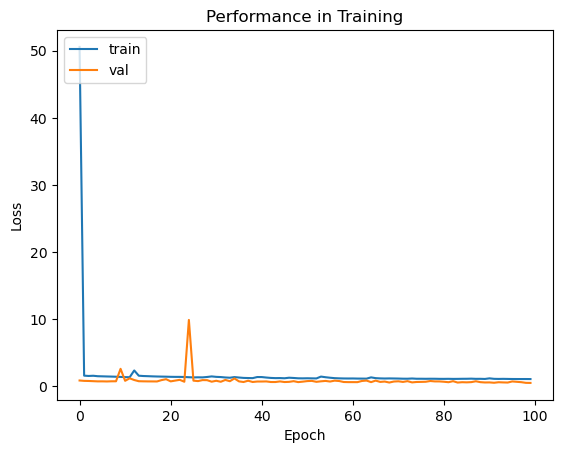

In [31]:
net1 = CDNN(hist=4)
net1.to(device)

optim = torch.optim.Adam(net1.parameters(), lr=1e-3)

exp1 = Experiment(name="BezenacSqErr_100",                 # de Bezenac model, trained on err^2 Loss
                  trainset=training_loader,                # data loaders: 1. training
                  valset=val_loader,                       #               2. validation  
                  testset=None,                            #               3. testing
                  model=net1,                              # model 
                  regloss=False,                           # whether to regularize the training loss 
                  test_loss=nn.MSELoss(reduction="mean"),  # loss function for testing
                  optimizer=optim,
                  outdir=path)

exp1.run(epochs=100)

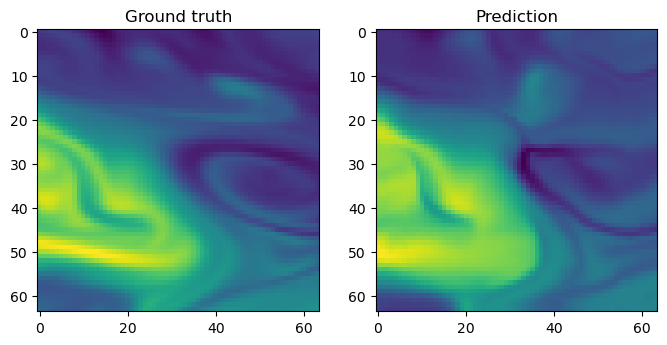

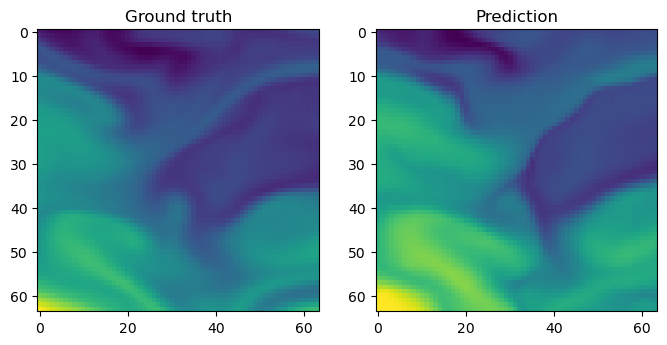

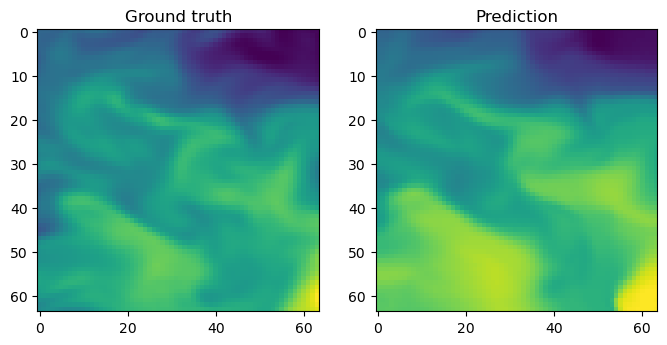

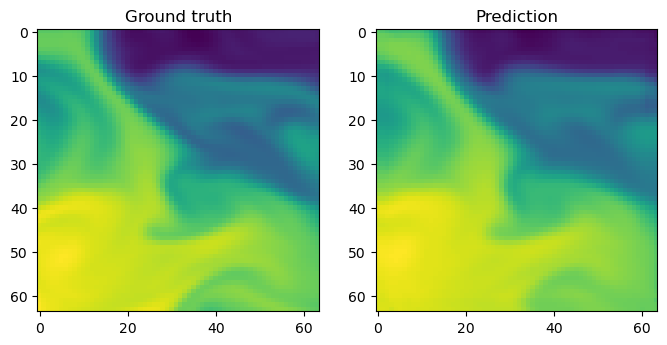

In [32]:
exp1.visualize_examples(example_loader)

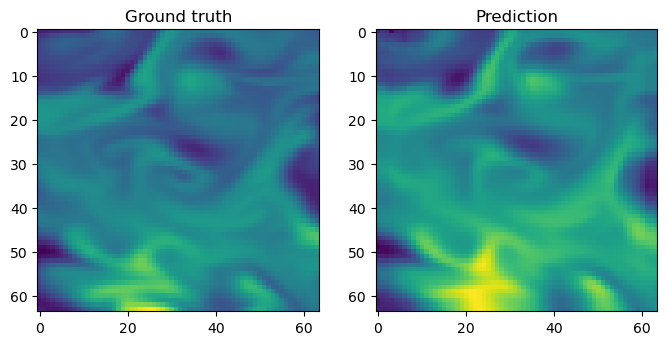

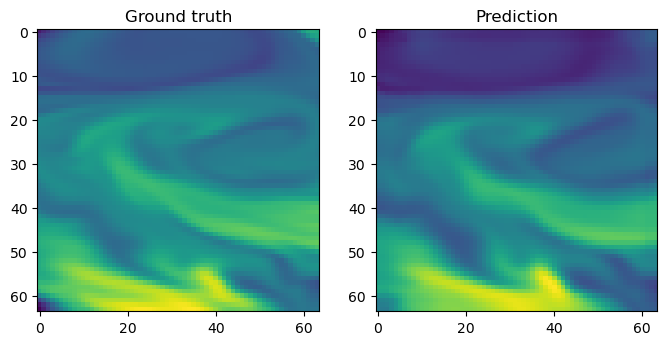

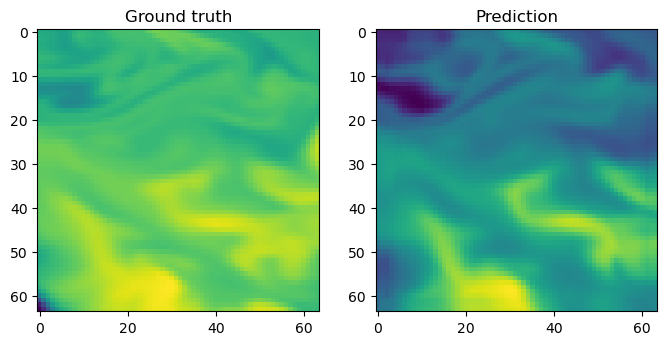

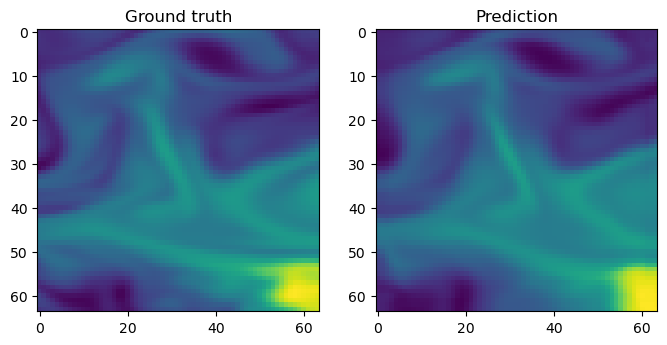

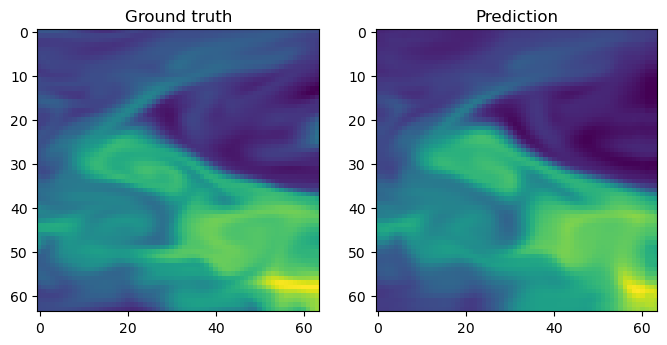

...

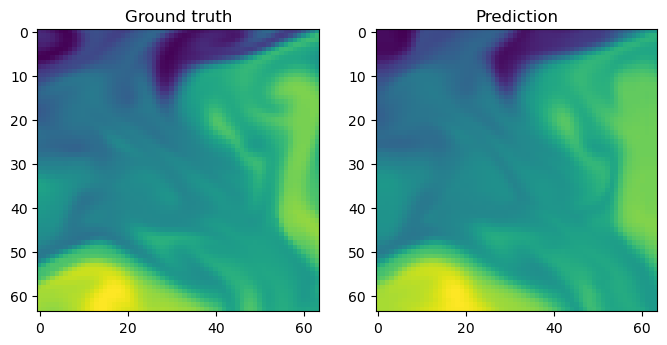

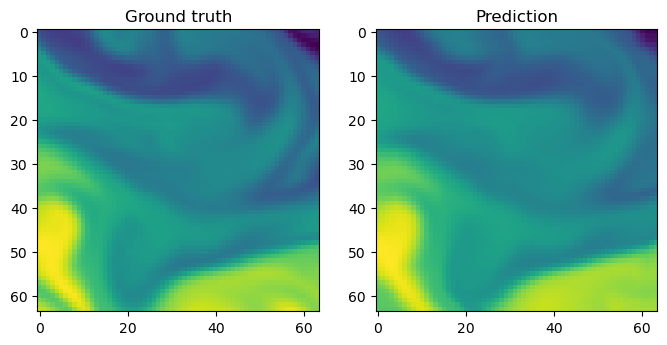

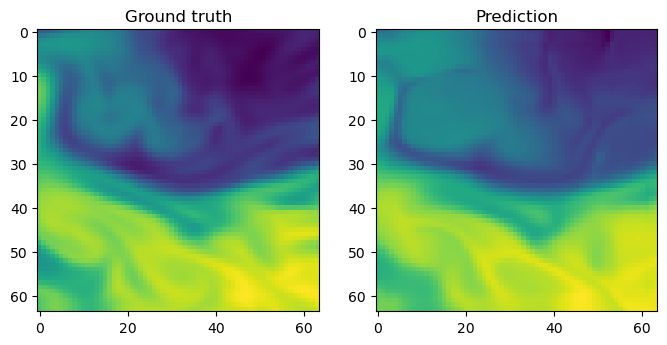

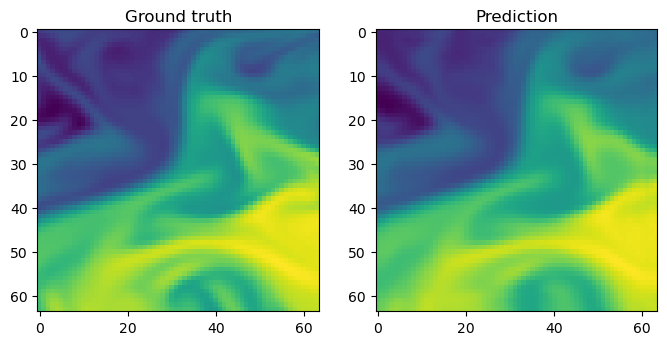

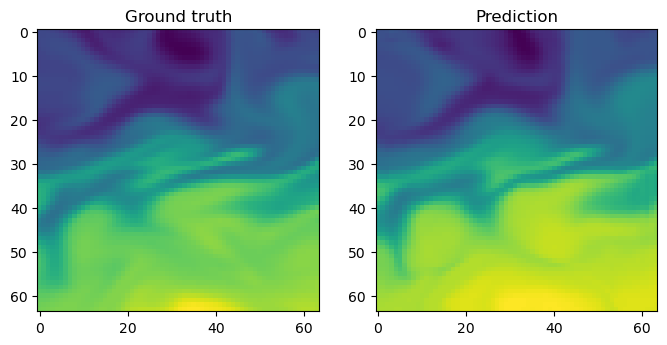

In [56]:
exp1.visualize_examples(val_loader)

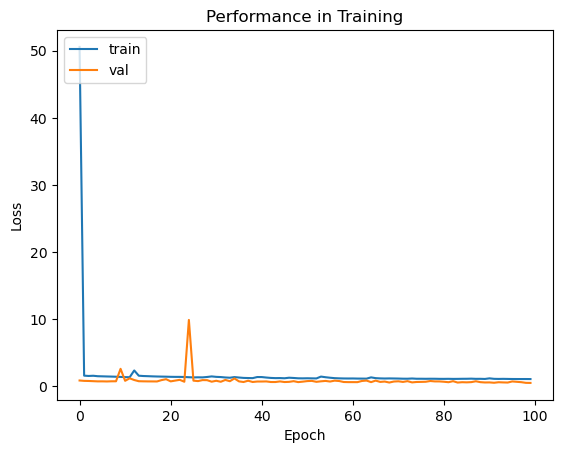

In [36]:
#exp1.plot_loss("Performance in Training", "Epoch", ["train", "val"])
exp1.plot_loss([exp1.train_losses, exp1.val_losses], "Performance in Training", "Epoch", ["train", "val"])

### Training with Regularized Squared Error Loss

In [28]:
net2 = CDNN(hist=4)
net2.to(device)
optim = torch.optim.Adam(net2.parameters(), lr=1e-3)

exp2 = Experiment(name="BezenacRegSqErr_100",               # de Bezenac model, trained on err^2 Loss
                  trainset=training_loader,                 # data loaders: 1. training
                  valset=val_loader,                        #               2. validation 
                  testset=None,                             #               3. testing  
                  model=net2,                               # model with 4 days of history
                  regloss=True,                             # whether to regularize the training loss 
                  test_loss=nn.MSELoss(reduction="mean"),   # loss function for testing
                  optimizer=optim,
                  outdir=path)

exp2.run(epochs=100)

Created new directory to save model states and results: /projectnb/labci/Lucia/rainfall-pde-ml/experiments/2023-09-26/BezenacRegSqErr_100
Running experiment: BezenacRegSqErr_100...
Training over 100 epochs...
Epoch 0
-------------------------------
Step: 0 Loss: tensor(3041.7397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(3882.1379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(6095.3218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(2316.0396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1396.1553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(602.6349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(970.1797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(741.5523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(81.7481, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(173.4054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(101.9

Step: 113 Loss: tensor(1.0569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.5747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(1.6066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(2.3199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.6179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(2.3246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(2.4035, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(1.2905, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.3177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.8932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(2.1280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(1.7738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(1.4101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(2.0366, device='cuda:0', grad_fn=<AddBack

Step: 227 Loss: tensor(1.0078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.9021, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(1.6999, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(1.6623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(1.8925, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.6863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.4462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(1.2166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(1.3168, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.2878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(2.0225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(1.1911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.8632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(1.3807, device='cuda:0', grad_fn=<AddBack

Step: 341 Loss: tensor(2.2913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(1.0951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(1.9513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(1.9013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(0.6283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(0.7267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.2496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.0888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(2.8576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.9077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(1.9150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(0.8769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(1.7459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(1.3739, device='cuda:0', grad_fn=<AddBack

Step: 455 Loss: tensor(1.4745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(1.5968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(2.8486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.7796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(1.5527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(1.6525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(2.1664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.3996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(1.3074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(1.5055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(1.7543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(0.9379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(1.2338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(1.6768, device='cuda:0', grad_fn=<AddBack

Step: 569 Loss: tensor(1.3196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.6668, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(1.2206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.7148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(1.4816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.2181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(1.0521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(1.5799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(2.3906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(1.2985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(1.6750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(1.7680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(1.1760, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(2.0414, device='cuda:0', grad_fn=<AddBack

Step: 683 Loss: tensor(0.9570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(2.1652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(1.4591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(1.2289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.6109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(1.1942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(1.8934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(2.0068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(1.0486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.9040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(1.1278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(2.0937, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(1.3406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(1.5062, device='cuda:0', grad_fn=<AddBack

Step: 797 Loss: tensor(1.7904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(0.8757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.7973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(0.9193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(1.4472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(1.3336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.1650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(1.4689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.0662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.7372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(2.1669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(1.0066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.9341, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(1.0478, device='cuda:0', grad_fn=<AddBack

Step: 17 Loss: tensor(1.1549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(1.4343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(1.4034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(2.1790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(2.7466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.2508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(2.0063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(2.1422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(1.6436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(1.0697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(1.0636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(0.8442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(2.1937, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.4481, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 133 Loss: tensor(1.3171, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.9146, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(1.6688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(1.8809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(1.0237, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(2.9024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.6253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(2.1734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(0.7123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(2.7948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(1.9189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(1.2457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(1.4723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(2.9095, device='cuda:0', grad_fn=<AddBack

Step: 247 Loss: tensor(1.9299, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.1185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.6011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(1.8597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(1.4044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.8835, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(2.1343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.9906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(2.0112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.1394, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(2.3575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(1.1577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(1.2022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(1.0196, device='cuda:0', grad_fn=<AddBack

Step: 361 Loss: tensor(1.3569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(2.2204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.0209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(0.6644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(1.2518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(1.0216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(1.4352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(1.1169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(1.2721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(1.3138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.9090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(1.0720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(0.9429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(0.9227, device='cuda:0', grad_fn=<AddBack

Step: 475 Loss: tensor(2.2078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(3.6315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(1.1594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.1642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(1.4797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(1.5770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.7562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.4845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(1.0284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.7314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(2.0575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(0.9572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(1.1423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(1.2275, device='cuda:0', grad_fn=<AddBack

Step: 589 Loss: tensor(1.2293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(1.1083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(1.9230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(1.5799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(1.2389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.8850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(0.9917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.7606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(1.2255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.2921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.0965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.5080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.6604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.7553, device='cuda:0', grad_fn=<AddBack

Step: 703 Loss: tensor(1.4263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.2192, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(1.7450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(0.8744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(0.9721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.9352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.4024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(0.8921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(1.1002, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.1245, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(1.5860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(1.0722, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(1.2640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.2022, device='cuda:0', grad_fn=<AddBack

Step: 817 Loss: tensor(1.5914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(2.3289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.8660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(1.9429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(1.0965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(0.9771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(0.9897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(1.2798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(1.2262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(2.0487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(1.1690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(2.0588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(0.8307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(1.4068, device='cuda:0', grad_fn=<AddBack

Step: 37 Loss: tensor(1.2351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.0097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(1.0927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(1.4364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(1.0466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.5405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(1.6070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(1.5607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(1.4104, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(1.1650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(1.2222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.3672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(0.8638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(1.1962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 153 Loss: tensor(1.6138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(0.9543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(1.1560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(0.8763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.1346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.4495, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(2.4358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.0358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.3697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.3145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(1.2466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(2.0526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(1.4213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(2.0607, device='cuda:0', grad_fn=<AddBack

Step: 267 Loss: tensor(1.8984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(2.6551, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(1.9840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.6013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(1.9699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(1.1628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(1.8263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(1.5020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(2.3203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.7010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(1.1626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.9074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.2097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(2.7299, device='cuda:0', grad_fn=<AddBack

Step: 381 Loss: tensor(1.5175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(0.8900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.8712, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(3.0223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.6926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(1.9553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(1.0183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.7953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.7766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.6068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(1.4126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(1.2353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(1.1183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.4792, device='cuda:0', grad_fn=<AddBack

Step: 495 Loss: tensor(1.3942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.1732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(1.6640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(1.1475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(1.4001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(1.1091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(1.8314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(1.6357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.8801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(1.2258, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(1.4964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(1.7777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(1.4402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(1.5256, device='cuda:0', grad_fn=<AddBack

Step: 609 Loss: tensor(1.0962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.6646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(1.8764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(0.8701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(1.6456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(1.5277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(1.9876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.4929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.8950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.8608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(0.8965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(2.4438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.4286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(1.2807, device='cuda:0', grad_fn=<AddBack

Step: 723 Loss: tensor(2.5833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(1.5205, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(2.1630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(2.0234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(1.2706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.9081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.5257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(2.5287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(0.7927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.0550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(2.6464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(1.2259, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.7081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.1380, device='cuda:0', grad_fn=<AddBack

Step: 837 Loss: tensor(1.3072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.9098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.3014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.1939, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(1.0332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.0163, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.9227, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(1.9143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(0.9044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.1127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(1.0240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(1.2177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.3571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.4609, device='cuda:0', grad_fn=<AddBack

Step: 57 Loss: tensor(2.1882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(2.0744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.0861, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(1.3204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(2.1830, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(1.1853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(0.8806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.1256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(1.1855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.9677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(1.1106, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(1.2013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(4.6084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(1.2422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 173 Loss: tensor(1.2469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.2368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(0.6918, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.2648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(1.1151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.5624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.6750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.6593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(0.7946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.3201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(2.4761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(2.0919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.9817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(1.1466, device='cuda:0', grad_fn=<AddBack

Step: 287 Loss: tensor(0.7647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.5867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(0.9355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(2.0189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(0.7886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(1.8912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(1.5285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(0.8278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.4915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(0.7276, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(1.1347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(1.1630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.0760, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.6740, device='cuda:0', grad_fn=<AddBack

Step: 401 Loss: tensor(2.2455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.0850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(2.6627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(1.5442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(0.8707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.1066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(1.1164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(0.7528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(0.7479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.2702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(0.8566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(2.6031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.7272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(2.3158, device='cuda:0', grad_fn=<AddBack

Step: 515 Loss: tensor(0.9913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.4065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(1.6038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(0.9829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(1.0619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(1.1897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(1.1014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(1.3513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(1.4740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(2.1783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(1.2220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(1.1240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.9954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(1.1707, device='cuda:0', grad_fn=<AddBack

Step: 629 Loss: tensor(1.0398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.7737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.2649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(1.3502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(0.9624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(1.5177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(2.3538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(2.1574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.2593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.0597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(1.2179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(0.9223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(2.1830, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.8699, device='cuda:0', grad_fn=<AddBack

Step: 743 Loss: tensor(1.8658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.6667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(1.7526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.5582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(1.5218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(1.3140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(1.7512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(0.9519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(1.7807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.1158, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(1.7704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.1751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(1.1001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(0.8626, device='cuda:0', grad_fn=<AddBack

Step: 857 Loss: tensor(1.1631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(2.0060, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(1.8710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.7152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(1.6095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(1.2085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(1.6571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(1.1904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.2465, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(1.1454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.1877, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(0.7444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.8281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(2.1326, device='cuda:0', grad_fn=<AddBack

Step: 79 Loss: tensor(2.1643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(1.3783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(1.5693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(1.7224, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(1.1815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.4610, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(0.8975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(1.1177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(2.4556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(1.5052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(1.3607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.0133, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(1.7786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.5137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 195 Loss: tensor(0.8795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(2.5696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(1.0863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(1.0629, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.2867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(1.2365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.5677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(1.4175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(1.0335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(3.0185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.9284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(1.7085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.3755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(1.0324, device='cuda:0', grad_fn=<AddBack

Step: 309 Loss: tensor(1.3298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(1.6832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(1.1204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.6049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(1.5141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(0.7705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.9125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.5743, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(2.3096, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.4227, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(1.4278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(2.1095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(1.2006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.8911, device='cuda:0', grad_fn=<AddBack

Step: 423 Loss: tensor(1.8237, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(2.6255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(1.0611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(1.6189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(0.8271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(1.1769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(0.9033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(0.9153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.0304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(1.4410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(2.3499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(1.5620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(1.5978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(1.6171, device='cuda:0', grad_fn=<AddBack

Step: 537 Loss: tensor(1.1103, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(0.6429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.0991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.2625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(1.8370, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(1.7181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(1.1178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.4120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.9749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(2.4541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(2.1040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.6992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(0.8413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(0.9953, device='cuda:0', grad_fn=<AddBack

Step: 651 Loss: tensor(2.0668, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.6080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(1.4518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.8408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(1.6005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(0.9045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(0.9686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.8767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(1.2219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.0549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(0.9154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(0.7511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(1.5785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.7057, device='cuda:0', grad_fn=<AddBack

Step: 765 Loss: tensor(1.4927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(0.7241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(1.2494, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(1.5854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(1.6407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.8396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.5320, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.1427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(1.4179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(1.0535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(0.8731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(1.0871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(0.9772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.3974, device='cuda:0', grad_fn=<AddBack

Step: 879 Loss: tensor(3.1667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(1.5456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.4356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(1.8604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(1.5928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(1.3185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(1.8881, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(1.6806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(1.2725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.9398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.3098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.8796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(1.3918, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(4.9234, device='cuda:0', grad_fn=<AddBack

Step: 101 Loss: tensor(1.4344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(1.8249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(1.6791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(2.7065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.7177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(0.9523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(1.4316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(1.6367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(1.2344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(0.6782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(1.8934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(2.4709, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(1.1656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.7956, device='cuda:0', grad_fn=<AddBack

Step: 215 Loss: tensor(0.9041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(0.8033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(2.1001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(0.8667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(1.0206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.3863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.2323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(0.6614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(2.1853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.7721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(1.5546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(1.1809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(2.4272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.9737, device='cuda:0', grad_fn=<AddBack

Step: 329 Loss: tensor(1.0335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.0724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(1.7065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(1.5384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(0.9059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(1.4915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.8979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(0.6960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(0.8605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(0.8299, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.0934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(0.9322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.7111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(1.9743, device='cuda:0', grad_fn=<AddBack

Step: 443 Loss: tensor(0.7055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(0.8022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(1.3989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(1.0362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(0.8938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(2.9268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(1.5994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(0.7141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.9619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.1504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(0.9172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(2.1601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(0.9499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.5495, device='cuda:0', grad_fn=<AddBack

Step: 557 Loss: tensor(1.2354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(1.7697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(1.2767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.6416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(1.1284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.9706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(1.3907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(1.4878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(1.4649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.4606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(1.2597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(1.1381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(1.2487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.4768, device='cuda:0', grad_fn=<AddBack

Step: 671 Loss: tensor(2.5014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(0.9472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(1.7320, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(1.2603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(3.0117, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.9531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(2.6536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.6518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(1.9502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(0.6467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(1.6948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(1.2822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(1.8678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(0.9696, device='cuda:0', grad_fn=<AddBack

Step: 785 Loss: tensor(0.7542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(1.1516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(1.0745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(1.1779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(0.9773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(1.2479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.8829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(0.9506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(2.1236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(1.5138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(1.7744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.1645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(2.2674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(2.0309, device='cuda:0', grad_fn=<AddBack

Step: 5 Loss: tensor(0.7461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(1.5448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(4.0960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(0.9605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.3817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(1.2580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(1.4239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(1.5864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(1.7441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.4145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(1.0818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(2.0487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(0.7981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(1.1515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Lo

Step: 121 Loss: tensor(1.6423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.4488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(1.9717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.8588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.7477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.4781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(1.3873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(1.5526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(1.0547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(0.9455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.7842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.2995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(0.8139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(1.1351, device='cuda:0', grad_fn=<AddBack

Step: 235 Loss: tensor(1.7749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.2409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(1.0097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.8818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(0.8535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(1.3838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(1.2640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(1.8602, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(1.3677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.0054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(1.1819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.4742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(1.3569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(3.2610, device='cuda:0', grad_fn=<AddBack

Step: 349 Loss: tensor(1.1036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(0.9038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(0.9872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.1290, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(1.0232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(1.8794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(0.8455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(0.8944, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(4.2804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.9695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(1.2493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(1.1369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(0.8036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(1.9884, device='cuda:0', grad_fn=<AddBack

Step: 463 Loss: tensor(1.5241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.9302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(0.6150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(1.2779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(0.9201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(1.4863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(1.3236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(1.2491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(1.4283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.6835, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(2.2522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(1.4640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(1.9557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.7294, device='cuda:0', grad_fn=<AddBack

Step: 577 Loss: tensor(1.6879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.9745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(2.1494, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(1.0236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(0.9561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.9567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(0.8301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(0.9376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(1.0034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.5679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(1.0170, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(1.6463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(0.7270, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(1.2638, device='cuda:0', grad_fn=<AddBack

Step: 691 Loss: tensor(1.2669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(0.7484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(3.6391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(1.2183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(2.8048, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.7751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(1.7809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(0.9134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(2.4345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(1.2835, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(1.6253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(1.0875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(1.4609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.1274, device='cuda:0', grad_fn=<AddBack

Step: 805 Loss: tensor(1.9748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.9027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(1.0103, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(1.4188, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(1.2652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(0.8998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(1.3220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.0531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(1.3404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(2.9936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(1.6831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(1.1731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.6226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(1.3263, device='cuda:0', grad_fn=<AddBack

Step: 25 Loss: tensor(1.8740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.9808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(1.4241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(0.8671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(0.8365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.1819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(1.2007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(0.9978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(0.9499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.1305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(1.3882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(2.7870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(1.2126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(0.6874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 141 Loss: tensor(0.9756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(4.3017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(0.9804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(1.5050, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(2.1501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.4405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(1.1424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(1.4421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(1.6199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(0.8705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(2.2775, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(1.8733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(1.4840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.3340, device='cuda:0', grad_fn=<AddBack

Step: 255 Loss: tensor(0.8585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.3690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(0.9128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(1.7643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(1.9272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(2.4868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(1.2374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(1.2386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(1.6916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(2.1382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(3.0826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(0.9287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(1.3715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(1.1375, device='cuda:0', grad_fn=<AddBack

Step: 369 Loss: tensor(3.2324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(0.8494, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(1.3935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(2.1654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(1.6520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(0.9603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(1.9213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(1.7437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(1.0574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(1.2538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(2.4651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(0.7133, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(1.1376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(1.2390, device='cuda:0', grad_fn=<AddBack

Step: 483 Loss: tensor(1.4503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.5453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(2.8072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(1.4094, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(0.9371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.8143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(1.0724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(1.7926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(1.2685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.6063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(2.3293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(0.9633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(1.2421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.5143, device='cuda:0', grad_fn=<AddBack

Step: 597 Loss: tensor(1.1054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.1607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.0769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.5027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.3860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(1.4259, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(0.9021, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(1.3403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(1.5359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.2387, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(1.4090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(1.7657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(0.9521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.5647, device='cuda:0', grad_fn=<AddBack

Step: 711 Loss: tensor(0.8589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.3930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(1.9228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(1.4283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(1.2553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.0422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(1.3866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(37.7736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(151.1046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(148.8016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(775.0239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(1707.6278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1080.2296, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(142.1987, device='cuda:0', g

Step: 825 Loss: tensor(2.2735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(2.1055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(1.7986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(1.8376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(2.1762, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(1.0898, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(1.4018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(2.0159, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(1.3580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(1.8174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(1.7706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(1.7952, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(1.0690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.9161, device='cuda:0', grad_fn=<AddBack

Step: 45 Loss: tensor(1.5299, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(1.9618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(1.4140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.2718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(1.4006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(1.7025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(2.4747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(1.3738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(1.8978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(4.5477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(2.8910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(1.4890, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(1.9500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.0556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 161 Loss: tensor(1.2229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.4705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(0.7593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(1.8638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(1.1063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(1.8456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(2.0106, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(1.5108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(1.2091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(2.8272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(1.3523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(1.2798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(0.8084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.7424, device='cuda:0', grad_fn=<AddBack

Step: 275 Loss: tensor(1.1824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.2085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(1.2579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.2632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.1124, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(0.6497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(1.4263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(1.8827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(1.1614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(1.8447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(1.2620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(1.3904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(2.8583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.5154, device='cuda:0', grad_fn=<AddBack

Step: 389 Loss: tensor(0.8716, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.6412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(1.0071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(1.2319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(1.8569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.9250, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(1.5217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(0.9769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(0.9438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.3880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(2.3517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(0.9484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(1.2960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.7919, device='cuda:0', grad_fn=<AddBack

Step: 503 Loss: tensor(1.2661, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(1.2471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(1.2660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(2.8165, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(1.7455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.9847, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(1.1973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(1.4805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(1.2399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(2.6121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(2.1327, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(1.8295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(1.3123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.9882, device='cuda:0', grad_fn=<AddBack

Step: 617 Loss: tensor(1.3143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.6067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(1.7604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(1.1091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.2824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(2.3724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(0.8298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(0.6409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.2229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.6971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(1.0419, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(0.8377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(1.9175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(1.2704, device='cuda:0', grad_fn=<AddBack

Step: 731 Loss: tensor(1.6365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.3512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(1.2719, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(1.7084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.2173, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(2.0796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(1.6428, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(2.0717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(0.9652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(1.3816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.7296, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(2.1975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(4.1944, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(0.8598, device='cuda:0', grad_fn=<AddBack

Step: 845 Loss: tensor(1.4260, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.1220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(0.8894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(1.2693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.3694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.6364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(1.5964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(1.8435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(1.9788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(1.4343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.3856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(0.8862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(1.2856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.6883, device='cuda:0', grad_fn=<AddBack

Step: 67 Loss: tensor(1.1978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(1.8177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(0.6814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(1.0145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 71 Loss: tensor(1.5885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.4281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.9967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(1.7566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(1.0716, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.5697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(0.8899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(2.7633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(1.1398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(1.2739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 183 Loss: tensor(0.6951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(1.3268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.5498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(0.7810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(2.3194, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(1.7732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(1.1875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(1.2456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(1.3747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.1064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(0.9383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(1.6608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(1.1816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.7203, device='cuda:0', grad_fn=<AddBack

Step: 297 Loss: tensor(1.1070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(0.9831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.1487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.3109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(1.4992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(1.3887, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(2.0383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(2.0238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(0.9662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(1.6338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(0.9058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(1.0317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(0.7068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(1.1402, device='cuda:0', grad_fn=<AddBack

Step: 411 Loss: tensor(1.1244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(1.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.8543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(1.7577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(1.2838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(1.5858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(2.3720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(2.5257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(1.5755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(1.2696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(1.5418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(1.4463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.0229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.9820, device='cuda:0', grad_fn=<AddBack

Step: 525 Loss: tensor(1.0854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(1.5465, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(0.9019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.7808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(3.4354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(1.1398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(1.7565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(1.3871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(0.9033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(2.9355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(1.6451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(2.4900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.1175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.4534, device='cuda:0', grad_fn=<AddBack

Step: 639 Loss: tensor(1.3995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(1.6288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(1.9679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(1.4355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(1.0856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(1.2127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(1.4325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(1.5220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(1.5395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.9042, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(1.2407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(1.8391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(1.0868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.4054, device='cuda:0', grad_fn=<AddBack

Step: 753 Loss: tensor(1.3979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.5088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(1.4404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(1.1844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(1.8202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(0.6995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(1.0275, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(0.8793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(1.0982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(1.4366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.2652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(1.6315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(1.7305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.1647, device='cuda:0', grad_fn=<AddBack

Step: 867 Loss: tensor(0.8368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.3721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(2.6318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(1.0196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(1.2846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(1.1328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(2.2784, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(2.6570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(1.3807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(1.4571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(0.9100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(1.7085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(0.8375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(1.1207, device='cuda:0', grad_fn=<AddBack

Step: 89 Loss: tensor(1.6154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.1760, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(1.2172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.6377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(1.7655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(2.5075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(1.0391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(1.4734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(0.9442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(1.3389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(1.4867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.7168, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(1.2193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(1.5070, device='cuda:0', grad_fn=<AddBackward0>)
Ste

Step: 203 Loss: tensor(1.2641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(1.2672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(1.0097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(1.1278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.6923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(1.2673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(2.8464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(0.6944, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(1.8859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(0.9805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(1.7706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(1.1662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.3248, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.4625, device='cuda:0', grad_fn=<AddBack

Step: 317 Loss: tensor(1.5308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.6932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(0.9454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(1.1321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(1.0046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(1.3572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(2.3607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(1.2536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(1.0312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(1.0482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.6448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.9948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(1.2440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(2.8768, device='cuda:0', grad_fn=<AddBack

Step: 431 Loss: tensor(2.4189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(1.7452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(2.2915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(1.9676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(1.1263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(1.0381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(1.5278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(1.7207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(1.6499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(1.2082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(1.2400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(1.1429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(2.7090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(0.5771, device='cuda:0', grad_fn=<AddBack

Step: 545 Loss: tensor(1.3845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.2297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(1.6118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.7412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(1.1670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(0.9333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.9436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(1.7047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(1.5731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.9793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(0.7673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(2.3998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(1.6225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(2.3025, device='cuda:0', grad_fn=<AddBack

Step: 659 Loss: tensor(0.8401, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.0000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(0.9990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(1.7330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(1.2105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.5083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(1.3173, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(1.3562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(1.5607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.7988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(0.6224, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(1.2200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(1.3576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.4549, device='cuda:0', grad_fn=<AddBack

Step: 773 Loss: tensor(0.7959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(0.8111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.8523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(1.3703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(1.0169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(2.1157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(1.0421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(1.2341, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(1.6429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.3123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.8974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(2.1311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.5126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(1.1364, device='cuda:0', grad_fn=<AddBack

Step: 887 Loss: tensor(1.1539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(1.2577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.2442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(1.6872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(1.7112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(1.1401, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.47548
Validation Loss:  0.77903
Epoch Runtime: 0:02:30.061422
Saved checkpoint at epoch 10
Epoch 11
-------------------------------
Step: 0 Loss: tensor(1.1178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.9912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(1.7560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(1.6755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.4958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(1.0349, device='cuda:0', grad_fn=<AddBackwa

Step: 109 Loss: tensor(1.4515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.7283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(1.1597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(1.4716, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(0.9537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(2.2217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(2.2023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(1.7967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(2.0571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(1.6938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(0.8507, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(1.3126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.2843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.3826, device='cuda:0', grad_fn=<AddBack

Step: 223 Loss: tensor(2.5687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(1.1858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(2.0726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(1.2536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(2.9889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.6730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(2.0876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.9721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(2.8578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.1467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.1561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(1.5331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(1.1330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.2588, device='cuda:0', grad_fn=<AddBack

Step: 337 Loss: tensor(1.0501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.4752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.4805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(1.5455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.6128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(2.1471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(1.3921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(2.1606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(1.6550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.5069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(2.5278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(0.7634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(1.6059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.7700, device='cuda:0', grad_fn=<AddBack

Step: 451 Loss: tensor(1.0399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.1763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(1.6047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.4193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(1.0737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(1.1376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(1.4422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(3.0964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(1.9584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(3.1880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(1.0214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.8796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(1.6384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(1.1329, device='cuda:0', grad_fn=<AddBack

Step: 565 Loss: tensor(1.0651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.3612, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(2.5866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(1.3339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(1.5336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.4913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(2.0199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.7086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(1.4054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.4305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(1.0409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(1.0978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(1.8782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(1.0324, device='cuda:0', grad_fn=<AddBack

Step: 679 Loss: tensor(1.7439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.7350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.9990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(1.8849, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(1.1667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(1.1681, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.6519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(0.8972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.0625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.6544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(1.9321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(2.5866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.7929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(2.7730, device='cuda:0', grad_fn=<AddBack

Step: 793 Loss: tensor(1.4414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(1.1527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(1.1511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.2402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(1.4850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.3760, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(1.4281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(1.7710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(1.1951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(1.8663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.3431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(1.2484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.0364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(1.8498, device='cuda:0', grad_fn=<AddBack

Step: 13 Loss: tensor(1.2965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(2.0462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.7177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(0.8147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(2.2679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(2.0348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(1.7028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(2.2338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(1.3050, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.5633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(2.5757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(1.6912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.7806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(1.3742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 129 Loss: tensor(0.9247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(2.3386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.9079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.1842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(1.4842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.9307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(1.0554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(3.3240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(1.5814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(2.6068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.5107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(1.8010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(1.3157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(0.9906, device='cuda:0', grad_fn=<AddBack

Step: 243 Loss: tensor(1.8582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(2.3257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(1.1034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.4721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(1.6808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.3675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.1690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.9582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(0.9280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(1.6315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(0.8796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(1.5333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.9805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(2.0767, device='cuda:0', grad_fn=<AddBack

Step: 357 Loss: tensor(1.6974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.2395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(1.4837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(0.5863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(1.1692, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(1.9218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(2.0242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(1.3589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(1.3946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(1.5888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(1.5374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.9701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(1.1790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(1.5778, device='cuda:0', grad_fn=<AddBack

Step: 471 Loss: tensor(1.1461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.7736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(1.1397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(2.4785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(1.4783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(1.9075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(1.1918, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(0.9470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(1.4979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(1.2475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.0820, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.5389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(0.7189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(2.1756, device='cuda:0', grad_fn=<AddBack

Step: 585 Loss: tensor(1.9646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.2977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(1.6664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(1.4276, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(1.2440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(1.4975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(1.8035, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(1.8853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(0.9433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.9554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(3.3212, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.3150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(0.8843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.5314, device='cuda:0', grad_fn=<AddBack

Step: 699 Loss: tensor(1.7422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(1.4540, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(1.4325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(2.0884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(1.1800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.1471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(2.2634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(1.6225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(3.0376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(1.6097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.6088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(2.0921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(2.0505, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.0233, device='cuda:0', grad_fn=<AddBack

Step: 813 Loss: tensor(1.1600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.8573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(2.6063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(1.3816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.5129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(0.8456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.1466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(1.0583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(1.2903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.0060, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(1.1675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(1.7697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(1.4321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(1.6823, device='cuda:0', grad_fn=<AddBack

Step: 33 Loss: tensor(0.8347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.7592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(1.3055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(0.8786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(1.2098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.1405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(1.5675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(2.2676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(1.1023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.0473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(1.0758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(1.8736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(1.5028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(1.6195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 149 Loss: tensor(2.5177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(1.2579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(2.5575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(0.9948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(1.4697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.4947, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.8074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(1.1937, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(0.9982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.1903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.3945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.4779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.1621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.1861, device='cuda:0', grad_fn=<AddBack

Step: 263 Loss: tensor(1.9376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(1.2457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(1.7450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(1.5930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(1.8676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(2.1493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(2.5253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.8145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(1.6526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(1.5371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(1.5210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(1.2976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.2884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.5264, device='cuda:0', grad_fn=<AddBack

Step: 377 Loss: tensor(1.2113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(1.4522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(1.4459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(1.6279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(2.2498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(0.8169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.4187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(1.5717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(1.1577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(1.6422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(1.6973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.9571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(1.2238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.3872, device='cuda:0', grad_fn=<AddBack

Step: 491 Loss: tensor(1.7709, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(1.4708, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(2.1388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(1.4146, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(0.9797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.4903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(0.9068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(1.3345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(1.4972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(1.4769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(2.4039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(1.1077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.7466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(1.4583, device='cuda:0', grad_fn=<AddBack

Step: 605 Loss: tensor(1.5982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.0622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(0.9288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(1.6883, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(1.2328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.8300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(1.5644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(1.5295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(1.0943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(1.2362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(2.9643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.2764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.0022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.4646, device='cuda:0', grad_fn=<AddBack

Step: 719 Loss: tensor(1.2641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.6178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(0.9901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(0.9422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1.0331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(0.9312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(2.4919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(2.1326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(2.0833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(2.2418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.1091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(0.8569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(1.0824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.9665, device='cuda:0', grad_fn=<AddBack

Step: 833 Loss: tensor(1.0939, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(1.3600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(0.9134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(1.4210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(1.4422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.7003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(0.9792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(2.4344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(1.4676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.6414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(0.7097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(2.0904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(0.8407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.5409, device='cuda:0', grad_fn=<AddBack

Step: 53 Loss: tensor(1.1354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.7955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(1.3157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(1.2132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(0.9382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.2646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.3783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(0.7351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(1.0065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(1.3672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(1.1664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.3115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(1.2885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(1.0510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 169 Loss: tensor(1.7000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(1.8158, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(2.0125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(1.1896, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(1.1447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.3355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(1.0007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.5197, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(1.8783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(2.8034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.4010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(2.7468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(1.1452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.5592, device='cuda:0', grad_fn=<AddBack

Step: 283 Loss: tensor(1.0803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(1.6715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(1.7675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(0.7979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(0.9736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.3771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.0966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(0.9931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.5643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.9129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(1.3067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(1.9232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.4801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(1.6317, device='cuda:0', grad_fn=<AddBack

Step: 397 Loss: tensor(0.7994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.7467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(2.0581, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(2.1305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(1.7328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.2721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(3.5137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(1.4996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(0.9322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.0669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(2.4362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.2438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.2814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.2560, device='cuda:0', grad_fn=<AddBack

Step: 511 Loss: tensor(1.4690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(1.3542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(3.4503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(1.0603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(1.5311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.7175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(1.0737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(1.0006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(2.1745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(2.6564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(1.4623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(1.6959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(0.9933, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(1.9671, device='cuda:0', grad_fn=<AddBack

Step: 625 Loss: tensor(1.4167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(0.8879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(1.5280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(1.3056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(0.9903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(1.6628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.1484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(0.7438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(0.7733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(1.5507, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(1.1651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(0.9872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.1288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.5257, device='cuda:0', grad_fn=<AddBack

Step: 739 Loss: tensor(1.2127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(1.4280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.6726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(1.8110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(0.9435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.6859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(1.4680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.0302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(0.8538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(1.6164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(1.2525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(1.1835, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(1.3509, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.3255, device='cuda:0', grad_fn=<AddBack

Step: 853 Loss: tensor(1.7825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(1.3545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.5898, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(1.3278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(1.2422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.4482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(1.2300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.8072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(1.0894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(1.5132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(0.9060, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(1.0785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.5875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(1.7896, device='cuda:0', grad_fn=<AddBack

Step: 75 Loss: tensor(1.1878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.5097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(0.9520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(0.9700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(1.2878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.8965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(1.0051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(0.8160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(3.4279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.2718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(1.3863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(1.6595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(0.9545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(1.1547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 191 Loss: tensor(1.2743, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.9693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(1.6402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(1.6645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(1.2068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.3698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(1.3892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(1.5493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.1577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(0.8730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.2162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(1.1232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(1.1963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(1.4466, device='cuda:0', grad_fn=<AddBack

Step: 305 Loss: tensor(1.1058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(1.1633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(0.8851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(2.0225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(0.9815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(1.2431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(1.1509, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(2.3570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(1.3595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.9196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(1.1257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(0.9440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(1.6619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.9438, device='cuda:0', grad_fn=<AddBack

Step: 419 Loss: tensor(1.5015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(1.2084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(1.0228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(0.9959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.6826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(1.1792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(1.9048, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(1.7949, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(1.2310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(2.3841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(0.9244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(1.1183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.1795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(2.0708, device='cuda:0', grad_fn=<AddBack

Step: 533 Loss: tensor(3.0788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.8185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(1.0045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(0.8368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.2700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.3791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.2655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(0.5535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(1.0243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(1.7123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(2.5036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.9909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(1.1167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.0931, device='cuda:0', grad_fn=<AddBack

Step: 647 Loss: tensor(1.1667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.6885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(0.8200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(1.4392, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(1.3402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.3808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(1.1161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.3505, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(0.9585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(1.0763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(1.1422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(2.3147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(1.3130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.2611, device='cuda:0', grad_fn=<AddBack

Step: 761 Loss: tensor(1.8207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(2.0477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.2639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(1.3454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(1.1643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(2.0833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(0.9373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(1.0634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.8127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.4209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.3038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.1367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(2.1733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(2.2652, device='cuda:0', grad_fn=<AddBack

Step: 875 Loss: tensor(0.6598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(1.5713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(1.4089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(1.5186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(2.6819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(1.1886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.4594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(1.1893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(1.7502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.7490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(1.5208, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(1.1274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(1.9008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(2.0180, device='cuda:0', grad_fn=<AddBack

Step: 97 Loss: tensor(1.0525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(1.2677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(0.7451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.6243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(1.8092, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(1.4517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(1.7609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(0.8629, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.0544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(0.8700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(0.9734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(1.1058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(0.6497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.4188, device='cuda:0', grad_fn=<AddBackwar

Step: 211 Loss: tensor(0.8863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(2.0545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(1.0690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(1.0356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.3957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.3147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.3318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(0.9527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(2.2738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.8774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.4833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(1.1089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(1.9702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(1.3487, device='cuda:0', grad_fn=<AddBack

Step: 325 Loss: tensor(1.0591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(0.9547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.8435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.7654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(0.7617, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.6074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(2.1218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(0.9713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(0.7529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.8090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(1.0450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(1.4592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.3234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(0.7905, device='cuda:0', grad_fn=<AddBack

Step: 439 Loss: tensor(0.8439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.9792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(1.6882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(0.7576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(1.1345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(0.9576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(2.2054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(1.4770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(0.6507, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(1.4172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(1.7054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(1.1708, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(2.4439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(0.7506, device='cuda:0', grad_fn=<AddBack

Step: 553 Loss: tensor(2.1872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(2.6658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(2.4311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.5437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(1.7725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(1.0180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(1.6497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.6467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(1.1294, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(1.0526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(1.6144, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(1.6819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(1.8750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.4175, device='cuda:0', grad_fn=<AddBack

Step: 667 Loss: tensor(0.8857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(1.0862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(1.3609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(1.1295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(1.2172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.2426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(0.8065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.6862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(1.1517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.9397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(1.2262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.0471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(0.8802, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.5577, device='cuda:0', grad_fn=<AddBack

Step: 781 Loss: tensor(1.3638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.4011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.7989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(1.1091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.2461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.8881, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(1.0135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(2.1137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(0.8577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(3.2470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.6484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(1.2513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.0497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.9578, device='cuda:0', grad_fn=<AddBack

Step: 1 Loss: tensor(1.0535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(1.1592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.7753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.1196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(1.2306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(1.2945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(1.7058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(1.1887, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.0121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(1.6552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(2.2809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(0.6231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(0.9280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(0.9721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: 

Step: 117 Loss: tensor(1.0385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.3697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(1.1051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.8654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.2410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.1453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(0.8075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(1.4024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.8490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.3936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(1.2536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(0.8862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(1.5006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.1536, device='cuda:0', grad_fn=<AddBack

Step: 231 Loss: tensor(1.0570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(2.4076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.3959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(1.0447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(1.2466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.7435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(1.0842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.8581, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.7449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(1.6552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(0.8977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(1.1598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(1.7162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.3927, device='cuda:0', grad_fn=<AddBack

Step: 345 Loss: tensor(0.8296, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.0840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.5960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.4211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(1.5673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.7418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(0.9750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.3238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(1.1502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.6858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(1.6078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(1.5722, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(1.1076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.6822, device='cuda:0', grad_fn=<AddBack

Step: 459 Loss: tensor(1.1870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(1.2433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(0.7438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(0.7891, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(1.8161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(1.3865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(1.2961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(2.2499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(1.6447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(1.2109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(1.2543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(1.2693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(1.9819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.7857, device='cuda:0', grad_fn=<AddBack

Step: 573 Loss: tensor(1.0145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(0.8604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(1.2768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(1.4400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(1.6513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(2.1778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(2.7176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(0.6787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(1.0244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.6825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(1.0627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(1.0827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(1.4809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.6237, device='cuda:0', grad_fn=<AddBack

Step: 687 Loss: tensor(0.9582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(3.3252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(0.8957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(1.0555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(1.5624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.4310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(1.0931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(0.8391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(1.3131, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(1.4346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(1.6318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(1.0407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(1.5165, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(2.2357, device='cuda:0', grad_fn=<AddBack

Step: 801 Loss: tensor(1.6782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(0.7326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.8927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.8522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.1569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.9469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(0.9989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(1.3647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(1.3297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(1.5659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(1.8822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.2752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(1.0100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.9858, device='cuda:0', grad_fn=<AddBack

Step: 21 Loss: tensor(0.8112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.5070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(0.9337, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(1.3694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.9768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.6383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(0.9185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.3941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(1.6191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.3580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(1.7499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(1.3806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(1.4598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.4294, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 137 Loss: tensor(1.0488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(1.6411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.5105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(1.8432, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(0.8915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(2.9045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(0.5338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(0.8905, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(1.1745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.7619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(1.0662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(1.3263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(1.3519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(2.8952, device='cuda:0', grad_fn=<AddBack

Step: 251 Loss: tensor(0.9579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.7808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(0.8901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.8335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(1.5850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.2063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(1.1410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(0.5546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.9147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.8969, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(0.8836, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(2.6012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(1.3596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(1.2544, device='cuda:0', grad_fn=<AddBack

Step: 365 Loss: tensor(1.1534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(2.3147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(0.5892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(2.0946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(0.9183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(0.7718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.9702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(1.0101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(1.0823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(1.2161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(1.1517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(1.3874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(1.2873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(0.7918, device='cuda:0', grad_fn=<AddBack

Step: 479 Loss: tensor(1.2143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(1.4769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.5093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.3968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(1.3364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.2685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(0.7763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(1.1852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(1.7020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(1.4102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(0.9979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(1.1596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(1.1667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(1.1313, device='cuda:0', grad_fn=<AddBack

Step: 593 Loss: tensor(0.7251, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(1.4815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(2.0899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.2747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(1.7400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.3720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.1688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.6195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(0.8561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.8915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(1.4285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(1.8205, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(0.8350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.1779, device='cuda:0', grad_fn=<AddBack

Step: 707 Loss: tensor(1.9091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.7459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(0.7903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(1.6713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(1.0733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.1221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(0.7128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(2.2049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(0.9741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.0311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(1.4098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(0.7426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(1.8748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(1.5009, device='cuda:0', grad_fn=<AddBack

Step: 821 Loss: tensor(1.3066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.1192, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(1.1054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.9922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(1.0687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.9459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(1.3584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(0.9359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(1.4579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(1.4389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(0.6601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(1.1346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(1.1586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(0.7913, device='cuda:0', grad_fn=<AddBack

Step: 41 Loss: tensor(1.1062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.7987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(1.0973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(1.5449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(0.8492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.8993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(2.5675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.2080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(1.1407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(2.5683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(2.2658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(1.8803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(1.5650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.6783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 157 Loss: tensor(0.7571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.7965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(0.8032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.9671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.2036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.2853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(1.1157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(0.9856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(0.7543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(1.0800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(0.5960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(1.1074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(1.4517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(0.9778, device='cuda:0', grad_fn=<AddBack

Step: 271 Loss: tensor(0.5341, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.8723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(0.9254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(0.9931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(0.5914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(0.6709, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(1.9015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(0.9046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.7456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(1.5951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(1.2739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(1.0573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(0.9426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(1.8715, device='cuda:0', grad_fn=<AddBack

Step: 385 Loss: tensor(1.1895, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.9917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(1.9742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(0.6699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(1.3287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.7942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(2.5105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(0.8084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(0.9907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(0.6954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(0.9808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(1.7600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(0.9667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.3103, device='cuda:0', grad_fn=<AddBack

Step: 499 Loss: tensor(1.0340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(0.8807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(0.9600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.9953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(1.5946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.6885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(1.3082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(0.8908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(0.6413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(1.3728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(1.3572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(1.5238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(0.9126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(1.5348, device='cuda:0', grad_fn=<AddBack

Step: 613 Loss: tensor(1.2860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(2.5435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(0.9930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.4586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(0.6912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(0.8897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(2.0644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(1.2878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.1937, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(0.9409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(0.9383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(1.2115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.1965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.4680, device='cuda:0', grad_fn=<AddBack

Step: 727 Loss: tensor(1.2556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(1.1823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.4449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(0.7358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(1.2857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.4534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(1.0646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(0.8526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.1304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.7164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(1.7009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(2.0448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(1.7332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.7096, device='cuda:0', grad_fn=<AddBack

Step: 841 Loss: tensor(1.2606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.2828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.0952, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(1.5102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(1.8206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(2.6307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(2.0859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(1.8344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.0191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.0128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(1.9515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(1.0739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(1.3359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(1.2271, device='cuda:0', grad_fn=<AddBack

Step: 63 Loss: tensor(2.2770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(0.9549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(0.9589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(1.1435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(1.3383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(1.5474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(0.8286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(1.4518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 71 Loss: tensor(0.9200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.5418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(3.5725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(1.2986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(1.1530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.6656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 179 Loss: tensor(0.9452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.4753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(1.1281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.6730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(1.9648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(1.8713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(0.9804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(1.0618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(1.3014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(0.7705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(1.1935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(1.0480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(1.1951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.2040, device='cuda:0', grad_fn=<AddBack

Step: 293 Loss: tensor(0.9021, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(1.1153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.8474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(0.7766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(1.9732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(2.5033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.7516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.2426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(1.5462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(1.8357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(1.2595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(2.3082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(2.0779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.8424, device='cuda:0', grad_fn=<AddBack

Step: 407 Loss: tensor(1.5824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.7007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.4735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.0326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(1.9533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(1.5262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(0.9094, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.9702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(1.2220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(2.5161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(0.9249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(1.0007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(1.6573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(0.8562, device='cuda:0', grad_fn=<AddBack

Step: 521 Loss: tensor(1.2514, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(2.1136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(1.2852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(1.0053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(1.8998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(0.9706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.2503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.8868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(1.3086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(2.0425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(1.1521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(1.3498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(1.4024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(1.2590, device='cuda:0', grad_fn=<AddBack

Step: 635 Loss: tensor(1.1967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(1.0471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.6390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(0.9148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(1.7675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(1.2737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(0.9674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.9099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(2.1033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(1.1684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(2.5608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(1.3081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(1.3853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.5147, device='cuda:0', grad_fn=<AddBack

Step: 749 Loss: tensor(1.1531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(1.1517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(1.9797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.1466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(0.8042, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.0625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(0.7853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(1.8289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(1.0131, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(3.0279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(0.9385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(1.3158, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(1.1085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(1.6580, device='cuda:0', grad_fn=<AddBack

Step: 863 Loss: tensor(1.0936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(0.8736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.4994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(1.0994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.6301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.8980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.5486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(1.5530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(1.5903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(1.9818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(1.4485, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(0.9644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(1.0073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(1.2790, device='cuda:0', grad_fn=<AddBack

Step: 83 Loss: tensor(1.5687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.2488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(1.4269, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(0.6651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(0.6423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(0.8604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(2.5143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.4452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(0.8198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.8130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(1.6257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(1.8406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.9194, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(0.9991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 199 Loss: tensor(1.9485, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(1.2528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.0888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(0.9449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(1.6008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(0.6372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(1.1222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(2.2288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.3803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(0.8225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(1.2228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(1.5425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(1.0087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(1.1802, device='cuda:0', grad_fn=<AddBack

Step: 313 Loss: tensor(1.6314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(2.0023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(1.2672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.4135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(1.8337, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.3649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(0.8355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(1.2059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(1.3628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.8957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.9734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(2.0254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(1.3655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(1.4383, device='cuda:0', grad_fn=<AddBack

Step: 427 Loss: tensor(1.6851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(0.8244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(1.0127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(1.6030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.3546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(1.5320, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(1.4883, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(1.3451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(2.5493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(0.8672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(0.9607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(1.1171, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(0.8145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.8778, device='cuda:0', grad_fn=<AddBack

Step: 541 Loss: tensor(0.9811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.7074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(1.3241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.0070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(1.6067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.9757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(1.3675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.2968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(1.6875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.3720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(1.0827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(2.0225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(3.0835, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.5936, device='cuda:0', grad_fn=<AddBack

Step: 655 Loss: tensor(1.6375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(1.1301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(1.6156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(2.0287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(1.3548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(0.7480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(1.2670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(1.1274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.6187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.4577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(2.6744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(2.3149, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(1.0437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(1.8078, device='cuda:0', grad_fn=<AddBack

Step: 769 Loss: tensor(1.6741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(2.0103, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.3899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.4919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(0.7435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(1.0435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.2931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(1.6611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(1.1849, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(0.8371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(0.8144, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(1.9128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.5565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.7030, device='cuda:0', grad_fn=<AddBack

Step: 883 Loss: tensor(1.8073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.9304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(0.8413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(2.0105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(0.7920, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.9188, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.3948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.9214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(3.1828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(1.2982, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.35555
Validation Loss:  0.7626
Epoch Runtime: 0:02:30.589833
Epoch 22
-------------------------------
Step: 0 Loss: tensor(0.7621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.8824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: te

Step: 105 Loss: tensor(0.9965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.7637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(0.8498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(0.9268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(1.0025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(0.9496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(1.1600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(0.8651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(1.3523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(0.8666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(1.0045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(0.6769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.8186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.8681, device='cuda:0', grad_fn=<AddBack

Step: 219 Loss: tensor(1.2865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.1754, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.0867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(1.7181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(1.1522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.6566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(0.9063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(1.0549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(1.6435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.1926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(1.1620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(1.4077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(1.0651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.9719, device='cuda:0', grad_fn=<AddBack

Step: 333 Loss: tensor(1.5190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(1.6895, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(1.2283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(1.2378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(0.2742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.3821, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.6024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(0.8564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.0545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(1.8799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(1.8850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(1.6960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(1.6383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.2793, device='cuda:0', grad_fn=<AddBack

Step: 447 Loss: tensor(1.2078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(1.6332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(0.7253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(1.3728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.6869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.3474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(0.7134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(0.8424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(1.1284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.8506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(2.1548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.7403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(2.0707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(1.4033, device='cuda:0', grad_fn=<AddBack

Step: 561 Loss: tensor(1.3051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.9691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(1.3311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(1.2940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(1.5228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.2546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(1.1291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(1.3367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(0.9978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.7454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(1.0229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.3326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(0.8136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(0.7560, device='cuda:0', grad_fn=<AddBack

Step: 675 Loss: tensor(1.1212, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(1.1317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(0.8734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(0.7678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(1.1267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(0.9670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(1.5512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(1.1071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(1.7731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(1.3982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.8465, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(1.0107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.2717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.8653, device='cuda:0', grad_fn=<AddBack

Step: 789 Loss: tensor(1.3325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.8384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.9796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(1.0065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.0524, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.6280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(2.6069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(0.9799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(1.5893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.8788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.6038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(0.9655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(0.5940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(3.3786, device='cuda:0', grad_fn=<AddBack

Step: 9 Loss: tensor(0.8254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(1.9414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(0.6863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(0.9200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(0.7992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.3545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(1.1004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(1.2189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(1.3240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(1.0752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.6720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(1.5731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(1.0217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(0.9594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2

Step: 125 Loss: tensor(0.9820, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(0.9520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(1.0001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(0.3824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(0.9834, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.3260, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.6460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.4763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(1.7455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.9603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(0.8081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(2.9840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(1.1487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(1.8118, device='cuda:0', grad_fn=<AddBack

Step: 239 Loss: tensor(1.3816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.7774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(1.0232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(2.3183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(1.2746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(0.8285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(1.0289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.0928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(0.6637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.3887, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.0772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(1.1230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(1.1773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(1.7959, device='cuda:0', grad_fn=<AddBack

Step: 353 Loss: tensor(0.9120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(1.8135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(1.2765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(0.9395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(1.0232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(0.6798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(1.1333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(1.0333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(0.8188, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(1.8504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.0280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(0.8486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(0.9005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(2.1828, device='cuda:0', grad_fn=<AddBack

Step: 467 Loss: tensor(0.8711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.8201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(0.7351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(0.7302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(2.5156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(2.2178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(1.0874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(0.7288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(1.0948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(2.1432, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(1.0969, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.2279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(0.7251, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(1.3026, device='cuda:0', grad_fn=<AddBack

Step: 581 Loss: tensor(1.4874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(3.1217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(1.0886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(0.6864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(1.0565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.2961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(0.5577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(1.3102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(1.0258, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.5717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(2.8715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(1.1318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(0.8894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(1.2495, device='cuda:0', grad_fn=<AddBack

Step: 695 Loss: tensor(2.0383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(1.4282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(0.9973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(1.0473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(1.7736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.9348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(0.6965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(0.8817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(1.0279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.6399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(1.0923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(1.6014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(2.2678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(1.7376, device='cuda:0', grad_fn=<AddBack

Step: 809 Loss: tensor(2.5008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(1.2836, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(1.2160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.2688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(0.9494, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(0.7685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(1.7519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(1.1783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.4968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(1.9520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(0.9480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.7698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(0.5983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(0.9699, device='cuda:0', grad_fn=<AddBack

Step: 29 Loss: tensor(1.8811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.2555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(1.3682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(1.7894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(0.9162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.4083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(1.2793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(0.8084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(1.1942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.3710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(0.7660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.9487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(1.0727, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.1636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 145 Loss: tensor(1.2532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.2186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(1.6882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(2.7606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(0.7298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(1.3638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(1.2308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(1.4917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(1.6136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(0.7808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.8757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(1.0167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(2.1766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(0.4568, device='cuda:0', grad_fn=<AddBack

Step: 259 Loss: tensor(1.1678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(1.0712, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(0.7700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(0.9952, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(0.9468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(1.1096, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(0.8492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(3.7720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(1.1447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(2.0003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(1.3127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.8431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(1.5330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.6734, device='cuda:0', grad_fn=<AddBack

Step: 373 Loss: tensor(1.2552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(1.0627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(0.6938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(2.0051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(1.5211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(1.8497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(-0.2104, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(0.8399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(0.2526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(1.6391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.6075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(0.2638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.6873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.7824, device='cuda:0', grad_fn=<AddBac

Step: 487 Loss: tensor(0.6698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.9189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(0.3755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(1.1865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(0.8765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.7989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(0.9568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(0.6156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(1.0860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.5040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(0.9086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(1.1214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.5243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(1.5187, device='cuda:0', grad_fn=<AddBack

Step: 601 Loss: tensor(0.9725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(1.3471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(0.7453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(1.0410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(1.8798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.7685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(0.9013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(1.3590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(1.2052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(0.8236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(1.0731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(0.9516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(1.3396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(1.2326, device='cuda:0', grad_fn=<AddBack

Step: 715 Loss: tensor(1.2855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.2932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(1.1882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(2.2028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(1.6389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.6616, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(1.3695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(1.2212, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1.5108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(1.4924, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(0.6808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(1.5282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(1.1464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(1.0257, device='cuda:0', grad_fn=<AddBack

Step: 829 Loss: tensor(0.9199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(2.3937, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(1.3723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(0.7879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(0.9286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(1.0447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(1.4104, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(1.4463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(1.4156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.1333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.7730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.4157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(0.8666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(0.5184, device='cuda:0', grad_fn=<AddBack

Step: 49 Loss: tensor(0.7720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.7265, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(1.6100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(0.9375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(1.0217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(0.5852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(0.6525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(1.1415, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(1.4142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.8567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.0274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(1.2967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(0.5458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(0.4461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 165 Loss: tensor(1.2478, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(2.5866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(0.8353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(1.4442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(1.8796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(1.4901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(2.3009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(0.9346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(1.2707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.3206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(1.1476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.0472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(0.8717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(0.5655, device='cuda:0', grad_fn=<AddBack

Step: 279 Loss: tensor(0.5783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(1.1945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(1.0434, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(0.7651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(1.2157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(0.8100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(0.4782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(0.7092, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(-0.2464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(0.6221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.4872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(2.0019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.3675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.6880, device='cuda:0', grad_fn=<AddBac

Step: 393 Loss: tensor(1.0621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(0.9469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(1.0787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(1.0592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(0.6282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.9329, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(1.2986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(1.0927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(1.3896, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.6733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(0.7665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(0.6923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(1.2947, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.6796, device='cuda:0', grad_fn=<AddBack

Step: 507 Loss: tensor(1.5353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.8654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(0.8005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(0.6319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(0.5611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(0.8118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(0.6549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(0.4028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(0.7498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(0.8986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(0.8405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(0.8177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(1.5308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(0.7238, device='cuda:0', grad_fn=<AddBack

Step: 621 Loss: tensor(2.1740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(2.2948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(0.8345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(1.6994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.0694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.1213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(0.8209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(1.1704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(1.4210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.9974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(0.6765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(1.8796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(1.0938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.4552, device='cuda:0', grad_fn=<AddBack

Step: 735 Loss: tensor(1.1761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.4424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(1.8893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(0.7377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(1.0979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(1.1940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(2.4153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(1.2929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(0.9647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.0441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(1.1536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.0946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(1.3812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(1.1350, device='cuda:0', grad_fn=<AddBack

Step: 849 Loss: tensor(0.8010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(0.9642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(0.5678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(2.0816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(0.8108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(2.1441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.2537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(0.5988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(0.5989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.9378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(0.8685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.5355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(1.0934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(0.4085, device='cuda:0', grad_fn=<AddBack

Step: 71 Loss: tensor(0.7160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.5068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.3639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(1.1473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(0.9980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.1220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(1.1746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(1.2578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(2.2311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.9252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(0.8555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(3.5346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(1.6017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.3239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 187 Loss: tensor(0.7654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(1.1230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(1.9246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(0.8961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(1.1707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(0.8207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(1.0673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(1.7544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(0.6525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.3801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(0.7566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(1.4083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.2447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(1.2879, device='cuda:0', grad_fn=<AddBack

Step: 301 Loss: tensor(1.3008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(1.1653, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(0.7789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(2.0673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(1.3450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.6820, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(1.2911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.9929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(0.8270, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.8931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(1.0471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.5418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(1.0934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.6332, device='cuda:0', grad_fn=<AddBack

Step: 415 Loss: tensor(1.2281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(3.0762, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(1.3887, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(2.7669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(2.1701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(1.6088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(1.4457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(2.5536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.1955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(1.7993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(0.9041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(1.5239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(0.7916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(1.2883, device='cuda:0', grad_fn=<AddBack

Step: 529 Loss: tensor(1.2217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(1.0805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.9641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(0.9300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(1.0051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(1.5357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(1.0579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(1.5360, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.6010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.4691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(0.7486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.1014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(1.0310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(1.1222, device='cuda:0', grad_fn=<AddBack

Step: 643 Loss: tensor(1.8553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(1.4812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(1.0256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(1.1697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(1.1337, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.1802, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(0.8824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(1.2191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(1.3543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.3472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(2.3592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.0261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(2.3298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(0.8852, device='cuda:0', grad_fn=<AddBack

Step: 757 Loss: tensor(1.0409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(0.6117, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(0.9116, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(0.8339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(1.5882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(1.8419, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.0531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(2.1829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(1.3590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.2576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(0.8479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(0.7297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.7543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.0690, device='cuda:0', grad_fn=<AddBack

Step: 871 Loss: tensor(0.5542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(1.1909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(2.3138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(0.9423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(0.5910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(0.4323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(1.0520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.7832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(1.2282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(1.5755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.8392, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(1.3800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(1.7110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(1.1287, device='cuda:0', grad_fn=<AddBack

Step: 93 Loss: tensor(1.9957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(0.7699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.9781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(0.6788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(1.2003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(0.9658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(0.8562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.1265, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(1.0003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(0.6964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(2.1236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(0.9767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.2565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.1807, device='cuda:0', grad_fn=<AddBackward0>)

Step: 207 Loss: tensor(1.2573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(1.0800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(1.1736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(0.7594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(1.5157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(1.3992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(0.8275, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(0.7753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(0.6828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.3283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.1131, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(0.8132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(1.9037, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.2822, device='cuda:0', grad_fn=<AddBack

Step: 321 Loss: tensor(2.8474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(1.0929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.5496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(1.1741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(1.7119, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(2.2592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.0812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.9791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(1.1512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.6828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(1.2860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(0.7994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(1.2844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(1.3279, device='cuda:0', grad_fn=<AddBack

Step: 435 Loss: tensor(1.2777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(0.4474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(0.8160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(1.3750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(0.6686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(1.0421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(1.2410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(1.7466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(1.1115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(1.0734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(0.9580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(2.7522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(1.0866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(1.6670, device='cuda:0', grad_fn=<AddBack

Step: 549 Loss: tensor(0.7317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.5830, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.7170, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(0.5796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(1.6306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.5948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(0.9167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.1444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(0.6939, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(0.9943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(0.2073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.5993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(1.3126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.0298, device='cuda:0', grad_fn=<AddBack

Step: 663 Loss: tensor(1.1738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.8262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(1.1615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(1.3219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(1.2152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(1.6472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(1.9875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(1.3850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(0.7985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.4966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(1.1395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.8633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(1.3218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.8317, device='cuda:0', grad_fn=<AddBack

Step: 777 Loss: tensor(0.7688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.2693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(1.2061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(0.9715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(2.4737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(0.5428, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.8605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(1.0154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.1535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.3703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(0.9369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(1.5290, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(1.3736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.8151, device='cuda:0', grad_fn=<AddBack

Step: 891 Loss: tensor(2.1016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(2.1275, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.1742
Validation Loss:  0.73863
Epoch Runtime: 0:02:30.622367
Epoch 28
-------------------------------
Step: 0 Loss: tensor(0.7539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(1.3706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(1.9121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(1.1239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.4656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(1.1317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(1.3572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.6997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(0.9005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.5383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.3018, de

Step: 113 Loss: tensor(0.6190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.5352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(1.3927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(1.1039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.0189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.5985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(1.3670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.6722, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.9190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.1989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(1.1733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.9511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.3660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.1833, device='cuda:0', grad_fn=<AddBack

Step: 227 Loss: tensor(1.5862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.1107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(0.5790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.9365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(1.2667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.2041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.0753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(0.7018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(1.2602, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.4799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(0.6841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(1.8484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(0.9753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(1.1413, device='cuda:0', grad_fn=<AddBack

Step: 341 Loss: tensor(0.7017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(1.2381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.8476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(0.9826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(1.2601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.1596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.0232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.1247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(0.9533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(0.9288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(2.0625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.1654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(0.8459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.6748, device='cuda:0', grad_fn=<AddBack

Step: 455 Loss: tensor(0.4058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.4502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(1.4945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.5564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.4954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(1.2309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(0.6953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.2079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(0.5203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.5660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(1.1798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(0.8250, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(0.8850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.7645, device='cuda:0', grad_fn=<AddBack

Step: 569 Loss: tensor(1.2434, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.7958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(1.0595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.1999, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(2.0764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.6638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.6244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.4653, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(0.6091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(-0.0002, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(1.7913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(0.6009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(1.1477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.5643, device='cuda:0', grad_fn=<AddBac

Step: 683 Loss: tensor(2.8372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(1.0199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(1.5240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(1.0014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.2578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.7533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(0.6656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(0.4613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.7015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(0.7297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(1.3333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(1.3844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(0.9371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.8690, device='cuda:0', grad_fn=<AddBack

Step: 797 Loss: tensor(1.5526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(2.0599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.7441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(1.9919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(1.0399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(0.9702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.0961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.7151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.5936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(1.0568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(1.4798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(1.0502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.4242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(2.2470, device='cuda:0', grad_fn=<AddBack

Step: 17 Loss: tensor(0.7371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.8638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(1.2508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(0.5943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(0.8193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(0.5086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(1.7638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.9211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.5957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(1.6197, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(1.1635, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.0278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(0.7000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.0052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 133 Loss: tensor(1.3457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.6744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(0.0839, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(1.0665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(1.5267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(0.3831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.6865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(0.2489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(0.6599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(0.4143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(0.7712, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(0.7097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(0.4864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.0324, device='cuda:0', grad_fn=<AddBack

Step: 247 Loss: tensor(1.1075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.5352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.0141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(1.3479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(1.6457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(1.0395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(1.6842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(1.0863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(2.5049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.6209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(2.4454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(2.4784, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(1.1202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(1.8165, device='cuda:0', grad_fn=<AddBack

Step: 361 Loss: tensor(1.9639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(1.3784, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.5391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(1.2066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(1.8231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(1.2971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(1.0283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.8344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(1.3847, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(1.0476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(1.4164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(1.3348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(1.1800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(1.2110, device='cuda:0', grad_fn=<AddBack

Step: 475 Loss: tensor(2.4548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(1.1691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(0.7965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.6272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(1.1157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(2.8013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.6075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.2622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(0.9186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(0.8994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(1.0587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(0.8080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(1.1352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(1.3116, device='cuda:0', grad_fn=<AddBack

Step: 589 Loss: tensor(2.7747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.7470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(0.8398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(0.9979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(1.0532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.7733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(1.3984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.1767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(1.9129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.3468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.0007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.2284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.1600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.8846, device='cuda:0', grad_fn=<AddBack

Step: 703 Loss: tensor(3.2383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(0.8756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(0.8931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(0.7357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(1.3330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.9173, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.6413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(1.5935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(0.6909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.8005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(1.3027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(1.3214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(1.2088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.3899, device='cuda:0', grad_fn=<AddBack

Step: 817 Loss: tensor(1.6686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(1.2684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.3666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.8972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(1.6263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.3838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(1.2935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(1.1733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(1.8776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(1.4113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(1.2398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(0.9772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(1.6879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(1.6980, device='cuda:0', grad_fn=<AddBack

Step: 37 Loss: tensor(1.4086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(3.3012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(0.9391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.9547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(0.7023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(2.2361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(1.1246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(1.0755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(1.8866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(1.5785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(1.0404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.1321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(0.8037, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(1.2313, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 153 Loss: tensor(0.9818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.0792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(1.0793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(1.6388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.0378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.2854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.4843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(0.9673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.5487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(2.7277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(1.7039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(1.1614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(2.0039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(1.6432, device='cuda:0', grad_fn=<AddBack

Step: 267 Loss: tensor(1.1822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(1.1348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(1.5386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.3347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(1.5236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(1.6225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(0.9723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(1.3259, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(0.9773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(0.8844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(1.2891, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.5040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(0.8662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(0.8710, device='cuda:0', grad_fn=<AddBack

Step: 381 Loss: tensor(1.2865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(1.4069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.1148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(2.6749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(2.0325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(1.3166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(1.5649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.5044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.6842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.7460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(1.2528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(1.7379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(1.3219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(0.7937, device='cuda:0', grad_fn=<AddBack

Step: 495 Loss: tensor(1.5238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.4139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(1.6089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(1.2313, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.8134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(2.2535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(1.2755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.7044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.7869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(1.2740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(1.7462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(1.0701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(0.7787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(1.0800, device='cuda:0', grad_fn=<AddBack

Step: 609 Loss: tensor(1.5272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.0758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(2.0143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(1.3719, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(0.8713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(2.4622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(1.1244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.3057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.9381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.0239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(0.8450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(1.3673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.8311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(1.4470, device='cuda:0', grad_fn=<AddBack

Step: 723 Loss: tensor(1.6407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(1.8364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(1.1100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(1.1884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(0.7859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(1.1604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.8290, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(1.0967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(2.5093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.0733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(2.6598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(1.4588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.1248, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.5274, device='cuda:0', grad_fn=<AddBack

Step: 837 Loss: tensor(0.9215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.1913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.6135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.9636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(1.4848, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.0190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.1151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(1.0779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(1.5136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.2198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(1.3608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(1.4715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.1932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.3463, device='cuda:0', grad_fn=<AddBack

Step: 57 Loss: tensor(1.8803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.3814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.2111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(1.4136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(2.6671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(1.4525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(1.1802, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.1061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(1.0251, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(1.8495, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(1.2490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(1.8444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(0.7780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(0.8693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 173 Loss: tensor(1.0015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.9043, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(3.0951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.3267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(0.8102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.3603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.4776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.4755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(1.4214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.2322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(0.9780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(0.6869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.2851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(0.7595, device='cuda:0', grad_fn=<AddBack

Step: 287 Loss: tensor(0.7064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(0.7533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(0.8700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(1.7034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.7852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.9663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(1.3348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(1.0818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.5344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(1.8469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(0.9189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(1.5504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.3884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(0.9551, device='cuda:0', grad_fn=<AddBack

Step: 401 Loss: tensor(1.5039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.7795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(1.0844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(0.9136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(1.4224, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.4896, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(0.8340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.5638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.5259, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.5693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(1.5750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(1.0858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(0.6520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(2.4283, device='cuda:0', grad_fn=<AddBack

Step: 515 Loss: tensor(0.8297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.1343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(1.3059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(1.3756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(1.9981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(1.5390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(1.9035, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(0.7004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(1.9974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(1.5389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(1.0966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(0.8176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.5740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(1.3203, device='cuda:0', grad_fn=<AddBack

Step: 629 Loss: tensor(1.0871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(1.5189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.5300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(1.9755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(1.8148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(1.1892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(1.3657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(0.7582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.2813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.0128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(0.8792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(1.3789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(1.6770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.7204, device='cuda:0', grad_fn=<AddBack

Step: 743 Loss: tensor(0.9714, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.1099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(1.7180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.4994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(0.8101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(0.9988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(0.6137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(1.4949, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(1.4382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.3833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(0.9925, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.9812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(1.0080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(1.6655, device='cuda:0', grad_fn=<AddBack

Step: 857 Loss: tensor(1.4293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.6060, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(0.9693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.6291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(1.1273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(1.3773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(1.1036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(0.9354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.3899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(0.8627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.1862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.0711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.3291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(1.4948, device='cuda:0', grad_fn=<AddBack

Step: 79 Loss: tensor(1.0932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.8260, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(1.7363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(1.1596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(1.1539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.2062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(2.3256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(1.1913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(2.1119, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(1.4747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(0.8089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.1058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(0.7447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.2804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 195 Loss: tensor(0.7663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(0.7164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(0.8901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(0.6860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(0.8038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(0.6751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.2348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(1.5808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(1.4689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(1.2305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.8683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(0.7850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.5308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(0.7192, device='cuda:0', grad_fn=<AddBack

Step: 309 Loss: tensor(1.4497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.7919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(1.8821, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(0.8435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(1.1875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.2893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.9627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.5009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(2.2670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(0.8613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(0.8385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(1.5571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(2.1805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.6965, device='cuda:0', grad_fn=<AddBack

Step: 423 Loss: tensor(1.8938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.7267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(1.5483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(0.6250, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(2.0303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(0.8263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(1.1942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(1.1673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.3397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(0.9137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(2.5426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(0.7625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(1.7235, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(1.5528, device='cuda:0', grad_fn=<AddBack

Step: 537 Loss: tensor(1.9750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(0.8058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.2989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.3396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(1.0904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(1.0724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(1.6431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(0.2718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.8486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.0381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(0.8663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.0097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(1.2368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.2825, device='cuda:0', grad_fn=<AddBack

Step: 651 Loss: tensor(1.1079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(0.9786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(0.6089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.3647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(1.0426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(0.9220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(1.0763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.0938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(2.0216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.2339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(0.4504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(2.3600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.8161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(0.9474, device='cuda:0', grad_fn=<AddBack

Step: 765 Loss: tensor(1.0556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.0731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(1.7343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(0.6302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.6538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.4804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.3061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.4276, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(1.3631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(0.9954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.2166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(1.2274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(1.2231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.7244, device='cuda:0', grad_fn=<AddBack

Step: 879 Loss: tensor(1.0889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.8388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(0.6829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(0.5739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(1.2511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(1.4400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(1.6078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(0.8885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(0.5649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(1.3073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.2508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.9295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(0.8001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(1.4125, device='cuda:0', grad_fn=<AddBack

Step: 101 Loss: tensor(1.2930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(0.5199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(0.7977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(1.2735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.3346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.0390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(1.0071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(1.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(0.9972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.4363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(1.5804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(2.3794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(1.7712, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.0283, device='cuda:0', grad_fn=<AddBack

Step: 215 Loss: tensor(1.8622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(0.8780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.0616, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(0.7132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(0.8681, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(0.5782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.2408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(1.1883, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(0.6724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(1.3157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(1.3852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(1.8439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(0.4548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.6897, device='cuda:0', grad_fn=<AddBack

Step: 329 Loss: tensor(1.6312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(0.9281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(0.7123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(1.7518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(1.0559, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(1.4406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.9838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(0.8008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.4169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.2776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(0.8549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(0.5985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.2462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.7895, device='cuda:0', grad_fn=<AddBack

Step: 443 Loss: tensor(0.9644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(1.8112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(0.9228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(0.8585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(2.8481, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(0.9401, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(0.5452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(1.0156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(1.3547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(0.9037, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(1.7557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.1393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(0.5902, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.6045, device='cuda:0', grad_fn=<AddBack

Step: 557 Loss: tensor(0.5171, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(0.6358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(0.7576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(1.0126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(0.6655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.9807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(0.8825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(1.3869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(1.0120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(0.8985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.6083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(2.0611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(1.3234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.1019, device='cuda:0', grad_fn=<AddBack

Step: 671 Loss: tensor(1.1099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.7656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(1.1682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.7974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(1.5658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.7387, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(1.0657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.0764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(0.8768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.8342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.7227, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(0.4658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(1.4062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(2.2671, device='cuda:0', grad_fn=<AddBack

Step: 785 Loss: tensor(1.0609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(1.1139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(1.0371, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(1.2046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(1.5066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(1.6912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.4894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(0.4689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.3846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(1.1012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(0.7213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(0.6530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(1.3416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.5556, device='cuda:0', grad_fn=<AddBack

Step: 5 Loss: tensor(1.6466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.8527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.5102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(1.6682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.9900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.8522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(1.0350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(1.0096, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(1.5218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(0.9892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.6885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(1.3764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(0.6082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(2.0643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Lo

Step: 121 Loss: tensor(0.6246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(0.8755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(1.7054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.8506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(1.0699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.4020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(0.9546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(1.2790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(1.4364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.5961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.9166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.2099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(1.3731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(1.5084, device='cuda:0', grad_fn=<AddBack

Step: 235 Loss: tensor(1.0650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.3777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(1.1892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.9310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.2242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.9708, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(1.2500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(0.9562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(0.8473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.4354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(0.8262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.2429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(1.2602, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.2734, device='cuda:0', grad_fn=<AddBack

Step: 349 Loss: tensor(1.8723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(0.5774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(0.9052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.0704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(1.4015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.7595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(1.3003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(1.1923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(0.6903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(0.6672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(0.9382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(0.6325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(1.5286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(0.7686, device='cuda:0', grad_fn=<AddBack

Step: 463 Loss: tensor(0.5795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.5558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(1.2663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(0.8770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(0.9504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.6965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(0.9782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(0.6948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(1.3169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.3636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(2.2453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(0.6014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(1.0489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.8354, device='cuda:0', grad_fn=<AddBack

Step: 577 Loss: tensor(1.2838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(1.2900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(0.7742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(0.8682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(0.8548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.9606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(1.1111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(1.4264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(1.0203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(0.9178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(2.5724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(2.0204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(1.1080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.7649, device='cuda:0', grad_fn=<AddBack

Step: 691 Loss: tensor(1.3862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.4040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(0.7549, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(0.8430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(1.0950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.6814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(0.9612, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(2.9086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(1.1687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.7657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(1.7433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(0.8631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(1.0297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.9593, device='cuda:0', grad_fn=<AddBack

Step: 805 Loss: tensor(1.0184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(3.0055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(1.0541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(1.0546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(1.1861, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(2.4533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(0.1698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.1885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(0.9576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.2460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(0.7133, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(0.2460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.5093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(1.0693, device='cuda:0', grad_fn=<AddBack

Step: 25 Loss: tensor(0.5249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(1.7541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(1.5154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.2848, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(1.3273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(0.8301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(0.5532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(1.4893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(1.0755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.9752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(0.9403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(0.4912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(2.9358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.0404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 141 Loss: tensor(0.8615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(1.8274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(0.6694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(0.5875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(1.8534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(0.5199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(1.3162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(0.8378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(1.5732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(0.7062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(1.3017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(1.2915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(0.5537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(0.8463, device='cuda:0', grad_fn=<AddBack

Step: 255 Loss: tensor(3.3469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.3007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(0.7445, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(1.2840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.8861, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.8089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(0.6953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(1.0406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(0.8347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(1.5242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(0.7698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(1.5093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(0.9691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(1.6532, device='cuda:0', grad_fn=<AddBack

Step: 369 Loss: tensor(0.6579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(1.0380, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.4374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(0.4679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(1.1053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(0.8179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(1.6627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(1.0687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(0.2699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(1.0090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(0.7665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(1.5142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(0.5732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(0.9111, device='cuda:0', grad_fn=<AddBack

Step: 483 Loss: tensor(1.2396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(0.8949, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(0.9639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(0.9701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(1.1315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.5600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(0.6232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(1.1328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(0.7266, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(2.1554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(0.8718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(1.8486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(0.9019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(1.4355, device='cuda:0', grad_fn=<AddBack

Step: 597 Loss: tensor(1.2625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(0.8503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(0.5390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(0.7268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.5057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.7398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(0.5452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(2.1612, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(0.9240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.6174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(0.5038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(0.8527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(1.5150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(0.6302, device='cuda:0', grad_fn=<AddBack

Step: 711 Loss: tensor(0.6651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.4519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(0.8216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(0.2660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(0.1711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(0.6822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(2.5099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(1.3178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(0.6643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.6065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(1.0104, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(0.7292, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1.0452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(0.9854, device='cuda:0', grad_fn=<AddBack

Step: 825 Loss: tensor(0.5762, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.5065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(0.6205, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(0.9931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(1.9582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(2.1087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(1.2310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(1.6253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(0.1064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(0.4350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(0.6381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(0.6864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(0.1627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.5453, device='cuda:0', grad_fn=<AddBack

Step: 45 Loss: tensor(0.5616, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.3098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(0.7070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.0695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(0.7992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.9992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(0.8609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(0.9652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(0.5723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.0436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(0.5416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(0.6347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(1.3005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(0.7143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 161 Loss: tensor(1.2960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.2356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(0.6679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(3.2580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(0.8870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(1.7440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(1.2418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(1.3438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(0.9601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(1.5111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(1.3970, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(2.0580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(0.8783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.7251, device='cuda:0', grad_fn=<AddBack

Step: 275 Loss: tensor(1.0269, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(0.7363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(0.2786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.3423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.5431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(0.6503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(0.8282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(0.5941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(0.5598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(0.5439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(1.1721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(0.7195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(0.8078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.0460, device='cuda:0', grad_fn=<AddBack

Step: 389 Loss: tensor(0.2869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.2619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(0.8585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(0.7946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(1.0326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.2380, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(0.2905, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(0.5226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(0.5871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(0.5547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(0.7203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(0.9428, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(0.8025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(0.3191, device='cuda:0', grad_fn=<AddBack

Step: 503 Loss: tensor(1.0599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(1.0321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(1.7411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(0.9560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(0.1556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.3145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(0.5702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(1.2267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(1.1963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(1.1443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(1.0514, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(0.7271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(2.8294, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(0.9406, device='cuda:0', grad_fn=<AddBack

Step: 617 Loss: tensor(0.4078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(0.3142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(2.2624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(0.5443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.9334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(0.9016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(0.6062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(1.3448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.5519, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.1986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(0.7720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(0.6397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(1.0512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.4887, device='cuda:0', grad_fn=<AddBack

Step: 731 Loss: tensor(1.1307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.7631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(0.5111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(1.3600, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(2.0933, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(0.5306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(0.4675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(0.5798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(0.8718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(1.2304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.7287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(0.4751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(1.3842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(0.8212, device='cuda:0', grad_fn=<AddBack

Step: 845 Loss: tensor(0.9595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(0.9482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(0.9446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(0.9587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(0.8342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(0.6552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(0.5287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(0.7063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(0.1618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(0.3349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.2101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(1.0417, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(1.0148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(0.9349, device='cuda:0', grad_fn=<AddBack

Step: 67 Loss: tensor(1.1128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(0.8563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(3.2275, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(1.5705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 71 Loss: tensor(2.5966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.2354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(0.9031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(1.3602, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(0.6156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.0076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(2.1579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(2.4472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(0.7690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.9620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 183 Loss: tensor(0.8984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(1.2840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.3826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(0.9343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(1.2806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(2.0451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(1.5511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(1.1745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(0.7871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.1191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(1.1153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(0.9087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(1.7742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.3497, device='cuda:0', grad_fn=<AddBack

Step: 297 Loss: tensor(0.4955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(1.8340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.3097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(0.5434, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(1.5116, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(0.9729, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(1.1997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(1.4242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(1.1309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.5221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(1.6695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.5865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(1.2867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.8070, device='cuda:0', grad_fn=<AddBack

Step: 411 Loss: tensor(1.0972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(0.8783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.3155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.7914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(0.7876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(1.7569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(0.9605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(1.2155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(1.1067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(2.1865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(0.4513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(1.0803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.1088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.8174, device='cuda:0', grad_fn=<AddBack

Step: 525 Loss: tensor(1.0266, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(1.5512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(0.5859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.7584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(1.7448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(0.2663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.5143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(1.0599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(1.0828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.5533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(0.9487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(0.6683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.2160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.7094, device='cuda:0', grad_fn=<AddBack

Step: 639 Loss: tensor(0.7618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(1.5353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(0.8815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(1.0408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(1.5379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(0.9032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(1.0375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(1.0665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(0.6726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(0.9432, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(1.7288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(0.5685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(1.2657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(0.7488, device='cuda:0', grad_fn=<AddBack

Step: 753 Loss: tensor(0.8244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.7829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(1.4124, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(2.2498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(1.6189, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(1.4656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(0.5920, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(0.9717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(1.3012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(1.3761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.1469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(1.1036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(0.9369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.4038, device='cuda:0', grad_fn=<AddBack

Step: 867 Loss: tensor(1.0922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.2955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.2987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(0.6315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(0.7228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(0.8124, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(1.0306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(1.2826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(1.4455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(0.6242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(0.9558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.7283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(0.8034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.8836, device='cuda:0', grad_fn=<AddBack

Step: 89 Loss: tensor(1.1960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.2588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(1.0181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(0.7497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(0.7175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(1.2573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.7297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(1.1374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(1.6058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(1.6757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(0.9458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.3911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(0.8429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(0.8761, device='cuda:0', grad_fn=<AddBackward0>)
Ste

Step: 203 Loss: tensor(0.7667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(0.4210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.9637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(1.7283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(0.7621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(1.5182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(0.7518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(1.6811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(0.4213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(0.9058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(0.3734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(0.6405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.1328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(0.9517, device='cuda:0', grad_fn=<AddBack

Step: 317 Loss: tensor(0.2611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(2.0915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(1.0041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(2.8902, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(0.5153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.5216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.9012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(0.8424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(0.4950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(0.5859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.0241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.6457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(0.5591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.7458, device='cuda:0', grad_fn=<AddBack

Step: 431 Loss: tensor(1.2020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(0.8757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(1.1050, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(0.5872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(1.0135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(0.6461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(1.0213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(1.5365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(1.3766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.4922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(0.9831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(0.7233, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(1.0726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(1.0558, device='cuda:0', grad_fn=<AddBack

Step: 545 Loss: tensor(1.3490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(0.7640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(0.8582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(0.8718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(0.7956, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(0.6552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.6091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(1.7562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(1.2563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.7098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(1.0378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.2741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(0.8471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(0.6990, device='cuda:0', grad_fn=<AddBack

Step: 659 Loss: tensor(0.6346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(0.7336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(0.8146, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(0.7910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(-0.0868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(0.9279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(0.7460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(0.9678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(0.7560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.8769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(1.1844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.6687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(-0.0520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.4515, device='cuda:0', grad_fn=<AddBa

Step: 773 Loss: tensor(0.2145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(0.9761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.8277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(0.5841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(1.2064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(0.7808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(1.3055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(1.0800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.7662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(0.9740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(1.5474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(2.1533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(0.7328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(1.2064, device='cuda:0', grad_fn=<AddBack

Step: 887 Loss: tensor(0.7597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(1.3365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(0.6208, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.8785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(1.5754, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(0.5119, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.03007
Validation Loss:  0.69157
Epoch Runtime: 0:02:30.493376
Epoch 39
-------------------------------
Step: 0 Loss: tensor(-0.1088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.3842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(0.5562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.7364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.5997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(-0.0606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(

Step: 109 Loss: tensor(0.3960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.1931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(0.8393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(1.1934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(0.7322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.3776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(0.5337, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(1.0964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.0215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.7536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(0.4799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(1.0030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.1972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(0.3567, device='cuda:0', grad_fn=<AddBack

Step: 223 Loss: tensor(1.7466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.8203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(1.5421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(0.7491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(-0.0853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.0201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(0.7073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.8052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(0.9728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.0663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.2778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(0.7637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(0.4176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.2939, device='cuda:0', grad_fn=<AddBac

Step: 337 Loss: tensor(0.0724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.2646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.8186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(1.3672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.1417, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.6082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.8855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(1.7099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(0.6828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(0.5322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(0.9679, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.3388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(0.5249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.0496, device='cuda:0', grad_fn=<AddBack

Step: 451 Loss: tensor(1.3980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.1352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(0.6206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.1904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(1.3057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.3015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(-0.6323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(0.9581, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.8983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(1.2718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(0.8167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.6181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(1.1239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(2.3282, device='cuda:0', grad_fn=<AddBac

Step: 565 Loss: tensor(1.8137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.0341, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.9620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(0.0791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(1.2385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.5785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(1.2129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.3651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(1.2069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(0.7072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(1.5856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.6829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(0.8707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.8353, device='cuda:0', grad_fn=<AddBack

Step: 679 Loss: tensor(1.5390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.1118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.8288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(0.3621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(0.9348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(-0.0777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.6577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(1.3808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.3726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.6049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(0.5683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(1.0533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.8584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.3837, device='cuda:0', grad_fn=<AddBac

Step: 793 Loss: tensor(0.7521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.0134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(0.9733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.3190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(1.3963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.4308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.7316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(1.1735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(2.4303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(1.0570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.1991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.6517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.3812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.2727, device='cuda:0', grad_fn=<AddBack

Step: 13 Loss: tensor(0.2140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.0728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.9980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(0.5040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(0.7014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.3075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.0995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(0.7204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(1.3855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(0.5786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(1.4853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.7500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.8844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.6022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 129 Loss: tensor(0.7070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(0.7747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(1.0003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(0.6177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(1.1648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(2.5573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(0.2233, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(0.6118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(0.9595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(0.9938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.5323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(0.9915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(0.9621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(0.5010, device='cuda:0', grad_fn=<AddBack

Step: 243 Loss: tensor(0.6187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(0.7906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(0.8285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.0565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(0.2578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(0.5484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.1122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.8463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(0.6751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.6479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(0.5950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.6306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(1.3516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(0.7860, device='cuda:0', grad_fn=<AddBack

Step: 357 Loss: tensor(0.8126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.1027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(1.5052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(0.9024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(0.7214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(0.3450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(0.4223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(0.4078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(1.2569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(0.9331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(0.4209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.3770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(0.8941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(-0.2553, device='cuda:0', grad_fn=<AddBac

Step: 471 Loss: tensor(0.2894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.5713, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(1.5240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(1.3872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(0.3845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.9723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(0.1823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(0.4574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(0.8630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(2.0966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.4746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.8787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(1.0618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(0.5626, device='cuda:0', grad_fn=<AddBack

Step: 585 Loss: tensor(1.2611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.6439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(1.6075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(0.8047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(1.2988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.9110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(1.1393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(1.0500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(1.2470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(2.3004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(1.4761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.8611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(0.9090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.7797, device='cuda:0', grad_fn=<AddBack

Step: 699 Loss: tensor(1.7466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.5214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(2.2900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(1.8092, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(1.2361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(0.7917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(1.0197, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(1.2725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(1.1643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(1.2751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.0488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(0.9067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(0.6204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(2.2994, device='cuda:0', grad_fn=<AddBack

Step: 813 Loss: tensor(0.6779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(0.5473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(0.6511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(1.5301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.2568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(1.5473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(0.8609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.5619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(0.4077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.1623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(0.5562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.9850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(1.1461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.8721, device='cuda:0', grad_fn=<AddBack

Step: 33 Loss: tensor(1.2255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(0.9272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(1.0615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(1.2068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(0.6024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(0.3997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(1.1632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(1.0493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(1.1997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.4786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(0.9771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(0.7475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(0.7300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.8570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 149 Loss: tensor(2.1247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(0.7556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(0.9809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(1.4529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(0.5303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.7922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.7898, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(1.3355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.1098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.5361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.3735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(0.9090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.7006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.2144, device='cuda:0', grad_fn=<AddBack

Step: 263 Loss: tensor(1.3714, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(2.2724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(0.6826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(1.3366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(1.0568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(0.8220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(1.9267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.2978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(0.8429, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.9731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(2.1020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(1.4536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.3422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(3.1475, device='cuda:0', grad_fn=<AddBack

Step: 377 Loss: tensor(1.0911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(0.9542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(1.2164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(2.4639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(1.5433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(1.5917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.7444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(1.2490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(1.3673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(1.6927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(0.8985, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.9640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.7908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.8599, device='cuda:0', grad_fn=<AddBack

Step: 491 Loss: tensor(1.3822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.9303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(1.2848, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(1.9418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(0.6850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(2.0347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(1.4261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(1.5307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.8443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(1.0422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(1.5659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.6009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(1.5111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.9664, device='cuda:0', grad_fn=<AddBack

Step: 605 Loss: tensor(1.2449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.5804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(0.6771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(1.0264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(1.7891, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.6535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(1.2205, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(1.3322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(0.7929, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(1.3482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(1.2795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.8044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.2730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.5510, device='cuda:0', grad_fn=<AddBack

Step: 719 Loss: tensor(1.7597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(1.7345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(1.5771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(1.9025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1.3732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(1.2750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(1.7238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(2.9187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(1.1764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(1.1225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.5398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(1.7309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(1.1919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.7495, device='cuda:0', grad_fn=<AddBack

Step: 833 Loss: tensor(1.2206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(1.0165, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(1.4100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(0.6665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(0.8279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(0.7403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.0890, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.3615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(1.3398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(2.0456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(2.1913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(1.1482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(0.6878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.1991, device='cuda:0', grad_fn=<AddBack

Step: 53 Loss: tensor(1.8665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.0643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(1.0440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(1.8724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(0.7216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.3552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(0.5213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(1.1954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(0.8013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(0.4964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(0.3019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.5381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(0.9033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.9136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 169 Loss: tensor(1.4795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(1.8476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(0.8623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(1.5252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(0.9164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(0.6819, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(1.2239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(0.5860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(2.7605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.0619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.6368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(0.6648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(1.3495, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(0.8985, device='cuda:0', grad_fn=<AddBack

Step: 283 Loss: tensor(1.9151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(1.5252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(1.4532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(1.2520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(1.3286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.2041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.5202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(0.8583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.5720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.5293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(1.4355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(2.1079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.9412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(0.7572, device='cuda:0', grad_fn=<AddBack

Step: 397 Loss: tensor(1.6939, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.2601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(0.6369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(1.9992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(1.3003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(0.7815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(1.2057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(1.3703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(1.6958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.0401, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(0.7797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.1118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.4907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(0.9232, device='cuda:0', grad_fn=<AddBack

Step: 511 Loss: tensor(1.0979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(0.8592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(1.5262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(1.1324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(1.6706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(0.6437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(0.9298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(0.8793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(2.2863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(1.6813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(0.7240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(1.1852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(0.5932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(1.3647, device='cuda:0', grad_fn=<AddBack

Step: 625 Loss: tensor(1.2236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(0.4310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(1.7993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(1.7336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(1.2993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.8884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.4555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(0.8242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(1.5252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.9882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(0.8685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(0.7900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.0572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.1432, device='cuda:0', grad_fn=<AddBack

Step: 739 Loss: tensor(0.3756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.7190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(1.1163, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(1.1991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(2.9430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.1017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(-0.1049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(0.6608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(1.8213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(1.1151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(0.9603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(1.3790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(0.6338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.5164, device='cuda:0', grad_fn=<AddBac

Step: 853 Loss: tensor(-0.2871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(0.0635, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(0.3041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(1.4560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(1.0080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.3297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(0.3758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.1084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(2.1255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(0.7412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(0.5945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(1.0190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.5870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(1.0181, device='cuda:0', grad_fn=<AddBac

Step: 75 Loss: tensor(0.7416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.8177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(1.3568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(0.9499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(1.8122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(1.4502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(1.0666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(1.1739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(0.7195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(0.4439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(1.7240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(0.7305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(1.0610, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(0.8349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 191 Loss: tensor(0.9613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(0.9707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(1.0874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(1.8948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(0.9672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(0.7286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(1.0559, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(0.7127, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.3292, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(1.0076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(2.4123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(0.6526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(0.7690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(1.6055, device='cuda:0', grad_fn=<AddBack

Step: 305 Loss: tensor(0.8305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(2.7389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(1.3839, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.8310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(0.7908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(1.2968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(0.7316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.5030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(0.8809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.7850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.7733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.7977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(1.8280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.1779, device='cuda:0', grad_fn=<AddBack

Step: 419 Loss: tensor(1.0587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(-0.2006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(0.6510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(0.4962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(0.3308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.7974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(0.7783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(0.9002, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(0.3824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(2.2526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(0.6372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(0.6757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(0.7234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(0.6877, device='cuda:0', grad_fn=<AddBac

Step: 533 Loss: tensor(0.3686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.6013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(0.4379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(1.4866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.5994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(0.5413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.9956, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.1765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(0.7025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.5529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(0.4725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.0291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(2.1030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.8604, device='cuda:0', grad_fn=<AddBack

Step: 647 Loss: tensor(0.7031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.5499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(1.2409, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(0.5207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(0.9291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.1193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(0.8849, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.3657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(1.1023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(1.0817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(1.3484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.2288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(1.0057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(0.6344, device='cuda:0', grad_fn=<AddBack

Step: 761 Loss: tensor(1.7330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(1.1304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.3664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(2.9930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(1.3846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.0023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(1.3878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(1.3300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(1.1836, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.3586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.1243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.2798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(1.5826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(1.0130, device='cuda:0', grad_fn=<AddBack

Step: 875 Loss: tensor(0.9573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(1.7547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(1.0316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(1.2326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(1.4273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.9272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.7187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(2.7039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(0.8422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(1.2888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(0.8665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(1.5771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(1.4906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(1.2707, device='cuda:0', grad_fn=<AddBack

Step: 97 Loss: tensor(1.2628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(1.9084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(1.6520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(2.2816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(1.2207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(2.2594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(0.9030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(1.6717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.8321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.9472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(1.8545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(1.8125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(1.6671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.5335, device='cuda:0', grad_fn=<AddBackwar

Step: 211 Loss: tensor(1.8324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(1.1499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(1.6431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(0.9120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.2528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.1734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.2445, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(1.4027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(1.1673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.9418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.6538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(2.2660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(1.4883, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(2.0266, device='cuda:0', grad_fn=<AddBack

Step: 325 Loss: tensor(0.6310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(1.7001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.0180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(2.1363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(1.9115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.2401, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(1.4213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(1.6586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(1.5577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.7342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.9599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(1.0688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.6473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(2.3869, device='cuda:0', grad_fn=<AddBack

Step: 439 Loss: tensor(1.1566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.6129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(0.7007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(1.1548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(1.2551, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(1.0534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(0.9982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(1.1725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(1.3613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(0.7175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(1.2155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(1.5186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(1.6827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.1383, device='cuda:0', grad_fn=<AddBack

Step: 553 Loss: tensor(0.6288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(1.0982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(1.0534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.6036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(1.2027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(1.5484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(1.6238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(1.2185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(0.6839, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(1.3232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(1.4319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(1.5232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(0.8336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(0.9106, device='cuda:0', grad_fn=<AddBack

Step: 667 Loss: tensor(1.5302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.7141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(1.2475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.7998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(3.1474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(0.8588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(2.5990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.8787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(2.6529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(1.4239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(1.0345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.2761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(1.3024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(0.7839, device='cuda:0', grad_fn=<AddBack

Step: 781 Loss: tensor(1.5319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.0268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(1.4426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(2.5183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.4325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(1.1212, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(1.1746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(1.9129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(1.5370, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(1.2282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.8867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(1.2312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(0.7582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.6698, device='cuda:0', grad_fn=<AddBack

Step: 1 Loss: tensor(1.0110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(1.1637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(1.6936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.2637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(0.7682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(1.0261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(1.2853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(0.8055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.3969, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.8381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(1.5239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(0.7886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(1.4479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.2268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: 

Step: 117 Loss: tensor(1.7369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(1.1288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(1.3908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(1.4425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(0.7782, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.7889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(1.1812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.8911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(2.1541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.0702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(0.7544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(1.0129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(2.2311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(0.7057, device='cuda:0', grad_fn=<AddBack

Step: 231 Loss: tensor(1.2067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(0.6483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.0231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(1.9874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(1.3065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.7816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(0.9448, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.9422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(0.7330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.7619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(1.7595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(1.5195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(1.3661, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.6343, device='cuda:0', grad_fn=<AddBack

Step: 345 Loss: tensor(1.3917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.5049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.1344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.2118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(1.1742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(0.8067, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(1.2677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(0.9966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(0.9173, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(1.0264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(0.8858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(1.1365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(1.2072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.3186, device='cuda:0', grad_fn=<AddBack

Step: 459 Loss: tensor(0.7198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.9512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(1.0913, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.7752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(2.2580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(1.1948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(0.5492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(1.7312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(2.9471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.1070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(0.9560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(1.1734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(1.3832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(0.7877, device='cuda:0', grad_fn=<AddBack

Step: 573 Loss: tensor(1.4781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.3986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.6738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.8297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(1.1702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(1.3267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(0.6902, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(1.1683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(0.6222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(1.1147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(0.7214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(0.6954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(2.0264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.0064, device='cuda:0', grad_fn=<AddBack

Step: 687 Loss: tensor(1.9271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(1.3420, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(0.5955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(0.6747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.8952, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.4357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(1.6906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(2.0614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(3.2510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.8656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(1.3073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(1.1274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(2.5184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(1.1068, device='cuda:0', grad_fn=<AddBack

Step: 801 Loss: tensor(0.8121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(0.7542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.2425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.6030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.2053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(2.4488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(1.0889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(0.9669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.6808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(0.9094, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(0.7767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.0682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(1.0459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.9813, device='cuda:0', grad_fn=<AddBack

Step: 21 Loss: tensor(1.5238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.5630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(1.3447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(1.3405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(1.0338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.7543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(1.5162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.3430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(1.1309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(1.5317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(0.6657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(0.4780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(0.8812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(0.5781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 137 Loss: tensor(1.9920, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(1.1182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.4224, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(1.1254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(0.9366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(1.3021, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(2.4701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(0.9239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(1.8241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.2915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(0.8594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(0.4635, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(1.8841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(0.7719, device='cuda:0', grad_fn=<AddBack

Step: 251 Loss: tensor(1.0317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(1.0148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(2.4829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(1.3440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.7373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(1.5447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(0.2515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(2.7957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.8619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(2.1542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(0.8804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(1.0563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(1.2958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(0.6679, device='cuda:0', grad_fn=<AddBack

Step: 365 Loss: tensor(1.2410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(1.0879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(0.6479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.9440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(1.0423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(0.6191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(1.3030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(1.3379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(1.2811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(0.6954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(1.6475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(0.5981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(1.0397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(0.8452, device='cuda:0', grad_fn=<AddBack

Step: 479 Loss: tensor(0.8863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(1.0013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(0.8199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(1.1408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(0.7032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.3459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(0.9032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(0.2827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(1.3976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.6364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(0.6265, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(0.9666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(0.5644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.8306, device='cuda:0', grad_fn=<AddBack

Step: 593 Loss: tensor(0.8591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.7976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(0.8992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.0132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(0.5013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.9396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.3747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.1795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.5245, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.4881, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(0.9851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(1.3052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(1.1523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(0.9892, device='cuda:0', grad_fn=<AddBack

Step: 707 Loss: tensor(0.6605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.9741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.6007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(1.0768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(0.9125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.1780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(1.8389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(0.4917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(3.8151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(0.6416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(1.4147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(0.4222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(0.5810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.2925, device='cuda:0', grad_fn=<AddBack

Step: 821 Loss: tensor(1.1930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.3771, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(0.6369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(1.0618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(0.9676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.1567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(1.4528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(1.0841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(0.6513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(0.3186, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(1.0581, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(0.8282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(0.3998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(0.4037, device='cuda:0', grad_fn=<AddBack

Step: 41 Loss: tensor(0.6585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.7765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(1.5529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(0.6647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(1.4253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.9922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(0.9210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.3434, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(1.3408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(1.1532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(1.0004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(0.9414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(0.6012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.4894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 157 Loss: tensor(1.1070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(0.9249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.4882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.4752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(0.8302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.6517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(2.7987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(1.2023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(1.4675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(1.6463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(0.8346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(0.7152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(0.9923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(0.5950, device='cuda:0', grad_fn=<AddBack

Step: 271 Loss: tensor(1.1161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.8501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(1.2539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(1.8400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(0.7953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.1279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(0.8560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(0.9800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.3517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(1.1487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(0.9195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(0.9904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(1.2150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(0.6963, device='cuda:0', grad_fn=<AddBack

Step: 385 Loss: tensor(0.9556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.8209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(0.9037, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(0.1373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(1.3120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.0323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(1.4269, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(1.0814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(0.5385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.3367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(1.0562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(1.2375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(2.6606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(1.2200, device='cuda:0', grad_fn=<AddBack

Step: 499 Loss: tensor(1.4213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(1.1043, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(0.9107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(1.4781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.8251, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.6131, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(0.5356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(1.0044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(1.0084, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.7485, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(1.8050, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(1.2780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(0.5038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(0.7198, device='cuda:0', grad_fn=<AddBack

Step: 613 Loss: tensor(0.8875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(0.6959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(1.3637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.2430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(0.9083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(1.2838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(0.8066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(0.7676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(1.3926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(1.2201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(1.9936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(0.9635, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.3956, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(0.8448, device='cuda:0', grad_fn=<AddBack

Step: 727 Loss: tensor(0.6550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.9591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(0.9330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(1.6372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(1.3071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.7254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(2.3139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(0.5843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.3109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.2715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(1.0871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(1.9362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(0.6365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.6684, device='cuda:0', grad_fn=<AddBack

Step: 841 Loss: tensor(1.3895, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(0.8319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.4293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(0.8351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(0.9793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(0.8250, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(1.5196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(1.0660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(0.8701, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.0916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(0.5560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(1.0586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(1.7687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(0.4539, device='cuda:0', grad_fn=<AddBack

Step: 63 Loss: tensor(1.1491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.4471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(2.1607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.8621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(0.9833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(0.9198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(1.0435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(0.8042, device='cuda:0', grad_fn=<AddBackward0>)
Step: 71 Loss: tensor(1.1292, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(0.8222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.4491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(0.6547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(0.8801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(0.4725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 179 Loss: tensor(1.6095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.3547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(2.0982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(0.5105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(0.4765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(0.8049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(0.6663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(1.6054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(1.7388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(0.9725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(0.6604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(0.6851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(1.1051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(0.6527, device='cuda:0', grad_fn=<AddBack

Step: 293 Loss: tensor(0.6858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(0.6331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(0.8229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(1.2323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(1.0942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(2.2605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.2395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(0.9435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(1.8810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(0.6404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(2.5318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(0.5504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(2.9059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.4477, device='cuda:0', grad_fn=<AddBack

Step: 407 Loss: tensor(0.8907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.3863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.4085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.0520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(0.9366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(1.2145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.2657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.8710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(0.7422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(0.4960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(0.3330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(1.0740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(0.8577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(0.8845, device='cuda:0', grad_fn=<AddBack

Step: 521 Loss: tensor(2.1372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(0.9919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(0.7892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(0.9843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(-0.0421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(0.8137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.2106, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.8854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(1.2664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(1.2680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.9882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(1.4265, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(0.2605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.7429, device='cuda:0', grad_fn=<AddBac

Step: 635 Loss: tensor(0.2197, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(0.4641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(0.9436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.9463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(3.1282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(0.5002, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(1.1753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.8469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(0.4449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(0.9899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(1.3349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(0.9858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(0.5947, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.0234, device='cuda:0', grad_fn=<AddBack

Step: 749 Loss: tensor(0.8451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(0.8023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(0.5757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(0.8130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(1.0688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(0.9632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(0.6095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(1.1022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(1.3100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(-0.1359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(1.0455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(1.1718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(1.5561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(0.6453, device='cuda:0', grad_fn=<AddBac

Step: 863 Loss: tensor(0.9845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(1.0342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.4886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(0.8018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.7070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.0456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.1520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(1.3768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(2.0750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(1.2206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(1.5363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(0.9150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(1.0597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(1.0804, device='cuda:0', grad_fn=<AddBack

Step: 85 Loss: tensor(0.9761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(1.8442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(0.9360, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(0.6026, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(1.1877, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(0.5590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(1.0073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.1080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(1.5825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(0.7319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.6380, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(0.6785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(1.1659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(0.5639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 199 Loss: tensor(0.5556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(0.3973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.1590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(1.2983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(0.5978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(0.5773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.8017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(0.8183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(0.8069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(-0.0399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(1.4472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(1.7033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(1.1586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(1.6190, device='cuda:0', grad_fn=<AddBac

Step: 313 Loss: tensor(0.6851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.3073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.7209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.0122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(1.6640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.1829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(0.6458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(0.4774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(0.8267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(1.2640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(1.5397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(0.6427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(0.7456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(0.8006, device='cuda:0', grad_fn=<AddBack

Step: 427 Loss: tensor(1.2451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(0.6043, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(0.8203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(1.6788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.0209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(2.8650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(1.6666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(1.5342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(1.8147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(1.0007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(0.5041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(0.8968, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(0.2286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.4481, device='cuda:0', grad_fn=<AddBack

Step: 541 Loss: tensor(0.9407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.9479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(1.2993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(0.4645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.7452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(1.0998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(1.1961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.7311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(0.6152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.7512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.6660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(1.4385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(0.7241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.7910, device='cuda:0', grad_fn=<AddBack

Step: 655 Loss: tensor(1.3348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(4.1380, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(2.0388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.0319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(0.4799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.2568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(0.4639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(0.7794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.1109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.2852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(0.8263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(0.4028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(0.8544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.9086, device='cuda:0', grad_fn=<AddBack

Step: 769 Loss: tensor(1.1087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(0.6101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(0.6974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.0591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(0.2845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(0.4521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.2851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(1.1884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(1.4975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(0.4522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(0.4791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(-0.3792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.8377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.1762, device='cuda:0', grad_fn=<AddBac

Step: 883 Loss: tensor(1.4950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.9949, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(1.4866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(0.8172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(0.8115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.2907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.4498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.9522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(-0.1180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(0.7774, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.01853
Validation Loss:  1.04109
Epoch Runtime: 0:02:30.475099
Epoch 50
-------------------------------
Step: 0 Loss: tensor(1.7099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.9261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: 

Step: 105 Loss: tensor(0.6150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.1989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(0.7996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(0.7934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(1.1033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.1807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(0.6048, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(1.8158, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(1.5375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(0.8142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(1.4756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(1.0740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(0.9780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(1.2984, device='cuda:0', grad_fn=<AddBack

Step: 219 Loss: tensor(1.1045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(1.4139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.5113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(0.4794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(0.7744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(1.0283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(0.4424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(0.6404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(1.1016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.6006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(0.7812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(-0.2164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(0.6545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(0.8648, device='cuda:0', grad_fn=<AddBac

Step: 333 Loss: tensor(1.5601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.6623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.7282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(0.8406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.3328, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.5569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.0145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(1.1585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(0.5671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.4532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(1.2433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(-0.3631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(1.1734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.6149, device='cuda:0', grad_fn=<AddBac

Step: 447 Loss: tensor(0.9772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(1.0286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(1.4896, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(0.8957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.4307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.4442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(1.9360, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.2441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(0.2959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.8683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(0.9390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.5079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(1.9125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.6141, device='cuda:0', grad_fn=<AddBack

Step: 561 Loss: tensor(1.7676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.7989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(0.5444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(0.4095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(0.4846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(0.7613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.6367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(1.6333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(0.8992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(2.0893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(0.8444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(1.1584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(2.8661, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.8553, device='cuda:0', grad_fn=<AddBack

Step: 675 Loss: tensor(2.3301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.4838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(0.2443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.2752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(0.9573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(0.5335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.7331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(-0.6837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(0.6907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(1.9436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.8592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(2.4641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(1.1366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.9645, device='cuda:0', grad_fn=<AddBac

Step: 789 Loss: tensor(1.1006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.8718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.9624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(0.7680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.0793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.7082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(1.0043, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.6556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(0.3815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(0.4967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.7287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(0.8536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(0.8255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(1.4294, device='cuda:0', grad_fn=<AddBack

Step: 9 Loss: tensor(1.0257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.8648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(1.1134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(1.0563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(0.4068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.3032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.8822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(1.0095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(1.9524, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.7615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.6080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(1.5219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(0.6247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.6862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2

Step: 125 Loss: tensor(0.6553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(0.2390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(-0.0586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(-0.0271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(0.7700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.1856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.8402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.2644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(0.5063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(1.0182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(3.1102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(0.7221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(0.9282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(-0.0368, device='cuda:0', grad_fn=<AddB

Step: 239 Loss: tensor(0.6178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.5366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(0.1922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(1.2833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(0.7553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.3512, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(1.0636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(0.9879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(0.2501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(0.7719, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(0.2411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.3710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(0.2627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.7506, device='cuda:0', grad_fn=<AddBack

Step: 353 Loss: tensor(1.8924, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.5844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(1.0501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(0.5817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(-0.2267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(0.3841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(0.9255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(1.0928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(1.6561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(0.6443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(0.6343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(1.0079, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(-0.0454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(1.5015, device='cuda:0', grad_fn=<AddBa

Step: 467 Loss: tensor(0.5837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(1.1799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(1.2902, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(2.0710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(0.3803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(0.6316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(1.0604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(0.8055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(1.2162, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.4145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(0.9910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.0597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(0.6815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(0.6263, device='cuda:0', grad_fn=<AddBack

Step: 581 Loss: tensor(0.9651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.8942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(0.3628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(1.4097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(0.7981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(1.8826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(0.4836, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(1.0001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(0.7252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.6537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(0.3026, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(1.0282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(0.7509, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(1.6267, device='cuda:0', grad_fn=<AddBack

Step: 695 Loss: tensor(0.8466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(1.0190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(0.6884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(1.1136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(0.7315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.7344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(1.3772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(1.0467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(0.7926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(0.9012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(0.6979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(-0.2207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(1.6662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.7758, device='cuda:0', grad_fn=<AddBac

Step: 809 Loss: tensor(0.9626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(-0.1203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(1.1895, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(1.0151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(-0.1353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(0.8841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(1.0339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(0.9430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(1.8867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(0.4102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.4703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.2019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(1.1855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.2716, device='cuda:0', grad_fn=<AddBa

Step: 29 Loss: tensor(0.7059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(0.8745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(-1.2191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(0.5840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(0.2365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(-0.1275, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(1.2763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(0.7638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.1906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(0.2773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.7109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(0.2238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(1.0309, device='cuda:0', grad_fn=<AddBackward0>)
Step

Step: 145 Loss: tensor(0.6626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(2.3239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(1.3232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(0.9138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(0.3547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(1.3234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(-0.1025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(0.5928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(0.6307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.9086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.6899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(1.2406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.0475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(0.8005, device='cuda:0', grad_fn=<AddBac

Step: 259 Loss: tensor(0.5806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.5620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(1.0847, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(3.1639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(0.6667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(-0.1489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(1.0663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(0.5700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(0.5527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(0.6532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(0.9476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.3483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(0.7315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.4662, device='cuda:0', grad_fn=<AddBac

Step: 373 Loss: tensor(1.4218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(2.9144, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(0.8252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(1.1442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(0.8193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(0.5744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(0.9431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(0.7567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(0.1346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(0.1990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(0.5904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(-0.0699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.8538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.4757, device='cuda:0', grad_fn=<AddBac

Step: 487 Loss: tensor(0.6163, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(1.2430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(2.1693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(1.8389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(0.6572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.1201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(0.3027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(2.2785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(0.5457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(0.7472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(2.3755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(0.9991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.6890, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(0.7146, device='cuda:0', grad_fn=<AddBack

Step: 601 Loss: tensor(0.4852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.9869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(1.0049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(0.8364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(0.5768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(0.6726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(1.3108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(0.8301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(1.0768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.7105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(0.9592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(0.4846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(0.7116, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(0.9391, device='cuda:0', grad_fn=<AddBack

Step: 715 Loss: tensor(0.6199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(1.0033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(1.0834, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(1.2289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(1.5030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.9668, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(0.6932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(0.9535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(1.7556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(0.5129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(0.9478, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(0.5379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(2.1748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.7449, device='cuda:0', grad_fn=<AddBack

Step: 829 Loss: tensor(1.0215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(0.4812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(0.7938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(1.0221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(-0.4563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(0.5377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(0.4266, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(0.5054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(0.8450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(0.8699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(0.7768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(0.7338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(0.5422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.3077, device='cuda:0', grad_fn=<AddBac

Step: 49 Loss: tensor(1.6388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.6856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(1.1791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(1.2270, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(0.9587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(0.4240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(0.5824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(0.5957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(0.6818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(0.7910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.2870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(0.4709, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(0.8970, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(0.7856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 165 Loss: tensor(0.9463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(0.5055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(0.6597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(0.7974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(1.2010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(2.3923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(1.5674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(0.6319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(0.6510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(0.5822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(1.2868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(0.1623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(0.9206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.0385, device='cuda:0', grad_fn=<AddBack

Step: 279 Loss: tensor(2.1751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(2.4367, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(1.2455, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(1.2088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(0.8725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(2.4981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(1.3447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(0.9217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(0.8122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(3.1289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.8114, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(2.0051, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.1015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(1.1120, device='cuda:0', grad_fn=<AddBack

Step: 393 Loss: tensor(0.8450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.2829, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(0.7647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(1.4402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(0.5205, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(0.8951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(1.3352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(1.6840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(1.3113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.4398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(1.3653, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(2.5010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(2.8434, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(0.9628, device='cuda:0', grad_fn=<AddBack

Step: 507 Loss: tensor(0.9716, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.8471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(0.5574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(0.6688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(0.2446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(1.0004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(1.5828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(1.2711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(1.3138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.0911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(1.1666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(2.8649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(0.9513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(1.3213, device='cuda:0', grad_fn=<AddBack

Step: 621 Loss: tensor(1.2886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(0.8261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(1.2344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(0.8623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.3688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.2447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(0.6023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(1.2850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(1.1688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.5115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.0615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(0.5826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(1.1847, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.9927, device='cuda:0', grad_fn=<AddBack

Step: 735 Loss: tensor(0.6650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(0.5252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(1.4054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(1.0492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(1.4359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.6511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.8637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(1.8758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(0.9402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(1.1932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(1.5978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.2142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(0.6543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(1.6690, device='cuda:0', grad_fn=<AddBack

Step: 849 Loss: tensor(2.7187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(1.2223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(0.4059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(1.2761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(1.2040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(0.7463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.0599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(-0.1254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 857 Loss: tensor(1.3756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(0.6200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(1.5238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(0.7123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(0.7453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(0.2091, device='cuda:0', grad_fn=<AddBac

Step: 71 Loss: tensor(1.1800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.4627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.4626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(0.6837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(1.0911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(0.8822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(0.7994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(0.3737, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(1.4560, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.7575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(0.4873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(0.2563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(0.6203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.3237, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 187 Loss: tensor(1.4526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(0.6642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(0.9525, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(0.4969, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(1.7899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.1993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(0.5904, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(0.4759, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(0.1983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(-0.1717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(1.1348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(1.0632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.1323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(0.8539, device='cuda:0', grad_fn=<AddBac

Step: 301 Loss: tensor(1.1179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(0.5898, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(0.0722, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(1.0128, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(0.7447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.5493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(0.4254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.5433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(1.2000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.5458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(3.0507, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(0.5900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(0.5785, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.8782, device='cuda:0', grad_fn=<AddBack

Step: 415 Loss: tensor(0.5517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(1.2058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(1.3283, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(1.0725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(1.5840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(0.4457, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(0.7982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(1.6373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.3557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(1.5156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(0.8940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(1.6517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(0.2070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(0.5481, device='cuda:0', grad_fn=<AddBack

Step: 529 Loss: tensor(1.3312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(0.4789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.0617, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(0.4746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(0.9808, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.5361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(0.8086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(0.5334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(0.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.3258, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(0.7520, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.2245, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(1.1238, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.8913, device='cuda:0', grad_fn=<AddBack

Step: 643 Loss: tensor(1.5587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(2.0943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(0.4875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(0.4858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(1.3309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(0.7389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(0.8795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(0.8927, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(0.7334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(0.9691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(0.7089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(0.8240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(1.0280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(0.6599, device='cuda:0', grad_fn=<AddBack

Step: 757 Loss: tensor(0.7899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(0.8550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(-0.6684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(2.0839, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(0.7657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(2.3262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(0.7271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(0.6620, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(0.6867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.1132, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(1.2086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(0.1150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.5413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(0.9932, device='cuda:0', grad_fn=<AddBac

Step: 871 Loss: tensor(0.9590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(0.8637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(1.5418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(0.6910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(0.8790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(-0.3111, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(1.1143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.2252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(1.1778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.7910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(0.8211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(1.5812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(0.8010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.5502, device='cuda:0', grad_fn=<AddBac

Step: 93 Loss: tensor(1.0048, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(0.8411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.8486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(1.6779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(0.9497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(1.5685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(1.5980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(0.4888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(1.4307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(2.3812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(1.3213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(1.1148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(1.2141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(0.8665, device='cuda:0', grad_fn=<AddBackward0>)

Step: 207 Loss: tensor(1.5521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(0.6889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(1.7556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(1.4862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(1.1118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(2.6187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(0.9603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(1.0157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.1614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.2786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.0853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(3.8472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(0.9917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(0.9287, device='cuda:0', grad_fn=<AddBack

Step: 321 Loss: tensor(0.6416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(1.4172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.8302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(0.9452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(1.0223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(1.1446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.3527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(2.2440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(1.1338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(0.3039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(0.8278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(1.6271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(1.8376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.9739, device='cuda:0', grad_fn=<AddBack

Step: 435 Loss: tensor(0.5987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(0.6636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(0.8433, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(0.7640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(0.5876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(1.0535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(0.8974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(0.7120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(0.9832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(0.3031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(0.1437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(0.0965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(1.0720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(1.2812, device='cuda:0', grad_fn=<AddBack

Step: 549 Loss: tensor(0.6248, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.0164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.8542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(1.2542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(1.0301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.4884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(1.4874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.0466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(0.7822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(0.9069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(1.1928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.7723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(0.9700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(-0.6907, device='cuda:0', grad_fn=<AddBac

Step: 663 Loss: tensor(1.5611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(0.6827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(0.3420, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(1.2757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(1.2176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.6310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(0.8043, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(1.2572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(1.4749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(0.5633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(1.5958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.8554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(1.5441, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.9980, device='cuda:0', grad_fn=<AddBack

Step: 777 Loss: tensor(1.0450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.6923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(0.7461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(0.9991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.5193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(1.5217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.6426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(0.4562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(0.4673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.7805, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(0.5321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(0.8989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(0.8131, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.7925, device='cuda:0', grad_fn=<AddBack

Step: 891 Loss: tensor(1.0867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(1.1755, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 1.09019
Validation Loss:  0.85704
Epoch Runtime: 0:02:30.469400
Epoch 56
-------------------------------
Step: 0 Loss: tensor(0.5443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.2052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(0.7020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.5508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(0.8990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(0.8562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.5068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.9405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(0.6176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.3047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.7465, d

Step: 113 Loss: tensor(0.5974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.1740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(1.5014, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(0.7636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.4850, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.7271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(0.8123, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.7064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(2.3703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(2.5249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(0.6852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(1.2478, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.7833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.3219, device='cuda:0', grad_fn=<AddBack

Step: 227 Loss: tensor(0.8994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.1627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(1.4232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.6903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(1.5004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(0.5579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(1.2179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(0.8220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(-0.3848, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.6648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(-0.1287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.9593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.0403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(1.2455, device='cuda:0', grad_fn=<AddBa

Step: 341 Loss: tensor(0.1209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.4588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.6220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(0.7477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(0.6901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(0.8876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.3431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(1.7767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(0.7888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(-0.2028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(1.7683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.5297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(0.6384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.9356, device='cuda:0', grad_fn=<AddBac

Step: 455 Loss: tensor(1.0408, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.8174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(1.4967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.1096, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.9294, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.7537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(1.3172, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(0.6445, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(0.6644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.5816, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(1.6955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(-0.3876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(0.5997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.6307, device='cuda:0', grad_fn=<AddBac

Step: 569 Loss: tensor(0.7184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.0893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(0.8559, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(0.4728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(1.3423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.2815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.4466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.8725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(0.5714, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.4706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(0.7019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(0.3041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(0.5255, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(0.9170, device='cuda:0', grad_fn=<AddBack

Step: 683 Loss: tensor(0.4958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(0.5213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(1.0797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(0.8016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(0.8140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.6282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(1.0759, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(0.6681, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.9888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(-0.1436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(0.5996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(0.6011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(0.8274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(1.4164, device='cuda:0', grad_fn=<AddBac

Step: 797 Loss: tensor(0.7246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(0.6252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.8951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(0.3417, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(1.9174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(0.2000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.0575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.9392, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.5173, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.8177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(2.4874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(-0.5934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.8897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(0.3079, device='cuda:0', grad_fn=<AddBac

Step: 17 Loss: tensor(0.5326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.8776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.1164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(0.6439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(1.6398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.3524, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(1.1169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.6163, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.9812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.2595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(0.5994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(0.9769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(0.5430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(0.5183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 133 Loss: tensor(0.4758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.8988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(0.9774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(0.3789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(-1.3857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(-0.0500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(0.6254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(-0.0517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(-0.2267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(0.5886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(0.6827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(1.1426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(0.8947, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(0.7343, device='cuda:0', grad_fn=<Add

Step: 247 Loss: tensor(0.4249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(0.9832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(0.7559, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.8414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(0.7351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.1689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(1.2747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(1.2368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.8267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(0.9980, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(0.6497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(0.6875, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.8859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.4577, device='cuda:0', grad_fn=<AddBack

Step: 361 Loss: tensor(0.5515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(-0.7372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.3583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(0.4535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(0.8820, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(0.1219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(1.5801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.2922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(0.7324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(0.6407, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.8745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(0.5806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(0.5400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(1.2949, device='cuda:0', grad_fn=<AddBac

Step: 475 Loss: tensor(0.6959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.5288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(-0.1391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(0.9755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(0.6705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(0.6645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(1.0671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(0.3183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(1.2606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.1180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(0.8876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(1.5383, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(0.5362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(1.0129, device='cuda:0', grad_fn=<AddBac

Step: 589 Loss: tensor(0.4115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.9907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(-0.4993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(0.6242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(0.7936, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.6521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(0.4579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(0.6542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(0.8846, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(0.9115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(0.4289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(0.5950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(1.2777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(1.4322, device='cuda:0', grad_fn=<AddBac

Step: 703 Loss: tensor(-0.1108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(-0.1506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(0.8442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(1.0886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(0.1435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(1.0458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(0.1920, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(0.4873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(1.1910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.1053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(0.4814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(0.7966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(0.4400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(0.9706, device='cuda:0', grad_fn=<AddBa

Step: 817 Loss: tensor(0.6382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(0.1062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(2.4698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.8431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(0.8692, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.3118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(4.2585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.7670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(0.3859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.8393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(0.5989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(0.9466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(1.0994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(1.3802, device='cuda:0', grad_fn=<AddBack

Step: 37 Loss: tensor(0.7201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(0.5495, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(1.3097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.6694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(1.8246, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(0.5203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(0.4031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(0.6229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(0.7876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.3586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(0.7691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(1.5253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(0.9402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.7879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 153 Loss: tensor(0.3356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(0.7803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.1758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(0.7826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(0.5888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.2978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(0.0908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.3007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(-0.0991, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.1577, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(0.6698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(0.7439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(1.0686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(0.9734, device='cuda:0', grad_fn=<AddBac

Step: 267 Loss: tensor(0.9528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(1.1647, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(0.5907, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.4882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(0.4254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.8914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(2.2041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(0.9453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(2.0567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(0.8649, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.6177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(0.9388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(0.9568, device='cuda:0', grad_fn=<AddBack

Step: 381 Loss: tensor(1.2592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(1.2650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(0.4970, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(1.0570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.7896, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.4688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(1.0696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.0010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.8770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.5597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(0.8909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(0.9215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(0.8923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.3552, device='cuda:0', grad_fn=<AddBack

Step: 495 Loss: tensor(0.4550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(0.5413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(0.4767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(0.7718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.8445, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(0.6226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(0.7318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.8329, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.8030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.5862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(0.9272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(1.1020, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(0.1585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.9448, device='cuda:0', grad_fn=<AddBack

Step: 609 Loss: tensor(0.7164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(1.3562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(0.4454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(1.1046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(0.7988, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(1.3018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(1.4659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(0.8733, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.3940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(0.8203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(0.5500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(0.9799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(-0.4008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(0.7604, device='cuda:0', grad_fn=<AddBac

Step: 723 Loss: tensor(0.9974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(0.7301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(1.3362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(1.2540, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(0.5556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.8031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(1.2686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(1.0598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(1.0547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(1.0718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(0.4503, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(-0.8678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(1.0160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(1.4454, device='cuda:0', grad_fn=<AddBac

Step: 837 Loss: tensor(2.4402, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(0.8599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(0.3257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(0.5271, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(0.9176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(-0.5706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.1725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(0.9971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(1.6357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(0.6491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(2.5256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(0.5742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(0.5646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(0.4145, device='cuda:0', grad_fn=<AddBac

Step: 57 Loss: tensor(0.5845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(2.2334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(0.5165, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(-0.4916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(0.7110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(0.5833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(0.1184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(0.4899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(0.7814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(1.2440, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(1.4586, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(-0.0418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(0.2840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(1.4967, device='cuda:0', grad_fn=<AddBackward0>)
Step

Step: 173 Loss: tensor(0.6103, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.1962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(0.7570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(0.8240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(0.6231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.0753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.5594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.1470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(0.9541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.1774, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(0.7605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(0.9302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(0.7978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(1.5474, device='cuda:0', grad_fn=<AddBack

Step: 287 Loss: tensor(0.5518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(1.2207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.1006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(0.7899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(0.4359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.7552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(0.2129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(0.7536, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.7210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(1.1393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(0.9751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(0.7284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(0.9926, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.4440, device='cuda:0', grad_fn=<AddBack

Step: 401 Loss: tensor(0.6200, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.0543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(0.4480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(1.6149, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(1.6824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(0.8405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(0.6031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(0.5308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.5183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(0.6350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(2.0715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(2.4521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(0.7584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.8873, device='cuda:0', grad_fn=<AddBack

Step: 515 Loss: tensor(0.8194, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(0.9964, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(0.9810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(-1.5017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(1.6934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(0.6473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(1.0473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(0.6195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(2.2119, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(1.1148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(1.5678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(0.6990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(0.9330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.6798, device='cuda:0', grad_fn=<AddBac

Step: 629 Loss: tensor(0.6573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(1.0501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(0.7032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(0.9524, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(0.7595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.5196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(1.0280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(0.1063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.4736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(0.5182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(1.0825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(-0.3997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(2.8130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(1.8753, device='cuda:0', grad_fn=<AddBac

Step: 743 Loss: tensor(0.9273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(0.8031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(0.6396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.3751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(0.8593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(0.7903, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(0.2900, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(2.0109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(1.4272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(0.9959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(0.9262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(-0.0864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(0.8313, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(0.6267, device='cuda:0', grad_fn=<AddBac

Step: 857 Loss: tensor(-0.5909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(2.0825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(0.9198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(0.6361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(-0.1765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(1.0951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(0.3566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(0.0840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.4280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(1.1699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(0.9955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(1.3476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(0.6492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(0.4796, device='cuda:0', grad_fn=<AddBa

Step: 79 Loss: tensor(0.9110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(-0.7928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(0.7592, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(0.7795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(1.1564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(1.6753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(0.7468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(1.0338, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(0.7689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(0.6464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(1.0036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(0.5336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(0.4552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(2.1201, device='cuda:0', grad_fn=<AddBackward0>)
Step:

Step: 193 Loss: tensor(0.6360, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(1.8184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(0.3461, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.7478, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(0.8375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(0.3185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.6916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(0.7711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(0.3613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(0.9148, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(0.5187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(0.7690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(1.1977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(0.8760, device='cuda:0', grad_fn=<AddBack

Step: 307 Loss: tensor(1.4707, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.6686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(1.0591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.6052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(0.6658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.4063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(0.4839, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.4934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.4178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(0.8201, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(0.8971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(0.4136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(1.3415, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(0.3049, device='cuda:0', grad_fn=<AddBack

Step: 421 Loss: tensor(1.4553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(0.8843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(1.0899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.3621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(1.5529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(0.8032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(-1.6783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(1.1869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(1.3880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(0.8277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.5386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(0.7634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(0.1886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(0.4824, device='cuda:0', grad_fn=<AddBac

Step: 535 Loss: tensor(1.5837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(1.5797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.5822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(2.1385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.2279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(1.5867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(0.6141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.6472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(0.9437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.2375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.8984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(0.9174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(1.3418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.4512, device='cuda:0', grad_fn=<AddBack

Step: 649 Loss: tensor(0.6372, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(1.2424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(0.7174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(1.4855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(0.7193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.0823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(1.5631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(1.5925, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(0.6262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.1280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(0.6594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(0.9286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(1.4104, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(0.5856, device='cuda:0', grad_fn=<AddBack

Step: 763 Loss: tensor(2.1291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(0.9174, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(1.6335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.2306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(1.2358, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(0.6191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.5879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(0.6118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.0497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(0.8443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(0.9120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(1.2147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(1.0073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(0.8527, device='cuda:0', grad_fn=<AddBack

Step: 877 Loss: tensor(2.5221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.5811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(0.2563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.6975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.1967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(0.9097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(1.0078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.7462, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(1.3976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(0.4961, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(0.8334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.4856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(1.8467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.6401, device='cuda:0', grad_fn=<AddBack

Step: 99 Loss: tensor(0.5309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(0.6458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(0.6147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(0.9880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(0.5497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(1.1540, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(0.5540, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.2118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(1.8699, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(1.7731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(0.7753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.2570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(1.3517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(0.9999, device='cuda:0', grad_fn=<AddBackw

Step: 213 Loss: tensor(1.1469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(0.3499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(0.2272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.7443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.0395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(0.7041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(1.1376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(0.9373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(1.4069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(1.8813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(0.7770, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.4393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(0.5332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(1.4284, device='cuda:0', grad_fn=<AddBack

Step: 327 Loss: tensor(0.6270, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.7018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(1.2423, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(0.8432, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(0.9874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(0.6397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(1.6824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.7717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.7950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(0.6391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(0.5665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(0.9199, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(0.0052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(-0.2605, device='cuda:0', grad_fn=<AddBac

Step: 441 Loss: tensor(-0.3511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(-0.0317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(-0.1723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(-0.5783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(0.4955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(0.5651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(1.2976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(2.2582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(0.8670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(-0.8145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.9971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(0.6803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(-0.3766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.2210, device='cuda:0', grad_fn=<A

Step: 555 Loss: tensor(1.2337, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(1.3493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(1.4669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(-0.5800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(1.2928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.9280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(0.9599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(0.7254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(0.5806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(0.7916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(0.5513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.1599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.8954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(-0.1681, device='cuda:0', grad_fn=<AddBa

Step: 669 Loss: tensor(1.0102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.7597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(-1.7912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.6290, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(0.9981, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(1.2075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(-0.0047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.8485, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(1.3315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(2.0349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(0.3669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.6608, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.9862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(0.6403, device='cuda:0', grad_fn=<AddBa

Step: 783 Loss: tensor(0.5470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(0.6125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.2672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.7914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(0.6803, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(0.9783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(1.4601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(1.4449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(2.3629, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(1.0671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.3254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.1799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(1.0826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.3006, device='cuda:0', grad_fn=<AddBack

Step: 3 Loss: tensor(0.8103, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(0.4859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(1.1252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.8404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(1.2555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(1.2425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.0993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.6161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(1.4783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(1.5122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(0.4621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(0.5547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.9871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(0.4037, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss

Step: 119 Loss: tensor(0.2241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(-0.5126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(0.2524, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(0.6399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(0.4066, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.8494, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.3282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(1.6187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(0.5309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(0.5100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(0.9689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(0.4114, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(1.8151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.2502, device='cuda:0', grad_fn=<AddBac

Step: 233 Loss: tensor(0.4108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(-0.2589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(0.2889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.7107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(1.1304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(1.3933, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.4062, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.4837, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(-0.4268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(-0.0273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(0.3028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.2585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(0.3001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(0.2950, device='cuda:0', grad_fn=<AddB

Step: 347 Loss: tensor(0.6252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(0.5571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(1.0992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.1746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(0.6193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(0.7327, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(1.1815, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(0.8221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 355 Loss: tensor(0.6952, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(0.9220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(0.8468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.1178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(1.0394, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(1.4039, device='cuda:0', grad_fn=<AddBack

Step: 461 Loss: tensor(0.7203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(1.0488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(0.9855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(1.0751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(0.2756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(0.6712, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(0.2291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.5191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 469 Loss: tensor(0.9046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 470 Loss: tensor(0.1446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 471 Loss: tensor(0.3823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.1097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(0.9496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(0.7087, device='cuda:0', grad_fn=<AddBack

Step: 575 Loss: tensor(0.6153, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(-0.2730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(-0.3412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.4298, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(0.5864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(1.4480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(1.0264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(1.3017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 583 Loss: tensor(1.8243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 584 Loss: tensor(0.6669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 585 Loss: tensor(0.8059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(0.6889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(0.8147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(0.5840, device='cuda:0', grad_fn=<AddBa

Step: 689 Loss: tensor(0.5793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(0.2917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.4868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.2501, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(0.4574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(1.1749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(0.9137, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.1533, device='cuda:0', grad_fn=<AddBackward0>)
Step: 697 Loss: tensor(0.6596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 698 Loss: tensor(-0.2093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 699 Loss: tensor(0.8780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.8841, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(0.9655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(-1.2684, device='cuda:0', grad_fn=<AddBa

Step: 803 Loss: tensor(-1.1580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(-1.5842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.3382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.3350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(0.5485, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(0.7611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.6278, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(1.4491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 811 Loss: tensor(0.9456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 812 Loss: tensor(0.4425, device='cuda:0', grad_fn=<AddBackward0>)
Step: 813 Loss: tensor(0.8456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.0587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(0.6886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(0.6856, device='cuda:0', grad_fn=<AddBa

Step: 23 Loss: tensor(0.2469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.5202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.9138, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(1.2087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(0.8374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.0467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(0.6030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(0.6437, device='cuda:0', grad_fn=<AddBackward0>)
Step: 31 Loss: tensor(0.5027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 32 Loss: tensor(1.7942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 33 Loss: tensor(0.2908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(0.4277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(-0.0376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(0.9042, device='cuda:0', grad_fn=<AddBackward0>)
Step:

Step: 139 Loss: tensor(1.7117, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(1.3764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(2.0696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(2.2674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(1.2080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(1.0293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(1.1680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(1.2346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 147 Loss: tensor(0.9184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 148 Loss: tensor(1.9587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 149 Loss: tensor(1.4626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(2.3061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(0.9491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(2.0665, device='cuda:0', grad_fn=<AddBack

Step: 253 Loss: tensor(2.0149, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.7085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.8487, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(0.2607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(0.6515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(1.8967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.3720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.2656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 261 Loss: tensor(0.4136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 262 Loss: tensor(1.4151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 263 Loss: tensor(0.4788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(0.8176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(0.5859, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(0.8260, device='cuda:0', grad_fn=<AddBack

Step: 367 Loss: tensor(0.3557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(0.5954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(0.2495, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(0.3619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.5589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(0.5987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(0.8857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(1.9931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 375 Loss: tensor(0.8593, device='cuda:0', grad_fn=<AddBackward0>)
Step: 376 Loss: tensor(2.1483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 377 Loss: tensor(0.0710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(0.9935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(0.7856, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(0.9833, device='cuda:0', grad_fn=<AddBack

Step: 481 Loss: tensor(0.5583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(0.8303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(0.8854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(-0.0086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(0.5619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(1.0876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(0.9763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.9295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 489 Loss: tensor(1.9818, device='cuda:0', grad_fn=<AddBackward0>)
Step: 490 Loss: tensor(0.8845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 491 Loss: tensor(1.2697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.6605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(0.9886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(0.9006, device='cuda:0', grad_fn=<AddBac

Step: 595 Loss: tensor(0.9411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(0.9126, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(1.0150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(1.5059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(1.6088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(1.2018, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(0.9995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(0.7297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 603 Loss: tensor(1.5267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 604 Loss: tensor(0.9196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 605 Loss: tensor(1.2475, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(0.8928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(0.8619, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(1.2994, device='cuda:0', grad_fn=<AddBack

Step: 709 Loss: tensor(0.5718, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(0.9775, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(1.6057, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.0983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(0.7421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(1.1973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(1.1693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(0.6124, device='cuda:0', grad_fn=<AddBackward0>)
Step: 717 Loss: tensor(0.3069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 718 Loss: tensor(1.7340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 719 Loss: tensor(0.6033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(0.9798, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(1.0716, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(1.1208, device='cuda:0', grad_fn=<AddBack

Step: 823 Loss: tensor(0.4687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.8068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(0.4953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(-0.2584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(0.7061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(1.3889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(2.3082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(0.3346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 831 Loss: tensor(0.5615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 832 Loss: tensor(1.3032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 833 Loss: tensor(2.2155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(0.1460, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(-0.0052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(1.2549, device='cuda:0', grad_fn=<AddBa

Step: 43 Loss: tensor(0.8813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(0.7029, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(0.9320, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(1.0432, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(1.6339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(0.4990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(1.4439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.3511, device='cuda:0', grad_fn=<AddBackward0>)
Step: 51 Loss: tensor(0.2799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 52 Loss: tensor(-0.1063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 53 Loss: tensor(0.6289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(0.9377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(2.9644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(0.8397, device='cuda:0', grad_fn=<AddBackward0>)
Step:

Step: 159 Loss: tensor(0.7884, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(1.4404, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(0.5599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(1.2327, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(0.3653, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(0.4976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(1.1319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(0.1430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 167 Loss: tensor(0.8258, device='cuda:0', grad_fn=<AddBackward0>)
Step: 168 Loss: tensor(0.7766, device='cuda:0', grad_fn=<AddBackward0>)
Step: 169 Loss: tensor(0.3610, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(0.6725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(0.3954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(0.7834, device='cuda:0', grad_fn=<AddBack

Step: 273 Loss: tensor(0.8490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(3.0621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.4948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.1006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(-0.3216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(0.6291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(1.0613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(0.9556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 281 Loss: tensor(1.3941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 282 Loss: tensor(0.7237, device='cuda:0', grad_fn=<AddBackward0>)
Step: 283 Loss: tensor(0.7268, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(0.0279, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(0.7944, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(1.3265, device='cuda:0', grad_fn=<AddBac

Step: 387 Loss: tensor(1.0323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.1750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.6213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(1.6598, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(0.8293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(0.3755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(0.4068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(0.0596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 395 Loss: tensor(0.7827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 396 Loss: tensor(1.1739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 397 Loss: tensor(-0.4342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(0.4703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(0.6442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(0.5525, device='cuda:0', grad_fn=<AddBac

Step: 501 Loss: tensor(0.6940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.4010, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(0.7615, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.6526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(0.8739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(0.6825, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(0.8143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.3147, device='cuda:0', grad_fn=<AddBackward0>)
Step: 509 Loss: tensor(0.4244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 510 Loss: tensor(0.4899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 511 Loss: tensor(0.6505, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(1.3840, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(1.2150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(0.1668, device='cuda:0', grad_fn=<AddBack

Step: 615 Loss: tensor(0.5309, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.0940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.3717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(0.6617, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(0.4942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(0.2587, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(0.9943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(1.1105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 623 Loss: tensor(1.9295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 624 Loss: tensor(0.3645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 625 Loss: tensor(1.0405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(1.0658, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(1.2674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(-0.0730, device='cuda:0', grad_fn=<AddBac

Step: 729 Loss: tensor(0.7663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(0.7665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(0.6780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.0983, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(0.8211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(0.7142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(2.6339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(0.9368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 737 Loss: tensor(0.7557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 738 Loss: tensor(-0.0995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 739 Loss: tensor(0.1365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.2724, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.6851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(0.0251, device='cuda:0', grad_fn=<AddBac

Step: 843 Loss: tensor(0.3998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(0.5715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(0.9610, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(0.6048, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(1.0090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(0.5828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.2990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(0.2073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 851 Loss: tensor(1.3912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 852 Loss: tensor(0.6872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 853 Loss: tensor(0.6360, device='cuda:0', grad_fn=<AddBackward0>)
Step: 854 Loss: tensor(0.6960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 855 Loss: tensor(1.4614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 856 Loss: tensor(1.1436, device='cuda:0', grad_fn=<AddBack

Step: 65 Loss: tensor(1.2775, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.1963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(-0.4269, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(0.3807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(-0.1522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(0.3418, device='cuda:0', grad_fn=<AddBackward0>)
Step: 71 Loss: tensor(1.3634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 72 Loss: tensor(1.8954, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.5594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(2.1751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(0.4384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(1.2802, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(1.4231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(0.6920, device='cuda:0', grad_fn=<AddBackward0>)
Step

Step: 181 Loss: tensor(1.0073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(0.7013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(0.7673, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(0.4415, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.0086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(0.2625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(1.2894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(0.5662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(0.2800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(0.5677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(0.3914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(1.2080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(0.4892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(-0.6915, device='cuda:0', grad_fn=<AddBac

Step: 295 Loss: tensor(1.7731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(1.0534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(1.3970, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(1.5306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.7623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.0567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(2.4970, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(0.7198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(2.3280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(1.3028, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(0.6693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(1.0287, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(0.8677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.8411, device='cuda:0', grad_fn=<AddBack

Step: 409 Loss: tensor(-0.4971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(0.9869, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(0.4288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(0.5235, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.0041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.5373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(0.9346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(1.1322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(1.0248, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(0.9252, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(1.2567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(1.3935, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(1.3717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(1.6015, device='cuda:0', grad_fn=<AddBac

Step: 523 Loss: tensor(0.7286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(0.6787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(0.9470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(1.1792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.2267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.3783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(0.5547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(1.1636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.6631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(1.2412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(1.0100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(1.3865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(0.9003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(0.4424, device='cuda:0', grad_fn=<AddBack

Step: 637 Loss: tensor(0.7538, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.4344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(1.1145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(0.9812, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(1.3853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(1.6362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(0.9966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(0.6906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(0.5864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(1.2527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(2.0375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(2.2645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(1.2584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(1.3714, device='cuda:0', grad_fn=<AddBack

Step: 751 Loss: tensor(0.9974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.7557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(2.7793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.6459, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(1.1086, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(0.9591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(1.3003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(1.0630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(0.5901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(0.7814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(0.1428, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(0.7081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(1.1133, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(0.4337, device='cuda:0', grad_fn=<AddBack

Step: 865 Loss: tensor(0.5763, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(0.0744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.3306, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(0.3314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(0.4828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(1.6101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(0.6696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(0.1810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(2.6105, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(2.2740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(0.6413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(0.7359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(1.1134, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.3755, device='cuda:0', grad_fn=<AddBack

Step: 87 Loss: tensor(2.0760, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(1.0500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(1.1597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(0.3073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(0.8463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(1.2740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(1.6879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(0.2307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(1.3708, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(1.3870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(0.1250, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(2.0258, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(0.8022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.5003, device='cuda:0', grad_fn=<AddBackward0>)
Step:

Step: 201 Loss: tensor(0.8101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(1.2939, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(0.8522, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(1.3834, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.6571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(1.3004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(0.6364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(1.2528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(1.0761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(0.6521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(0.1263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(-0.5204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(0.8088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(1.0337, device='cuda:0', grad_fn=<AddBac

Step: 315 Loss: tensor(0.5806, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.2500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(0.8568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(0.5321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(-0.1754, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(0.7748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(0.6688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.1146, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.4191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(-0.4676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(1.1142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(0.5058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(1.7072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(-0.1202, device='cuda:0', grad_fn=<AddB

Step: 429 Loss: tensor(0.4445, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(2.1139, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(0.3068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(-0.4529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(0.4033, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(-0.6726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(0.5675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(-0.1942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(0.9177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(1.4009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(1.5318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(1.0605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(0.5442, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(-0.2773, device='cuda:0', grad_fn=<Add

Step: 543 Loss: tensor(-0.7894, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(0.8168, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.7832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(0.6166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(0.5484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(-0.1034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(0.3878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.7530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.8650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(1.0384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(-0.8521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.3013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(0.7078, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(0.8329, device='cuda:0', grad_fn=<AddB

Step: 657 Loss: tensor(0.8889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(0.8196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(1.4006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(-0.0419, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(1.1897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(0.9645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.5651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.1452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(-0.5966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(0.7416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(0.3125, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(1.3747, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(0.6319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.2070, device='cuda:0', grad_fn=<AddBa

Step: 771 Loss: tensor(1.4226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(2.4466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(0.9156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(0.6897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(3.3901, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(-0.5292, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(0.4644, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(0.8700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(0.8490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(0.4373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(-0.2878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(0.8680, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(1.1267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(1.7001, device='cuda:0', grad_fn=<AddBa

Step: 885 Loss: tensor(1.6073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(0.6719, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.0496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(0.3182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(1.1056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(0.3301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(0.1118, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 0.78979
Validation Loss:  0.72308
Epoch Runtime: 0:02:30.419810
Epoch 67
-------------------------------
Step: 0 Loss: tensor(1.8735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.5411, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(1.7356, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.1499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tenso

Step: 107 Loss: tensor(0.1979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(0.9886, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(0.9496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(0.8795, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(0.4484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(2.9465, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(0.8951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(1.9178, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(0.9796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(0.5951, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(0.1102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.5860, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(2.1156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.9587, device='cuda:0', grad_fn=<AddBack

Step: 221 Loss: tensor(1.1465, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(0.7326, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(1.4804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(1.2792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(1.5655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(0.6368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(0.7668, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(1.5723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(0.8274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.0083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(1.6611, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(1.1565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(-0.0164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(2.0719, device='cuda:0', grad_fn=<AddBac

Step: 335 Loss: tensor(0.8346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(1.0015, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.2263, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(1.0823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(1.4155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(2.1580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(0.5470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(1.2602, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.6311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(0.0528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(0.4741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(1.0308, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(1.0686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(0.9692, device='cuda:0', grad_fn=<AddBack

Step: 449 Loss: tensor(0.4817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(0.7922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.2237, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.6291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(1.1099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.6267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(-0.0641, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(0.7099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(0.2313, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(1.5666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.5922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.5609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(1.1888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(0.9177, device='cuda:0', grad_fn=<AddBac

Step: 563 Loss: tensor(-0.6310, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(0.3204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(-0.3753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(1.0507, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.4868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(0.6672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(1.2987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.6580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(0.8683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(0.8864, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(0.6594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(1.2202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.5069, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.6144, device='cuda:0', grad_fn=<AddBa

Step: 677 Loss: tensor(0.9610, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.9345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(1.0868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.0064, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.6447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(1.5362, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(0.8261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(2.0691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.6769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(1.1905, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(0.9483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(1.7910, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(1.2391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(1.1727, device='cuda:0', grad_fn=<AddBack

Step: 791 Loss: tensor(1.6740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(0.6692, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.1955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(1.0152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(1.7498, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.6489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(0.6016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.9016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(1.0056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(2.4074, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(1.0130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(1.7468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(0.8761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(1.1630, device='cuda:0', grad_fn=<AddBack

Step: 11 Loss: tensor(1.3948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(1.0950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(2.1677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(1.4163, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.8182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(0.6234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(1.1183, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.5109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(1.3095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(2.0154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(1.4486, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.4390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(0.9826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.9922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 127 Loss: tensor(2.1685, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(1.3977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(1.4176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.2376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(2.1527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(1.0381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(0.5706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.9759, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(1.3496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(0.3046, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(1.0397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(0.7397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(0.9165, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(1.0493, device='cuda:0', grad_fn=<AddBack

Step: 241 Loss: tensor(0.8000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(0.1256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(0.9488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.0997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(0.7253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.0973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(0.6247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(1.0042, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(1.1955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(1.4984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(1.0195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(1.1424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(1.0622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.8288, device='cuda:0', grad_fn=<AddBack

Step: 355 Loss: tensor(0.6995, device='cuda:0', grad_fn=<AddBackward0>)
Step: 356 Loss: tensor(1.4694, device='cuda:0', grad_fn=<AddBackward0>)
Step: 357 Loss: tensor(0.5743, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(0.7889, device='cuda:0', grad_fn=<AddBackward0>)
Step: 73 Loss: tensor(1.4157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 74 Loss: tensor(0.2382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 75 Loss: tensor(0.5150, device='cuda:0', grad_fn=<AddBackward0>)
Step: 76 Loss: tensor(0.3304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 77 Loss: tensor(0.6736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 78 Loss: tensor(0.3565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 79 Loss: tensor(0.3505, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.9473, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(0.7075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(0.8265, device='cuda:0', grad_fn=<AddBackward0>)
St

Step: 185 Loss: tensor(0.7915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(-0.7787, device='cuda:0', grad_fn=<AddBackward0>)
Step: 187 Loss: tensor(0.3274, device='cuda:0', grad_fn=<AddBackward0>)
Step: 188 Loss: tensor(-0.4267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 189 Loss: tensor(1.4193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 190 Loss: tensor(1.8030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 191 Loss: tensor(0.8302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 192 Loss: tensor(0.5444, device='cuda:0', grad_fn=<AddBackward0>)
Step: 193 Loss: tensor(1.2557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 194 Loss: tensor(0.6778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 195 Loss: tensor(0.9280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(0.8756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(-0.4748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(0.4116, device='cuda:0', grad_fn=<AddB

Step: 299 Loss: tensor(0.1377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(0.5239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 301 Loss: tensor(1.3242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 302 Loss: tensor(0.4177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 303 Loss: tensor(0.4232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 304 Loss: tensor(0.4334, device='cuda:0', grad_fn=<AddBackward0>)
Step: 305 Loss: tensor(0.6517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 306 Loss: tensor(0.7217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 307 Loss: tensor(0.4410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 308 Loss: tensor(0.3232, device='cuda:0', grad_fn=<AddBackward0>)
Step: 309 Loss: tensor(0.4554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(0.5041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(1.1887, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.0428, device='cuda:0', grad_fn=<AddBack

Step: 413 Loss: tensor(0.8052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(0.3280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 415 Loss: tensor(1.0156, device='cuda:0', grad_fn=<AddBackward0>)
Step: 416 Loss: tensor(0.2738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 417 Loss: tensor(0.3723, device='cuda:0', grad_fn=<AddBackward0>)
Step: 418 Loss: tensor(1.4748, device='cuda:0', grad_fn=<AddBackward0>)
Step: 419 Loss: tensor(2.3899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 420 Loss: tensor(0.5703, device='cuda:0', grad_fn=<AddBackward0>)
Step: 421 Loss: tensor(1.1231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 422 Loss: tensor(0.6419, device='cuda:0', grad_fn=<AddBackward0>)
Step: 423 Loss: tensor(0.5842, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(0.7167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(-0.9359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(0.3329, device='cuda:0', grad_fn=<AddBac

Step: 527 Loss: tensor(0.3068, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.9814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 529 Loss: tensor(0.3304, device='cuda:0', grad_fn=<AddBackward0>)
Step: 530 Loss: tensor(0.0331, device='cuda:0', grad_fn=<AddBackward0>)
Step: 531 Loss: tensor(0.5606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 532 Loss: tensor(0.7355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 533 Loss: tensor(0.2216, device='cuda:0', grad_fn=<AddBackward0>)
Step: 534 Loss: tensor(0.4630, device='cuda:0', grad_fn=<AddBackward0>)
Step: 535 Loss: tensor(0.6745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 536 Loss: tensor(-0.6489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 537 Loss: tensor(1.4297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.1070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(0.8219, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(0.4376, device='cuda:0', grad_fn=<AddBac

Step: 641 Loss: tensor(0.2348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.6516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 643 Loss: tensor(0.4639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 644 Loss: tensor(0.1741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 645 Loss: tensor(1.2625, device='cuda:0', grad_fn=<AddBackward0>)
Step: 646 Loss: tensor(0.6435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 647 Loss: tensor(0.3247, device='cuda:0', grad_fn=<AddBackward0>)
Step: 648 Loss: tensor(1.2715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 649 Loss: tensor(0.8962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 650 Loss: tensor(0.7083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 651 Loss: tensor(0.5717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(-0.0264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(-0.8962, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(1.5825, device='cuda:0', grad_fn=<AddBa

Step: 755 Loss: tensor(0.5665, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(-0.5032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 757 Loss: tensor(0.5605, device='cuda:0', grad_fn=<AddBackward0>)
Step: 758 Loss: tensor(0.7755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 759 Loss: tensor(0.7629, device='cuda:0', grad_fn=<AddBackward0>)
Step: 760 Loss: tensor(-0.1149, device='cuda:0', grad_fn=<AddBackward0>)
Step: 761 Loss: tensor(0.5248, device='cuda:0', grad_fn=<AddBackward0>)
Step: 762 Loss: tensor(0.6876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 763 Loss: tensor(-0.0314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 764 Loss: tensor(0.7553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 765 Loss: tensor(0.5882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(0.6639, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(0.6897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(0.6734, device='cuda:0', grad_fn=<AddB

Step: 869 Loss: tensor(1.2107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(0.0391, device='cuda:0', grad_fn=<AddBackward0>)
Step: 871 Loss: tensor(-0.3667, device='cuda:0', grad_fn=<AddBackward0>)
Step: 872 Loss: tensor(1.4857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 873 Loss: tensor(0.7410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 874 Loss: tensor(-0.1214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 875 Loss: tensor(0.9734, device='cuda:0', grad_fn=<AddBackward0>)
Step: 876 Loss: tensor(0.6329, device='cuda:0', grad_fn=<AddBackward0>)
Step: 877 Loss: tensor(0.5106, device='cuda:0', grad_fn=<AddBackward0>)
Step: 878 Loss: tensor(0.8042, device='cuda:0', grad_fn=<AddBackward0>)
Step: 879 Loss: tensor(0.6745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(0.3897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(0.4236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(0.8593, device='cuda:0', grad_fn=<AddBa

Step: 91 Loss: tensor(0.7107, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(0.7702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 93 Loss: tensor(0.5717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 94 Loss: tensor(0.4958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 95 Loss: tensor(0.4965, device='cuda:0', grad_fn=<AddBackward0>)
Step: 96 Loss: tensor(0.9047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 97 Loss: tensor(0.5076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 98 Loss: tensor(0.9779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 99 Loss: tensor(0.5357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 100 Loss: tensor(1.4198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 101 Loss: tensor(0.0483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(0.3632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(1.0312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(0.7565, device='cuda:0', grad_fn=<AddBackward0>)
S

Step: 205 Loss: tensor(0.6121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(0.8224, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.5727, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(0.6417, device='cuda:0', grad_fn=<AddBackward0>)
Step: 209 Loss: tensor(0.6556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 210 Loss: tensor(-0.6544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 211 Loss: tensor(0.8463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 212 Loss: tensor(0.9868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 213 Loss: tensor(0.8464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 214 Loss: tensor(1.1931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 215 Loss: tensor(1.8159, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.4210, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(0.8451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(1.2562, device='cuda:0', grad_fn=<AddBac

Step: 319 Loss: tensor(1.3160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(1.0534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(0.2909, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(1.1413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 323 Loss: tensor(0.4303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 324 Loss: tensor(0.6480, device='cuda:0', grad_fn=<AddBackward0>)
Step: 325 Loss: tensor(0.4451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 326 Loss: tensor(0.7344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 327 Loss: tensor(0.7544, device='cuda:0', grad_fn=<AddBackward0>)
Step: 328 Loss: tensor(0.5672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 329 Loss: tensor(0.3654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(1.0321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(-0.6013, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(0.3717, device='cuda:0', grad_fn=<AddBac

Step: 433 Loss: tensor(0.7677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(1.3989, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(0.8436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(1.2324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 437 Loss: tensor(1.0751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 438 Loss: tensor(0.6924, device='cuda:0', grad_fn=<AddBackward0>)
Step: 439 Loss: tensor(0.6100, device='cuda:0', grad_fn=<AddBackward0>)
Step: 440 Loss: tensor(0.4177, device='cuda:0', grad_fn=<AddBackward0>)
Step: 441 Loss: tensor(0.7073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 442 Loss: tensor(1.3698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 443 Loss: tensor(0.5332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(-0.3601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(1.7351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(-0.5591, device='cuda:0', grad_fn=<AddBa

Step: 547 Loss: tensor(0.5056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.2400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(0.3526, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(0.7590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 551 Loss: tensor(0.2211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 552 Loss: tensor(0.7601, device='cuda:0', grad_fn=<AddBackward0>)
Step: 553 Loss: tensor(0.9761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 554 Loss: tensor(0.6235, device='cuda:0', grad_fn=<AddBackward0>)
Step: 555 Loss: tensor(0.7027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 556 Loss: tensor(0.4745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 557 Loss: tensor(1.3121, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(1.2286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(0.9354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.6993, device='cuda:0', grad_fn=<AddBack

Step: 661 Loss: tensor(0.4772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(-1.2295, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.2390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(0.5572, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(0.5463, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(0.8166, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(1.2213, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.6052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(0.6539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.1934, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(0.5190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(0.3594, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(0.4636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.5244, device='cuda:0', grad_fn=<AddBac

Step: 775 Loss: tensor(-0.3626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(0.3221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(0.1545, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(0.5447, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(0.6469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(0.3324, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.3004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(0.6076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.2671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(1.2933, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(1.0415, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.8557, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(0.6928, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(0.7397, device='cuda:0', grad_fn=<AddBac

Step: 889 Loss: tensor(0.7868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(0.5401, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(0.3382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(0.5971, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 0.62462
Validation Loss:  1.27483
Epoch Runtime: 0:02:29.988588
Saved checkpoint at epoch 70
Epoch 71
-------------------------------
Step: 0 Loss: tensor(1.5595, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.7624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(-0.5518, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.5531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(0.8823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(1.1236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.1098, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.9980, device='cuda:0', grad_fn=<AddBackward0

Step: 109 Loss: tensor(1.2757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(0.4550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(0.5024, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(0.7730, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(0.6646, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(0.7089, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(0.5807, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(0.3281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(1.0554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(1.9731, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(0.7621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.4427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(1.2403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(0.4552, device='cuda:0', grad_fn=<AddBack

Step: 223 Loss: tensor(-0.5801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.4110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(0.4631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(0.6140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(-0.8555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.7243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(1.1801, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.2758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(0.2039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(0.5039, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(0.6698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(-0.0561, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(0.2375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.5372, device='cuda:0', grad_fn=<AddB

Step: 337 Loss: tensor(0.5254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(0.3974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(0.4696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(-0.9151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(0.8715, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.3175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.8388, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(0.6206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(0.5381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(0.7373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(-0.5788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(-0.4025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(0.5516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(0.7960, device='cuda:0', grad_fn=<AddB

Step: 451 Loss: tensor(0.5081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(0.4004, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(0.7092, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(0.3034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(0.2867, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(1.1230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(0.5243, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(0.7554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.7796, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.8823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(0.6621, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(-0.2599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(0.9081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.5256, device='cuda:0', grad_fn=<AddBac

Step: 565 Loss: tensor(-0.6023, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(0.3604, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(0.1003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(0.4967, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(-1.1603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.8504, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(0.4844, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(0.8300, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(0.1491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(0.8145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.8573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(0.4303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(0.6054, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.9111, device='cuda:0', grad_fn=<AddBa

Step: 679 Loss: tensor(1.1986, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.3077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(1.0375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(0.4553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(0.4631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(-0.1193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.6739, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(0.0059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(0.5824, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.9888, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(0.7659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(1.1863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.5868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(0.4661, device='cuda:0', grad_fn=<AddBac

Step: 793 Loss: tensor(0.4662, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(0.3340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(0.8217, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(0.9810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(0.0972, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(1.2831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.2574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(0.3052, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(0.4471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(0.1982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(0.8302, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(0.0534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(1.6515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(2.1273, device='cuda:0', grad_fn=<AddBack

Step: 13 Loss: tensor(0.6414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(0.1389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.1075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(0.8689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(-1.5093, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(-0.2705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.0389, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(-0.0508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(0.6548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.2833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(0.8071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(-0.1943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.9990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(-0.3304, device='cuda:0', grad_fn=<AddBackward0>)
S

Step: 129 Loss: tensor(0.2548, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(1.8006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.8506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(2.2119, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(-0.7920, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.8055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(1.3070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(1.1007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(0.3830, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(0.6351, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(1.0878, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(0.2075, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(-1.5438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(-1.6052, device='cuda:0', grad_fn=<AddB

Step: 243 Loss: tensor(0.7196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(1.1607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(-0.0378, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(0.3412, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(0.5746, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(0.7583, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(-0.3184, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.7083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(0.4523, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.2633, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(0.4081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(0.7510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.3422, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(-0.6521, device='cuda:0', grad_fn=<AddB

Step: 357 Loss: tensor(0.9160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 358 Loss: tensor(1.2697, device='cuda:0', grad_fn=<AddBackward0>)
Step: 359 Loss: tensor(0.4377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 360 Loss: tensor(1.3335, device='cuda:0', grad_fn=<AddBackward0>)
Step: 361 Loss: tensor(1.7551, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(1.4242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.1273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(1.1366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(1.0925, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(2.0814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(1.5314, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(1.1660, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(1.9414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(1.0633, device='cuda:0', grad_fn=<AddBack

Step: 471 Loss: tensor(0.5379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 472 Loss: tensor(1.0781, device='cuda:0', grad_fn=<AddBackward0>)
Step: 473 Loss: tensor(1.4225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 474 Loss: tensor(1.2924, device='cuda:0', grad_fn=<AddBackward0>)
Step: 475 Loss: tensor(0.6868, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(2.6019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(1.5370, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.8167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(1.2851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(0.7026, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(0.7380, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(0.7741, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(1.7721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(1.2435, device='cuda:0', grad_fn=<AddBack

Step: 585 Loss: tensor(2.1537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 586 Loss: tensor(0.3589, device='cuda:0', grad_fn=<AddBackward0>)
Step: 587 Loss: tensor(0.5831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 588 Loss: tensor(0.8342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 589 Loss: tensor(2.3421, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(1.7468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(1.6793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(0.9671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(1.3325, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(0.9508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(1.4211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(1.2618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(1.5689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(0.7635, device='cuda:0', grad_fn=<AddBack

Step: 699 Loss: tensor(0.9400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 700 Loss: tensor(0.5570, device='cuda:0', grad_fn=<AddBackward0>)
Step: 701 Loss: tensor(1.4776, device='cuda:0', grad_fn=<AddBackward0>)
Step: 702 Loss: tensor(0.7365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 703 Loss: tensor(2.1426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(2.0469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(1.3871, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(1.0318, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(0.8266, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(1.6120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(1.4623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(1.2757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(0.8915, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.0769, device='cuda:0', grad_fn=<AddBack

Step: 813 Loss: tensor(1.0253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 814 Loss: tensor(1.2698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 815 Loss: tensor(0.6742, device='cuda:0', grad_fn=<AddBackward0>)
Step: 816 Loss: tensor(1.1036, device='cuda:0', grad_fn=<AddBackward0>)
Step: 817 Loss: tensor(0.7312, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(0.4110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.5196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(1.5468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(1.6321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(0.3836, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(2.1799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.6999, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(0.3386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.5048, device='cuda:0', grad_fn=<AddBack

Step: 33 Loss: tensor(0.9790, device='cuda:0', grad_fn=<AddBackward0>)
Step: 34 Loss: tensor(1.1853, device='cuda:0', grad_fn=<AddBackward0>)
Step: 35 Loss: tensor(0.6393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 36 Loss: tensor(1.9130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 37 Loss: tensor(0.5948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(1.3535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(1.1676, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.5009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(0.5482, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(0.6323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(0.4948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(1.1396, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(1.0789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.0286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 149 Loss: tensor(1.3794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 150 Loss: tensor(0.5204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 151 Loss: tensor(1.6059, device='cuda:0', grad_fn=<AddBackward0>)
Step: 152 Loss: tensor(1.1366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 153 Loss: tensor(0.9390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(1.1230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.5854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(0.9102, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.8872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(1.2778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.0833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(0.9543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.0262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(0.7939, device='cuda:0', grad_fn=<AddBack

Step: 263 Loss: tensor(0.9220, device='cuda:0', grad_fn=<AddBackward0>)
Step: 264 Loss: tensor(0.6289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 265 Loss: tensor(0.9044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 266 Loss: tensor(0.9794, device='cuda:0', grad_fn=<AddBackward0>)
Step: 267 Loss: tensor(0.4948, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(0.9451, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(1.1350, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(1.0530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(1.2003, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(0.9553, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(0.6720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(0.8833, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.0366, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(1.2776, device='cuda:0', grad_fn=<AddBack

Step: 377 Loss: tensor(0.6214, device='cuda:0', grad_fn=<AddBackward0>)
Step: 378 Loss: tensor(1.2386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 379 Loss: tensor(0.6642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 380 Loss: tensor(1.9305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 381 Loss: tensor(1.1636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(0.3957, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(1.8541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(0.5984, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.8055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.9726, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(2.0071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(1.2145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(0.6233, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.8049, device='cuda:0', grad_fn=<AddBack

Step: 491 Loss: tensor(0.1921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 492 Loss: tensor(0.8113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 493 Loss: tensor(0.9705, device='cuda:0', grad_fn=<AddBackward0>)
Step: 494 Loss: tensor(0.8722, device='cuda:0', grad_fn=<AddBackward0>)
Step: 495 Loss: tensor(0.4230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(0.2696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(0.1120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(-0.0011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.2979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(0.3674, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(0.6071, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(1.6403, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(1.4281, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(0.7919, device='cuda:0', grad_fn=<AddBac

Step: 605 Loss: tensor(0.8112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 606 Loss: tensor(1.4695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 607 Loss: tensor(1.1381, device='cuda:0', grad_fn=<AddBackward0>)
Step: 608 Loss: tensor(0.7017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 609 Loss: tensor(0.6998, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(0.5556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(1.2578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(0.5483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(1.1700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(0.6539, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(0.1778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(1.1313, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(1.7348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(0.5230, device='cuda:0', grad_fn=<AddBack

Step: 719 Loss: tensor(0.6424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 720 Loss: tensor(1.0755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 721 Loss: tensor(0.5799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 722 Loss: tensor(0.5374, device='cuda:0', grad_fn=<AddBackward0>)
Step: 723 Loss: tensor(0.4348, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(0.8547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(1.9897, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(0.9244, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(0.3027, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.5755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(0.6908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(0.6049, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(0.2196, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.9242, device='cuda:0', grad_fn=<AddBack

Step: 833 Loss: tensor(0.3464, device='cuda:0', grad_fn=<AddBackward0>)
Step: 834 Loss: tensor(-0.0650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 835 Loss: tensor(0.3382, device='cuda:0', grad_fn=<AddBackward0>)
Step: 836 Loss: tensor(-0.1319, device='cuda:0', grad_fn=<AddBackward0>)
Step: 837 Loss: tensor(0.4740, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(2.9728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.5578, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.4479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(-0.2963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(0.1006, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(0.8284, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(0.9157, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(1.1941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.0302, device='cuda:0', grad_fn=<AddB

Step: 53 Loss: tensor(0.9769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 54 Loss: tensor(1.3387, device='cuda:0', grad_fn=<AddBackward0>)
Step: 55 Loss: tensor(0.8695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 56 Loss: tensor(0.6272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 57 Loss: tensor(0.4975, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(0.9563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(0.9197, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(1.1450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(0.8253, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(1.0259, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(0.8508, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(0.5813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(-0.2745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.7514, device='cuda:0', grad_fn=<AddBackward0>)
Step:

Step: 169 Loss: tensor(0.4454, device='cuda:0', grad_fn=<AddBackward0>)
Step: 170 Loss: tensor(0.9702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 171 Loss: tensor(0.9704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 172 Loss: tensor(1.2225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 173 Loss: tensor(1.0666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.0161, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(0.1145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.0330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(0.1315, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(0.7226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(0.8997, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(0.6810, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(0.4956, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(0.0872, device='cuda:0', grad_fn=<AddBack

Step: 283 Loss: tensor(0.1556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 284 Loss: tensor(1.1804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 285 Loss: tensor(-0.0101, device='cuda:0', grad_fn=<AddBackward0>)
Step: 286 Loss: tensor(0.6866, device='cuda:0', grad_fn=<AddBackward0>)
Step: 287 Loss: tensor(0.6009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(0.2364, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(0.4109, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(0.6640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(0.6327, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.5231, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(-0.1476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(1.2582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(0.9880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(0.0119, device='cuda:0', grad_fn=<AddBa

Step: 397 Loss: tensor(1.0108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 398 Loss: tensor(0.8656, device='cuda:0', grad_fn=<AddBackward0>)
Step: 399 Loss: tensor(0.8045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 400 Loss: tensor(0.2855, device='cuda:0', grad_fn=<AddBackward0>)
Step: 401 Loss: tensor(0.1133, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(1.5893, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(0.8535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(-0.2288, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(0.5011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(0.5019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(1.4229, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(0.7669, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(0.7757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(0.4924, device='cuda:0', grad_fn=<AddBac

Step: 511 Loss: tensor(1.8354, device='cuda:0', grad_fn=<AddBackward0>)
Step: 512 Loss: tensor(-0.3670, device='cuda:0', grad_fn=<AddBackward0>)
Step: 513 Loss: tensor(1.1515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 514 Loss: tensor(2.1070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 515 Loss: tensor(0.4814, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(0.4959, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(-1.2488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(0.9112, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(0.8336, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(0.9793, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(0.4706, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(1.2502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(0.5830, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(0.4015, device='cuda:0', grad_fn=<AddBa

Step: 625 Loss: tensor(1.4266, device='cuda:0', grad_fn=<AddBackward0>)
Step: 626 Loss: tensor(0.9222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 627 Loss: tensor(1.7623, device='cuda:0', grad_fn=<AddBackward0>)
Step: 628 Loss: tensor(0.1908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 629 Loss: tensor(0.5958, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(0.9584, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(-0.5240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(1.5195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(0.7651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.5683, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(-0.0030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(-0.0056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(-0.5195, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(0.4808, device='cuda:0', grad_fn=<Add

Step: 739 Loss: tensor(-1.3546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 740 Loss: tensor(0.3606, device='cuda:0', grad_fn=<AddBackward0>)
Step: 741 Loss: tensor(0.5070, device='cuda:0', grad_fn=<AddBackward0>)
Step: 742 Loss: tensor(0.8011, device='cuda:0', grad_fn=<AddBackward0>)
Step: 743 Loss: tensor(0.6826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(0.3820, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(0.8291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(0.7923, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(0.1377, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(-0.5223, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(0.4547, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(0.9242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(0.4752, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(0.3462, device='cuda:0', grad_fn=<AddBa

Step: 663 Loss: tensor(1.5826, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(-0.3542, device='cuda:0', grad_fn=<AddBackward0>)
Step: 665 Loss: tensor(-1.1736, device='cuda:0', grad_fn=<AddBackward0>)
Step: 666 Loss: tensor(0.6565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 667 Loss: tensor(-0.3682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 668 Loss: tensor(0.9355, device='cuda:0', grad_fn=<AddBackward0>)
Step: 669 Loss: tensor(0.3085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 670 Loss: tensor(0.2799, device='cuda:0', grad_fn=<AddBackward0>)
Step: 671 Loss: tensor(0.5638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(0.1185, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(0.0490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.2976, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(1.1492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(0.3078, device='cuda:0', grad_fn=<AddB

Step: 777 Loss: tensor(0.5546, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.0424, device='cuda:0', grad_fn=<AddBackward0>)
Step: 779 Loss: tensor(1.3648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 780 Loss: tensor(0.8744, device='cuda:0', grad_fn=<AddBackward0>)
Step: 781 Loss: tensor(0.3299, device='cuda:0', grad_fn=<AddBackward0>)
Step: 782 Loss: tensor(0.4453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 783 Loss: tensor(0.6087, device='cuda:0', grad_fn=<AddBackward0>)
Step: 784 Loss: tensor(0.3655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 785 Loss: tensor(0.5569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.3203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(0.7704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(-0.7491, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(3.0466, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.2045, device='cuda:0', grad_fn=<AddBac

Step: 891 Loss: tensor(-0.5914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(0.3818, device='cuda:0', grad_fn=<AddBackward0>)
Mean Training Loss: 0.55192
Validation Loss:  0.64258
Epoch Runtime: 0:02:30.474048
Epoch 76
-------------------------------
Step: 0 Loss: tensor(-0.1817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 1 Loss: tensor(0.2618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 2 Loss: tensor(0.7080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 3 Loss: tensor(0.6130, device='cuda:0', grad_fn=<AddBackward0>)
Step: 4 Loss: tensor(1.1038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 5 Loss: tensor(0.7851, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.1942, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.6236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(0.7387, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(0.7574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(1.0679,

Step: 113 Loss: tensor(0.2400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(0.9527, device='cuda:0', grad_fn=<AddBackward0>)
Step: 115 Loss: tensor(0.5908, device='cuda:0', grad_fn=<AddBackward0>)
Step: 116 Loss: tensor(1.5474, device='cuda:0', grad_fn=<AddBackward0>)
Step: 117 Loss: tensor(0.2778, device='cuda:0', grad_fn=<AddBackward0>)
Step: 118 Loss: tensor(0.3925, device='cuda:0', grad_fn=<AddBackward0>)
Step: 119 Loss: tensor(0.8811, device='cuda:0', grad_fn=<AddBackward0>)
Step: 120 Loss: tensor(0.5242, device='cuda:0', grad_fn=<AddBackward0>)
Step: 121 Loss: tensor(-0.5060, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(0.3333, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(0.5385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.5375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.2361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(0.5045, device='cuda:0', grad_fn=<AddBac

Step: 227 Loss: tensor(0.2369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.8435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 229 Loss: tensor(0.1955, device='cuda:0', grad_fn=<AddBackward0>)
Step: 230 Loss: tensor(0.7167, device='cuda:0', grad_fn=<AddBackward0>)
Step: 231 Loss: tensor(0.4865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 232 Loss: tensor(0.9575, device='cuda:0', grad_fn=<AddBackward0>)
Step: 233 Loss: tensor(0.8452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 234 Loss: tensor(1.2728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 235 Loss: tensor(0.3616, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(0.5692, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(0.8632, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.1892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(0.2267, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.3795, device='cuda:0', grad_fn=<AddBack

Step: 341 Loss: tensor(-0.1357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(-0.5521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 343 Loss: tensor(0.7899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 344 Loss: tensor(0.1045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 345 Loss: tensor(1.1265, device='cuda:0', grad_fn=<AddBackward0>)
Step: 346 Loss: tensor(0.2206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 347 Loss: tensor(0.1114, device='cuda:0', grad_fn=<AddBackward0>)
Step: 348 Loss: tensor(0.9960, device='cuda:0', grad_fn=<AddBackward0>)
Step: 349 Loss: tensor(0.6090, device='cuda:0', grad_fn=<AddBackward0>)
Step: 350 Loss: tensor(1.5001, device='cuda:0', grad_fn=<AddBackward0>)
Step: 351 Loss: tensor(0.3783, device='cuda:0', grad_fn=<AddBackward0>)
Step: 352 Loss: tensor(1.1262, device='cuda:0', grad_fn=<AddBackward0>)
Step: 353 Loss: tensor(0.4221, device='cuda:0', grad_fn=<AddBackward0>)
Step: 354 Loss: tensor(-0.7633, device='cuda:0', grad_fn=<AddB

Step: 455 Loss: tensor(0.4597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(-0.4721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 457 Loss: tensor(-0.0277, device='cuda:0', grad_fn=<AddBackward0>)
Step: 458 Loss: tensor(-0.0218, device='cuda:0', grad_fn=<AddBackward0>)
Step: 459 Loss: tensor(0.5136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 460 Loss: tensor(0.7088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 461 Loss: tensor(-0.3990, device='cuda:0', grad_fn=<AddBackward0>)
Step: 462 Loss: tensor(-0.0754, device='cuda:0', grad_fn=<AddBackward0>)
Step: 463 Loss: tensor(0.4228, device='cuda:0', grad_fn=<AddBackward0>)
Step: 464 Loss: tensor(0.4624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 465 Loss: tensor(0.9521, device='cuda:0', grad_fn=<AddBackward0>)
Step: 466 Loss: tensor(0.8832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 467 Loss: tensor(1.0397, device='cuda:0', grad_fn=<AddBackward0>)
Step: 468 Loss: tensor(0.7684, device='cuda:0', grad_fn=<Ad

Step: 569 Loss: tensor(1.1022, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(0.4293, device='cuda:0', grad_fn=<AddBackward0>)
Step: 571 Loss: tensor(0.6241, device='cuda:0', grad_fn=<AddBackward0>)
Step: 572 Loss: tensor(0.5650, device='cuda:0', grad_fn=<AddBackward0>)
Step: 573 Loss: tensor(0.6622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 574 Loss: tensor(0.4728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 575 Loss: tensor(0.7750, device='cuda:0', grad_fn=<AddBackward0>)
Step: 576 Loss: tensor(-0.9289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 577 Loss: tensor(-0.4085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 578 Loss: tensor(0.8342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 579 Loss: tensor(0.7652, device='cuda:0', grad_fn=<AddBackward0>)
Step: 580 Loss: tensor(1.1513, device='cuda:0', grad_fn=<AddBackward0>)
Step: 581 Loss: tensor(1.1270, device='cuda:0', grad_fn=<AddBackward0>)
Step: 582 Loss: tensor(1.5011, device='cuda:0', grad_fn=<AddBa

Step: 683 Loss: tensor(0.6772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(0.2880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 685 Loss: tensor(0.5691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 686 Loss: tensor(0.1933, device='cuda:0', grad_fn=<AddBackward0>)
Step: 687 Loss: tensor(0.6914, device='cuda:0', grad_fn=<AddBackward0>)
Step: 688 Loss: tensor(0.5924, device='cuda:0', grad_fn=<AddBackward0>)
Step: 689 Loss: tensor(-0.1642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 690 Loss: tensor(0.8443, device='cuda:0', grad_fn=<AddBackward0>)
Step: 691 Loss: tensor(0.7978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 692 Loss: tensor(1.0687, device='cuda:0', grad_fn=<AddBackward0>)
Step: 693 Loss: tensor(1.2618, device='cuda:0', grad_fn=<AddBackward0>)
Step: 694 Loss: tensor(0.3181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 695 Loss: tensor(-3.2363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 696 Loss: tensor(0.9598, device='cuda:0', grad_fn=<AddBa

Step: 797 Loss: tensor(0.5456, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(0.2269, device='cuda:0', grad_fn=<AddBackward0>)
Step: 799 Loss: tensor(0.1233, device='cuda:0', grad_fn=<AddBackward0>)
Step: 800 Loss: tensor(-0.0368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 801 Loss: tensor(0.4607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 802 Loss: tensor(-0.6099, device='cuda:0', grad_fn=<AddBackward0>)
Step: 803 Loss: tensor(1.3305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 804 Loss: tensor(1.8032, device='cuda:0', grad_fn=<AddBackward0>)
Step: 805 Loss: tensor(0.5345, device='cuda:0', grad_fn=<AddBackward0>)
Step: 806 Loss: tensor(0.8038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 807 Loss: tensor(0.1773, device='cuda:0', grad_fn=<AddBackward0>)
Step: 808 Loss: tensor(-0.0181, device='cuda:0', grad_fn=<AddBackward0>)
Step: 809 Loss: tensor(0.8663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 810 Loss: tensor(0.0875, device='cuda:0', grad_fn=<AddB

Step: 17 Loss: tensor(1.3567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.7711, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Loss: tensor(0.2515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 20 Loss: tensor(1.5297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 21 Loss: tensor(0.2838, device='cuda:0', grad_fn=<AddBackward0>)
Step: 22 Loss: tensor(1.6568, device='cuda:0', grad_fn=<AddBackward0>)
Step: 23 Loss: tensor(0.5788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 24 Loss: tensor(0.3677, device='cuda:0', grad_fn=<AddBackward0>)
Step: 25 Loss: tensor(0.7072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 26 Loss: tensor(0.6468, device='cuda:0', grad_fn=<AddBackward0>)
Step: 27 Loss: tensor(0.1236, device='cuda:0', grad_fn=<AddBackward0>)
Step: 28 Loss: tensor(1.8035, device='cuda:0', grad_fn=<AddBackward0>)
Step: 29 Loss: tensor(0.6822, device='cuda:0', grad_fn=<AddBackward0>)
Step: 30 Loss: tensor(0.2738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 133 Loss: tensor(0.8083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.4708, device='cuda:0', grad_fn=<AddBackward0>)
Step: 135 Loss: tensor(0.6427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 136 Loss: tensor(0.9704, device='cuda:0', grad_fn=<AddBackward0>)
Step: 137 Loss: tensor(0.2749, device='cuda:0', grad_fn=<AddBackward0>)
Step: 138 Loss: tensor(-0.4768, device='cuda:0', grad_fn=<AddBackward0>)
Step: 139 Loss: tensor(0.3506, device='cuda:0', grad_fn=<AddBackward0>)
Step: 140 Loss: tensor(0.7640, device='cuda:0', grad_fn=<AddBackward0>)
Step: 141 Loss: tensor(1.0343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 142 Loss: tensor(1.1492, device='cuda:0', grad_fn=<AddBackward0>)
Step: 143 Loss: tensor(1.0624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 144 Loss: tensor(0.7230, device='cuda:0', grad_fn=<AddBackward0>)
Step: 145 Loss: tensor(0.4695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 146 Loss: tensor(0.5299, device='cuda:0', grad_fn=<AddBac

Step: 247 Loss: tensor(0.7691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(-1.3344, device='cuda:0', grad_fn=<AddBackward0>)
Step: 249 Loss: tensor(-0.1950, device='cuda:0', grad_fn=<AddBackward0>)
Step: 250 Loss: tensor(0.6757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 251 Loss: tensor(1.3193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 252 Loss: tensor(0.9202, device='cuda:0', grad_fn=<AddBackward0>)
Step: 253 Loss: tensor(-0.0061, device='cuda:0', grad_fn=<AddBackward0>)
Step: 254 Loss: tensor(1.8753, device='cuda:0', grad_fn=<AddBackward0>)
Step: 255 Loss: tensor(0.4681, device='cuda:0', grad_fn=<AddBackward0>)
Step: 256 Loss: tensor(0.3556, device='cuda:0', grad_fn=<AddBackward0>)
Step: 257 Loss: tensor(1.0249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 258 Loss: tensor(0.0579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 259 Loss: tensor(0.9541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 260 Loss: tensor(0.6152, device='cuda:0', grad_fn=<AddB

Step: 361 Loss: tensor(1.5682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 362 Loss: tensor(0.8590, device='cuda:0', grad_fn=<AddBackward0>)
Step: 363 Loss: tensor(1.3493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 364 Loss: tensor(0.4642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 365 Loss: tensor(2.1045, device='cuda:0', grad_fn=<AddBackward0>)
Step: 366 Loss: tensor(0.6194, device='cuda:0', grad_fn=<AddBackward0>)
Step: 367 Loss: tensor(0.6657, device='cuda:0', grad_fn=<AddBackward0>)
Step: 368 Loss: tensor(1.4187, device='cuda:0', grad_fn=<AddBackward0>)
Step: 369 Loss: tensor(2.8758, device='cuda:0', grad_fn=<AddBackward0>)
Step: 370 Loss: tensor(-0.0044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 371 Loss: tensor(0.3405, device='cuda:0', grad_fn=<AddBackward0>)
Step: 372 Loss: tensor(-0.0446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 373 Loss: tensor(0.7569, device='cuda:0', grad_fn=<AddBackward0>)
Step: 374 Loss: tensor(0.0772, device='cuda:0', grad_fn=<AddBa

Step: 475 Loss: tensor(1.0180, device='cuda:0', grad_fn=<AddBackward0>)
Step: 476 Loss: tensor(0.5031, device='cuda:0', grad_fn=<AddBackward0>)
Step: 477 Loss: tensor(0.7789, device='cuda:0', grad_fn=<AddBackward0>)
Step: 478 Loss: tensor(1.1651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 479 Loss: tensor(0.3777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 480 Loss: tensor(0.0664, device='cuda:0', grad_fn=<AddBackward0>)
Step: 481 Loss: tensor(0.3203, device='cuda:0', grad_fn=<AddBackward0>)
Step: 482 Loss: tensor(0.4802, device='cuda:0', grad_fn=<AddBackward0>)
Step: 483 Loss: tensor(0.0280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 484 Loss: tensor(0.8581, device='cuda:0', grad_fn=<AddBackward0>)
Step: 485 Loss: tensor(-0.2439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 486 Loss: tensor(1.4725, device='cuda:0', grad_fn=<AddBackward0>)
Step: 487 Loss: tensor(0.9558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 488 Loss: tensor(0.5753, device='cuda:0', grad_fn=<AddBac

Step: 589 Loss: tensor(0.3672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 590 Loss: tensor(0.9493, device='cuda:0', grad_fn=<AddBackward0>)
Step: 591 Loss: tensor(0.5483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 592 Loss: tensor(0.9982, device='cuda:0', grad_fn=<AddBackward0>)
Step: 593 Loss: tensor(0.6892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 594 Loss: tensor(1.3470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 595 Loss: tensor(0.2721, device='cuda:0', grad_fn=<AddBackward0>)
Step: 596 Loss: tensor(0.6340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 597 Loss: tensor(0.2872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 598 Loss: tensor(0.2882, device='cuda:0', grad_fn=<AddBackward0>)
Step: 599 Loss: tensor(0.1643, device='cuda:0', grad_fn=<AddBackward0>)
Step: 600 Loss: tensor(0.2558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 601 Loss: tensor(0.5624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 602 Loss: tensor(1.2902, device='cuda:0', grad_fn=<AddBack

Step: 703 Loss: tensor(-0.4025, device='cuda:0', grad_fn=<AddBackward0>)
Step: 704 Loss: tensor(1.7710, device='cuda:0', grad_fn=<AddBackward0>)
Step: 705 Loss: tensor(0.7642, device='cuda:0', grad_fn=<AddBackward0>)
Step: 706 Loss: tensor(0.4532, device='cuda:0', grad_fn=<AddBackward0>)
Step: 707 Loss: tensor(1.7116, device='cuda:0', grad_fn=<AddBackward0>)
Step: 708 Loss: tensor(0.7551, device='cuda:0', grad_fn=<AddBackward0>)
Step: 709 Loss: tensor(0.7870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 710 Loss: tensor(0.5484, device='cuda:0', grad_fn=<AddBackward0>)
Step: 711 Loss: tensor(0.2564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 712 Loss: tensor(1.0651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 713 Loss: tensor(0.8330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 714 Loss: tensor(-0.0918, device='cuda:0', grad_fn=<AddBackward0>)
Step: 715 Loss: tensor(1.0009, device='cuda:0', grad_fn=<AddBackward0>)
Step: 716 Loss: tensor(0.5866, device='cuda:0', grad_fn=<AddBa

Step: 817 Loss: tensor(0.7531, device='cuda:0', grad_fn=<AddBackward0>)
Step: 818 Loss: tensor(0.1738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 819 Loss: tensor(1.4322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 820 Loss: tensor(0.4235, device='cuda:0', grad_fn=<AddBackward0>)
Step: 821 Loss: tensor(0.0317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 822 Loss: tensor(1.0858, device='cuda:0', grad_fn=<AddBackward0>)
Step: 823 Loss: tensor(-0.4534, device='cuda:0', grad_fn=<AddBackward0>)
Step: 824 Loss: tensor(0.1516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 825 Loss: tensor(-0.0413, device='cuda:0', grad_fn=<AddBackward0>)
Step: 826 Loss: tensor(0.4761, device='cuda:0', grad_fn=<AddBackward0>)
Step: 827 Loss: tensor(0.6969, device='cuda:0', grad_fn=<AddBackward0>)
Step: 828 Loss: tensor(0.6141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 829 Loss: tensor(0.5346, device='cuda:0', grad_fn=<AddBackward0>)
Step: 830 Loss: tensor(0.4863, device='cuda:0', grad_fn=<AddBa

Step: 37 Loss: tensor(0.5483, device='cuda:0', grad_fn=<AddBackward0>)
Step: 38 Loss: tensor(-0.2992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 39 Loss: tensor(0.4369, device='cuda:0', grad_fn=<AddBackward0>)
Step: 40 Loss: tensor(0.5088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 41 Loss: tensor(0.7764, device='cuda:0', grad_fn=<AddBackward0>)
Step: 42 Loss: tensor(0.4566, device='cuda:0', grad_fn=<AddBackward0>)
Step: 43 Loss: tensor(0.6537, device='cuda:0', grad_fn=<AddBackward0>)
Step: 44 Loss: tensor(-0.4786, device='cuda:0', grad_fn=<AddBackward0>)
Step: 45 Loss: tensor(0.7845, device='cuda:0', grad_fn=<AddBackward0>)
Step: 46 Loss: tensor(0.5477, device='cuda:0', grad_fn=<AddBackward0>)
Step: 47 Loss: tensor(1.6307, device='cuda:0', grad_fn=<AddBackward0>)
Step: 48 Loss: tensor(-0.8116, device='cuda:0', grad_fn=<AddBackward0>)
Step: 49 Loss: tensor(0.4384, device='cuda:0', grad_fn=<AddBackward0>)
Step: 50 Loss: tensor(0.4119, device='cuda:0', grad_fn=<AddBackward0>)
Ste

Step: 153 Loss: tensor(0.1143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 154 Loss: tensor(0.4974, device='cuda:0', grad_fn=<AddBackward0>)
Step: 155 Loss: tensor(0.3977, device='cuda:0', grad_fn=<AddBackward0>)
Step: 156 Loss: tensor(0.3690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 157 Loss: tensor(1.6311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 158 Loss: tensor(0.9576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 159 Loss: tensor(1.0767, device='cuda:0', grad_fn=<AddBackward0>)
Step: 160 Loss: tensor(0.6906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 161 Loss: tensor(1.0330, device='cuda:0', grad_fn=<AddBackward0>)
Step: 162 Loss: tensor(-0.0208, device='cuda:0', grad_fn=<AddBackward0>)
Step: 163 Loss: tensor(0.1678, device='cuda:0', grad_fn=<AddBackward0>)
Step: 164 Loss: tensor(0.9342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 165 Loss: tensor(0.5496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 166 Loss: tensor(0.5187, device='cuda:0', grad_fn=<AddBac

Step: 267 Loss: tensor(2.1340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 268 Loss: tensor(1.2735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 269 Loss: tensor(-0.3779, device='cuda:0', grad_fn=<AddBackward0>)
Step: 270 Loss: tensor(0.3732, device='cuda:0', grad_fn=<AddBackward0>)
Step: 271 Loss: tensor(0.1852, device='cuda:0', grad_fn=<AddBackward0>)
Step: 272 Loss: tensor(1.3209, device='cuda:0', grad_fn=<AddBackward0>)
Step: 273 Loss: tensor(-0.6899, device='cuda:0', grad_fn=<AddBackward0>)
Step: 274 Loss: tensor(0.5141, device='cuda:0', grad_fn=<AddBackward0>)
Step: 275 Loss: tensor(1.3207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 276 Loss: tensor(0.3091, device='cuda:0', grad_fn=<AddBackward0>)
Step: 277 Loss: tensor(0.4225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 278 Loss: tensor(1.2076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 279 Loss: tensor(-0.2073, device='cuda:0', grad_fn=<AddBackward0>)
Step: 280 Loss: tensor(1.0179, device='cuda:0', grad_fn=<AddB

Step: 381 Loss: tensor(0.9026, device='cuda:0', grad_fn=<AddBackward0>)
Step: 382 Loss: tensor(-2.1510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 383 Loss: tensor(-0.0191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 384 Loss: tensor(1.0496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 385 Loss: tensor(0.7019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 386 Loss: tensor(0.6030, device='cuda:0', grad_fn=<AddBackward0>)
Step: 387 Loss: tensor(0.1430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 388 Loss: tensor(0.3654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 389 Loss: tensor(-0.1876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 390 Loss: tensor(0.8038, device='cuda:0', grad_fn=<AddBackward0>)
Step: 391 Loss: tensor(0.8854, device='cuda:0', grad_fn=<AddBackward0>)
Step: 392 Loss: tensor(0.8296, device='cuda:0', grad_fn=<AddBackward0>)
Step: 393 Loss: tensor(1.4634, device='cuda:0', grad_fn=<AddBackward0>)
Step: 394 Loss: tensor(1.6958, device='cuda:0', grad_fn=<AddB

Step: 495 Loss: tensor(0.7257, device='cuda:0', grad_fn=<AddBackward0>)
Step: 496 Loss: tensor(0.0870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 497 Loss: tensor(-0.6140, device='cuda:0', grad_fn=<AddBackward0>)
Step: 498 Loss: tensor(0.2635, device='cuda:0', grad_fn=<AddBackward0>)
Step: 499 Loss: tensor(0.0151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 500 Loss: tensor(-0.2690, device='cuda:0', grad_fn=<AddBackward0>)
Step: 501 Loss: tensor(0.7558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 502 Loss: tensor(0.1992, device='cuda:0', grad_fn=<AddBackward0>)
Step: 503 Loss: tensor(-2.3832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 504 Loss: tensor(-0.0865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 505 Loss: tensor(0.2363, device='cuda:0', grad_fn=<AddBackward0>)
Step: 506 Loss: tensor(-0.9865, device='cuda:0', grad_fn=<AddBackward0>)
Step: 507 Loss: tensor(1.3769, device='cuda:0', grad_fn=<AddBackward0>)
Step: 508 Loss: tensor(0.4378, device='cuda:0', grad_fn=<Ad

Step: 609 Loss: tensor(0.4260, device='cuda:0', grad_fn=<AddBackward0>)
Step: 610 Loss: tensor(0.4297, device='cuda:0', grad_fn=<AddBackward0>)
Step: 611 Loss: tensor(0.8294, device='cuda:0', grad_fn=<AddBackward0>)
Step: 612 Loss: tensor(0.7386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 613 Loss: tensor(-0.3341, device='cuda:0', grad_fn=<AddBackward0>)
Step: 614 Loss: tensor(2.8804, device='cuda:0', grad_fn=<AddBackward0>)
Step: 615 Loss: tensor(0.3471, device='cuda:0', grad_fn=<AddBackward0>)
Step: 616 Loss: tensor(0.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 617 Loss: tensor(0.7261, device='cuda:0', grad_fn=<AddBackward0>)
Step: 618 Loss: tensor(-0.1239, device='cuda:0', grad_fn=<AddBackward0>)
Step: 619 Loss: tensor(1.2368, device='cuda:0', grad_fn=<AddBackward0>)
Step: 620 Loss: tensor(0.3622, device='cuda:0', grad_fn=<AddBackward0>)
Step: 621 Loss: tensor(0.8863, device='cuda:0', grad_fn=<AddBackward0>)
Step: 622 Loss: tensor(0.5153, device='cuda:0', grad_fn=<AddBa

Step: 723 Loss: tensor(0.5169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 724 Loss: tensor(-0.1564, device='cuda:0', grad_fn=<AddBackward0>)
Step: 725 Loss: tensor(0.6410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 726 Loss: tensor(-0.8562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 727 Loss: tensor(-0.1058, device='cuda:0', grad_fn=<AddBackward0>)
Step: 728 Loss: tensor(0.2361, device='cuda:0', grad_fn=<AddBackward0>)
Step: 729 Loss: tensor(0.4256, device='cuda:0', grad_fn=<AddBackward0>)
Step: 730 Loss: tensor(0.4155, device='cuda:0', grad_fn=<AddBackward0>)
Step: 731 Loss: tensor(-0.2659, device='cuda:0', grad_fn=<AddBackward0>)
Step: 732 Loss: tensor(0.4143, device='cuda:0', grad_fn=<AddBackward0>)
Step: 733 Loss: tensor(-2.6439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 734 Loss: tensor(0.3204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 735 Loss: tensor(-0.1373, device='cuda:0', grad_fn=<AddBackward0>)
Step: 736 Loss: tensor(0.1417, device='cuda:0', grad_fn=<A

Step: 837 Loss: tensor(1.2254, device='cuda:0', grad_fn=<AddBackward0>)
Step: 838 Loss: tensor(1.0756, device='cuda:0', grad_fn=<AddBackward0>)
Step: 839 Loss: tensor(1.0323, device='cuda:0', grad_fn=<AddBackward0>)
Step: 840 Loss: tensor(1.0021, device='cuda:0', grad_fn=<AddBackward0>)
Step: 841 Loss: tensor(2.6645, device='cuda:0', grad_fn=<AddBackward0>)
Step: 842 Loss: tensor(1.4182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 843 Loss: tensor(1.3113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 844 Loss: tensor(1.0182, device='cuda:0', grad_fn=<AddBackward0>)
Step: 845 Loss: tensor(1.5663, device='cuda:0', grad_fn=<AddBackward0>)
Step: 846 Loss: tensor(1.4108, device='cuda:0', grad_fn=<AddBackward0>)
Step: 847 Loss: tensor(1.8149, device='cuda:0', grad_fn=<AddBackward0>)
Step: 848 Loss: tensor(0.8385, device='cuda:0', grad_fn=<AddBackward0>)
Step: 849 Loss: tensor(1.0097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 850 Loss: tensor(0.9360, device='cuda:0', grad_fn=<AddBack

Step: 57 Loss: tensor(1.3945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 58 Loss: tensor(1.1303, device='cuda:0', grad_fn=<AddBackward0>)
Step: 59 Loss: tensor(1.2862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 60 Loss: tensor(2.9765, device='cuda:0', grad_fn=<AddBackward0>)
Step: 61 Loss: tensor(1.7387, device='cuda:0', grad_fn=<AddBackward0>)
Step: 62 Loss: tensor(1.4085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 63 Loss: tensor(1.0317, device='cuda:0', grad_fn=<AddBackward0>)
Step: 64 Loss: tensor(1.4885, device='cuda:0', grad_fn=<AddBackward0>)
Step: 65 Loss: tensor(2.2047, device='cuda:0', grad_fn=<AddBackward0>)
Step: 66 Loss: tensor(0.9717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 67 Loss: tensor(1.0562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 68 Loss: tensor(0.8439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 69 Loss: tensor(0.7305, device='cuda:0', grad_fn=<AddBackward0>)
Step: 70 Loss: tensor(2.0479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 173 Loss: tensor(1.5751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 174 Loss: tensor(1.7190, device='cuda:0', grad_fn=<AddBackward0>)
Step: 175 Loss: tensor(1.2458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 176 Loss: tensor(1.4080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 177 Loss: tensor(1.1661, device='cuda:0', grad_fn=<AddBackward0>)
Step: 178 Loss: tensor(1.3490, device='cuda:0', grad_fn=<AddBackward0>)
Step: 179 Loss: tensor(1.0234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 180 Loss: tensor(1.7809, device='cuda:0', grad_fn=<AddBackward0>)
Step: 181 Loss: tensor(1.3198, device='cuda:0', grad_fn=<AddBackward0>)
Step: 182 Loss: tensor(1.2097, device='cuda:0', grad_fn=<AddBackward0>)
Step: 183 Loss: tensor(1.5688, device='cuda:0', grad_fn=<AddBackward0>)
Step: 184 Loss: tensor(1.6772, device='cuda:0', grad_fn=<AddBackward0>)
Step: 185 Loss: tensor(1.0994, device='cuda:0', grad_fn=<AddBackward0>)
Step: 186 Loss: tensor(1.2212, device='cuda:0', grad_fn=<AddBack

Step: 287 Loss: tensor(1.4497, device='cuda:0', grad_fn=<AddBackward0>)
Step: 288 Loss: tensor(0.7874, device='cuda:0', grad_fn=<AddBackward0>)
Step: 289 Loss: tensor(1.2517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 290 Loss: tensor(2.3110, device='cuda:0', grad_fn=<AddBackward0>)
Step: 291 Loss: tensor(1.7956, device='cuda:0', grad_fn=<AddBackward0>)
Step: 292 Loss: tensor(0.9005, device='cuda:0', grad_fn=<AddBackward0>)
Step: 293 Loss: tensor(1.3395, device='cuda:0', grad_fn=<AddBackward0>)
Step: 294 Loss: tensor(3.2416, device='cuda:0', grad_fn=<AddBackward0>)
Step: 295 Loss: tensor(1.4136, device='cuda:0', grad_fn=<AddBackward0>)
Step: 296 Loss: tensor(0.9607, device='cuda:0', grad_fn=<AddBackward0>)
Step: 297 Loss: tensor(1.1993, device='cuda:0', grad_fn=<AddBackward0>)
Step: 298 Loss: tensor(1.5472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 299 Loss: tensor(1.8543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 300 Loss: tensor(1.1063, device='cuda:0', grad_fn=<AddBack

Step: 401 Loss: tensor(1.0505, device='cuda:0', grad_fn=<AddBackward0>)
Step: 402 Loss: tensor(2.2349, device='cuda:0', grad_fn=<AddBackward0>)
Step: 403 Loss: tensor(1.1321, device='cuda:0', grad_fn=<AddBackward0>)
Step: 404 Loss: tensor(0.8528, device='cuda:0', grad_fn=<AddBackward0>)
Step: 405 Loss: tensor(2.0562, device='cuda:0', grad_fn=<AddBackward0>)
Step: 406 Loss: tensor(1.1175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 407 Loss: tensor(0.7414, device='cuda:0', grad_fn=<AddBackward0>)
Step: 408 Loss: tensor(1.4469, device='cuda:0', grad_fn=<AddBackward0>)
Step: 409 Loss: tensor(1.1169, device='cuda:0', grad_fn=<AddBackward0>)
Step: 410 Loss: tensor(1.5963, device='cuda:0', grad_fn=<AddBackward0>)
Step: 411 Loss: tensor(1.1906, device='cuda:0', grad_fn=<AddBackward0>)
Step: 412 Loss: tensor(1.2280, device='cuda:0', grad_fn=<AddBackward0>)
Step: 413 Loss: tensor(1.1940, device='cuda:0', grad_fn=<AddBackward0>)
Step: 414 Loss: tensor(1.3227, device='cuda:0', grad_fn=<AddBack

Step: 515 Loss: tensor(1.0063, device='cuda:0', grad_fn=<AddBackward0>)
Step: 516 Loss: tensor(1.6780, device='cuda:0', grad_fn=<AddBackward0>)
Step: 517 Loss: tensor(1.5458, device='cuda:0', grad_fn=<AddBackward0>)
Step: 518 Loss: tensor(1.4340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 519 Loss: tensor(2.5085, device='cuda:0', grad_fn=<AddBackward0>)
Step: 520 Loss: tensor(1.5222, device='cuda:0', grad_fn=<AddBackward0>)
Step: 521 Loss: tensor(1.6357, device='cuda:0', grad_fn=<AddBackward0>)
Step: 522 Loss: tensor(0.8398, device='cuda:0', grad_fn=<AddBackward0>)
Step: 523 Loss: tensor(1.9696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 524 Loss: tensor(0.9289, device='cuda:0', grad_fn=<AddBackward0>)
Step: 525 Loss: tensor(1.5873, device='cuda:0', grad_fn=<AddBackward0>)
Step: 526 Loss: tensor(0.9053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 527 Loss: tensor(1.7113, device='cuda:0', grad_fn=<AddBackward0>)
Step: 528 Loss: tensor(0.9497, device='cuda:0', grad_fn=<AddBack

Step: 629 Loss: tensor(1.6979, device='cuda:0', grad_fn=<AddBackward0>)
Step: 630 Loss: tensor(1.4627, device='cuda:0', grad_fn=<AddBackward0>)
Step: 631 Loss: tensor(1.0226, device='cuda:0', grad_fn=<AddBackward0>)
Step: 632 Loss: tensor(1.6921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 633 Loss: tensor(0.9056, device='cuda:0', grad_fn=<AddBackward0>)
Step: 634 Loss: tensor(0.7953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 635 Loss: tensor(1.1353, device='cuda:0', grad_fn=<AddBackward0>)
Step: 636 Loss: tensor(1.1040, device='cuda:0', grad_fn=<AddBackward0>)
Step: 637 Loss: tensor(1.3684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 638 Loss: tensor(1.1179, device='cuda:0', grad_fn=<AddBackward0>)
Step: 639 Loss: tensor(0.8563, device='cuda:0', grad_fn=<AddBackward0>)
Step: 640 Loss: tensor(1.5285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 641 Loss: tensor(1.3080, device='cuda:0', grad_fn=<AddBackward0>)
Step: 642 Loss: tensor(0.7959, device='cuda:0', grad_fn=<AddBack

Step: 743 Loss: tensor(1.1053, device='cuda:0', grad_fn=<AddBackward0>)
Step: 744 Loss: tensor(0.6637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 745 Loss: tensor(0.8558, device='cuda:0', grad_fn=<AddBackward0>)
Step: 746 Loss: tensor(1.3489, device='cuda:0', grad_fn=<AddBackward0>)
Step: 747 Loss: tensor(1.0941, device='cuda:0', grad_fn=<AddBackward0>)
Step: 748 Loss: tensor(0.9661, device='cuda:0', grad_fn=<AddBackward0>)
Step: 749 Loss: tensor(1.3938, device='cuda:0', grad_fn=<AddBackward0>)
Step: 750 Loss: tensor(1.5559, device='cuda:0', grad_fn=<AddBackward0>)
Step: 751 Loss: tensor(0.8322, device='cuda:0', grad_fn=<AddBackward0>)
Step: 752 Loss: tensor(1.2470, device='cuda:0', grad_fn=<AddBackward0>)
Step: 753 Loss: tensor(0.8843, device='cuda:0', grad_fn=<AddBackward0>)
Step: 754 Loss: tensor(1.2000, device='cuda:0', grad_fn=<AddBackward0>)
Step: 755 Loss: tensor(0.9911, device='cuda:0', grad_fn=<AddBackward0>)
Step: 756 Loss: tensor(1.0303, device='cuda:0', grad_fn=<AddBack

Step: 857 Loss: tensor(1.1206, device='cuda:0', grad_fn=<AddBackward0>)
Step: 858 Loss: tensor(1.1154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 859 Loss: tensor(1.2240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 860 Loss: tensor(1.1922, device='cuda:0', grad_fn=<AddBackward0>)
Step: 861 Loss: tensor(1.5541, device='cuda:0', grad_fn=<AddBackward0>)
Step: 862 Loss: tensor(1.6478, device='cuda:0', grad_fn=<AddBackward0>)
Step: 863 Loss: tensor(1.0095, device='cuda:0', grad_fn=<AddBackward0>)
Step: 864 Loss: tensor(1.7651, device='cuda:0', grad_fn=<AddBackward0>)
Step: 865 Loss: tensor(1.1945, device='cuda:0', grad_fn=<AddBackward0>)
Step: 866 Loss: tensor(0.2431, device='cuda:0', grad_fn=<AddBackward0>)
Step: 867 Loss: tensor(1.0034, device='cuda:0', grad_fn=<AddBackward0>)
Step: 868 Loss: tensor(0.7426, device='cuda:0', grad_fn=<AddBackward0>)
Step: 869 Loss: tensor(1.4695, device='cuda:0', grad_fn=<AddBackward0>)
Step: 870 Loss: tensor(0.7459, device='cuda:0', grad_fn=<AddBack

Step: 79 Loss: tensor(0.8891, device='cuda:0', grad_fn=<AddBackward0>)
Step: 80 Loss: tensor(0.7065, device='cuda:0', grad_fn=<AddBackward0>)
Step: 81 Loss: tensor(0.8154, device='cuda:0', grad_fn=<AddBackward0>)
Step: 82 Loss: tensor(1.3273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 83 Loss: tensor(0.8142, device='cuda:0', grad_fn=<AddBackward0>)
Step: 84 Loss: tensor(0.9624, device='cuda:0', grad_fn=<AddBackward0>)
Step: 85 Loss: tensor(1.9151, device='cuda:0', grad_fn=<AddBackward0>)
Step: 86 Loss: tensor(0.8638, device='cuda:0', grad_fn=<AddBackward0>)
Step: 87 Loss: tensor(0.9176, device='cuda:0', grad_fn=<AddBackward0>)
Step: 88 Loss: tensor(0.5499, device='cuda:0', grad_fn=<AddBackward0>)
Step: 89 Loss: tensor(2.0088, device='cuda:0', grad_fn=<AddBackward0>)
Step: 90 Loss: tensor(1.2122, device='cuda:0', grad_fn=<AddBackward0>)
Step: 91 Loss: tensor(0.8555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 92 Loss: tensor(0.8342, device='cuda:0', grad_fn=<AddBackward0>)
Step: 

Step: 195 Loss: tensor(1.2728, device='cuda:0', grad_fn=<AddBackward0>)
Step: 196 Loss: tensor(1.4574, device='cuda:0', grad_fn=<AddBackward0>)
Step: 197 Loss: tensor(2.2648, device='cuda:0', grad_fn=<AddBackward0>)
Step: 198 Loss: tensor(2.2516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 199 Loss: tensor(1.7555, device='cuda:0', grad_fn=<AddBackward0>)
Step: 200 Loss: tensor(1.8672, device='cuda:0', grad_fn=<AddBackward0>)
Step: 201 Loss: tensor(1.5496, device='cuda:0', grad_fn=<AddBackward0>)
Step: 202 Loss: tensor(0.9628, device='cuda:0', grad_fn=<AddBackward0>)
Step: 203 Loss: tensor(1.0857, device='cuda:0', grad_fn=<AddBackward0>)
Step: 204 Loss: tensor(0.7417, device='cuda:0', grad_fn=<AddBackward0>)
Step: 205 Loss: tensor(0.8145, device='cuda:0', grad_fn=<AddBackward0>)
Step: 206 Loss: tensor(0.9502, device='cuda:0', grad_fn=<AddBackward0>)
Step: 207 Loss: tensor(1.2912, device='cuda:0', grad_fn=<AddBackward0>)
Step: 208 Loss: tensor(0.6037, device='cuda:0', grad_fn=<AddBack

Step: 309 Loss: tensor(1.9791, device='cuda:0', grad_fn=<AddBackward0>)
Step: 310 Loss: tensor(1.3971, device='cuda:0', grad_fn=<AddBackward0>)
Step: 311 Loss: tensor(0.6191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 312 Loss: tensor(1.2476, device='cuda:0', grad_fn=<AddBackward0>)
Step: 313 Loss: tensor(0.9797, device='cuda:0', grad_fn=<AddBackward0>)
Step: 314 Loss: tensor(1.7879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 315 Loss: tensor(0.7215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 316 Loss: tensor(1.4529, device='cuda:0', grad_fn=<AddBackward0>)
Step: 317 Loss: tensor(0.7930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 318 Loss: tensor(1.1550, device='cuda:0', grad_fn=<AddBackward0>)
Step: 319 Loss: tensor(0.8439, device='cuda:0', grad_fn=<AddBackward0>)
Step: 320 Loss: tensor(1.6467, device='cuda:0', grad_fn=<AddBackward0>)
Step: 321 Loss: tensor(1.5044, device='cuda:0', grad_fn=<AddBackward0>)
Step: 322 Loss: tensor(0.7434, device='cuda:0', grad_fn=<AddBack

Step: 423 Loss: tensor(0.5115, device='cuda:0', grad_fn=<AddBackward0>)
Step: 424 Loss: tensor(2.2500, device='cuda:0', grad_fn=<AddBackward0>)
Step: 425 Loss: tensor(0.7340, device='cuda:0', grad_fn=<AddBackward0>)
Step: 426 Loss: tensor(0.6245, device='cuda:0', grad_fn=<AddBackward0>)
Step: 427 Loss: tensor(1.0613, device='cuda:0', grad_fn=<AddBackward0>)
Step: 428 Loss: tensor(0.5160, device='cuda:0', grad_fn=<AddBackward0>)
Step: 429 Loss: tensor(1.5515, device='cuda:0', grad_fn=<AddBackward0>)
Step: 430 Loss: tensor(0.7576, device='cuda:0', grad_fn=<AddBackward0>)
Step: 431 Loss: tensor(1.3120, device='cuda:0', grad_fn=<AddBackward0>)
Step: 432 Loss: tensor(0.9225, device='cuda:0', grad_fn=<AddBackward0>)
Step: 433 Loss: tensor(2.1800, device='cuda:0', grad_fn=<AddBackward0>)
Step: 434 Loss: tensor(0.7082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 435 Loss: tensor(0.4301, device='cuda:0', grad_fn=<AddBackward0>)
Step: 436 Loss: tensor(0.4924, device='cuda:0', grad_fn=<AddBack

Step: 537 Loss: tensor(1.0792, device='cuda:0', grad_fn=<AddBackward0>)
Step: 538 Loss: tensor(1.9427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 539 Loss: tensor(1.0883, device='cuda:0', grad_fn=<AddBackward0>)
Step: 540 Loss: tensor(0.8215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 541 Loss: tensor(0.3727, device='cuda:0', grad_fn=<AddBackward0>)
Step: 542 Loss: tensor(0.2365, device='cuda:0', grad_fn=<AddBackward0>)
Step: 543 Loss: tensor(0.7019, device='cuda:0', grad_fn=<AddBackward0>)
Step: 544 Loss: tensor(1.7881, device='cuda:0', grad_fn=<AddBackward0>)
Step: 545 Loss: tensor(0.6076, device='cuda:0', grad_fn=<AddBackward0>)
Step: 546 Loss: tensor(0.6684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 547 Loss: tensor(1.0832, device='cuda:0', grad_fn=<AddBackward0>)
Step: 548 Loss: tensor(1.0788, device='cuda:0', grad_fn=<AddBackward0>)
Step: 549 Loss: tensor(2.1609, device='cuda:0', grad_fn=<AddBackward0>)
Step: 550 Loss: tensor(1.5856, device='cuda:0', grad_fn=<AddBack

Step: 651 Loss: tensor(0.8973, device='cuda:0', grad_fn=<AddBackward0>)
Step: 652 Loss: tensor(0.5870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 653 Loss: tensor(0.6193, device='cuda:0', grad_fn=<AddBackward0>)
Step: 654 Loss: tensor(0.5376, device='cuda:0', grad_fn=<AddBackward0>)
Step: 655 Loss: tensor(0.9375, device='cuda:0', grad_fn=<AddBackward0>)
Step: 656 Loss: tensor(1.7282, device='cuda:0', grad_fn=<AddBackward0>)
Step: 657 Loss: tensor(1.5931, device='cuda:0', grad_fn=<AddBackward0>)
Step: 658 Loss: tensor(1.3072, device='cuda:0', grad_fn=<AddBackward0>)
Step: 659 Loss: tensor(0.8543, device='cuda:0', grad_fn=<AddBackward0>)
Step: 660 Loss: tensor(1.2082, device='cuda:0', grad_fn=<AddBackward0>)
Step: 661 Loss: tensor(1.5693, device='cuda:0', grad_fn=<AddBackward0>)
Step: 662 Loss: tensor(1.7879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 663 Loss: tensor(0.8438, device='cuda:0', grad_fn=<AddBackward0>)
Step: 664 Loss: tensor(1.6462, device='cuda:0', grad_fn=<AddBack

Step: 765 Loss: tensor(0.6077, device='cuda:0', grad_fn=<AddBackward0>)
Step: 766 Loss: tensor(1.6617, device='cuda:0', grad_fn=<AddBackward0>)
Step: 767 Loss: tensor(0.8316, device='cuda:0', grad_fn=<AddBackward0>)
Step: 768 Loss: tensor(2.1055, device='cuda:0', grad_fn=<AddBackward0>)
Step: 769 Loss: tensor(0.5813, device='cuda:0', grad_fn=<AddBackward0>)
Step: 770 Loss: tensor(1.2588, device='cuda:0', grad_fn=<AddBackward0>)
Step: 771 Loss: tensor(1.5399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 772 Loss: tensor(1.6399, device='cuda:0', grad_fn=<AddBackward0>)
Step: 773 Loss: tensor(2.5007, device='cuda:0', grad_fn=<AddBackward0>)
Step: 774 Loss: tensor(1.0393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 775 Loss: tensor(0.6530, device='cuda:0', grad_fn=<AddBackward0>)
Step: 776 Loss: tensor(0.7827, device='cuda:0', grad_fn=<AddBackward0>)
Step: 777 Loss: tensor(0.9720, device='cuda:0', grad_fn=<AddBackward0>)
Step: 778 Loss: tensor(1.6186, device='cuda:0', grad_fn=<AddBack

Step: 879 Loss: tensor(1.7573, device='cuda:0', grad_fn=<AddBackward0>)
Step: 880 Loss: tensor(2.1862, device='cuda:0', grad_fn=<AddBackward0>)
Step: 881 Loss: tensor(1.2393, device='cuda:0', grad_fn=<AddBackward0>)
Step: 882 Loss: tensor(0.7675, device='cuda:0', grad_fn=<AddBackward0>)
Step: 883 Loss: tensor(0.8828, device='cuda:0', grad_fn=<AddBackward0>)
Step: 884 Loss: tensor(0.6012, device='cuda:0', grad_fn=<AddBackward0>)
Step: 885 Loss: tensor(0.7978, device='cuda:0', grad_fn=<AddBackward0>)
Step: 886 Loss: tensor(0.9343, device='cuda:0', grad_fn=<AddBackward0>)
Step: 887 Loss: tensor(1.2671, device='cuda:0', grad_fn=<AddBackward0>)
Step: 888 Loss: tensor(0.8479, device='cuda:0', grad_fn=<AddBackward0>)
Step: 889 Loss: tensor(0.8352, device='cuda:0', grad_fn=<AddBackward0>)
Step: 890 Loss: tensor(1.1966, device='cuda:0', grad_fn=<AddBackward0>)
Step: 891 Loss: tensor(1.1017, device='cuda:0', grad_fn=<AddBackward0>)
Step: 892 Loss: tensor(1.5145, device='cuda:0', grad_fn=<AddBack

Step: 101 Loss: tensor(1.5240, device='cuda:0', grad_fn=<AddBackward0>)
Step: 102 Loss: tensor(1.0987, device='cuda:0', grad_fn=<AddBackward0>)
Step: 103 Loss: tensor(0.8171, device='cuda:0', grad_fn=<AddBackward0>)
Step: 104 Loss: tensor(1.1916, device='cuda:0', grad_fn=<AddBackward0>)
Step: 105 Loss: tensor(-1.1286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 106 Loss: tensor(1.0339, device='cuda:0', grad_fn=<AddBackward0>)
Step: 107 Loss: tensor(0.6118, device='cuda:0', grad_fn=<AddBackward0>)
Step: 108 Loss: tensor(0.9400, device='cuda:0', grad_fn=<AddBackward0>)
Step: 109 Loss: tensor(0.6682, device='cuda:0', grad_fn=<AddBackward0>)
Step: 110 Loss: tensor(1.0450, device='cuda:0', grad_fn=<AddBackward0>)
Step: 111 Loss: tensor(0.8212, device='cuda:0', grad_fn=<AddBackward0>)
Step: 112 Loss: tensor(1.0488, device='cuda:0', grad_fn=<AddBackward0>)
Step: 113 Loss: tensor(0.6872, device='cuda:0', grad_fn=<AddBackward0>)
Step: 114 Loss: tensor(0.9423, device='cuda:0', grad_fn=<AddBac

Step: 215 Loss: tensor(0.6249, device='cuda:0', grad_fn=<AddBackward0>)
Step: 216 Loss: tensor(1.3597, device='cuda:0', grad_fn=<AddBackward0>)
Step: 217 Loss: tensor(1.6655, device='cuda:0', grad_fn=<AddBackward0>)
Step: 218 Loss: tensor(2.2081, device='cuda:0', grad_fn=<AddBackward0>)
Step: 219 Loss: tensor(0.9435, device='cuda:0', grad_fn=<AddBackward0>)
Step: 220 Loss: tensor(0.3754, device='cuda:0', grad_fn=<AddBackward0>)
Step: 221 Loss: tensor(0.7738, device='cuda:0', grad_fn=<AddBackward0>)
Step: 222 Loss: tensor(0.7332, device='cuda:0', grad_fn=<AddBackward0>)
Step: 223 Loss: tensor(0.6234, device='cuda:0', grad_fn=<AddBackward0>)
Step: 224 Loss: tensor(0.6436, device='cuda:0', grad_fn=<AddBackward0>)
Step: 225 Loss: tensor(1.1637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 226 Loss: tensor(0.6930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 227 Loss: tensor(0.4096, device='cuda:0', grad_fn=<AddBackward0>)
Step: 228 Loss: tensor(0.9827, device='cuda:0', grad_fn=<AddBack

Step: 329 Loss: tensor(1.2452, device='cuda:0', grad_fn=<AddBackward0>)
Step: 330 Loss: tensor(0.7191, device='cuda:0', grad_fn=<AddBackward0>)
Step: 331 Loss: tensor(0.5831, device='cuda:0', grad_fn=<AddBackward0>)
Step: 332 Loss: tensor(0.6215, device='cuda:0', grad_fn=<AddBackward0>)
Step: 333 Loss: tensor(0.4777, device='cuda:0', grad_fn=<AddBackward0>)
Step: 334 Loss: tensor(0.5751, device='cuda:0', grad_fn=<AddBackward0>)
Step: 335 Loss: tensor(0.8427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 336 Loss: tensor(-0.0591, device='cuda:0', grad_fn=<AddBackward0>)
Step: 337 Loss: tensor(1.1552, device='cuda:0', grad_fn=<AddBackward0>)
Step: 338 Loss: tensor(0.8535, device='cuda:0', grad_fn=<AddBackward0>)
Step: 339 Loss: tensor(0.6106, device='cuda:0', grad_fn=<AddBackward0>)
Step: 340 Loss: tensor(0.7571, device='cuda:0', grad_fn=<AddBackward0>)
Step: 341 Loss: tensor(1.2170, device='cuda:0', grad_fn=<AddBackward0>)
Step: 342 Loss: tensor(0.7785, device='cuda:0', grad_fn=<AddBac

Step: 443 Loss: tensor(0.2890, device='cuda:0', grad_fn=<AddBackward0>)
Step: 444 Loss: tensor(0.3612, device='cuda:0', grad_fn=<AddBackward0>)
Step: 445 Loss: tensor(2.4691, device='cuda:0', grad_fn=<AddBackward0>)
Step: 446 Loss: tensor(0.8272, device='cuda:0', grad_fn=<AddBackward0>)
Step: 447 Loss: tensor(0.4585, device='cuda:0', grad_fn=<AddBackward0>)
Step: 448 Loss: tensor(0.4876, device='cuda:0', grad_fn=<AddBackward0>)
Step: 449 Loss: tensor(0.3932, device='cuda:0', grad_fn=<AddBackward0>)
Step: 450 Loss: tensor(1.0291, device='cuda:0', grad_fn=<AddBackward0>)
Step: 451 Loss: tensor(0.5654, device='cuda:0', grad_fn=<AddBackward0>)
Step: 452 Loss: tensor(1.1892, device='cuda:0', grad_fn=<AddBackward0>)
Step: 453 Loss: tensor(0.9930, device='cuda:0', grad_fn=<AddBackward0>)
Step: 454 Loss: tensor(1.1204, device='cuda:0', grad_fn=<AddBackward0>)
Step: 455 Loss: tensor(0.3427, device='cuda:0', grad_fn=<AddBackward0>)
Step: 456 Loss: tensor(1.9116, device='cuda:0', grad_fn=<AddBack

Step: 557 Loss: tensor(0.9446, device='cuda:0', grad_fn=<AddBackward0>)
Step: 558 Loss: tensor(1.2347, device='cuda:0', grad_fn=<AddBackward0>)
Step: 559 Loss: tensor(0.9554, device='cuda:0', grad_fn=<AddBackward0>)
Step: 560 Loss: tensor(0.7823, device='cuda:0', grad_fn=<AddBackward0>)
Step: 561 Loss: tensor(0.5567, device='cuda:0', grad_fn=<AddBackward0>)
Step: 562 Loss: tensor(-0.8286, device='cuda:0', grad_fn=<AddBackward0>)
Step: 563 Loss: tensor(-0.5152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 564 Loss: tensor(0.9637, device='cuda:0', grad_fn=<AddBackward0>)
Step: 565 Loss: tensor(0.4582, device='cuda:0', grad_fn=<AddBackward0>)
Step: 566 Loss: tensor(0.7327, device='cuda:0', grad_fn=<AddBackward0>)
Step: 567 Loss: tensor(1.0580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 568 Loss: tensor(0.8580, device='cuda:0', grad_fn=<AddBackward0>)
Step: 569 Loss: tensor(0.7745, device='cuda:0', grad_fn=<AddBackward0>)
Step: 570 Loss: tensor(1.2699, device='cuda:0', grad_fn=<AddBa

Step: 671 Loss: tensor(0.8386, device='cuda:0', grad_fn=<AddBackward0>)
Step: 672 Loss: tensor(1.4129, device='cuda:0', grad_fn=<AddBackward0>)
Step: 673 Loss: tensor(0.5702, device='cuda:0', grad_fn=<AddBackward0>)
Step: 674 Loss: tensor(0.9684, device='cuda:0', grad_fn=<AddBackward0>)
Step: 675 Loss: tensor(0.9666, device='cuda:0', grad_fn=<AddBackward0>)
Step: 676 Loss: tensor(1.0008, device='cuda:0', grad_fn=<AddBackward0>)
Step: 677 Loss: tensor(1.0175, device='cuda:0', grad_fn=<AddBackward0>)
Step: 678 Loss: tensor(1.2686, device='cuda:0', grad_fn=<AddBackward0>)
Step: 679 Loss: tensor(1.0311, device='cuda:0', grad_fn=<AddBackward0>)
Step: 680 Loss: tensor(1.4681, device='cuda:0', grad_fn=<AddBackward0>)
Step: 681 Loss: tensor(0.5614, device='cuda:0', grad_fn=<AddBackward0>)
Step: 682 Loss: tensor(0.5472, device='cuda:0', grad_fn=<AddBackward0>)
Step: 683 Loss: tensor(0.9379, device='cuda:0', grad_fn=<AddBackward0>)
Step: 684 Loss: tensor(0.5944, device='cuda:0', grad_fn=<AddBack

Step: 785 Loss: tensor(-0.2953, device='cuda:0', grad_fn=<AddBackward0>)
Step: 786 Loss: tensor(0.7264, device='cuda:0', grad_fn=<AddBackward0>)
Step: 787 Loss: tensor(1.1603, device='cuda:0', grad_fn=<AddBackward0>)
Step: 788 Loss: tensor(0.3905, device='cuda:0', grad_fn=<AddBackward0>)
Step: 789 Loss: tensor(1.8596, device='cuda:0', grad_fn=<AddBackward0>)
Step: 790 Loss: tensor(0.3880, device='cuda:0', grad_fn=<AddBackward0>)
Step: 791 Loss: tensor(0.5879, device='cuda:0', grad_fn=<AddBackward0>)
Step: 792 Loss: tensor(0.7390, device='cuda:0', grad_fn=<AddBackward0>)
Step: 793 Loss: tensor(1.2919, device='cuda:0', grad_fn=<AddBackward0>)
Step: 794 Loss: tensor(1.1599, device='cuda:0', grad_fn=<AddBackward0>)
Step: 795 Loss: tensor(0.3273, device='cuda:0', grad_fn=<AddBackward0>)
Step: 796 Loss: tensor(1.3517, device='cuda:0', grad_fn=<AddBackward0>)
Step: 797 Loss: tensor(0.8164, device='cuda:0', grad_fn=<AddBackward0>)
Step: 798 Loss: tensor(0.9664, device='cuda:0', grad_fn=<AddBac

Step: 5 Loss: tensor(1.7689, device='cuda:0', grad_fn=<AddBackward0>)
Step: 6 Loss: tensor(0.2631, device='cuda:0', grad_fn=<AddBackward0>)
Step: 7 Loss: tensor(0.8290, device='cuda:0', grad_fn=<AddBackward0>)
Step: 8 Loss: tensor(1.2359, device='cuda:0', grad_fn=<AddBackward0>)
Step: 9 Loss: tensor(1.0817, device='cuda:0', grad_fn=<AddBackward0>)
Step: 10 Loss: tensor(0.6406, device='cuda:0', grad_fn=<AddBackward0>)
Step: 11 Loss: tensor(0.8135, device='cuda:0', grad_fn=<AddBackward0>)
Step: 12 Loss: tensor(0.9579, device='cuda:0', grad_fn=<AddBackward0>)
Step: 13 Loss: tensor(0.5016, device='cuda:0', grad_fn=<AddBackward0>)
Step: 14 Loss: tensor(0.5943, device='cuda:0', grad_fn=<AddBackward0>)
Step: 15 Loss: tensor(0.8762, device='cuda:0', grad_fn=<AddBackward0>)
Step: 16 Loss: tensor(1.0453, device='cuda:0', grad_fn=<AddBackward0>)
Step: 17 Loss: tensor(0.4211, device='cuda:0', grad_fn=<AddBackward0>)
Step: 18 Loss: tensor(0.7516, device='cuda:0', grad_fn=<AddBackward0>)
Step: 19 Lo

Step: 121 Loss: tensor(1.1158, device='cuda:0', grad_fn=<AddBackward0>)
Step: 122 Loss: tensor(1.0041, device='cuda:0', grad_fn=<AddBackward0>)
Step: 123 Loss: tensor(0.5251, device='cuda:0', grad_fn=<AddBackward0>)
Step: 124 Loss: tensor(0.3285, device='cuda:0', grad_fn=<AddBackward0>)
Step: 125 Loss: tensor(0.3921, device='cuda:0', grad_fn=<AddBackward0>)
Step: 126 Loss: tensor(0.6510, device='cuda:0', grad_fn=<AddBackward0>)
Step: 127 Loss: tensor(0.6757, device='cuda:0', grad_fn=<AddBackward0>)
Step: 128 Loss: tensor(0.5698, device='cuda:0', grad_fn=<AddBackward0>)
Step: 129 Loss: tensor(0.9430, device='cuda:0', grad_fn=<AddBackward0>)
Step: 130 Loss: tensor(0.3917, device='cuda:0', grad_fn=<AddBackward0>)
Step: 131 Loss: tensor(0.3717, device='cuda:0', grad_fn=<AddBackward0>)
Step: 132 Loss: tensor(0.3735, device='cuda:0', grad_fn=<AddBackward0>)
Step: 133 Loss: tensor(0.3152, device='cuda:0', grad_fn=<AddBackward0>)
Step: 134 Loss: tensor(0.5107, device='cuda:0', grad_fn=<AddBack

Step: 235 Loss: tensor(0.2755, device='cuda:0', grad_fn=<AddBackward0>)
Step: 236 Loss: tensor(1.4861, device='cuda:0', grad_fn=<AddBackward0>)
Step: 237 Loss: tensor(0.7870, device='cuda:0', grad_fn=<AddBackward0>)
Step: 238 Loss: tensor(0.9410, device='cuda:0', grad_fn=<AddBackward0>)
Step: 239 Loss: tensor(1.2207, device='cuda:0', grad_fn=<AddBackward0>)
Step: 240 Loss: tensor(0.9946, device='cuda:0', grad_fn=<AddBackward0>)
Step: 241 Loss: tensor(0.3696, device='cuda:0', grad_fn=<AddBackward0>)
Step: 242 Loss: tensor(0.3626, device='cuda:0', grad_fn=<AddBackward0>)
Step: 243 Loss: tensor(1.3449, device='cuda:0', grad_fn=<AddBackward0>)
Step: 244 Loss: tensor(0.3636, device='cuda:0', grad_fn=<AddBackward0>)
Step: 245 Loss: tensor(-1.9083, device='cuda:0', grad_fn=<AddBackward0>)
Step: 246 Loss: tensor(1.5700, device='cuda:0', grad_fn=<AddBackward0>)
Step: 247 Loss: tensor(-0.1565, device='cuda:0', grad_fn=<AddBackward0>)
Step: 248 Loss: tensor(0.3093, device='cuda:0', grad_fn=<AddBa

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



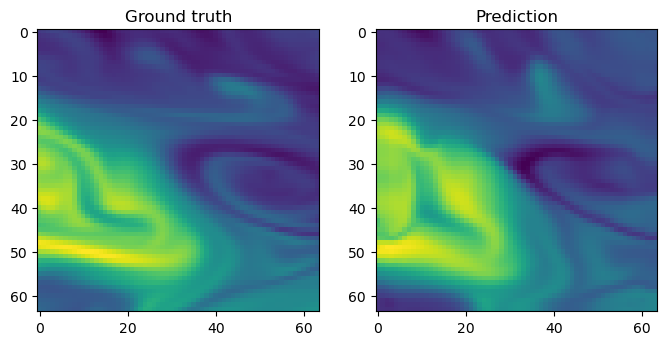

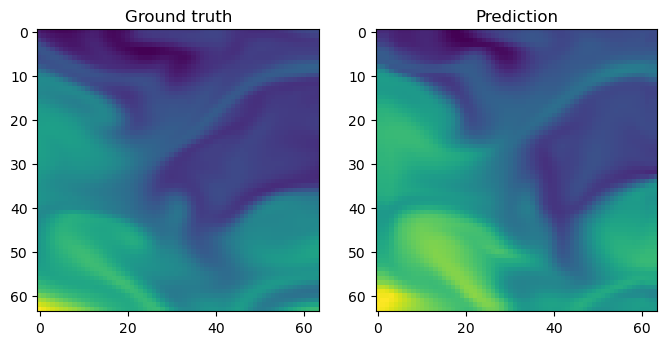

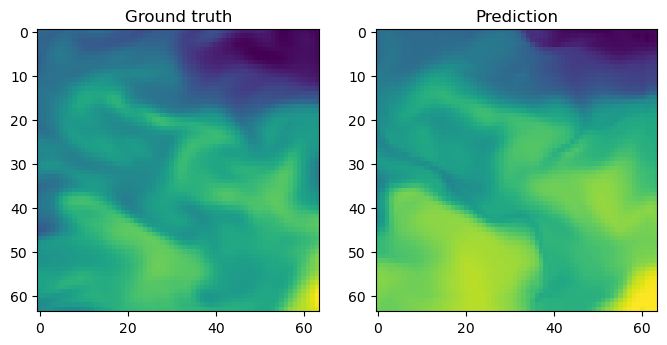

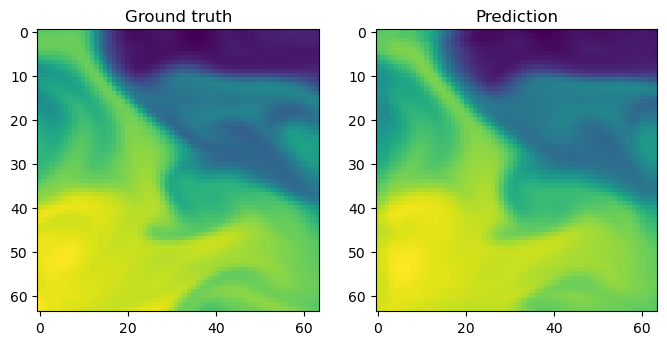

In [29]:
exp2.visualize_examples(example_loader)

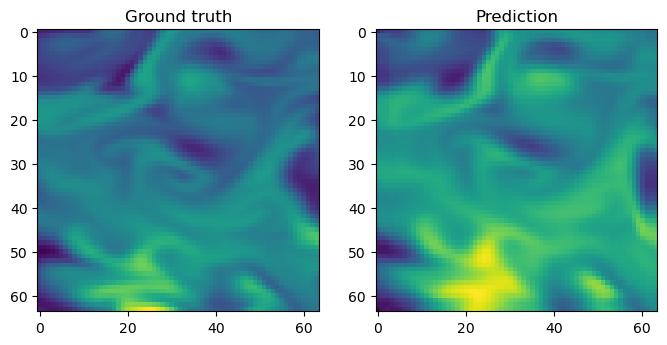

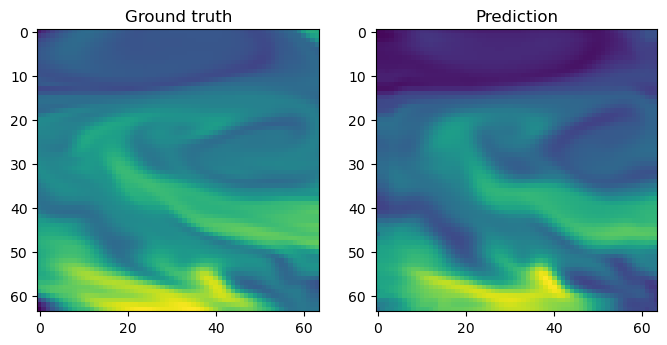

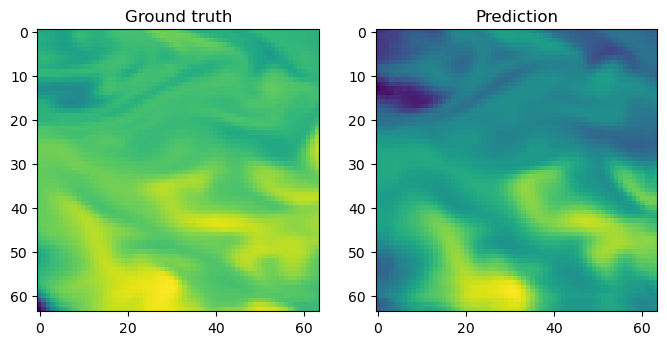

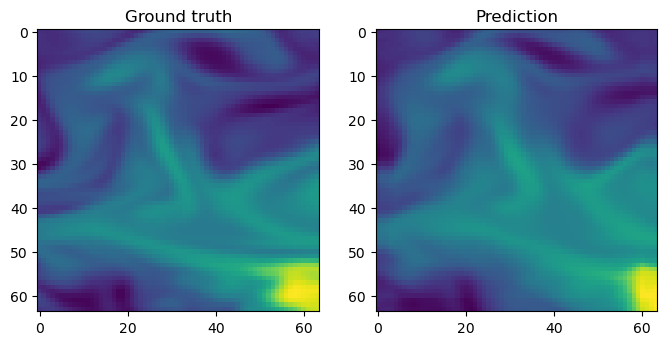

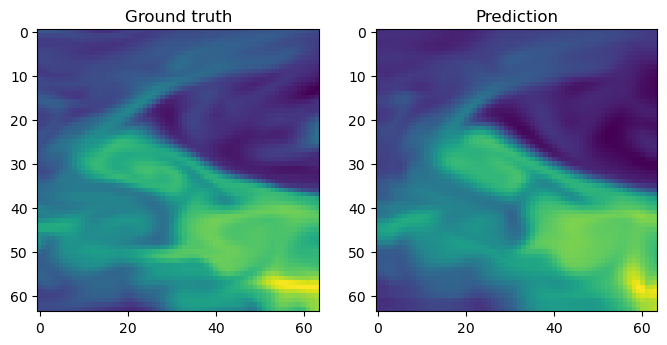

...

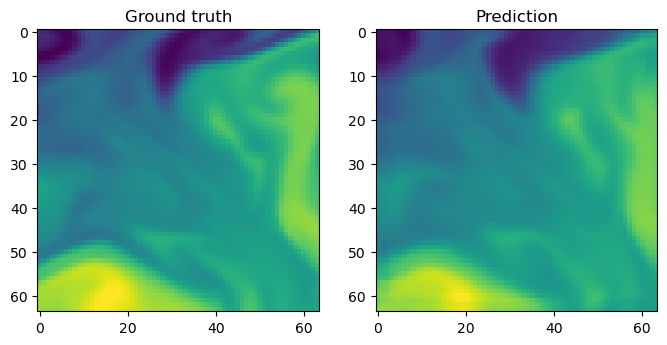

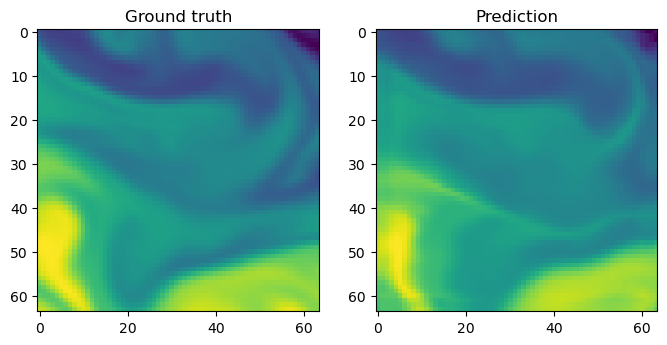

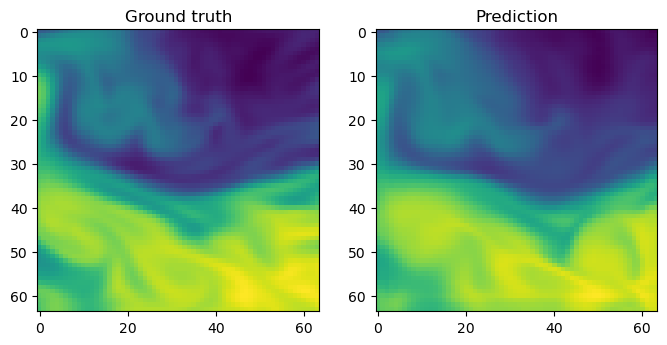

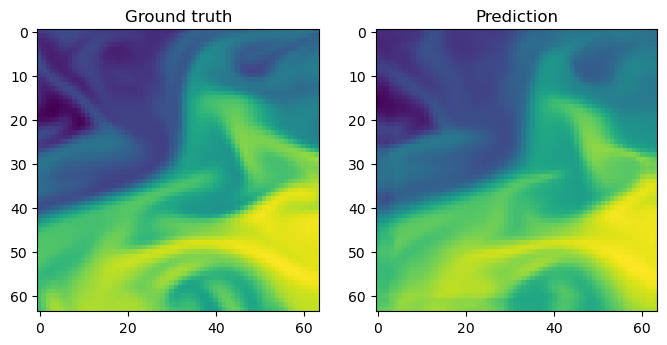

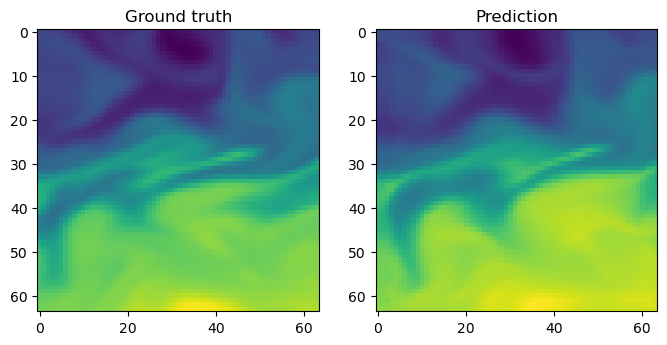

In [57]:
exp2.visualize_examples(val_loader)

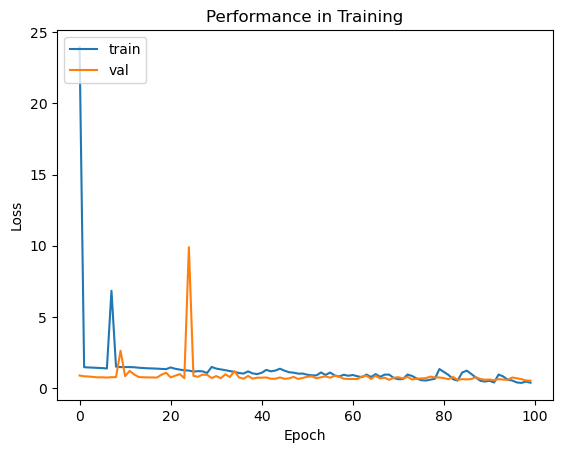

In [35]:
#exp2.plot_loss("Performance in Training", "Epoch", ["train", "val"])
exp2.plot_loss([exp2.train_losses, exp1.val_losses], "Performance in Training", "Epoch", ["train", "val"])

In [52]:
net3 = CDNN(hist=4)
net3.to(device)

optim = torch.optim.Adam(net3.parameters(), lr=1e-3)

exp3 = Experiment(name="BezenacSqErr_test5",                # de Bezenac model, trained on err^2 Loss
                  trainset=training_loader,                # data loaders: 1. training
                  valset=val_loader,                       #               2. validation  
                  testset=None,                            #               3. testing
                  model=net1,                              # model 
                  regloss=False,                           # whether to regularize the training loss 
                  test_loss=nn.MSELoss(reduction="mean"),  # loss function for testing
                  optimizer=optim,
                  outdir=path)

# Testing plot functions
exp3.run(epochs=2)

Created new directory to save model states and results: /projectnb/labci/Lucia/rainfall-pde-ml/experiments/2023-09-26/BezenacSqErr_test5
Running experiment: BezenacSqErr_test5...
Training over 2 epochs...
Epoch 0
-------------------------------
Step: 0 Loss: tensor(2.9220, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 1 Loss: tensor(0.7634, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 2 Loss: tensor(0.7357, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 3 Loss: tensor(0.6292, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 4 Loss: tensor(0.8168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 5 Loss: tensor(1.0273, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 6 Loss: tensor(1.3216, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 7 Loss: tensor(0.9415, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 8 Loss: tensor(1.3906, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 9 Loss: tensor(0.7225, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 10 Loss: tensor(1.3195, device='cuda:0'

Step: 111 Loss: tensor(0.8152, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 112 Loss: tensor(0.7395, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 113 Loss: tensor(0.8028, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 114 Loss: tensor(1.2241, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 115 Loss: tensor(0.7168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 116 Loss: tensor(1.1897, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 117 Loss: tensor(1.0870, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 118 Loss: tensor(0.6452, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 119 Loss: tensor(0.6375, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 120 Loss: tensor(0.9372, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 121 Loss: tensor(1.0236, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 122 Loss: tensor(0.7020, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 123 Loss: tensor(1.3704, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 124 Loss: tensor(0.9754, device='cuda:0', gra

Step: 225 Loss: tensor(1.0227, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 226 Loss: tensor(0.7773, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 227 Loss: tensor(1.1097, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 228 Loss: tensor(1.7522, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 229 Loss: tensor(1.0533, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 230 Loss: tensor(1.6695, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 231 Loss: tensor(1.0957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 232 Loss: tensor(1.1046, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 233 Loss: tensor(1.1253, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 234 Loss: tensor(0.7111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 235 Loss: tensor(0.7957, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 236 Loss: tensor(0.4541, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 237 Loss: tensor(0.7640, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 238 Loss: tensor(0.6165, device='cuda:0', gra

Step: 339 Loss: tensor(1.5351, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 340 Loss: tensor(0.6477, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 341 Loss: tensor(1.4591, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 342 Loss: tensor(0.6609, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 343 Loss: tensor(1.3424, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 344 Loss: tensor(1.1772, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 345 Loss: tensor(0.9357, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 346 Loss: tensor(1.3180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 347 Loss: tensor(1.2712, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 348 Loss: tensor(0.6689, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 349 Loss: tensor(0.9147, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 350 Loss: tensor(0.9714, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 351 Loss: tensor(0.9239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 352 Loss: tensor(1.1772, device='cuda:0', gra

Step: 453 Loss: tensor(0.5984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 454 Loss: tensor(1.7266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 455 Loss: tensor(0.8503, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 456 Loss: tensor(0.5722, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 457 Loss: tensor(0.7732, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 458 Loss: tensor(0.8259, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 459 Loss: tensor(0.8101, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 460 Loss: tensor(0.4493, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 461 Loss: tensor(1.8591, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 462 Loss: tensor(1.7461, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 463 Loss: tensor(0.5103, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 464 Loss: tensor(1.1883, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 465 Loss: tensor(1.3126, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 466 Loss: tensor(0.6824, device='cuda:0', gra

Step: 567 Loss: tensor(1.0087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 568 Loss: tensor(0.6471, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 569 Loss: tensor(0.8012, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 570 Loss: tensor(1.5840, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 571 Loss: tensor(0.7326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 572 Loss: tensor(0.5636, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 573 Loss: tensor(1.0798, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 574 Loss: tensor(0.8182, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 575 Loss: tensor(1.1577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 576 Loss: tensor(0.5485, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 577 Loss: tensor(1.9755, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 578 Loss: tensor(0.8106, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 579 Loss: tensor(1.1608, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 580 Loss: tensor(1.2417, device='cuda:0', gra

Step: 681 Loss: tensor(2.8076, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 682 Loss: tensor(1.0535, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 683 Loss: tensor(1.2069, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 684 Loss: tensor(1.1559, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 685 Loss: tensor(0.6770, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 686 Loss: tensor(1.0168, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 687 Loss: tensor(0.6371, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 688 Loss: tensor(1.3082, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 689 Loss: tensor(2.5577, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 690 Loss: tensor(0.8603, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 691 Loss: tensor(0.5433, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 692 Loss: tensor(1.4948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 693 Loss: tensor(0.8342, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 694 Loss: tensor(0.8628, device='cuda:0', gra

Step: 795 Loss: tensor(0.9261, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 796 Loss: tensor(1.6814, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 797 Loss: tensor(0.8195, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 798 Loss: tensor(0.9213, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 799 Loss: tensor(1.0363, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 800 Loss: tensor(1.1787, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 801 Loss: tensor(0.9049, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 802 Loss: tensor(1.1875, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 803 Loss: tensor(1.2616, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 804 Loss: tensor(1.0766, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 805 Loss: tensor(0.9326, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 806 Loss: tensor(1.2673, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 807 Loss: tensor(0.5676, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 808 Loss: tensor(0.9510, device='cuda:0', gra

Step: 13 Loss: tensor(1.1694, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 14 Loss: tensor(0.8125, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 15 Loss: tensor(1.3315, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 16 Loss: tensor(0.8908, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 17 Loss: tensor(1.1997, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 18 Loss: tensor(1.5001, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 19 Loss: tensor(0.8262, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 20 Loss: tensor(1.4650, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 21 Loss: tensor(0.7984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 22 Loss: tensor(1.3129, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 23 Loss: tensor(1.3245, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 24 Loss: tensor(0.9860, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 25 Loss: tensor(0.8301, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 26 Loss: tensor(1.1545, device='cuda:0', grad_fn=<MeanBack

Step: 127 Loss: tensor(0.9266, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 128 Loss: tensor(0.6180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 129 Loss: tensor(2.2392, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 130 Loss: tensor(1.5581, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 131 Loss: tensor(0.4958, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 132 Loss: tensor(0.9579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 133 Loss: tensor(0.7157, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 134 Loss: tensor(0.6464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 135 Loss: tensor(0.9044, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 136 Loss: tensor(1.3741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 137 Loss: tensor(0.8530, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 138 Loss: tensor(1.2206, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 139 Loss: tensor(0.6073, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 140 Loss: tensor(0.8892, device='cuda:0', gra

Step: 241 Loss: tensor(0.9735, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 242 Loss: tensor(0.6120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 243 Loss: tensor(0.4447, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 244 Loss: tensor(1.0128, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 245 Loss: tensor(0.9270, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 246 Loss: tensor(0.7579, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 247 Loss: tensor(0.6295, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 248 Loss: tensor(2.0595, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 249 Loss: tensor(1.0369, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 250 Loss: tensor(0.8464, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 251 Loss: tensor(1.0587, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 252 Loss: tensor(1.0610, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 253 Loss: tensor(1.0294, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 254 Loss: tensor(0.9527, device='cuda:0', gra

Step: 355 Loss: tensor(1.1239, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 356 Loss: tensor(1.9683, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 357 Loss: tensor(0.5516, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 358 Loss: tensor(0.6611, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 359 Loss: tensor(0.9854, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 360 Loss: tensor(0.7219, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 361 Loss: tensor(1.5309, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 362 Loss: tensor(1.4819, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 363 Loss: tensor(2.5083, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 364 Loss: tensor(0.9051, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 365 Loss: tensor(0.6251, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 366 Loss: tensor(0.4658, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 367 Loss: tensor(1.4462, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 368 Loss: tensor(1.4396, device='cuda:0', gra

Step: 469 Loss: tensor(0.9848, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 470 Loss: tensor(0.8040, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 471 Loss: tensor(0.9007, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 472 Loss: tensor(2.1056, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 473 Loss: tensor(0.8474, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 474 Loss: tensor(1.6120, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 475 Loss: tensor(0.7087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 476 Loss: tensor(0.6420, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 477 Loss: tensor(1.0053, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 478 Loss: tensor(1.0791, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 479 Loss: tensor(0.4915, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 480 Loss: tensor(1.1229, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 481 Loss: tensor(0.5715, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 482 Loss: tensor(0.9439, device='cuda:0', gra

Step: 583 Loss: tensor(0.9089, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 584 Loss: tensor(2.8999, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 585 Loss: tensor(1.3045, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 586 Loss: tensor(0.9050, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 587 Loss: tensor(0.8730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 588 Loss: tensor(0.6122, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 589 Loss: tensor(1.2893, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 590 Loss: tensor(1.0071, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 591 Loss: tensor(1.3501, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 592 Loss: tensor(1.1721, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 593 Loss: tensor(1.2925, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 594 Loss: tensor(1.0286, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 595 Loss: tensor(1.2354, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 596 Loss: tensor(1.0303, device='cuda:0', gra

Step: 697 Loss: tensor(1.2459, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 698 Loss: tensor(0.8111, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 699 Loss: tensor(1.2381, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 700 Loss: tensor(0.8135, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 701 Loss: tensor(1.2204, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 702 Loss: tensor(0.9084, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 703 Loss: tensor(1.0949, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 704 Loss: tensor(1.3037, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 705 Loss: tensor(0.9027, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 706 Loss: tensor(1.8087, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 707 Loss: tensor(1.1690, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 708 Loss: tensor(0.7596, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 709 Loss: tensor(1.2472, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 710 Loss: tensor(1.3767, device='cuda:0', gra

Step: 811 Loss: tensor(0.8741, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 812 Loss: tensor(0.8774, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 813 Loss: tensor(0.8984, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 814 Loss: tensor(0.8948, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 815 Loss: tensor(1.0730, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 816 Loss: tensor(1.0380, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 817 Loss: tensor(0.7692, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 818 Loss: tensor(1.0738, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 819 Loss: tensor(1.0180, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 820 Loss: tensor(0.5565, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 821 Loss: tensor(0.6055, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 822 Loss: tensor(0.7892, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 823 Loss: tensor(0.9298, device='cuda:0', grad_fn=<MeanBackward0>)
Step: 824 Loss: tensor(0.8068, device='cuda:0', gra

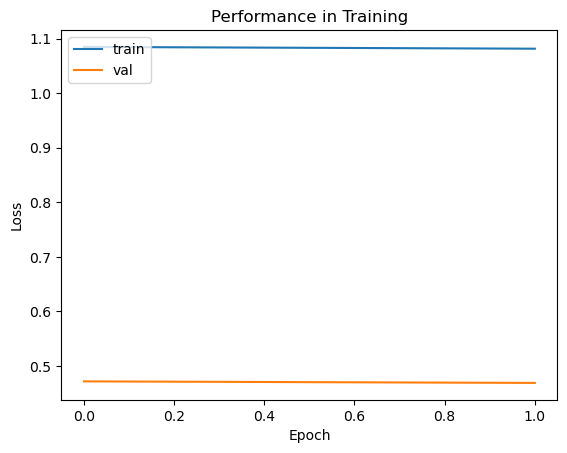

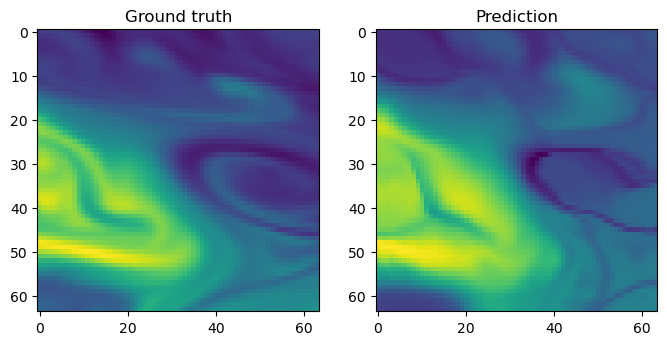

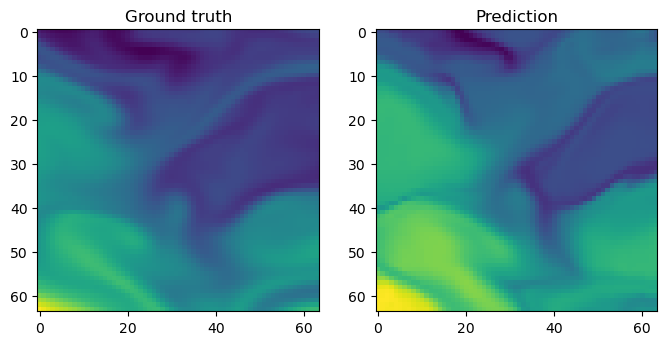

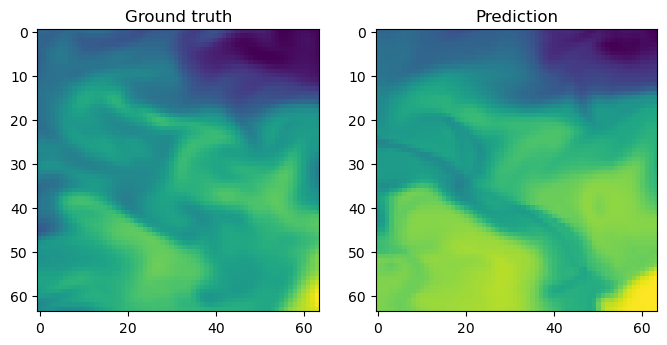

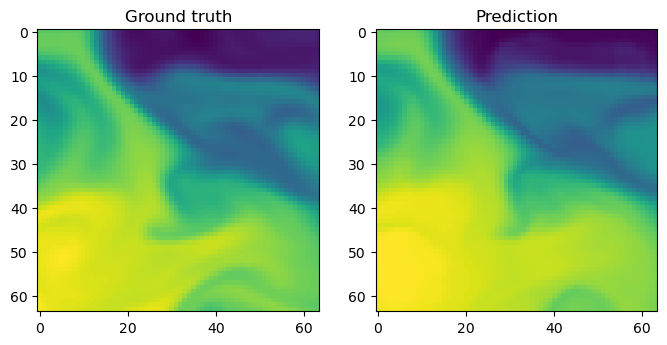

In [53]:
exp3.plot_loss("Performance in Training", "Epoch", ["train", "val"], "trainingPerf.png")
exp3.visualize_examples(example_loader, "exampleImages")

In [ ]:
# TODO: 
# 3. run vanilla CNN with same conv/deconv layers on data to compare results